In [14]:
%matplotlib inline
%load_ext autoreload
%autoreload 2

import matplotlib.pyplot as plt
import numpy as np
import tensorflow as tf
from tf_util.systems import system_from_str
from train_dsn import train_dsn

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


w_0 2.23606797749979
zeta 0.22360679774997896


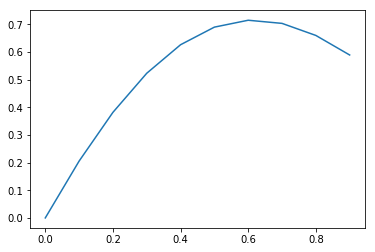

In [15]:
T = 10;
dt = .1;

k = 5.0;
c = 1.0;
m  = 1.0;

bounds = [0.0, 20.0];

w_0 = np.sqrt(k/m);
zeta = c/(2*np.sqrt(m*k));

print('w_0', w_0);
print('zeta', zeta);

A = 1.0;
theta = 0.0;
t = np.linspace(0,dt*(T-1),T);
x = A*np.exp(-(zeta*w_0*t))*np.sin(np.sqrt(1-np.square(zeta))*w_0*t + theta);

dxdt = A*(-zeta*w_0*np.exp(-zeta*w_0*t)*np.sin(np.sqrt(1.0-np.square(zeta))*w_0*t + theta) + \
          np.exp(-zeta*w_0*t)*np.cos(np.sqrt(1-np.square(zeta))*w_0*t + theta)*(np.sqrt(1-np.square(zeta))*w_0));

plt.figure();
plt.plot(t,x);
#plt.plot(t,dxdt);
#plt.legend(['x', 'dxdt']);
plt.show();

init_conds = np.array([0.0, dxdt[0]]);

[0.         0.22222222 0.44444444 0.66666667 0.88888889 1.11111111
 1.33333333 1.55555556 1.77777778 2.        ]


/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/ipykernel_launcher.py:16: RuntimeWarning: invalid value encountered in double_scalars
  app.launch_new_instance()
/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/ipykernel_launcher.py:17: RuntimeWarning: invalid value encountered in double_scalars


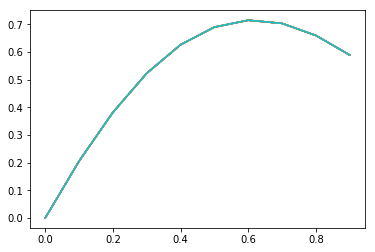

w_0 2.23606797749979
zeta 0.22360679774997896


In [16]:
# show that the degenerate solution space is just a scaling of c, m, and k
num_s = 10;
s = np.linspace(0,2,num_s);
print(s)

ks = [];
cs = [];
ms = [];
plt.figure();
for i in range(num_s):
    s_i = s[i];
    k_i = s_i*k;
    c_i = s_i*c;
    m_i = s_i*m;
    
    w_0 = np.sqrt(k_i/m_i);
    zeta = c_i/(2*np.sqrt(m_i*k_i));

    x_i = A*np.exp(-(zeta*w_0*t))*np.sin(np.sqrt(1-np.square(zeta))*w_0*t + theta);
    
    plt.plot(t, x_i);
    
    ks.append(k_i);
    cs.append(c_i);
    ms.append(m_i);
    
    dxdt = A*(-zeta*w_0*np.exp(-zeta*w_0*t)*np.sin(np.sqrt(1.0-np.square(zeta))*w_0*t + theta) + \
          np.exp(-zeta*w_0*t)*np.cos(np.sqrt(1-np.square(zeta))*w_0*t + theta)*(np.sqrt(1-np.square(zeta))*w_0));

    init_conds = np.array([0.0, dxdt[0]]);
    
plt.show();

print('w_0', w_0);
print('zeta', zeta);


In [17]:
D = 2;
system_str = 'damped_harmonic_oscillator'

behavior_str = 'steady_state';

system_class = system_from_str(system_str);
system = system_class(behavior_str, T, dt, init_conds, bounds);
print(system.name)

damped_harmonic_oscillator


In [18]:
K = 1;
M = num_s;
num_params = 3;
phi = tf.placeholder(dtype=tf.float64, shape=(K, M, num_params, 1));

X = system.simulate(phi);


phi (1, 10, 3, 1)


In [19]:
K = 1;
M = 10;
k_tf = tf.get_variable('k', dtype=tf.float64, shape=(K,M,1));
c_tf = tf.get_variable('c', dtype=tf.float64, shape=(K,M,1));
m_tf = tf.get_variable('m', dtype=tf.float64, shape=(K,M,1));

k_np = np.expand_dims(np.expand_dims(k*np.linspace(0,2,M), 0), 2);
c_np = np.expand_dims(np.expand_dims(c*np.linspace(0,2,M), 0), 2);
m_np = np.expand_dims(np.expand_dims(m*np.linspace(0,2,M), 0), 2);

_phi = np.expand_dims(np.concatenate((k_np, c_np, m_np), axis=2), 3);


In [20]:
def dydt(y, t):
    y1 = y[0];
    y2 = y[1];

    w_0 = tf.sqrt(tf.divide(k_tf,m_tf));
    zeta = tf.divide(c_tf, 2.0*tf.sqrt(tf.multiply(m_tf,k_tf)));
        
    y1_dot = y2;
    y2_dot = -2.0*tf.multiply(tf.multiply(w_0, zeta), y2) - tf.multiply(tf.square(w_0), y1);
    
    print(y1_dot.shape);
    print(y2_dot.shape);
    ydot = tf.stack([y1_dot, y2_dot]);
    return ydot;

y0_np = np.concatenate((init_conds[0]*np.ones((1,K,M,1)), \
                        init_conds[1]*np.ones((1,K,M,1))), axis=0);
y0 = tf.constant(y0_np, dtype=tf.float64);
out = dydt(y0, 0.0)

(1, 10, 1)
(1, 10, 1)


In [21]:
t = np.linspace(0,dt*(T-1), T);
out = tf.contrib.integrate.odeint_fixed(dydt, y0, t, method='rk4');

(1, 10, 1)
(1, 10, 1)
(1, 10, 1)
(1, 10, 1)
(1, 10, 1)
(1, 10, 1)
(1, 10, 1)
(1, 10, 1)


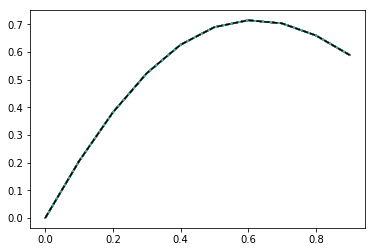

In [22]:
feed_dict_dydt = {c_tf:c_np, k_tf:k_np, m_tf:m_np};
feed_dict_sim = {phi:_phi};
with tf.Session() as sess:
    _out = sess.run(out, feed_dict_dydt);
    _X = sess.run(X, feed_dict_sim)

plt.figure();
for i in range(num_s):
    plt.plot(t, _out[:,0,0,i,0]);
    plt.plot(t, _X[0,i,0,:]);
plt.plot(t, x_i, 'k--');
plt.show();



In [23]:
# behavioral constraints
mu = x
Sigma = .0001*np.ones((T,));

{'mu': array([0.        , 0.20567829, 0.38203797, 0.52351255, 0.62671824,
       0.69040656, 0.71532034, 0.70396894, 0.66034133, 0.58957623]), 'Sigma': array([0.0001, 0.0001, 0.0001, 0.0001, 0.0001, 0.0001, 0.0001, 0.0001,
       0.0001, 0.0001])}
[0.         2.17944947]
c_init 1e-10
results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/
0 <tf_util.flows.PlanarFlowLayer object at 0x1417760b8>
1 <tf_util.flows.PlanarFlowLayer object at 0x1417767f0>
2 <tf_util.flows.PlanarFlowLayer object at 0x1417766d8>
3 <tf_util.flows.PlanarFlowLayer object at 0x141776780>
4 <tf_util.flows.PlanarFlowLayer object at 0x1417765c0>
Tensor("Const_10:0", shape=(3, 1), dtype=float64)
Tensor("Const_11:0", shape=(1, 1), dtype=float64)
Tensor("Const_12:0", shape=(3, 1), dtype=float64)
Tensor("Const_13:0", shape=(1, 1), dtype=float64)
Tensor("Const_14:0", shape=(3, 1), dtype=float64)
Tensor("Const_15:0", shape=(1, 1), dtype=float64)
Tensor("Const_16:0", shape=(3, 1), dtype=float64)
Tenso

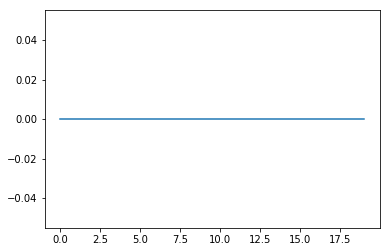

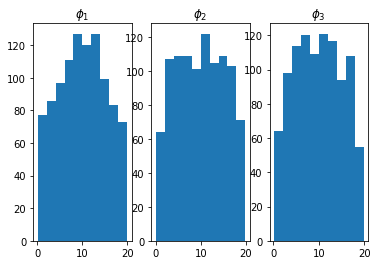

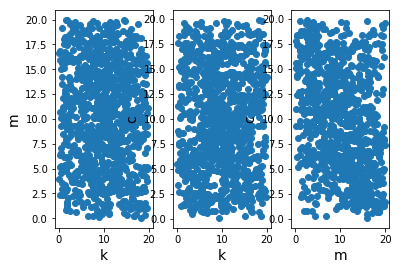

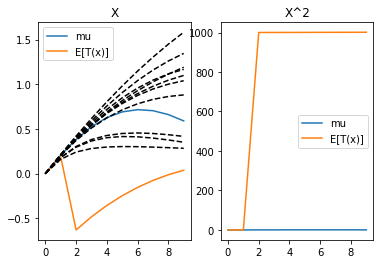

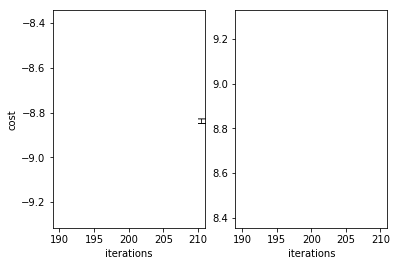

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 400 
H 8.832953656792695
cost -8.820836232949622
system.D 3


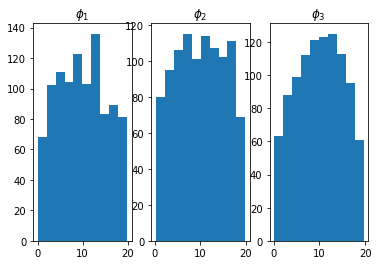

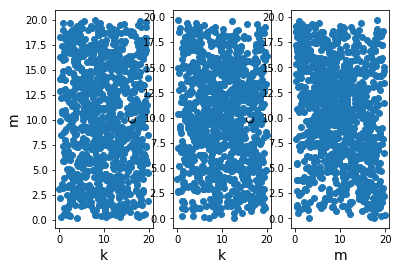

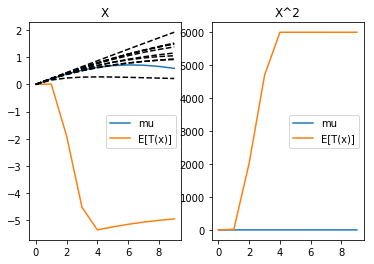

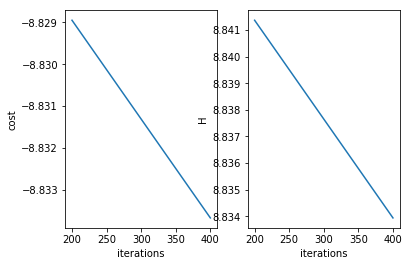

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 600 
H 8.832774046685888
cost -8.827094840084523
system.D 3


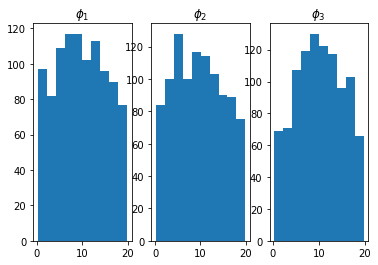

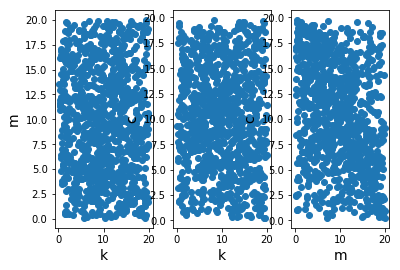

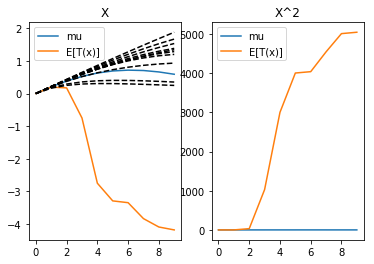

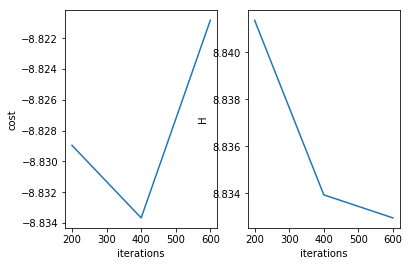

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
Doubling memory allocation for parameter logging.
******************************************
it = 800 
H 8.84241678181407
cost -8.842161363907195
system.D 3


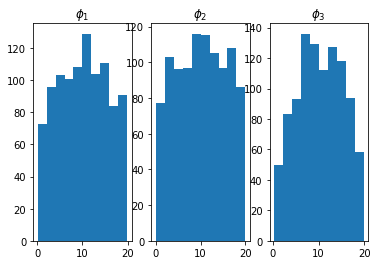

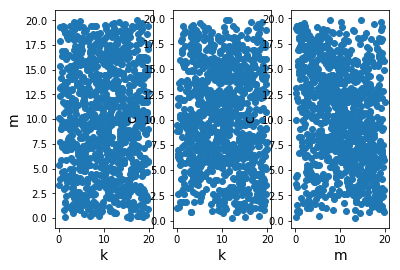

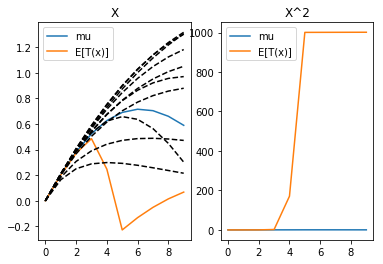

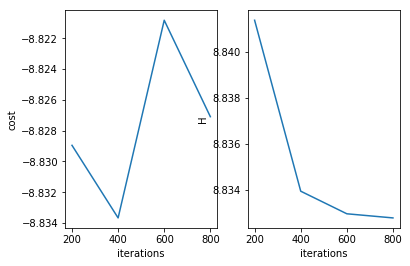

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 1000 
H 8.828966115372229
cost -8.827208561453526
system.D 3


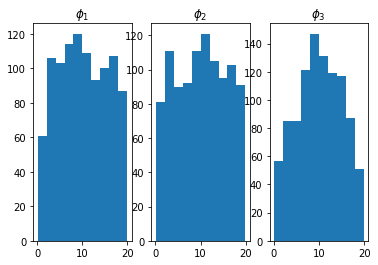

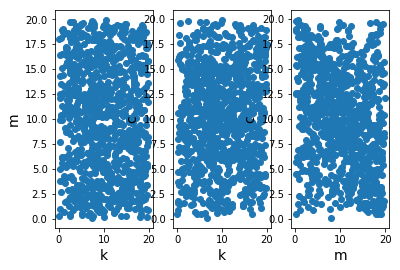

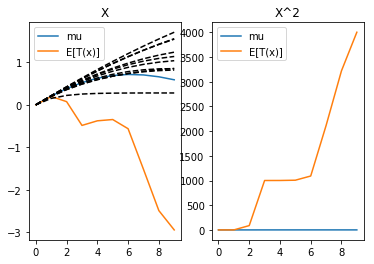

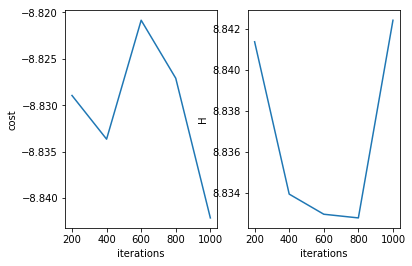

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 1200 
H 8.838106066772426
cost -8.838103416412038
system.D 3


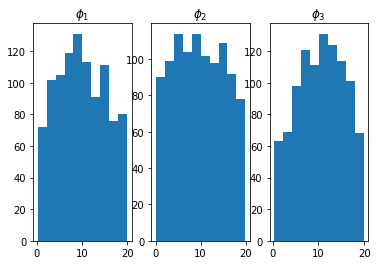

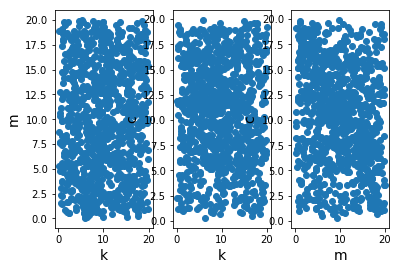

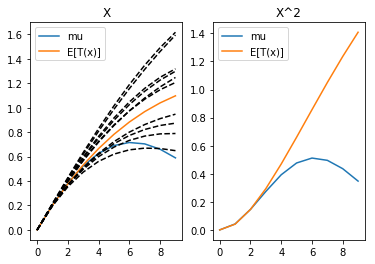

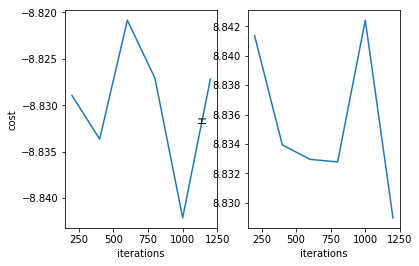

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
Doubling memory allocation for parameter logging.
******************************************
it = 1400 
H 8.797084035635988
cost -8.796779729917398
system.D 3


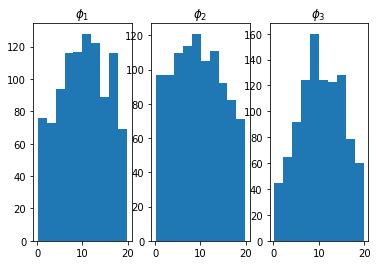

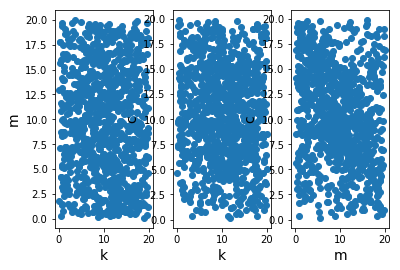

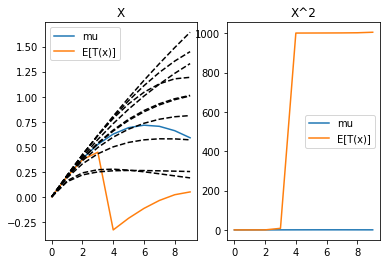

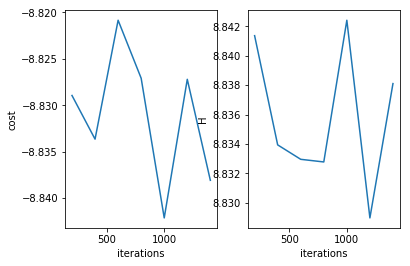

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 1600 
H 8.812121573313043
cost -8.811365466637296
system.D 3


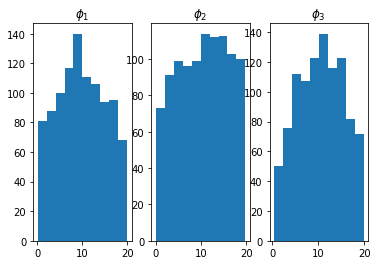

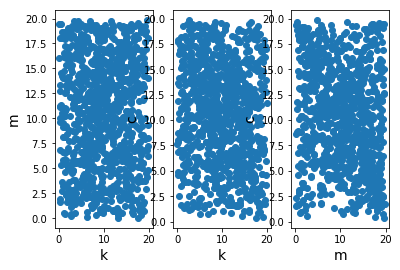

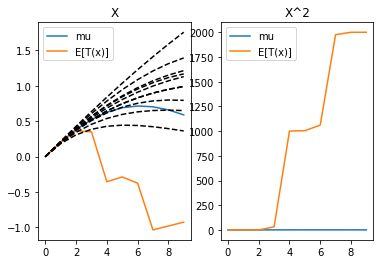

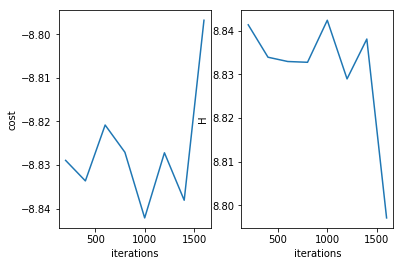

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 1800 
H 8.810864732942916
cost -8.802410003105434
system.D 3


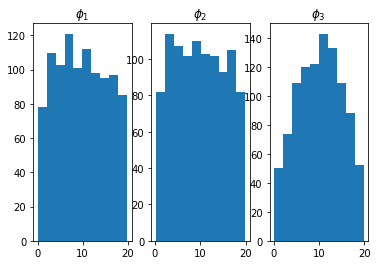

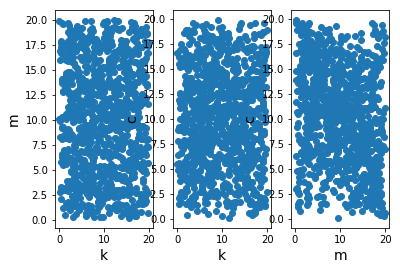

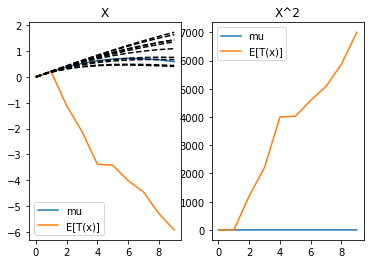

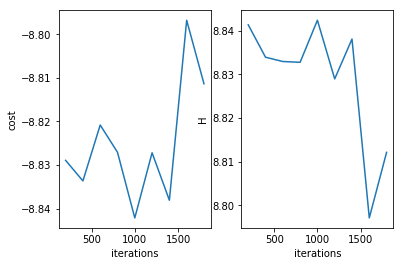

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 2000 
H 8.807767135658102
cost -8.806194814864696
system.D 3


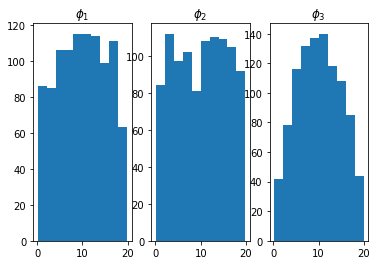

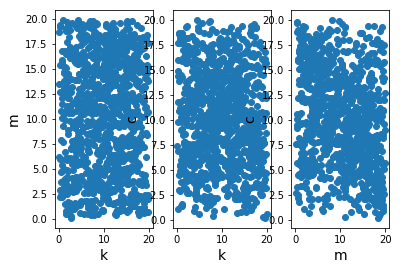

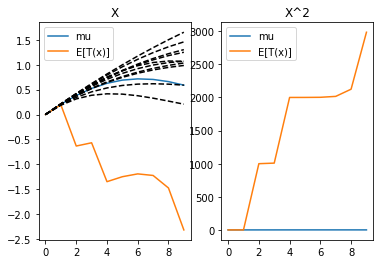

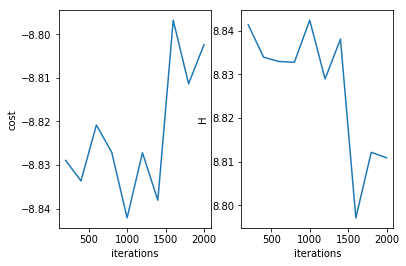

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 2200 
H 8.835853349992739
cost -8.835646039960716
system.D 3


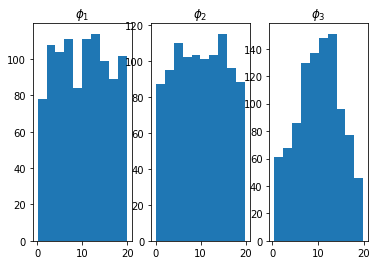

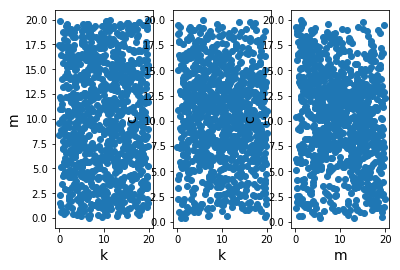

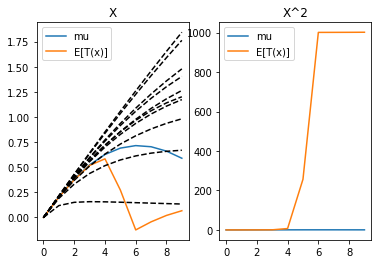

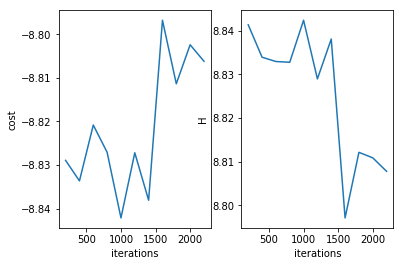

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 2400 
H 8.820614849040918
cost -8.819093794643699
system.D 3


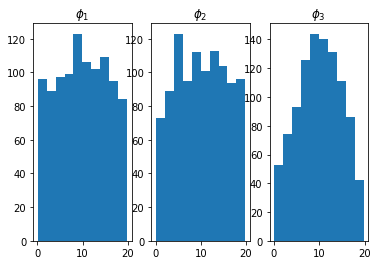

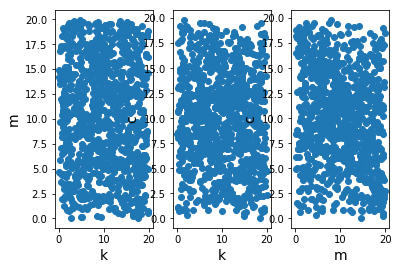

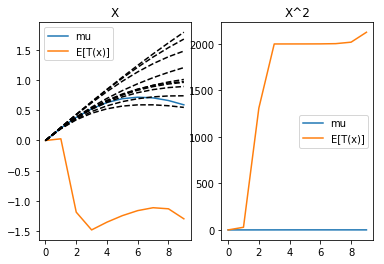

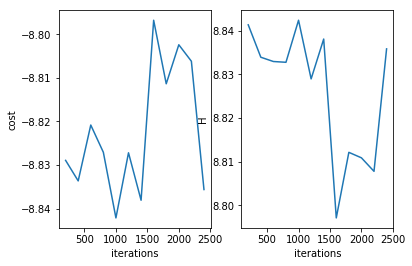

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
Doubling memory allocation for parameter logging.
******************************************
it = 2600 
H 8.810530943393408
cost -8.810175587014765
system.D 3


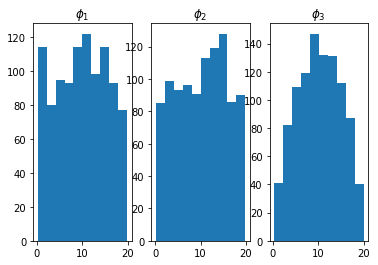

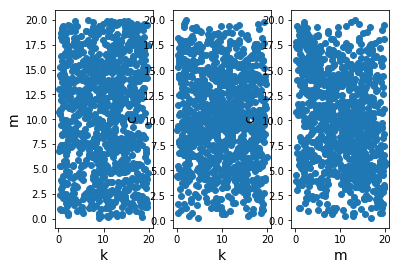

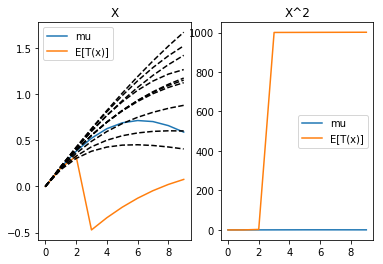

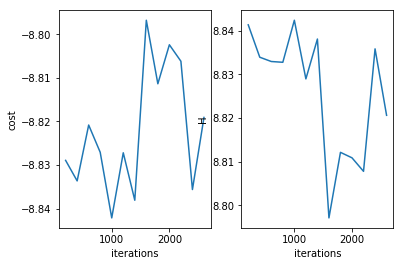

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 2800 
H 8.810125973440067
cost -8.807325640593813
system.D 3


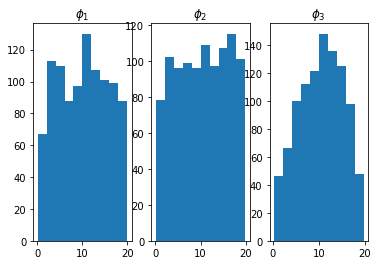

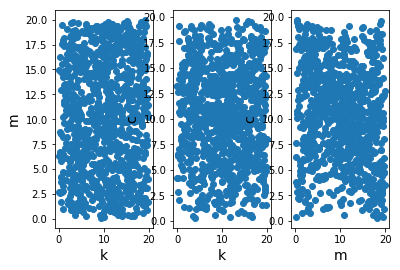

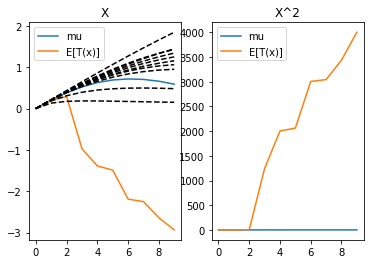

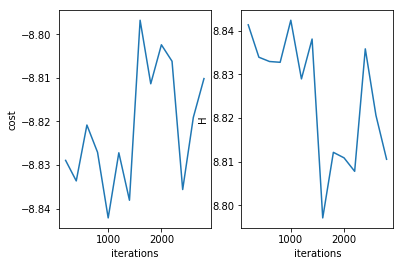

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 3000 
H 8.821902447585911
cost -8.82108972037858
system.D 3


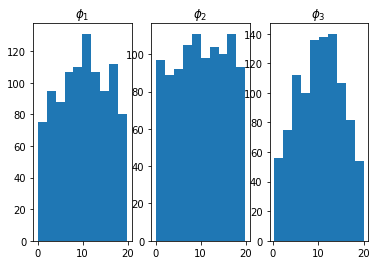

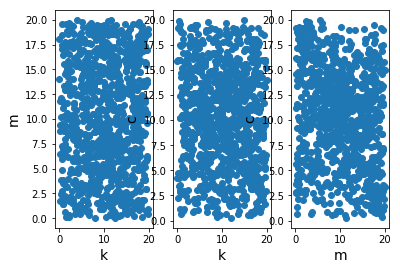

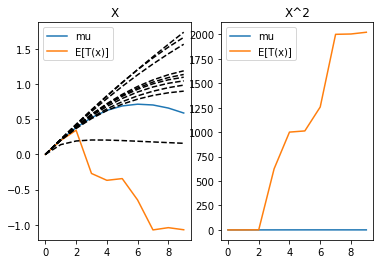

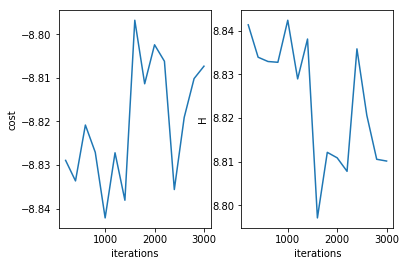

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 3200 
H 8.846429763252548
cost -8.843922965370416
system.D 3


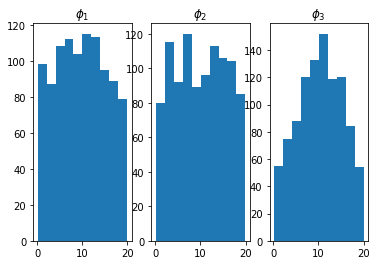

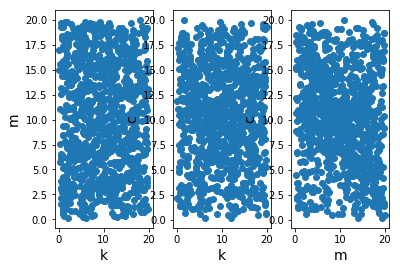

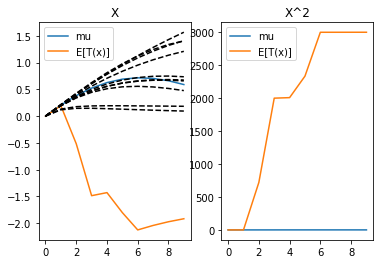

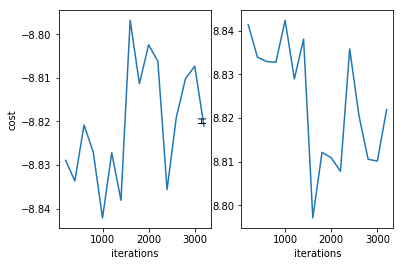

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 3400 
H 8.814256912454093
cost -8.81532850013709
system.D 3


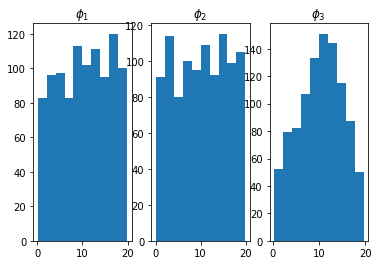

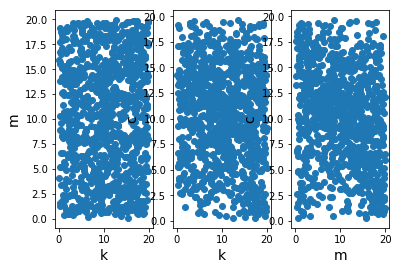

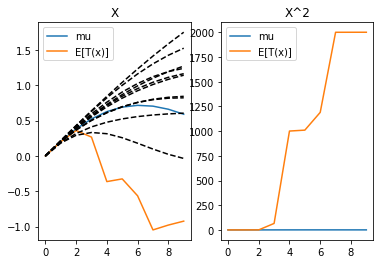

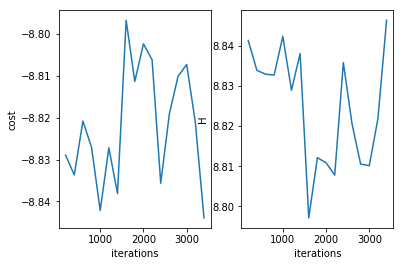

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 3600 
H 8.776241872972234
cost -8.776081233688522
system.D 3


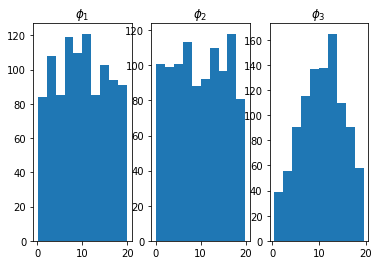

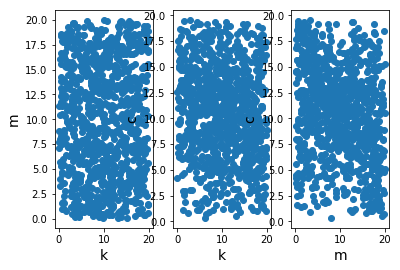

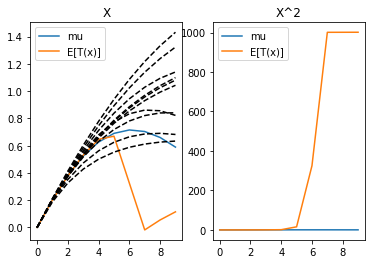

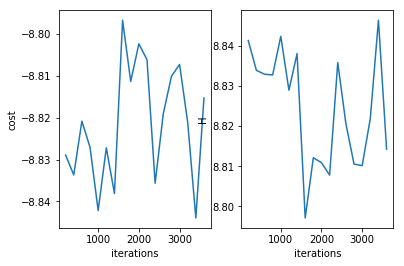

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 3800 
H 8.785532216893408
cost -8.784072293315356
system.D 3


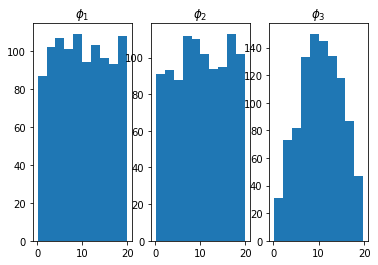

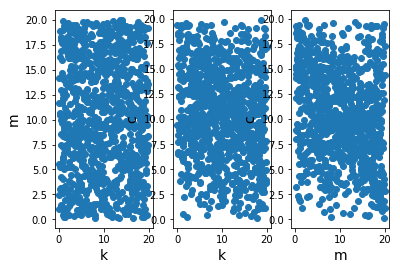

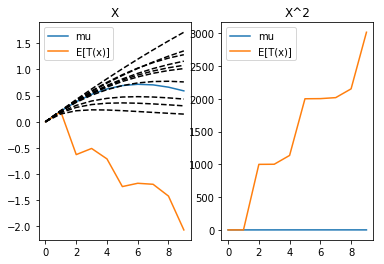

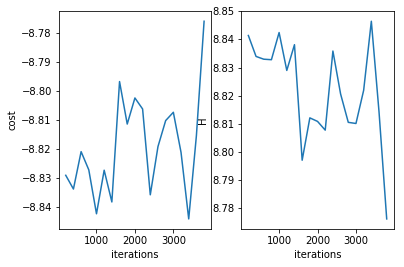

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 4000 
H 8.801389777217187
cost -8.80042833219472
system.D 3


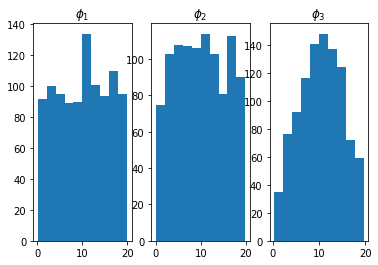

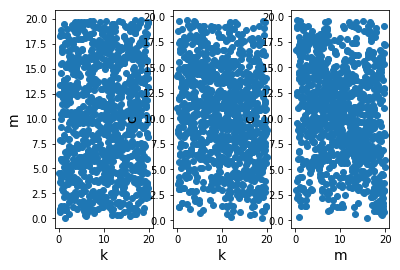

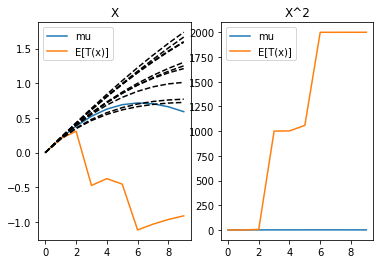

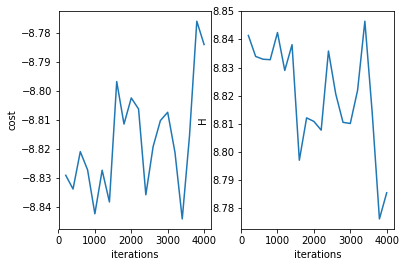

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 4200 
H 8.804123991758429
cost -8.803813975518425
system.D 3


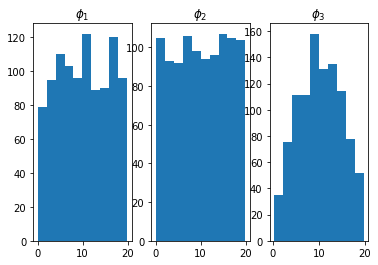

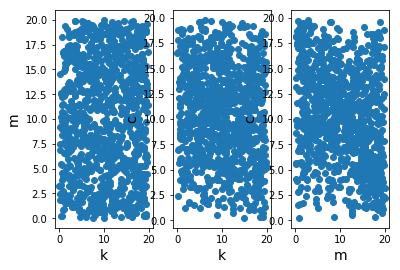

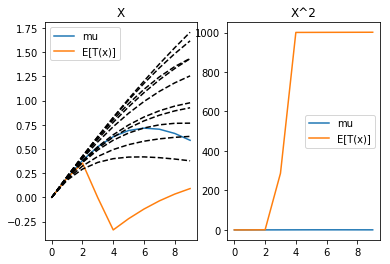

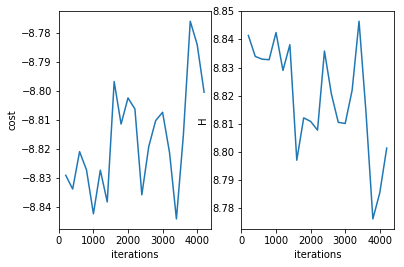

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 4400 
H 8.82050949448275
cost -8.814337857891879
system.D 3


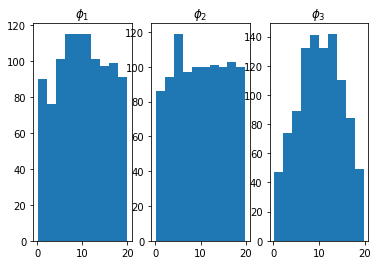

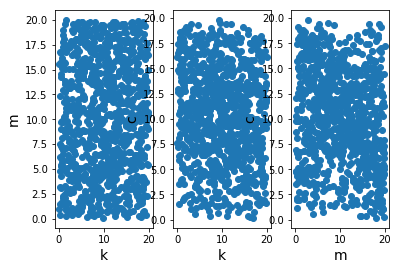

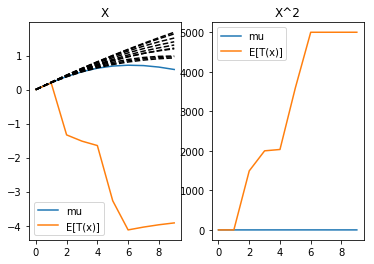

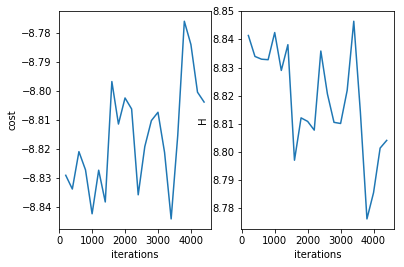

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 4600 
H 8.79202603724295
cost -8.792018538550623
system.D 3


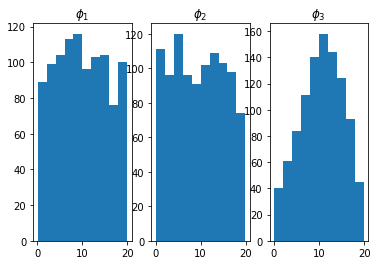

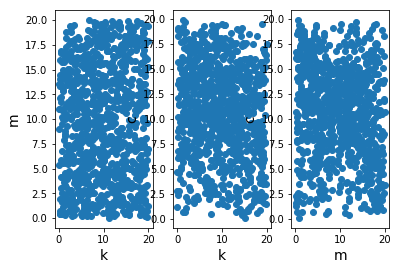

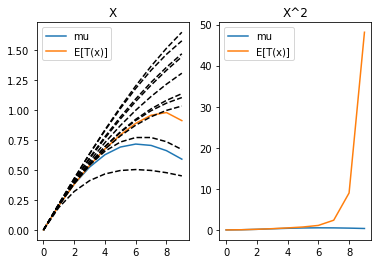

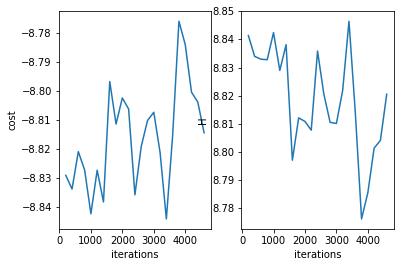

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 4800 
H 8.774030733155334
cost -8.772955182815302
system.D 3


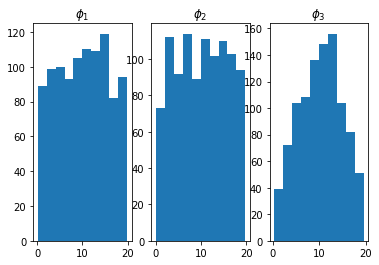

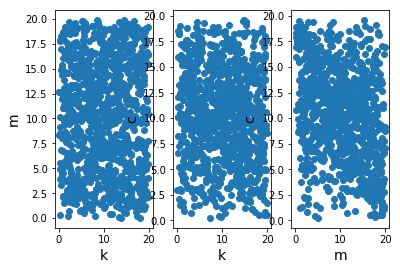

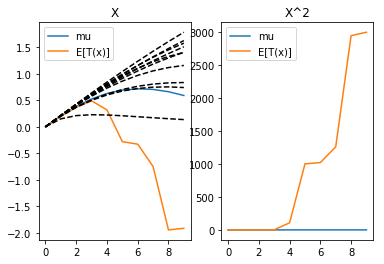

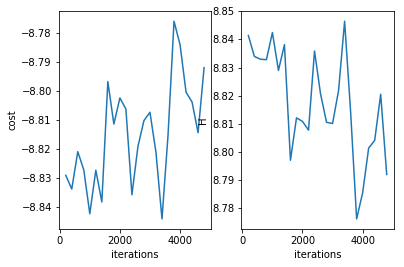

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 5000 
H 8.792899093018185
cost -8.791951162440823
system.D 3


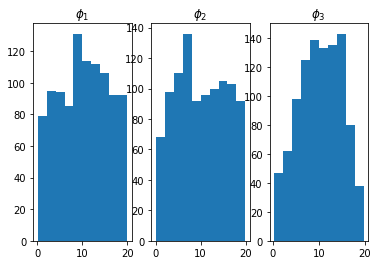

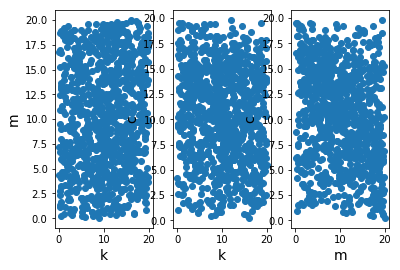

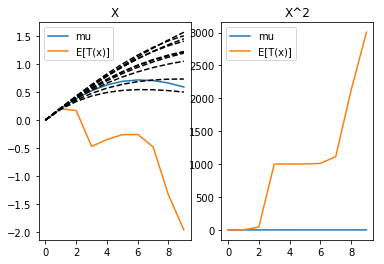

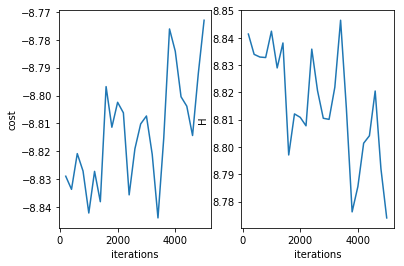

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
Doubling memory allocation for parameter logging.
******************************************
it = 5200 
H 8.720887250776208
cost -8.719621517913048
system.D 3


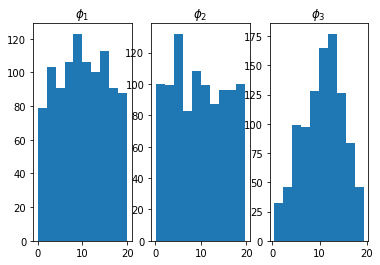

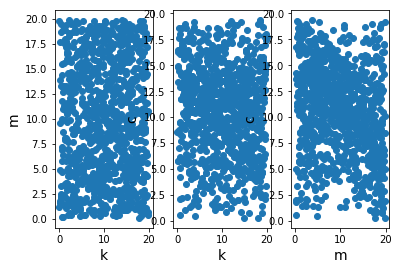

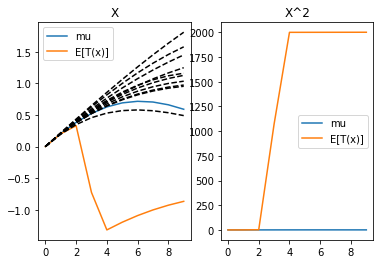

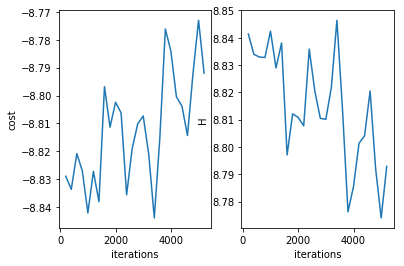

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 5400 
H 8.736694761012023
cost -8.736687209833729
system.D 3


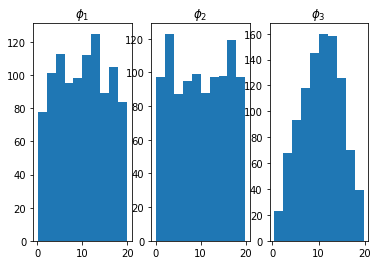

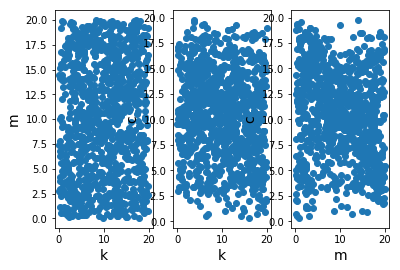

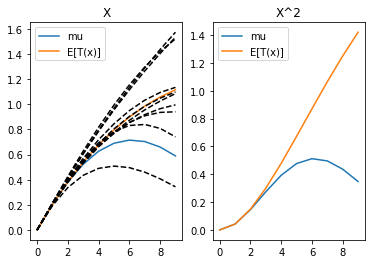

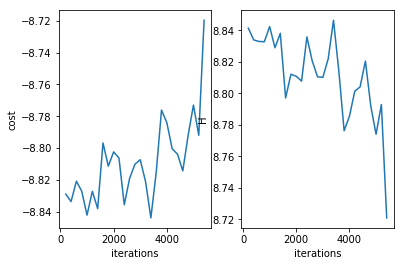

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 5600 
H 8.745410446757687
cost -8.74540262564256
system.D 3


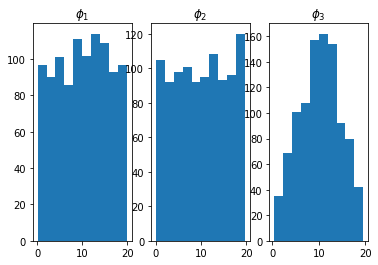

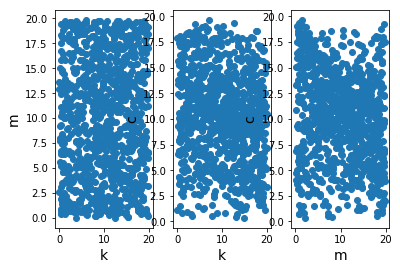

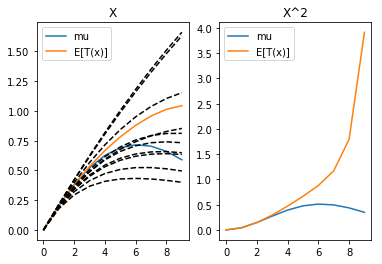

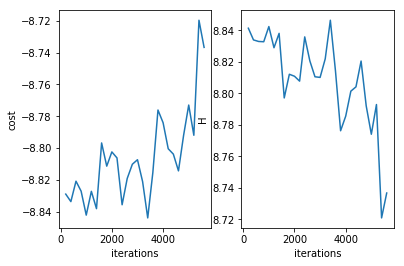

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 5800 
H 8.725333578136837
cost -8.724923001696117
system.D 3


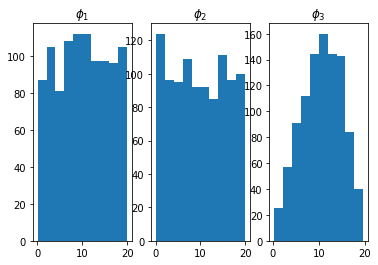

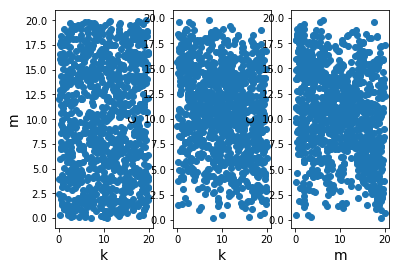

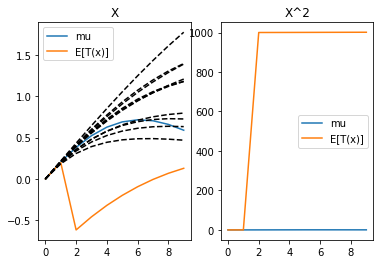

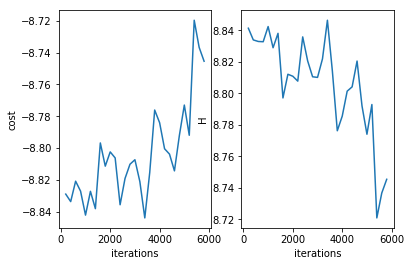

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 6000 
H 8.740320500969203
cost -8.740241410886041
system.D 3


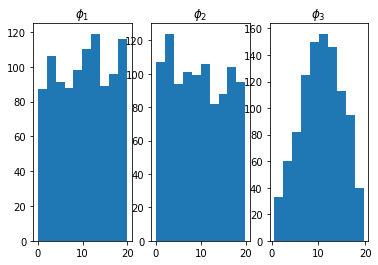

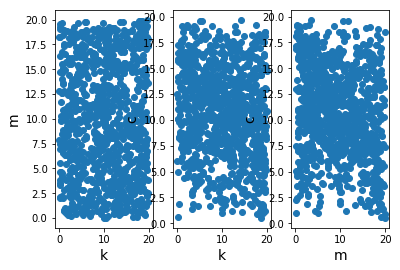

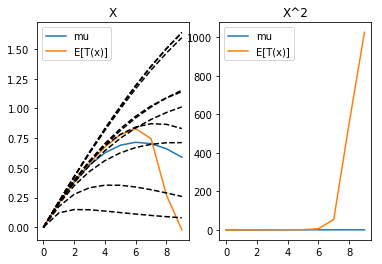

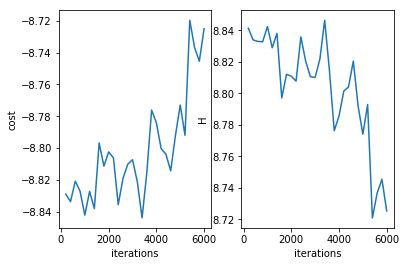

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 6200 
H 8.716951073160887
cost -8.715977039143661
system.D 3


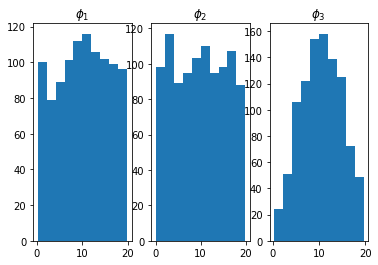

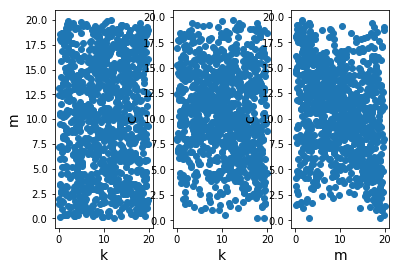

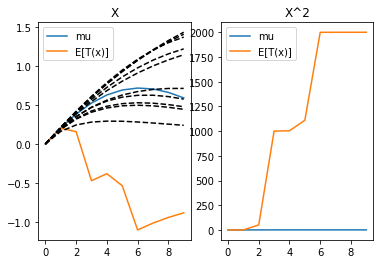

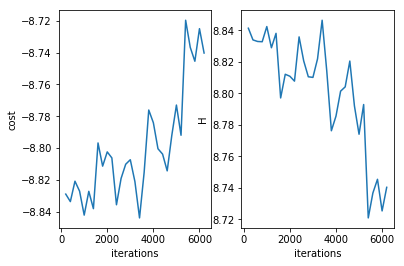

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 6400 
H 8.76889765495232
cost -8.768583277099399
system.D 3


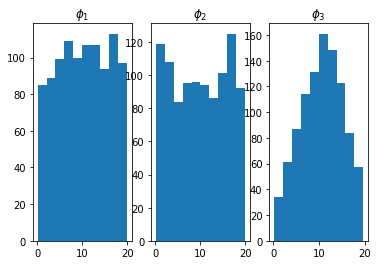

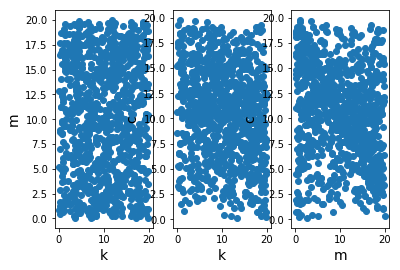

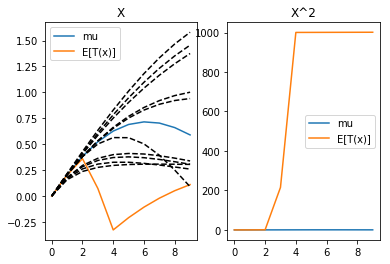

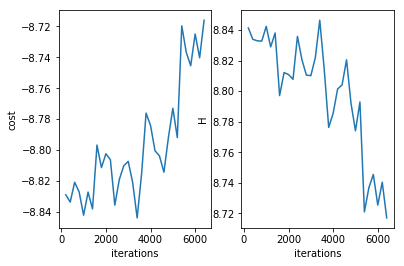

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 6600 
H 8.73387740993399
cost -8.73350840348243
system.D 3


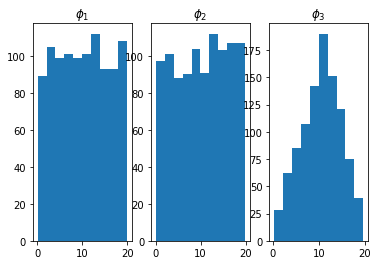

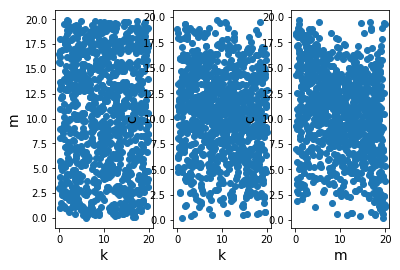

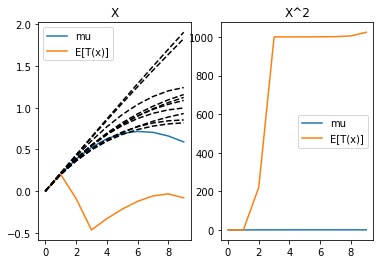

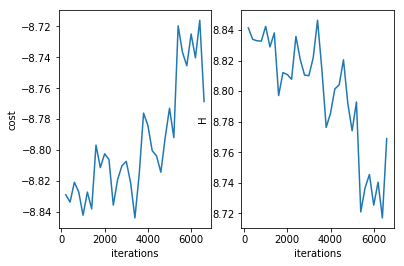

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 6800 
H 8.752621700744996
cost -8.752257371258825
system.D 3


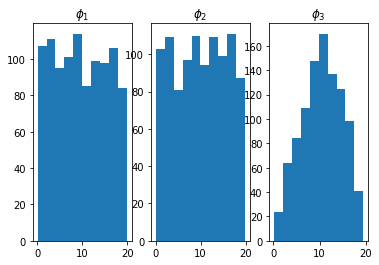

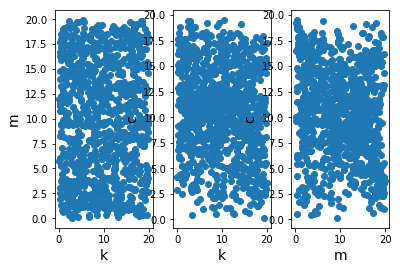

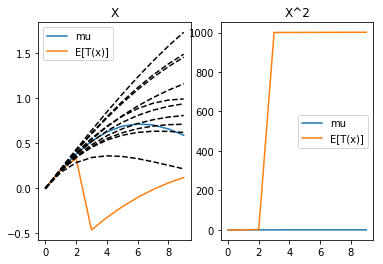

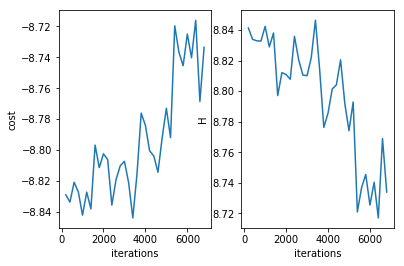

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 7000 
H 8.7297336632642
cost -8.728279082495424
system.D 3


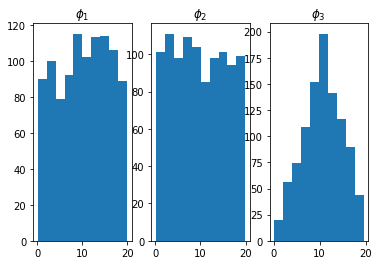

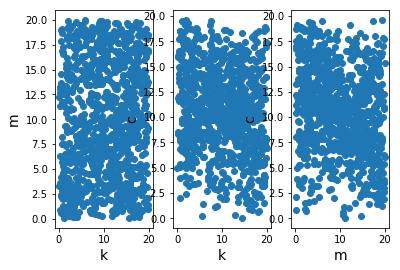

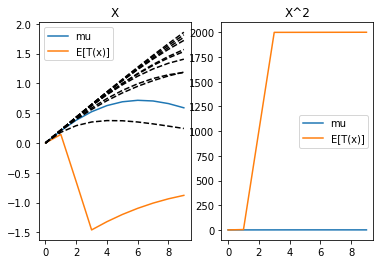

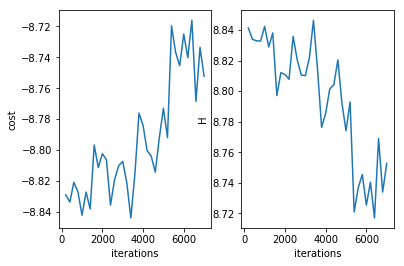

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 7200 
H 8.7482391171058
cost -8.747920672954436
system.D 3


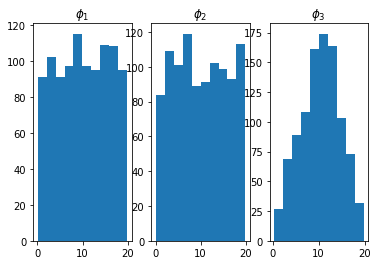

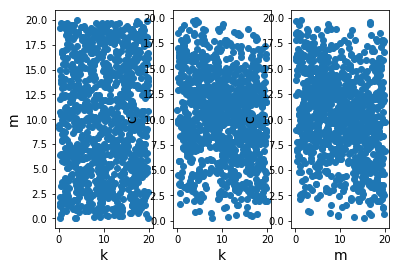

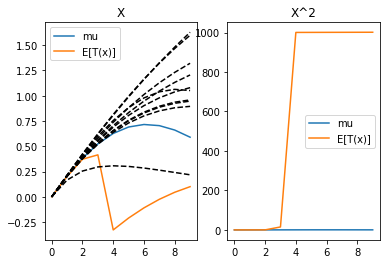

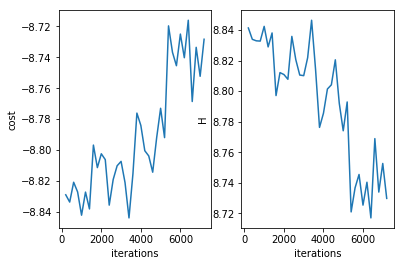

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 7400 
H 8.773210142610358
cost -8.773022744570131
system.D 3


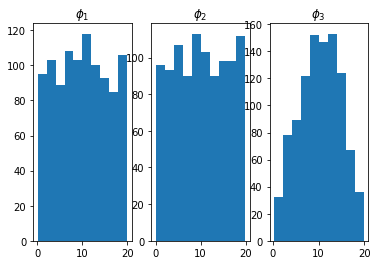

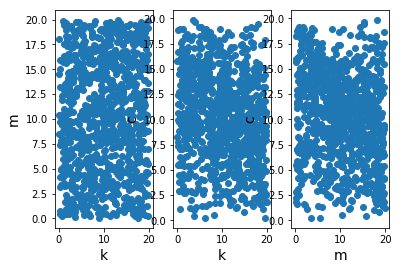

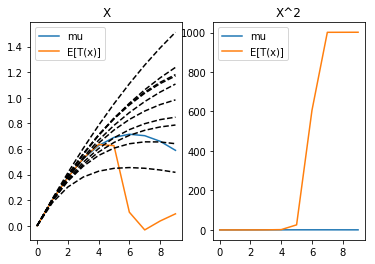

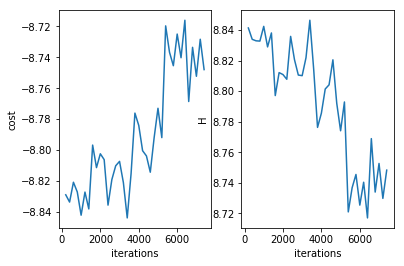

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 7600 
H 8.75116601781646
cost -8.75114358374229
system.D 3


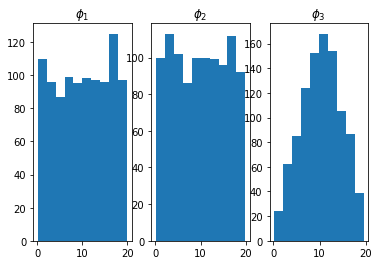

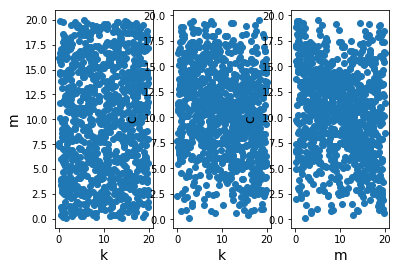

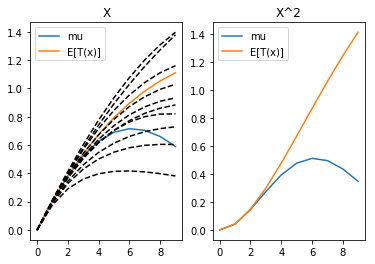

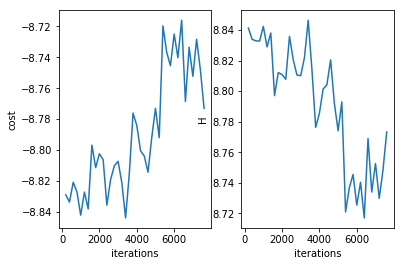

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 7800 
H 8.773687601730868
cost -8.773665297434075
system.D 3


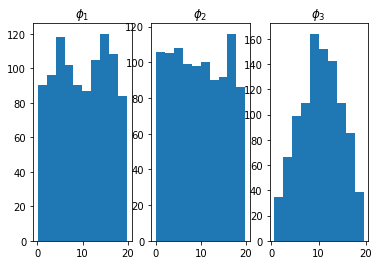

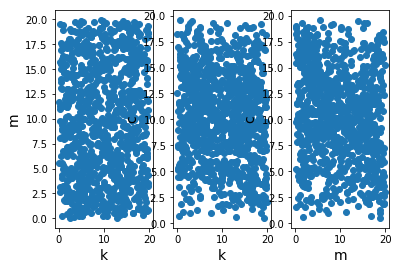

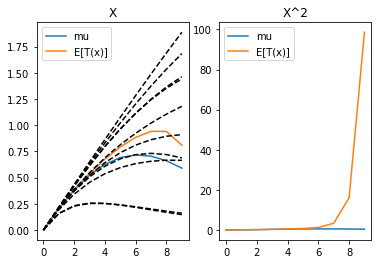

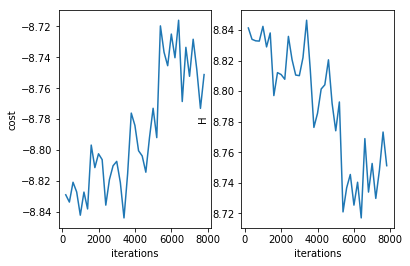

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 8000 
H 8.77440334181402
cost -8.774379698964553
system.D 3


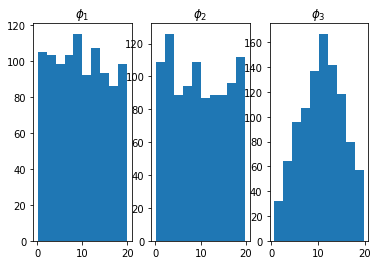

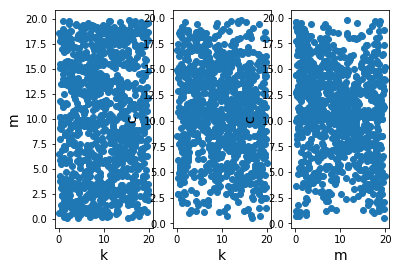

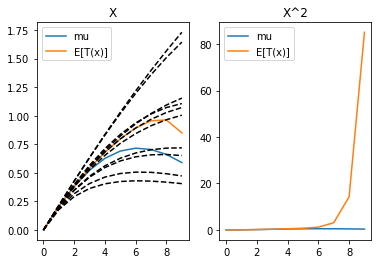

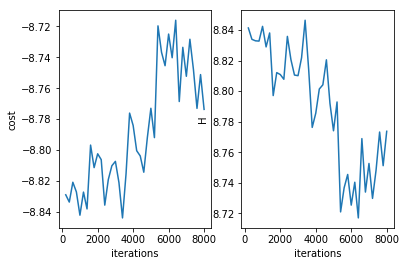

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 8200 
H 8.73426956133344
cost -8.734243379247877
system.D 3


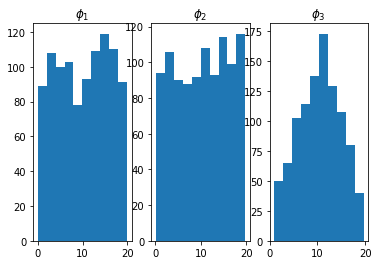

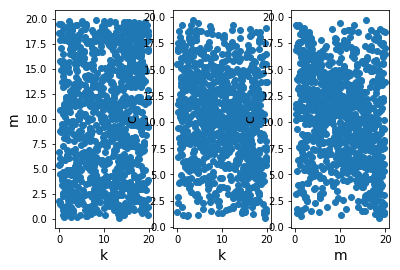

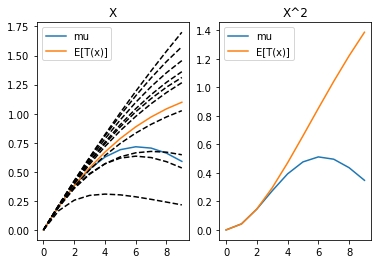

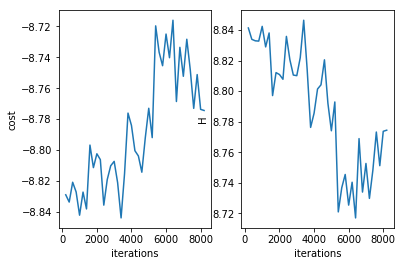

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 8400 
H 8.786682645485142
cost -8.786659522333755
system.D 3


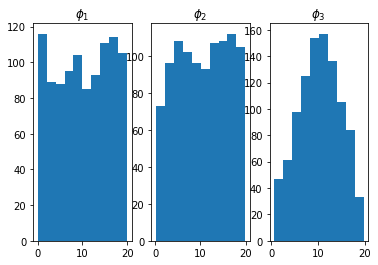

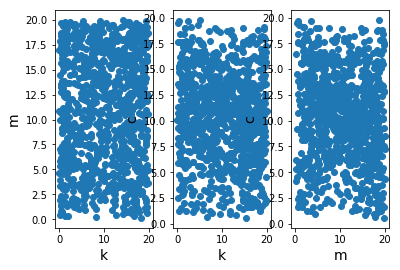

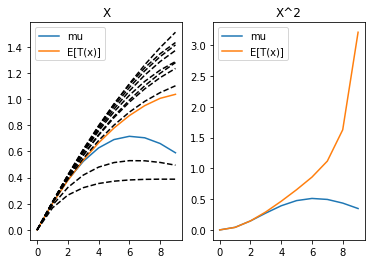

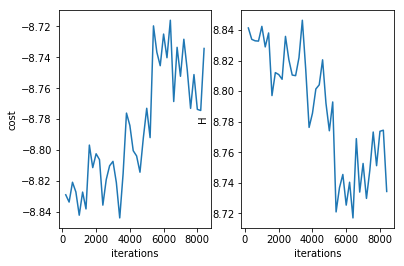

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 8600 
H 8.800437929235683
cost -8.800009419990142
system.D 3


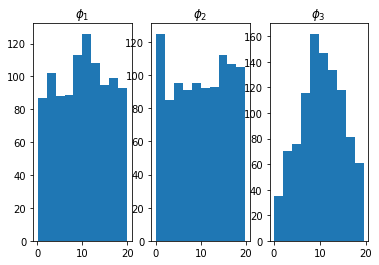

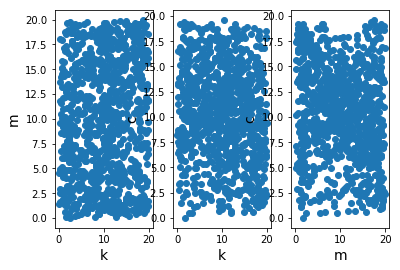

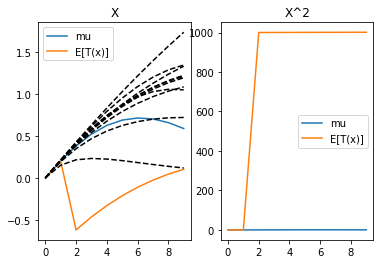

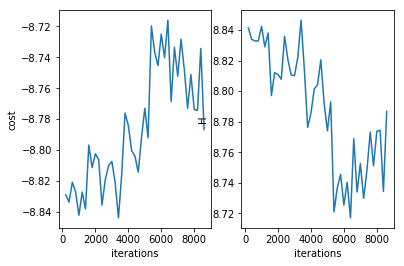

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 8800 
H 8.79819972210432
cost -8.797819687090621
system.D 3


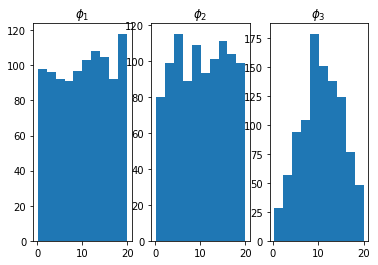

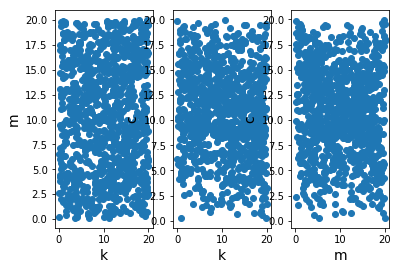

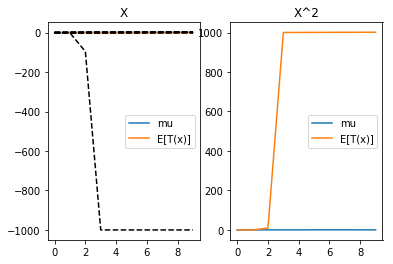

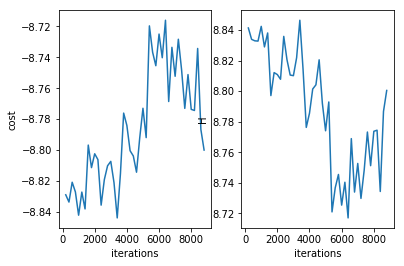

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 9000 
H 8.800635216626816
cost -8.800606556025404
system.D 3


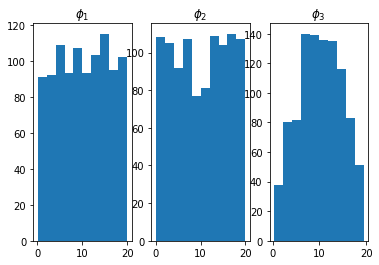

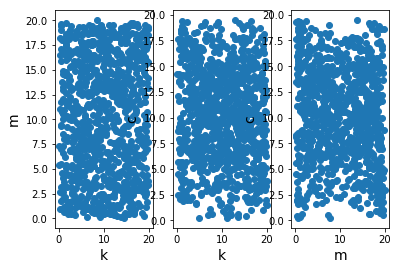

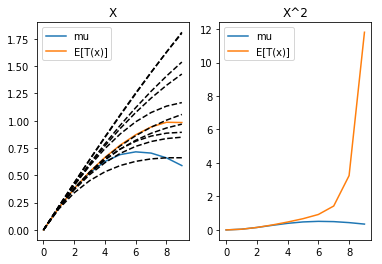

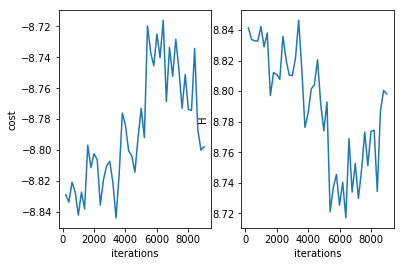

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 9200 
H 8.765264115889797
cost -8.764999912405566
system.D 3


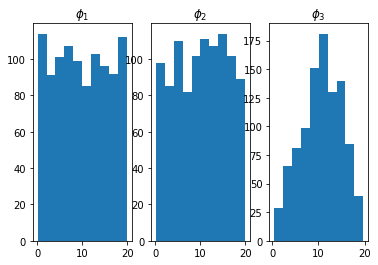

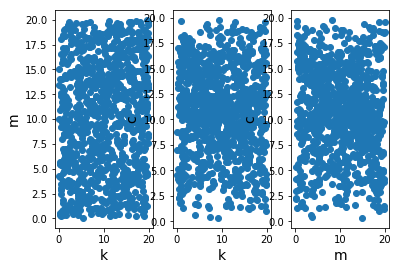

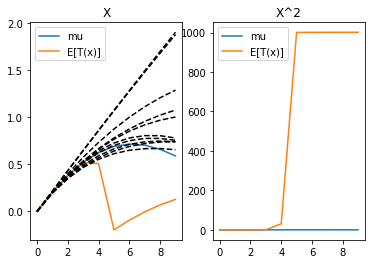

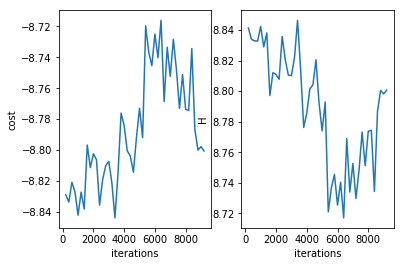

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 9400 
H 8.778450344325195
cost -8.77818596544612
system.D 3


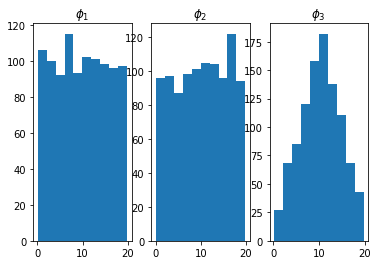

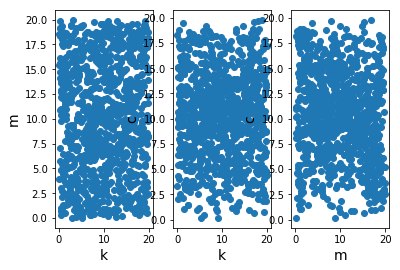

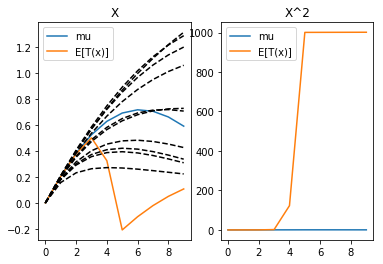

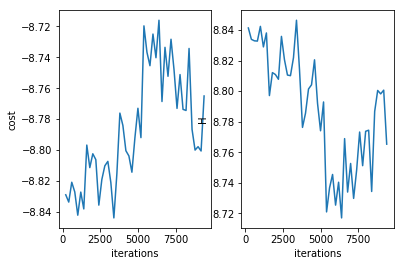

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 9600 
H 8.800306153748961
cost -8.793062450238716
system.D 3


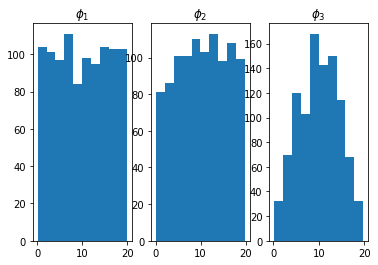

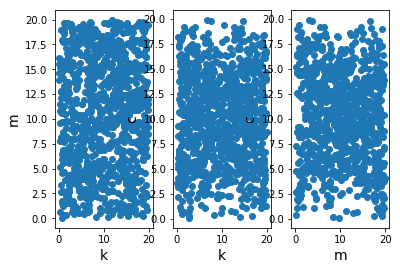

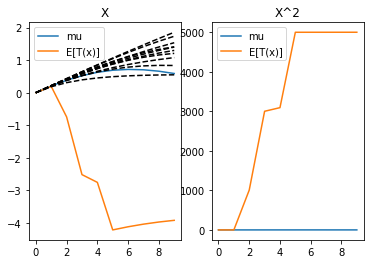

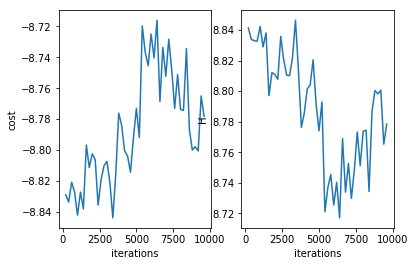

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 9800 
H 8.763836064418694
cost -8.763820226345574
system.D 3


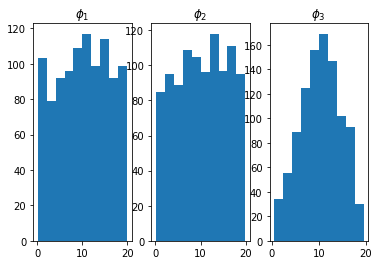

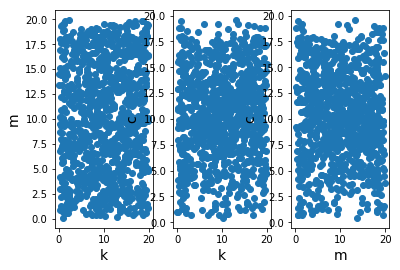

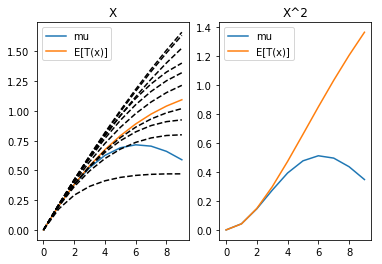

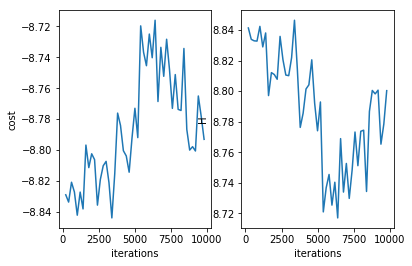

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 10000 
H 8.797730841019929
cost -8.797512656462864
system.D 3


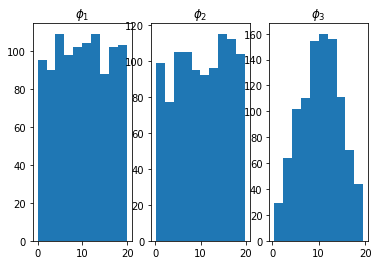

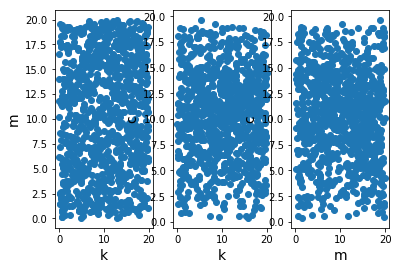

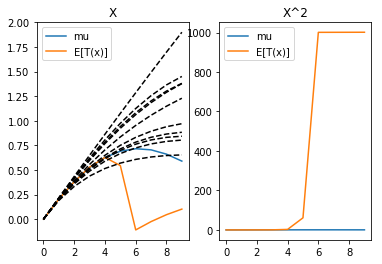

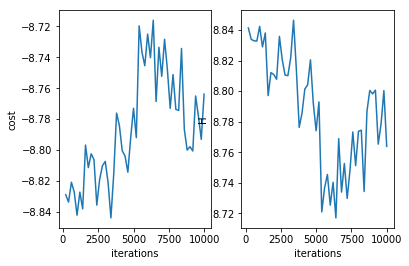

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
Doubling memory allocation for parameter logging.
saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/
AL iteration 2
resetting optimizer
aug lag it 1
lambda [ 0.00000000e+00 -2.62263590e-12 -1.12498387e-10 -2.09238067e-10
 -2.75377100e-10 -3.96876933e-10 -3.96089154e-10 -4.06856776e-10
 -4.61350206e-10 -4.57519954e-10 -1.00000000e-14  2.50722161e-11
  1.01025240e-07  2.00334609e-07  2.31311931e-07  4.00075580e-07
  4.00714525e-07  4.07705765e-07  4.85542989e-07  5.00120234e-07]
c 4e-10
saving model at iter 0
******************************************
it = 10200 
H 8.94457021152868
cost -8.926157347607361
system.D 3


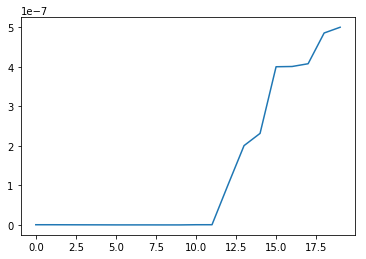

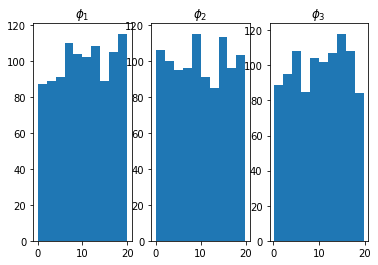

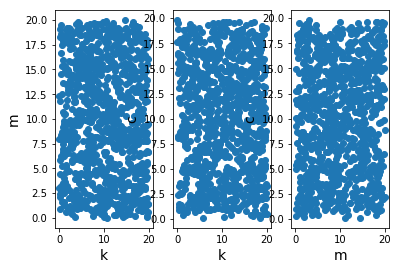

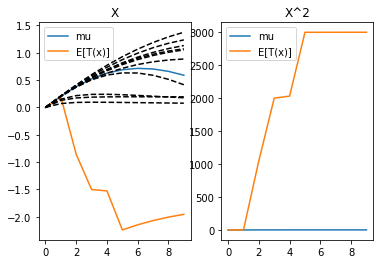

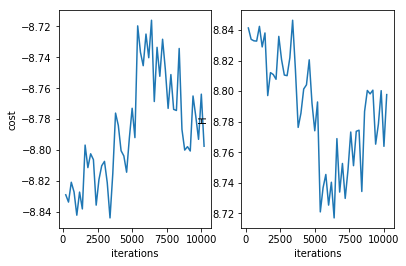

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 10400 
H 8.944064995439389
cost -8.923795283724235
system.D 3


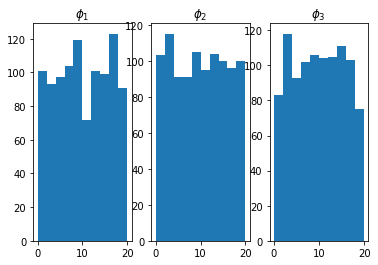

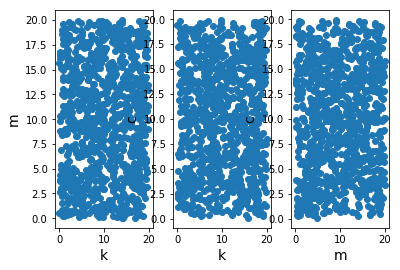

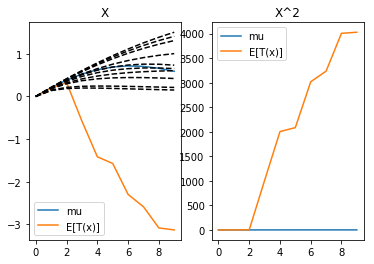

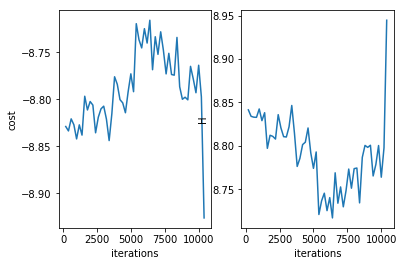

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 10600 
H 8.94566273208997
cost -8.896682787244972
system.D 3


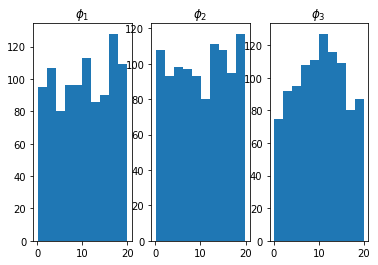

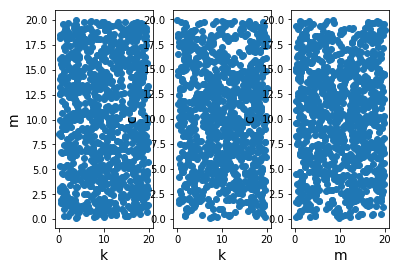

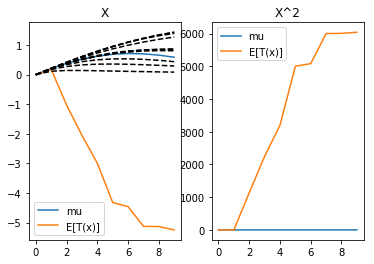

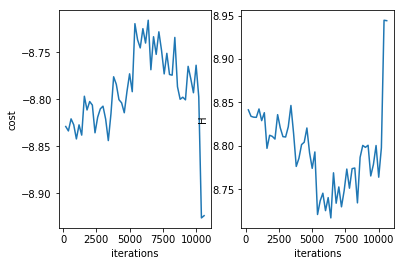

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 10800 
H 8.938076493970044
cost -8.915353368293877
system.D 3


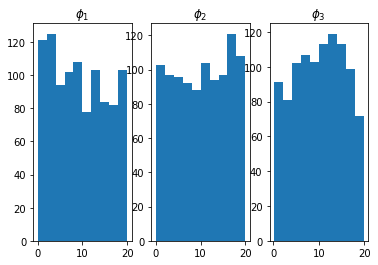

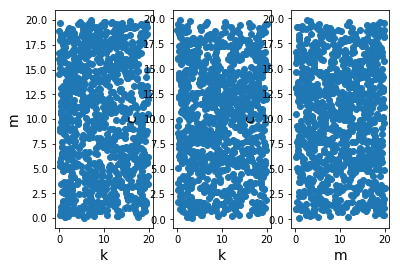

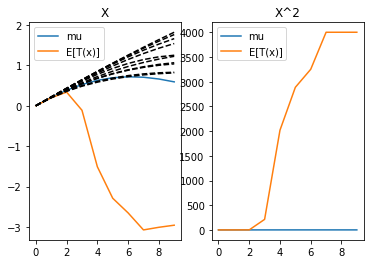

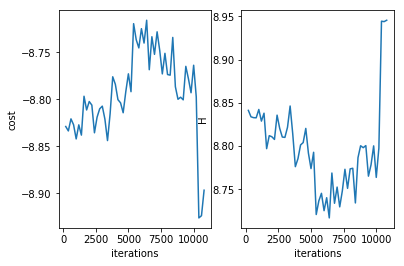

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 11000 
H 8.931768727956896
cost -8.921263650433598
system.D 3


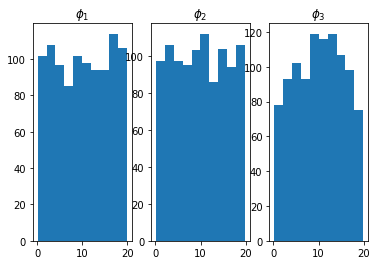

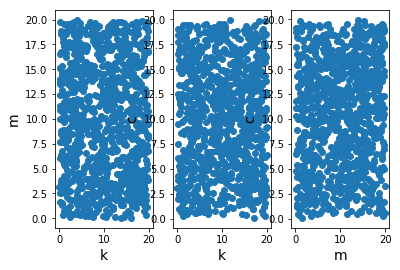

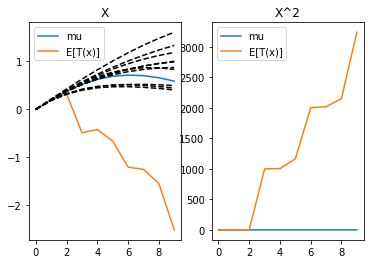

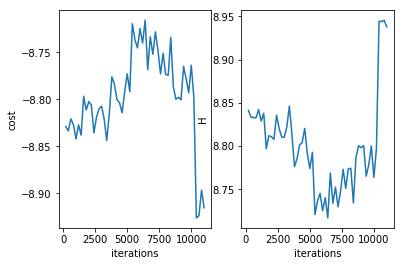

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 11200 
H 8.93893339892168
cost -8.935298621655795
system.D 3


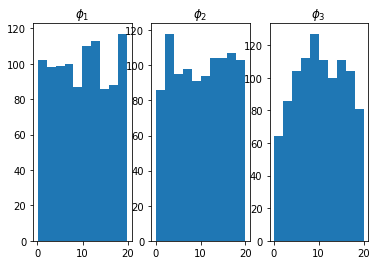

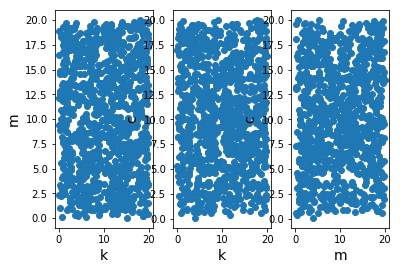

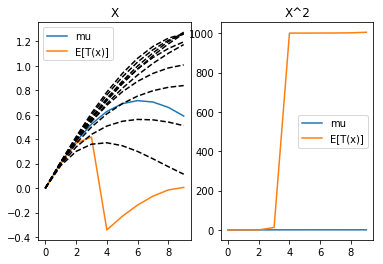

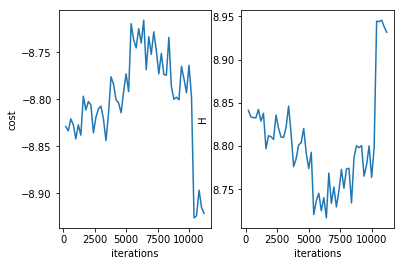

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 11400 
H 8.93456473829478
cost -8.902864991496061
system.D 3


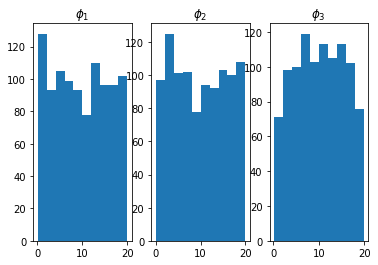

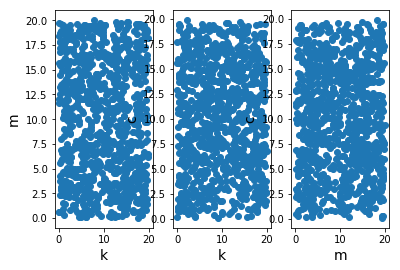

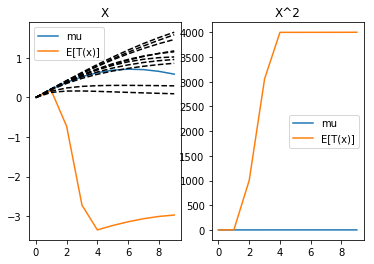

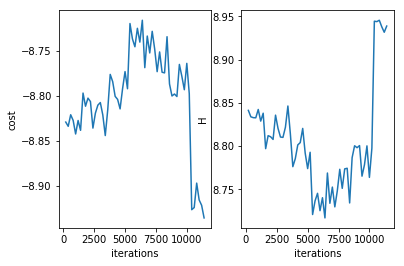

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 11600 
H 8.94079692102287
cost -8.929565532230379
system.D 3


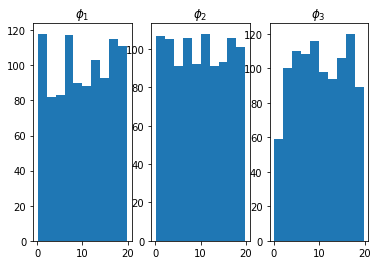

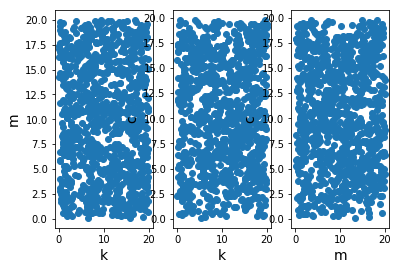

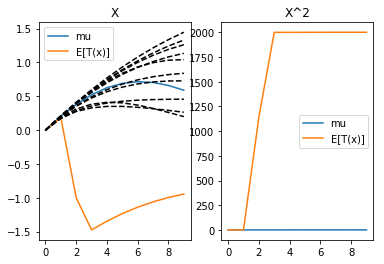

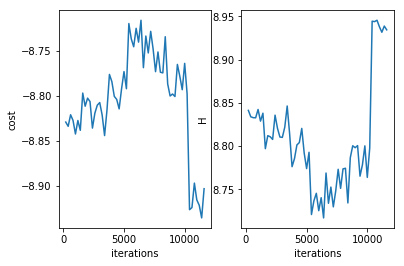

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 11800 
H 8.924393239432701
cost -8.915292410455717
system.D 3


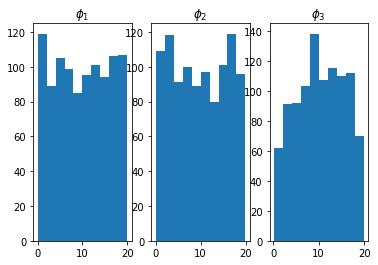

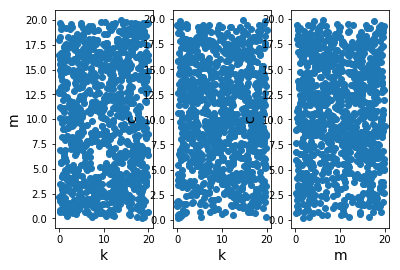

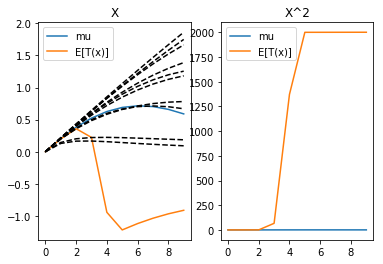

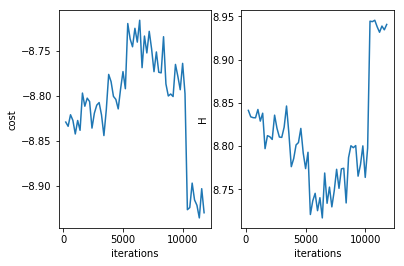

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 12000 
H 8.92964774501472
cost -8.91570880038148
system.D 3


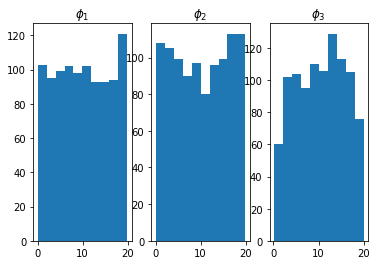

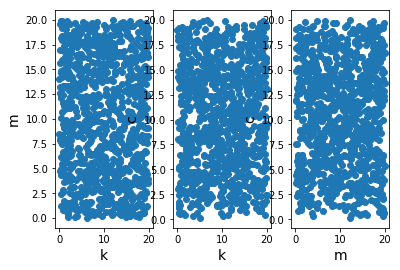

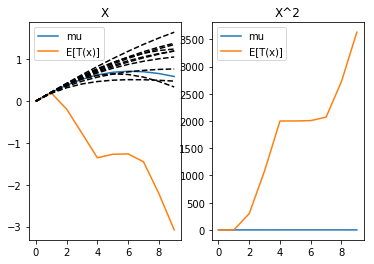

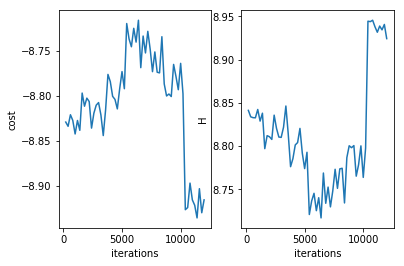

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 12200 
H 8.945370842197324
cost -8.9453685859941
system.D 3


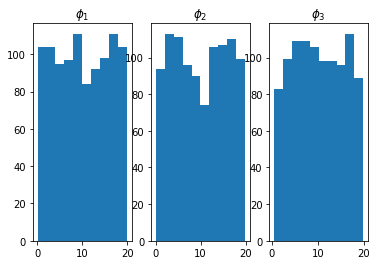

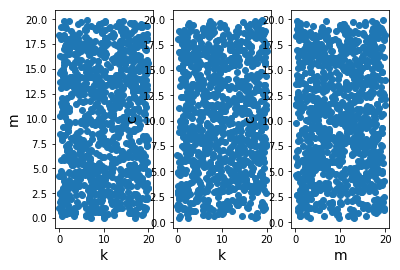

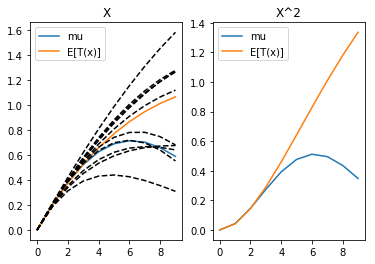

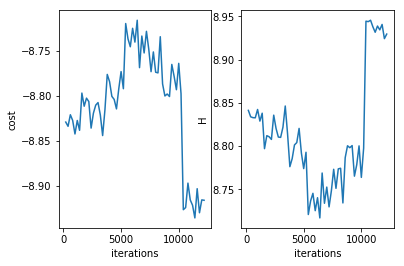

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 12400 
H 8.92821764807698
cost -8.906721610545665
system.D 3


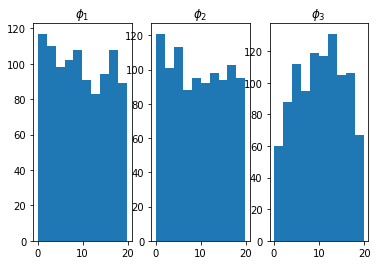

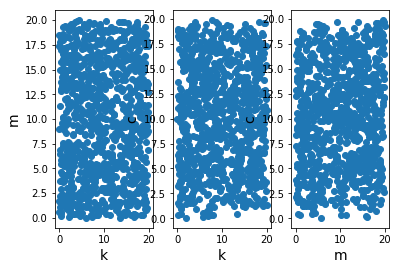

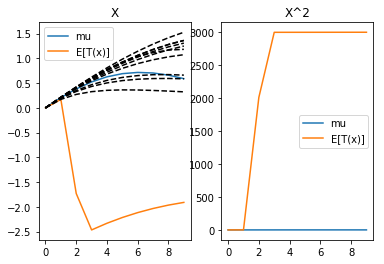

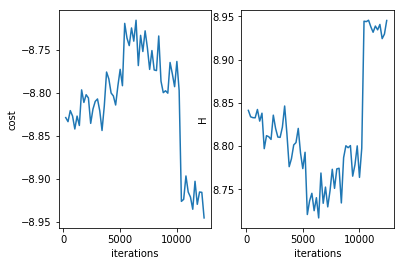

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 12600 
H 8.928709845350086
cost -8.92467508270844
system.D 3


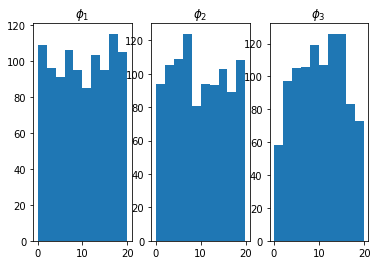

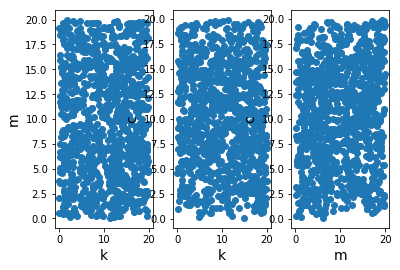

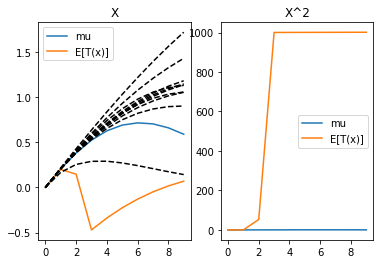

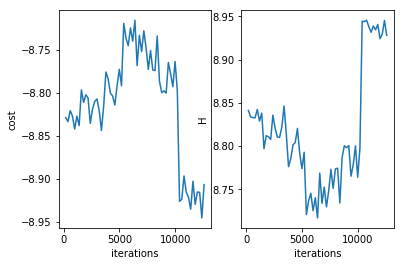

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 12800 
H 8.916307234346318
cost -8.883685461621045
system.D 3


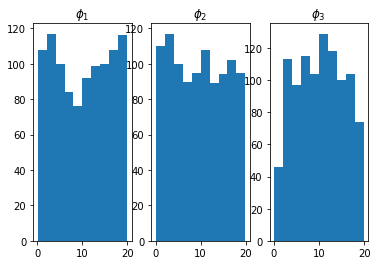

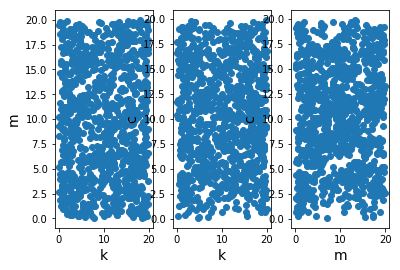

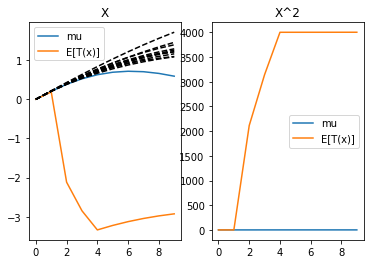

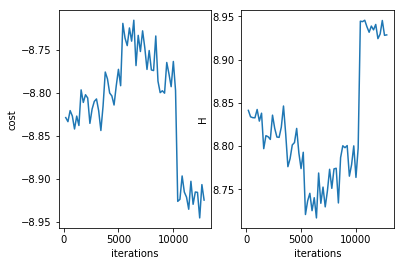

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 13000 
H 8.916249622961725
cost -8.906596095661099
system.D 3


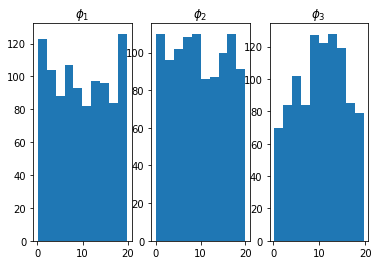

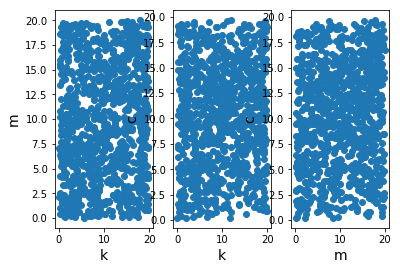

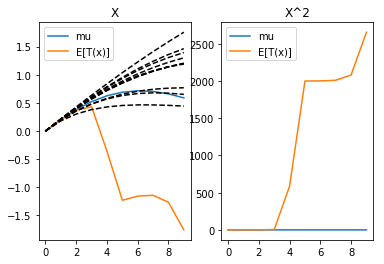

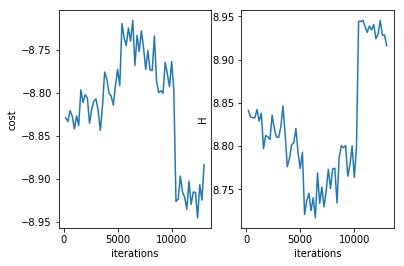

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 13200 
H 8.894867267037615
cost -8.894864089650804
system.D 3


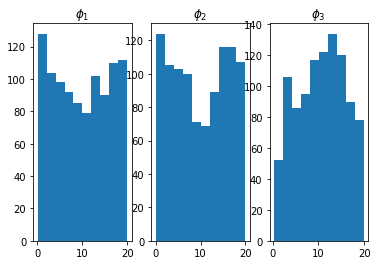

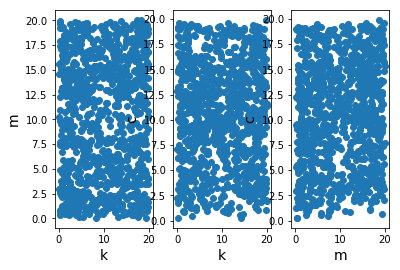

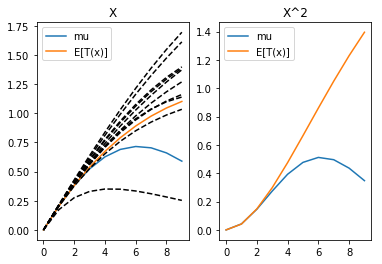

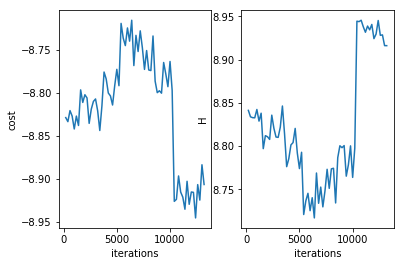

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 13400 
H 8.895777530291719
cost -8.885703485097416
system.D 3


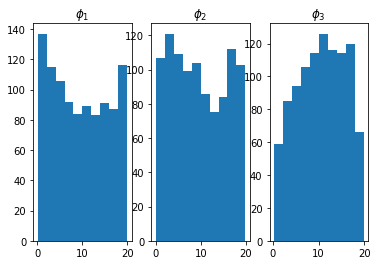

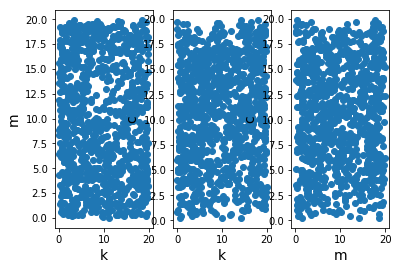

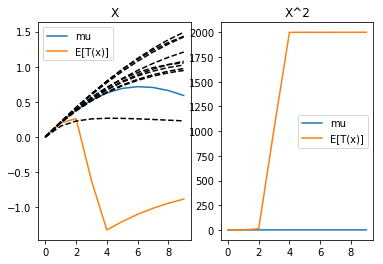

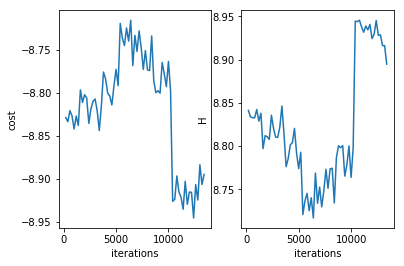

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 13600 
H 8.897931480155888
cost -8.89792809018795
system.D 3


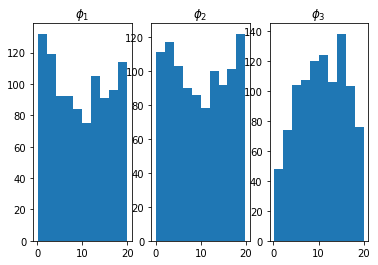

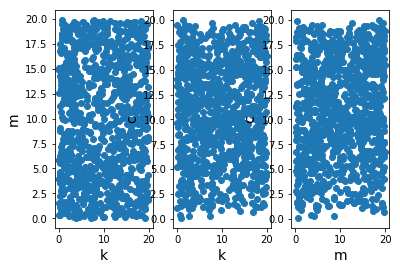

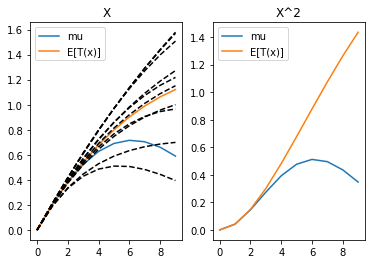

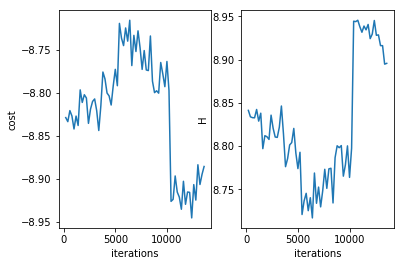

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 13800 
H 8.888710497507637
cost -8.88652936286097
system.D 3


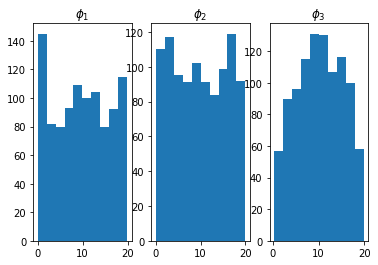

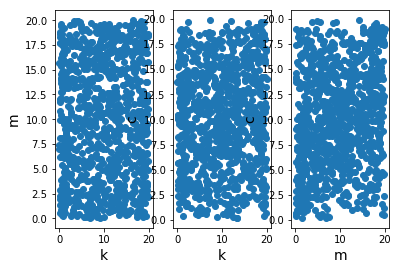

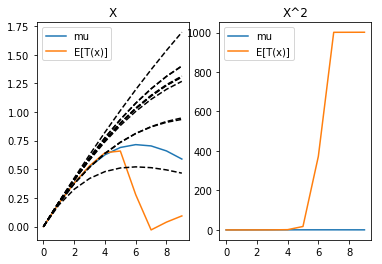

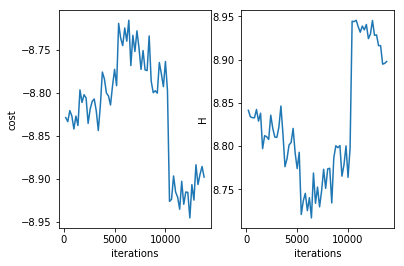

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 14000 
H 8.915292283828952
cost -8.911654304405163
system.D 3


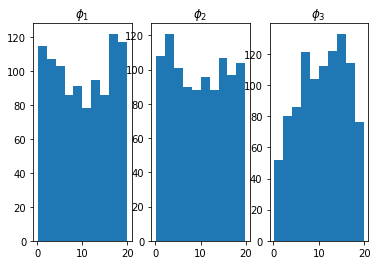

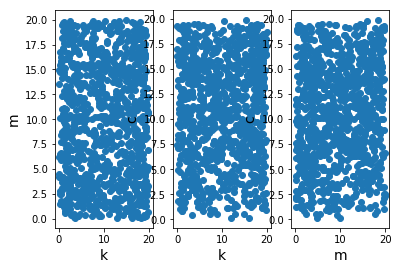

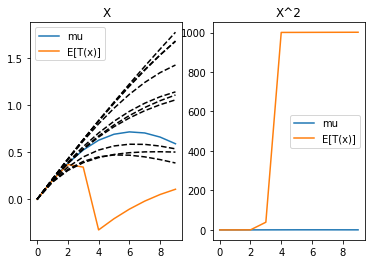

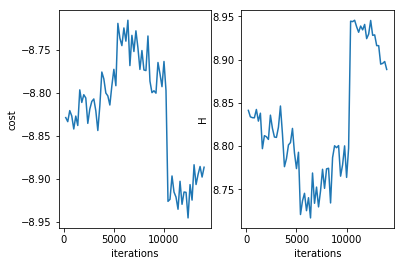

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 14200 
H 8.89428822118664
cost -8.894284680676092
system.D 3


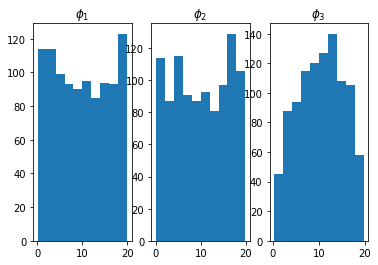

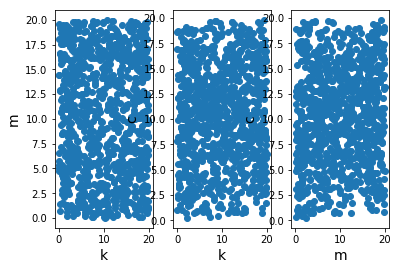

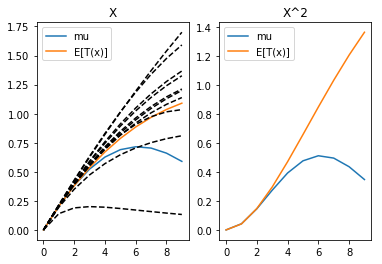

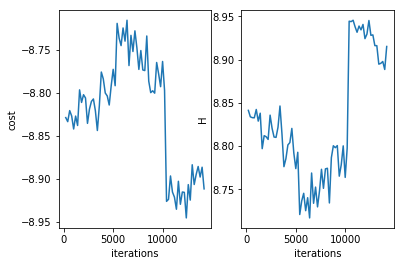

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 14400 
H 8.904587249299496
cost -8.903055274291535
system.D 3


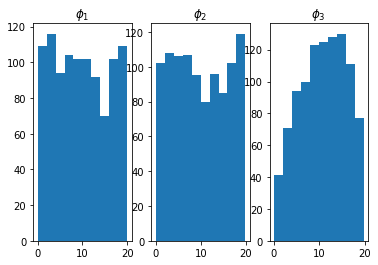

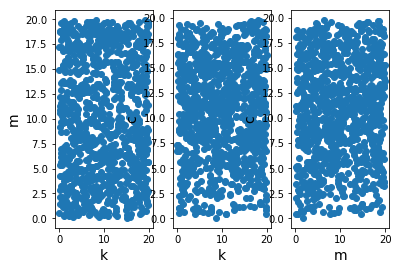

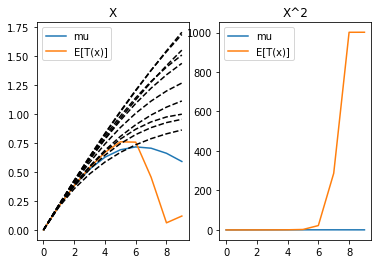

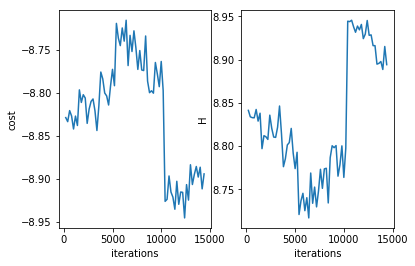

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 14600 
H 8.890131556372625
cost -8.890120895079173
system.D 3


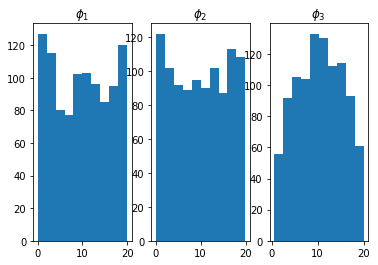

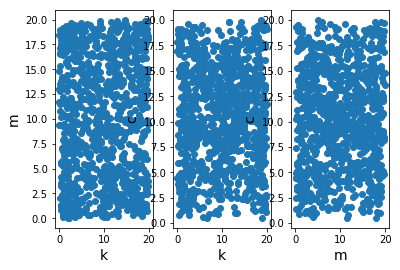

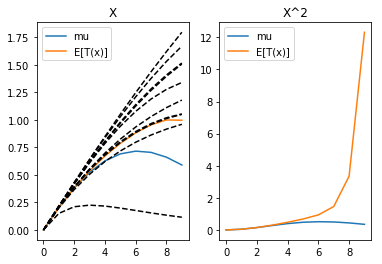

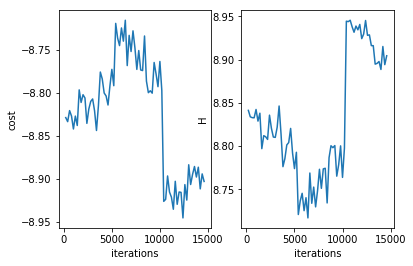

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 14800 
H 8.896805643860887
cost -8.89680126580678
system.D 3


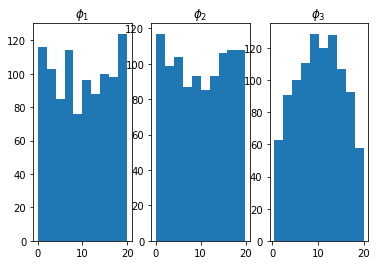

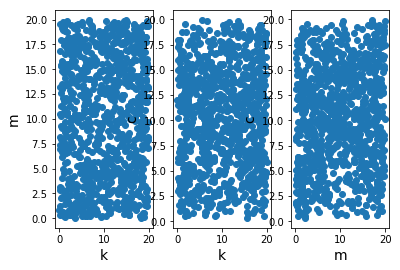

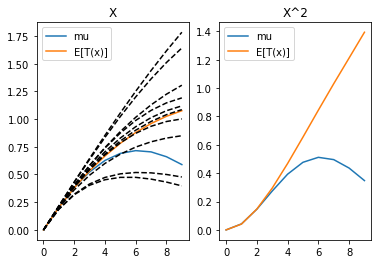

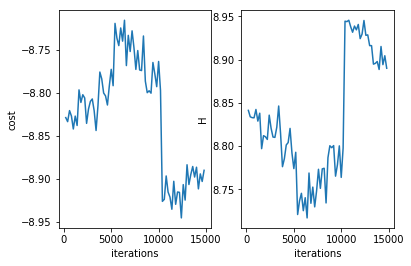

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 15000 
H 8.869767969849923
cost -8.865435886640283
system.D 3


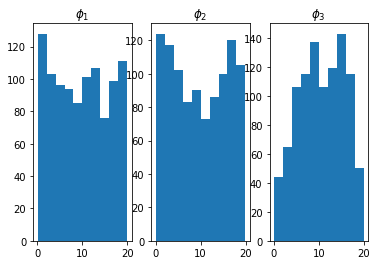

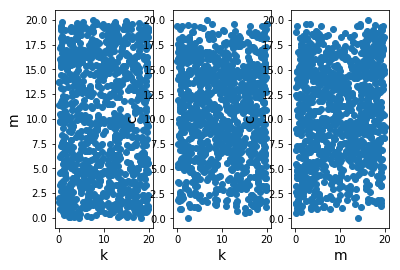

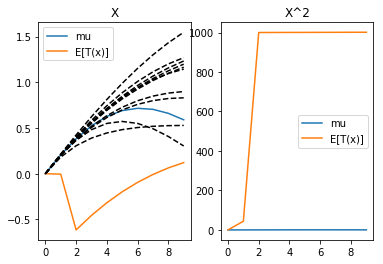

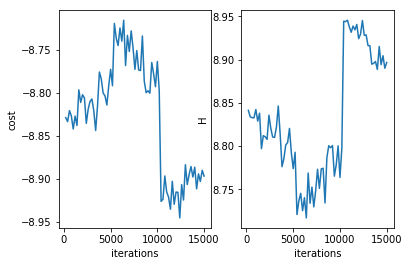

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 15200 
H 8.842423467773774
cost -8.83863376385956
system.D 3


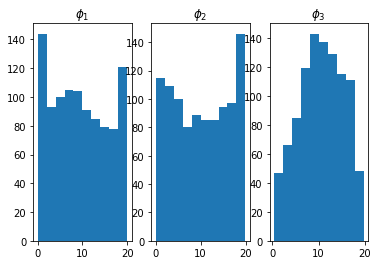

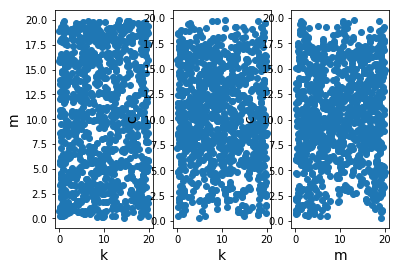

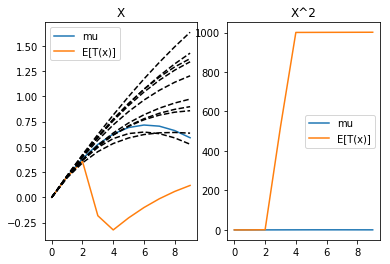

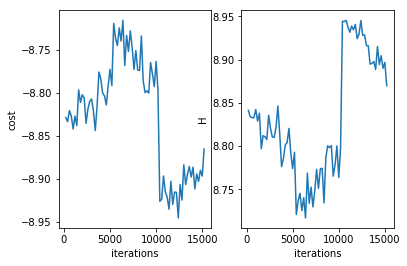

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 15400 
H 8.857036644738722
cost -8.852920874056272
system.D 3


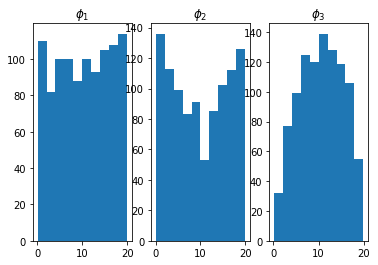

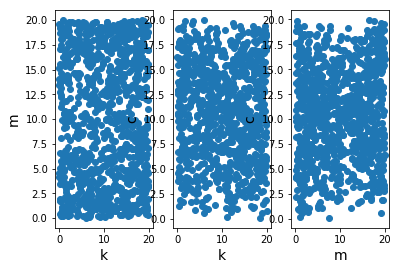

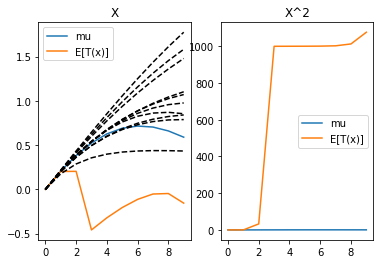

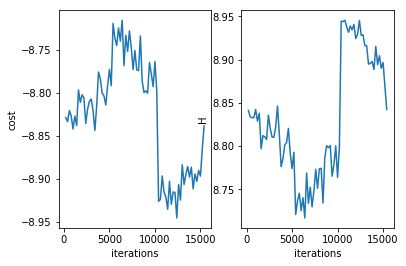

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 15600 
H 8.861291187591474
cost -8.85899801494171
system.D 3


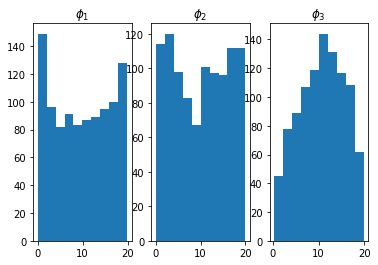

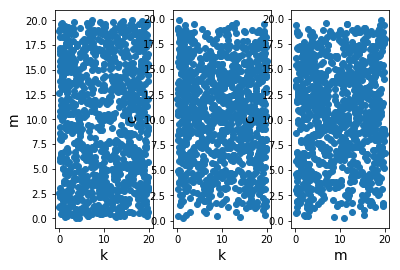

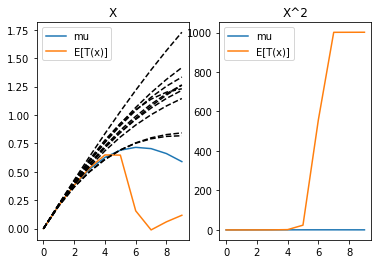

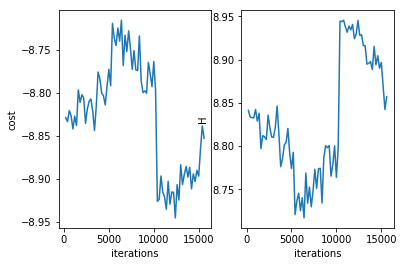

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 15800 
H 8.86557107891259
cost -8.862802628395794
system.D 3


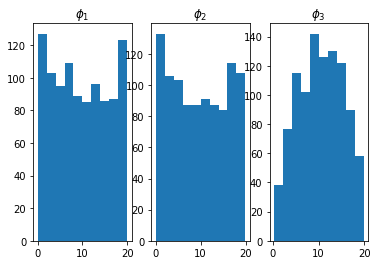

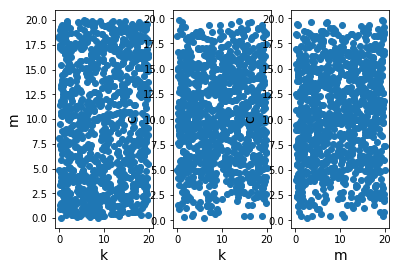

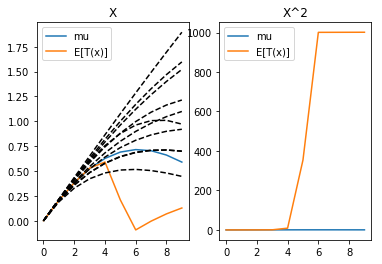

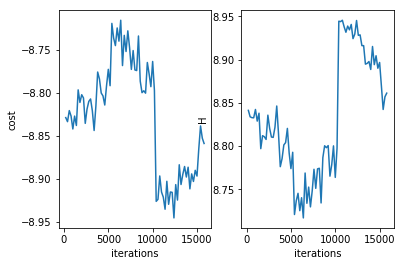

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 16000 
H 8.844556123053026
cost -8.844551275411687
system.D 3


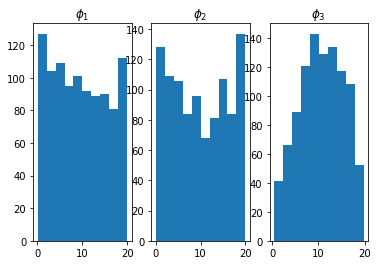

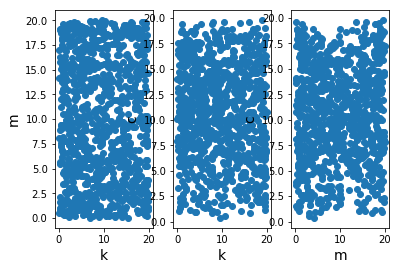

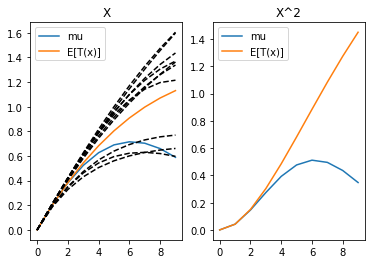

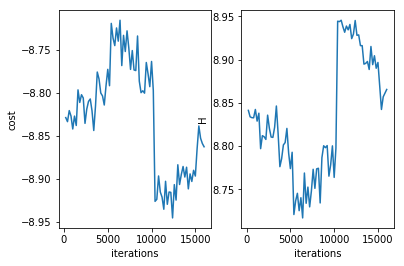

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 16200 
H 8.874853237360604
cost -8.873912782142213
system.D 3


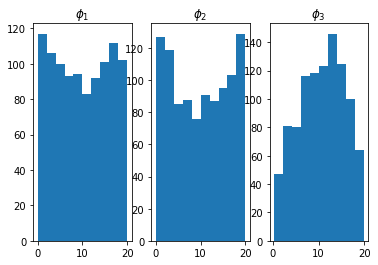

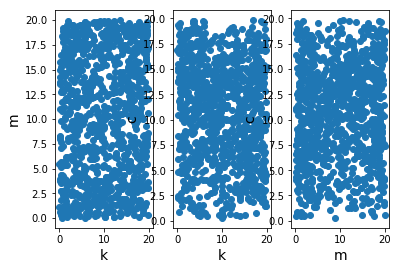

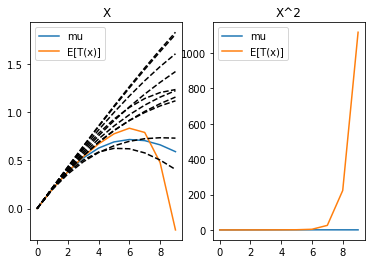

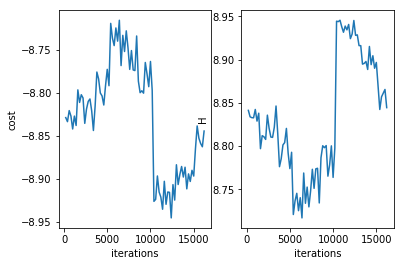

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 16400 
H 8.83952193335988
cost -8.835879707740819
system.D 3


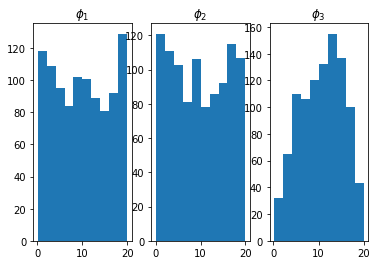

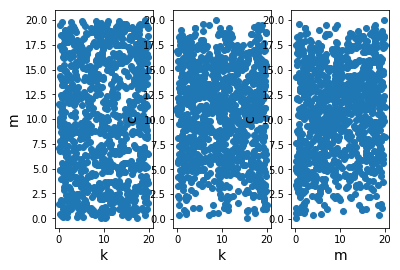

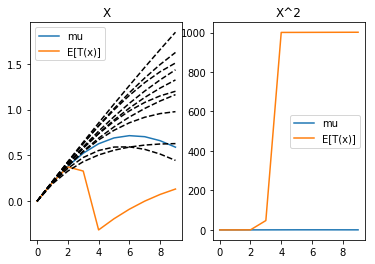

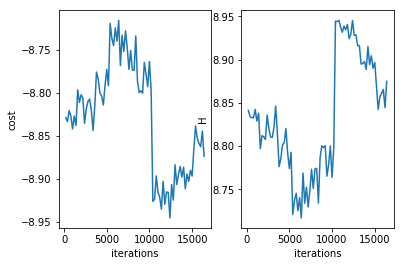

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 16600 
H 8.864673445955086
cost -8.860891463549592
system.D 3


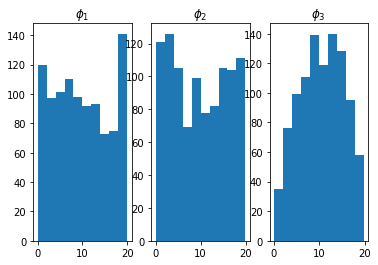

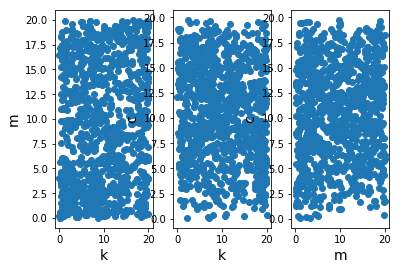

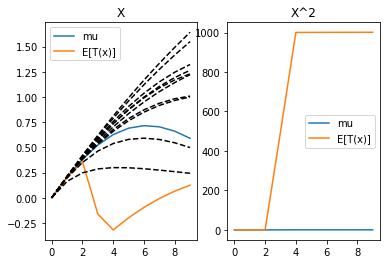

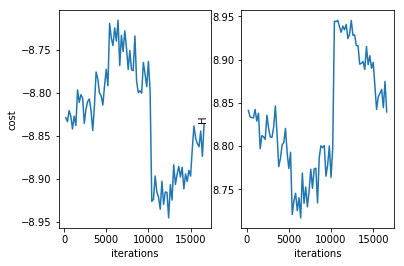

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 16800 
H 8.851401713237308
cost -8.851394708552814
system.D 3


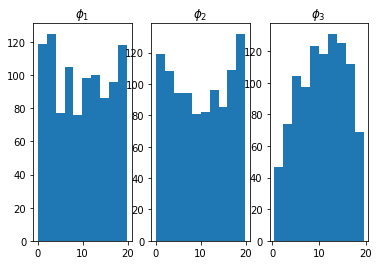

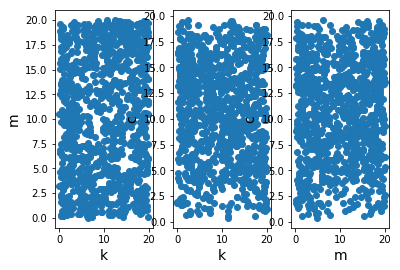

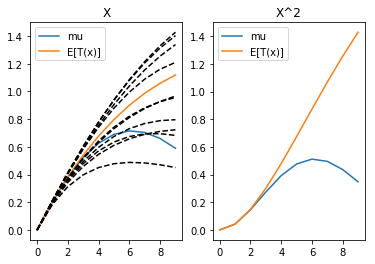

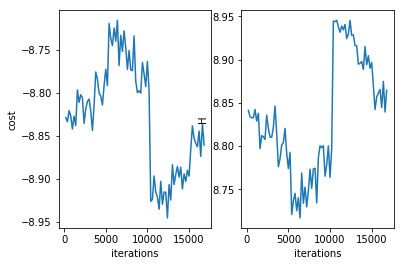

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 17000 
H 8.859233114627608
cost -8.859218299633321
system.D 3


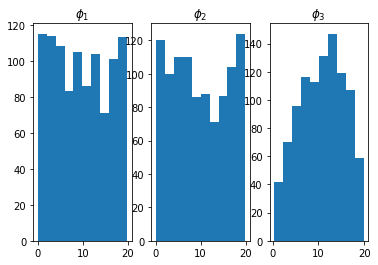

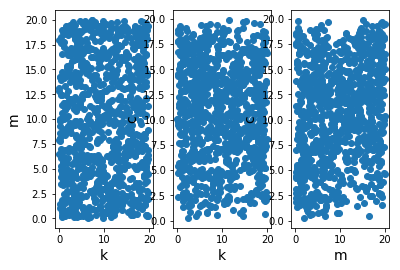

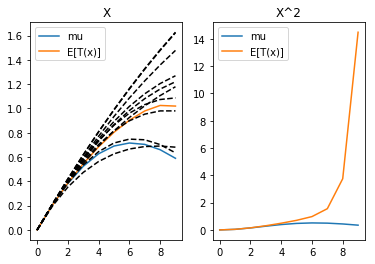

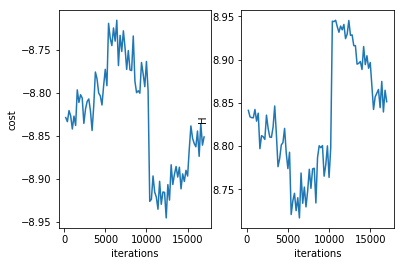

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 17200 
H 8.84360270295471
cost -8.843594622052924
system.D 3


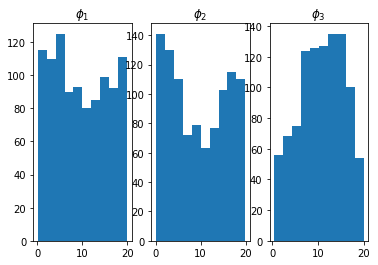

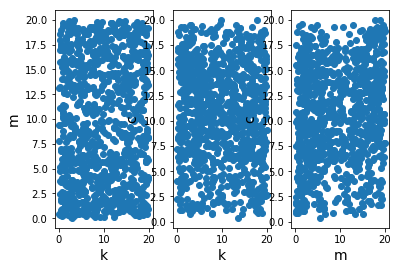

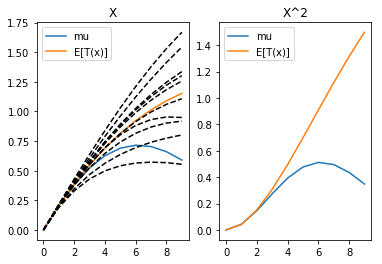

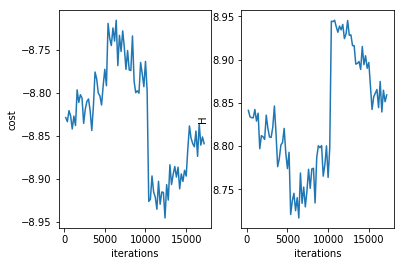

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 17400 
H 8.854344977281134
cost -8.850664623249479
system.D 3


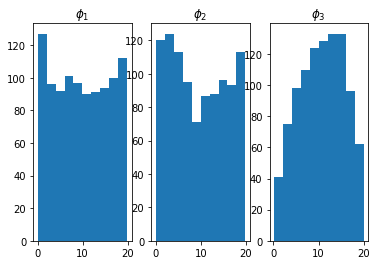

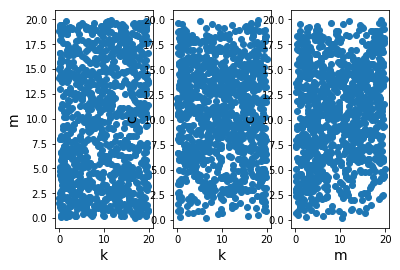

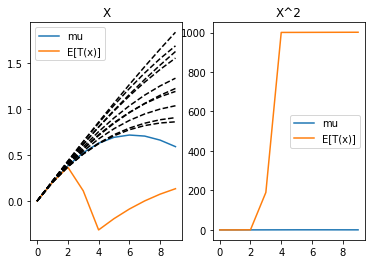

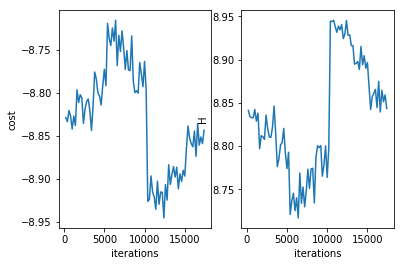

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 17600 
H 8.861993527368952
cost -8.852587236286556
system.D 3


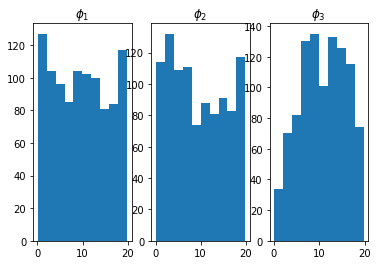

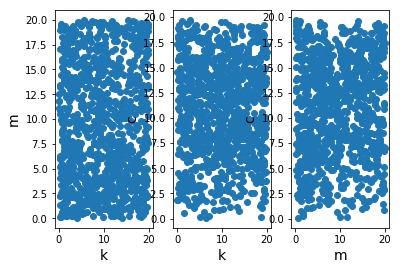

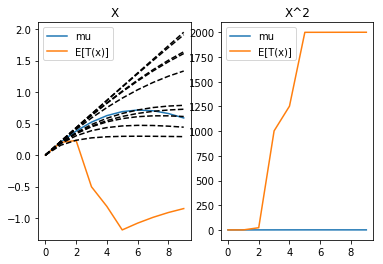

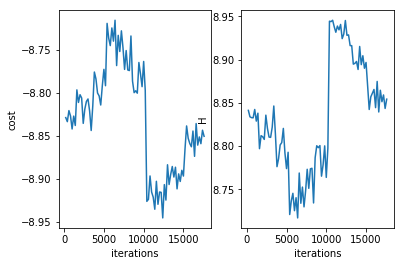

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 17800 
H 8.838142640940845
cost -8.838132563407017
system.D 3


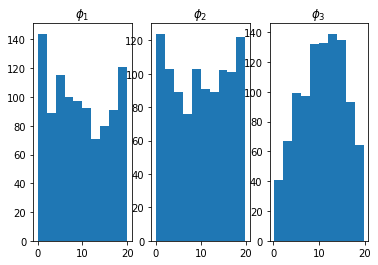

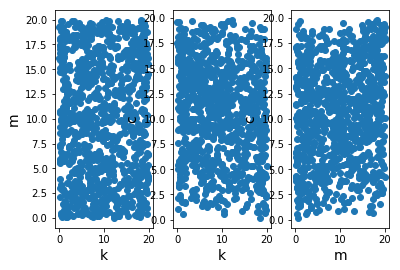

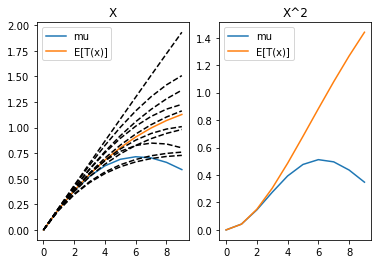

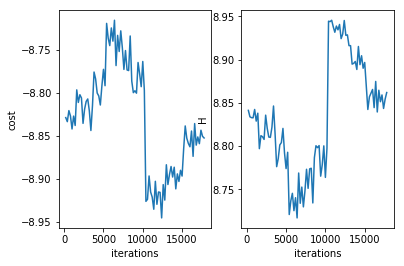

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 18000 
H 8.854095206883652
cost -8.854085381483504
system.D 3


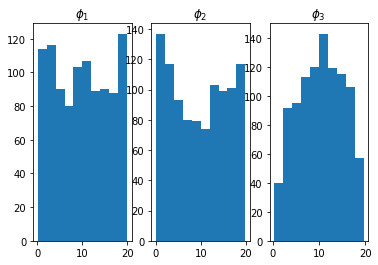

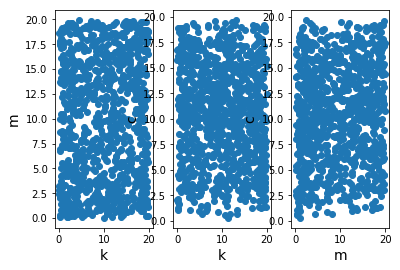

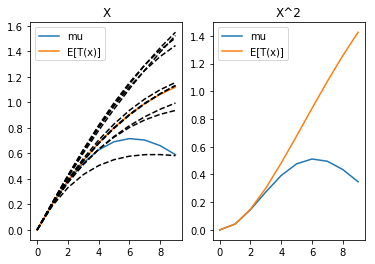

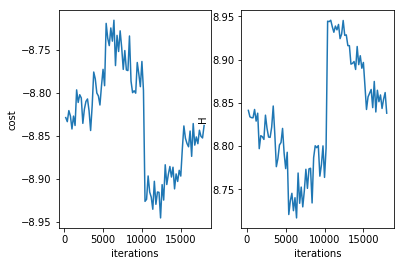

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 18200 
H 8.856882865440015
cost -8.852707980777149
system.D 3


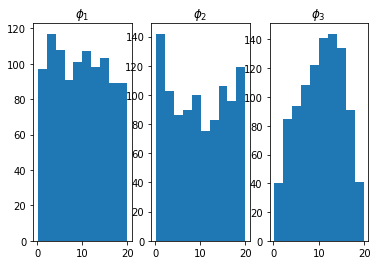

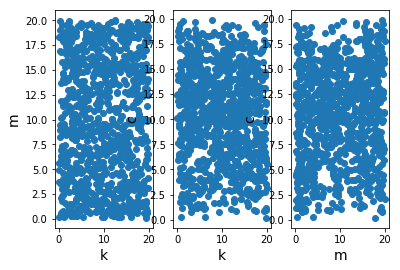

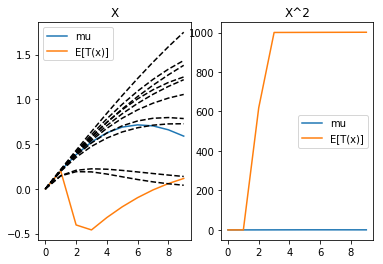

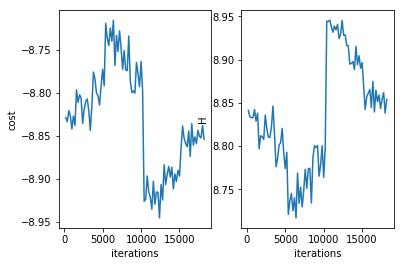

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 18400 
H 8.859867868287237
cost -8.859857450519954
system.D 3


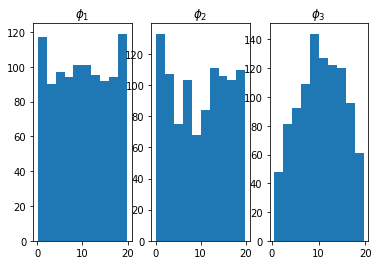

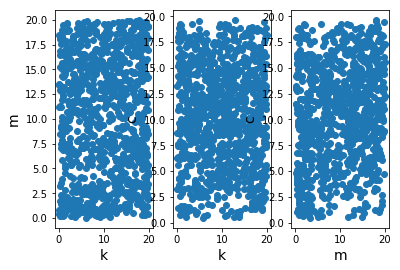

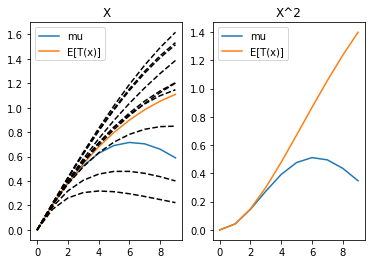

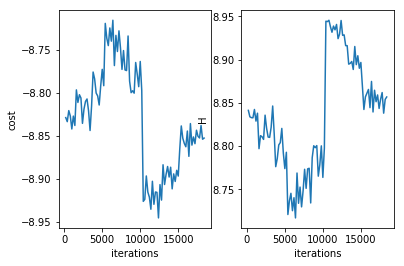

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 18600 
H 8.864743874489786
cost -8.86473198856686
system.D 3


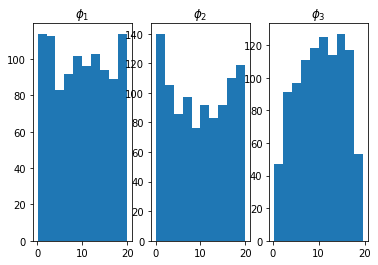

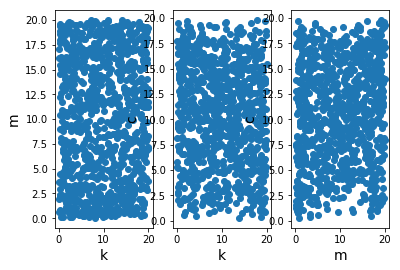

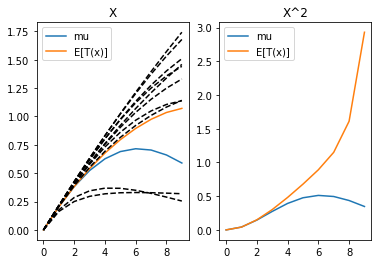

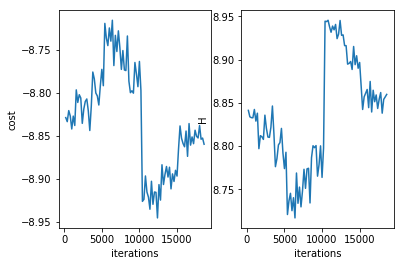

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 18800 
H 8.884719947889442
cost -8.861951636759395
system.D 3


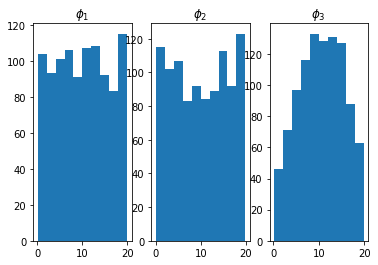

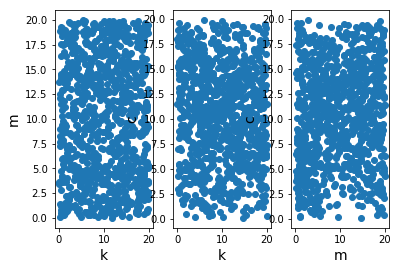

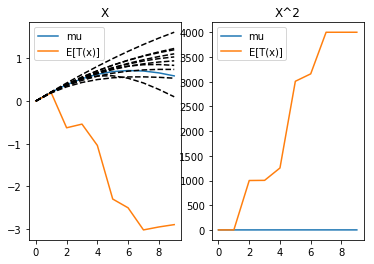

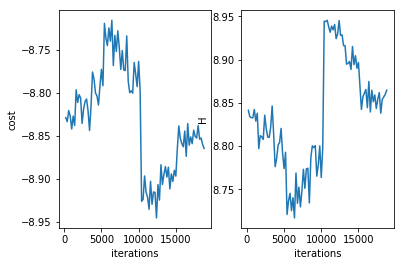

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 19000 
H 8.875906954280035
cost -8.866658677793435
system.D 3


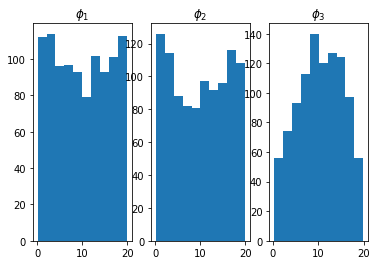

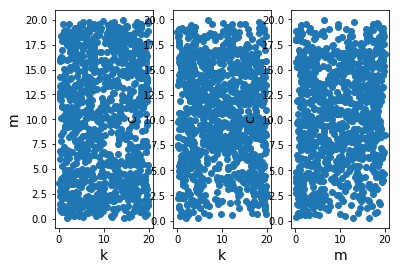

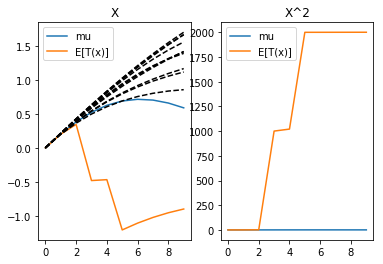

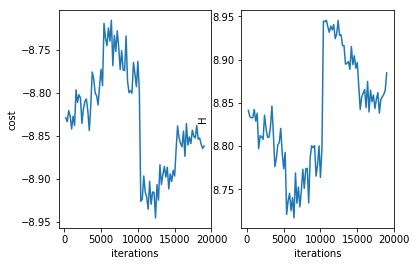

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 19200 
H 8.881261773678512
cost -8.880754409119966
system.D 3


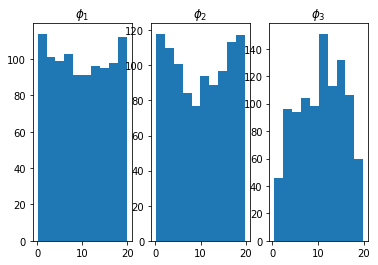

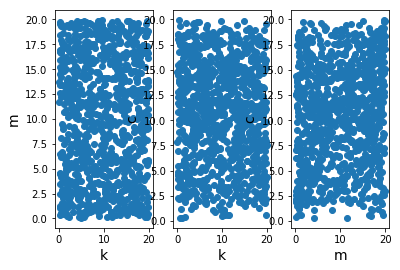

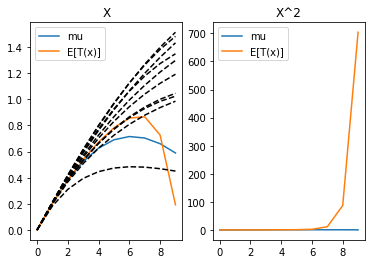

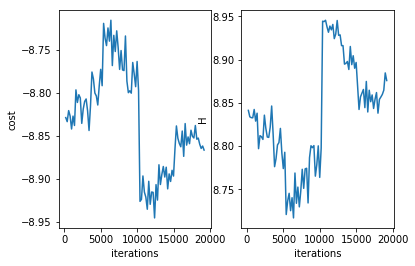

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 19400 
H 8.889257138533372
cost -8.873491363449387
system.D 3


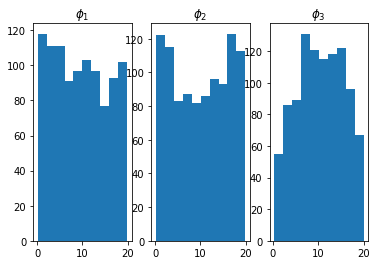

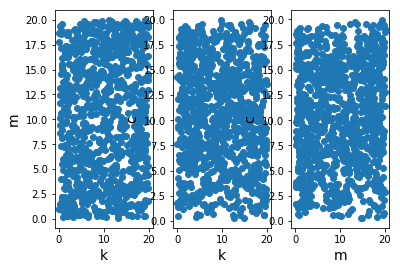

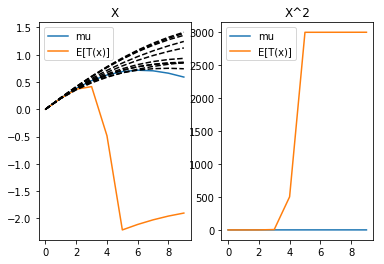

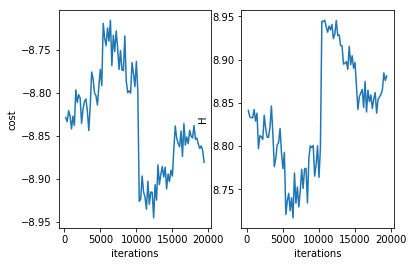

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 19600 
H 8.850193274768888
cost -8.850175122621327
system.D 3


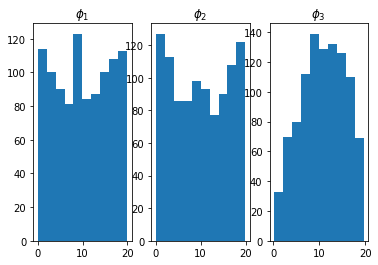

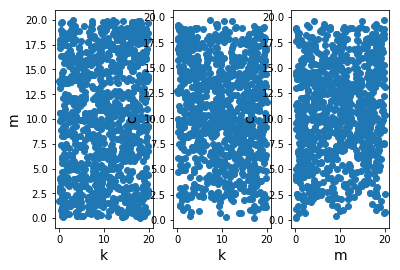

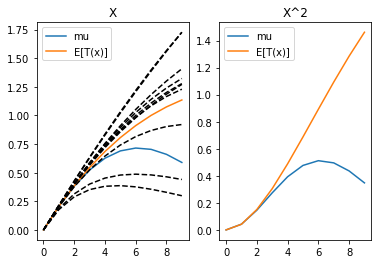

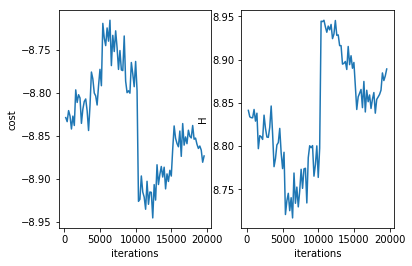

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 19800 
H 8.889823201580915
cost -8.884251468601196
system.D 3


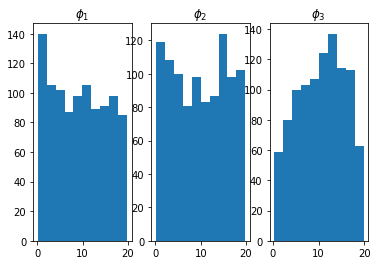

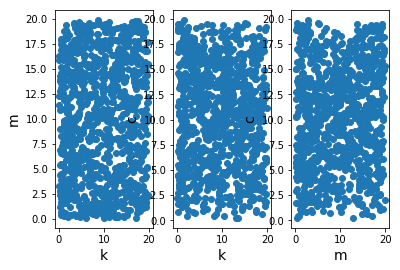

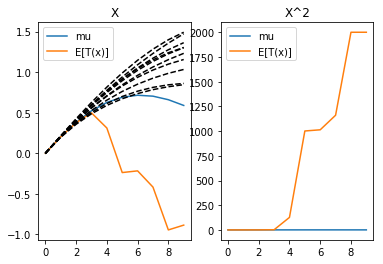

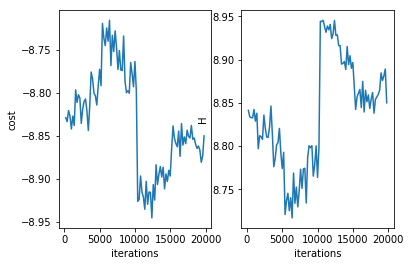

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 20000 
H 8.884980725972305
cost -8.881331807738254
system.D 3


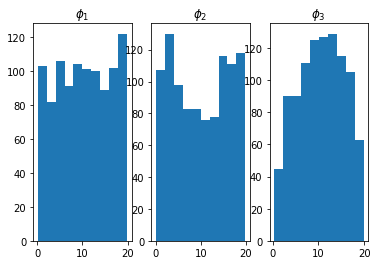

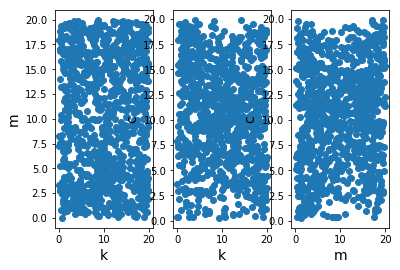

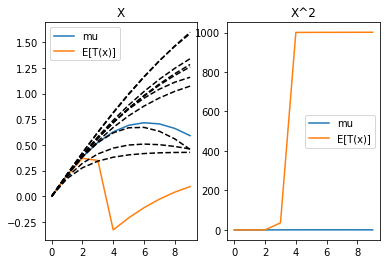

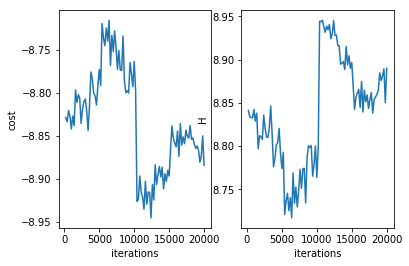

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
Doubling memory allocation for parameter logging.
saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/
AL iteration 3
resetting optimizer
aug lag it 2
lambda [ 0.00000000e+00 -1.31131795e-11 -5.62491937e-10 -1.04619033e-09
 -1.37688550e-09 -1.98438467e-09 -1.98044577e-09 -2.03428388e-09
 -2.30675103e-09 -2.28759977e-09 -5.00000000e-14  1.25361081e-10
  5.05126199e-07  1.00167304e-06  1.15655966e-06  2.00037790e-06
  2.00357263e-06  2.03852883e-06  2.42771495e-06  2.50060117e-06]
c 1.6e-09
saving model at iter 0
******************************************
it = 20200 
H 8.935713218756185
cost -8.844142322030995
system.D 3


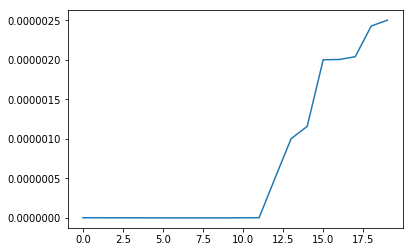

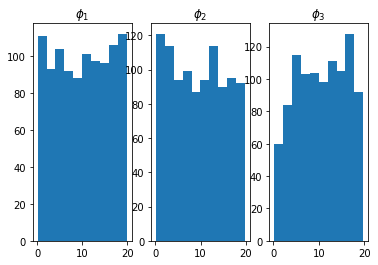

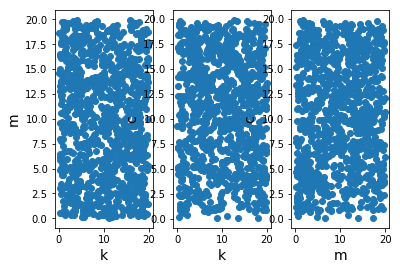

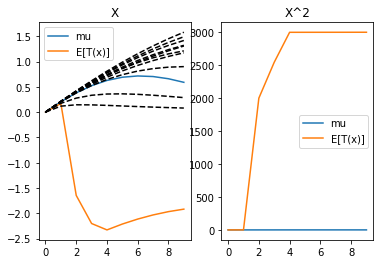

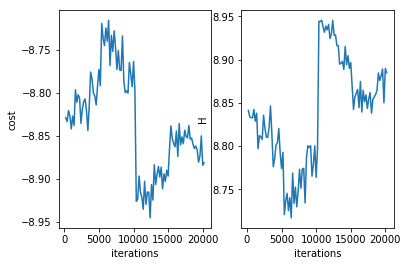

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 20400 
H 8.903354034696207
cost -8.903346225694586
system.D 3


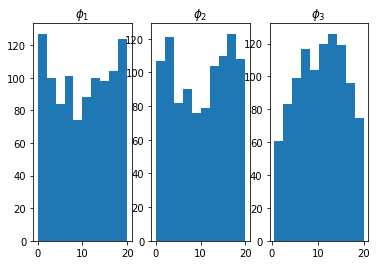

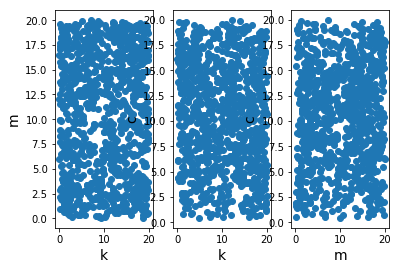

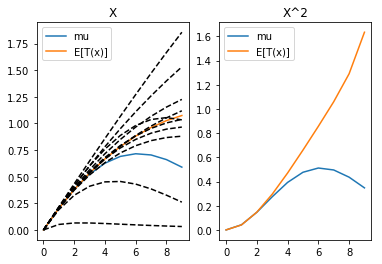

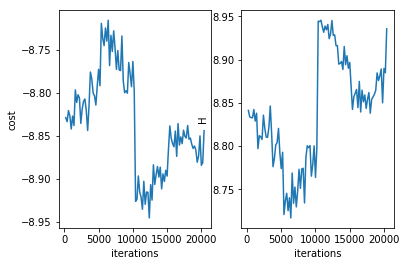

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 20600 
H 8.905555952054009
cost -8.791869539581779
system.D 3


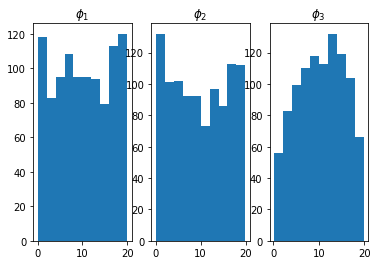

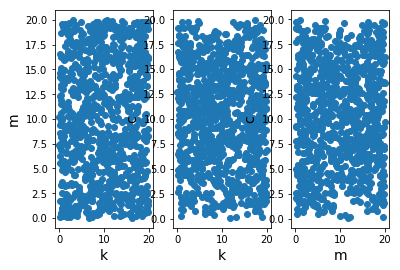

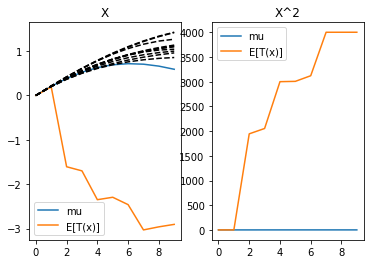

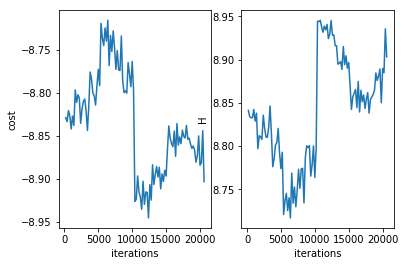

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 20800 
H 8.898926946460866
cost -8.874249033424489
system.D 3


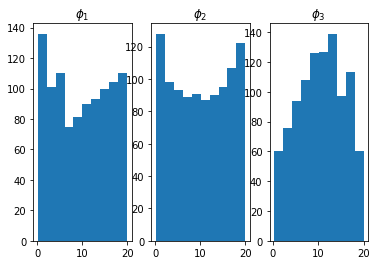

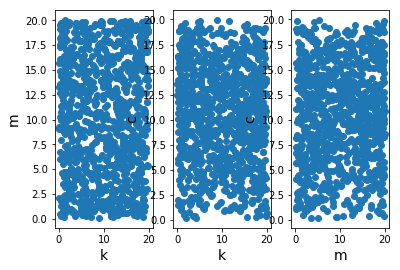

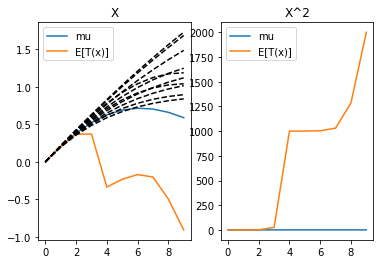

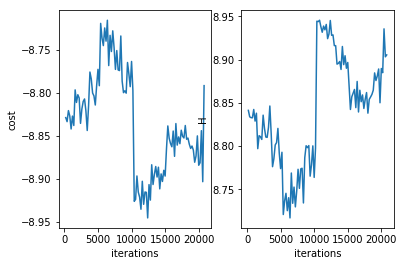

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 21000 
H 8.880858409686953
cost -8.880851162304609
system.D 3


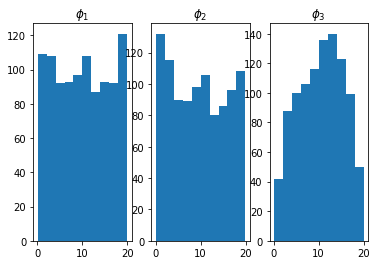

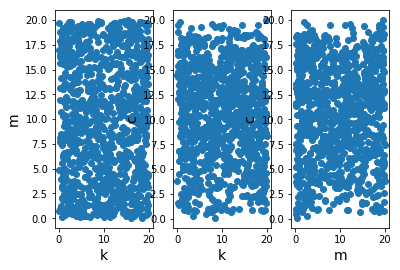

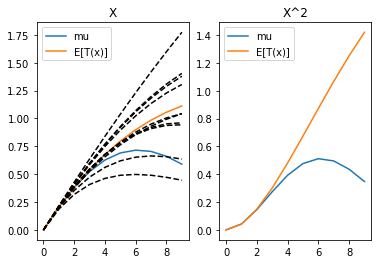

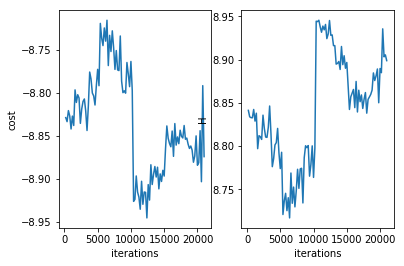

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 21200 
H 8.85224633939599
cost -8.85222137782775
system.D 3


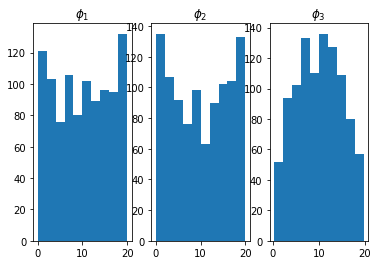

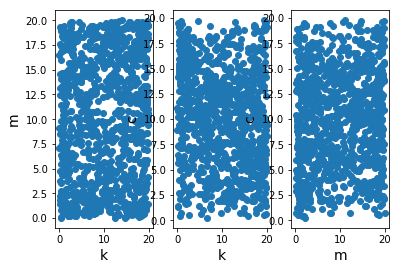

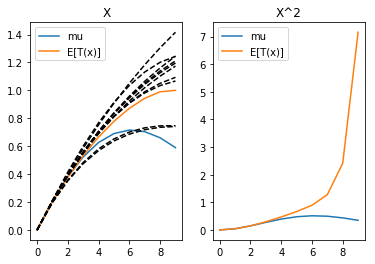

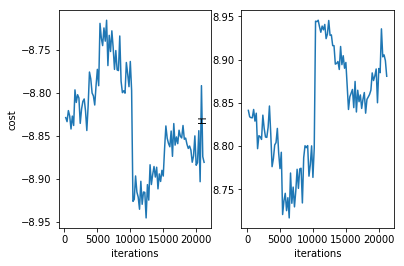

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 21400 
H 8.85108878985248
cost -8.831041367187757
system.D 3


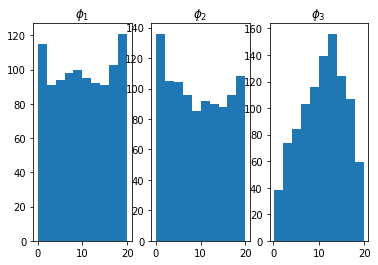

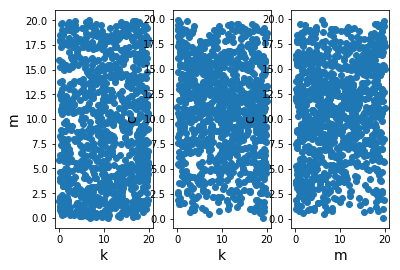

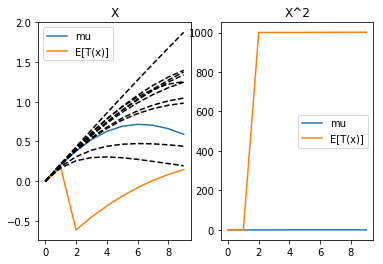

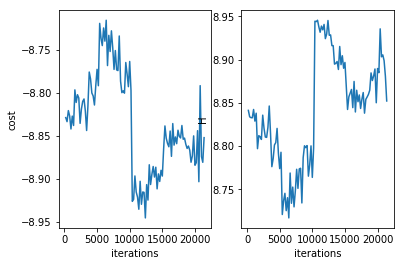

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 21600 
H 8.887631363310048
cost -8.86883847348342
system.D 3


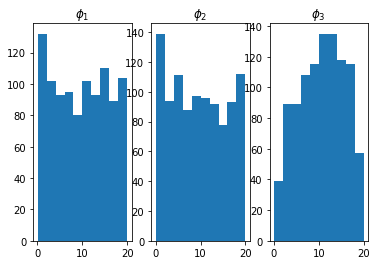

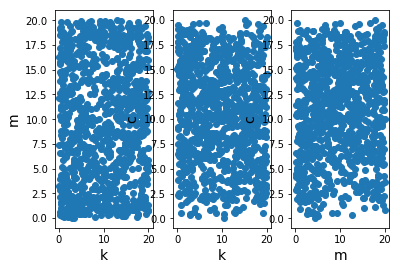

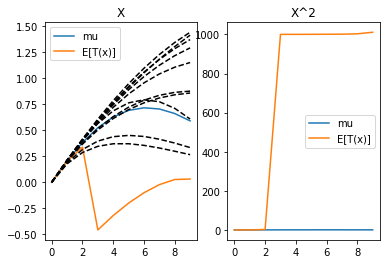

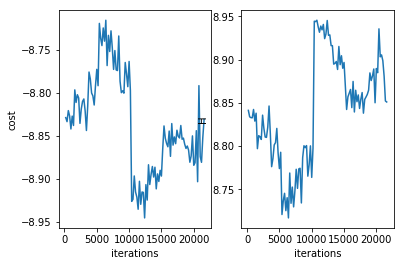

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 21800 
H 8.886398879115834
cost -8.868931585680931
system.D 3


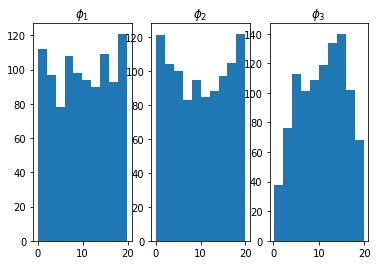

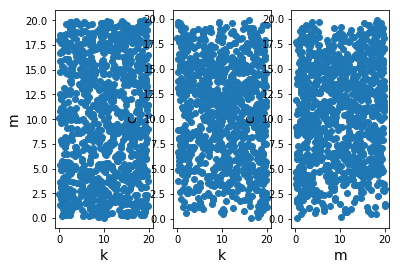

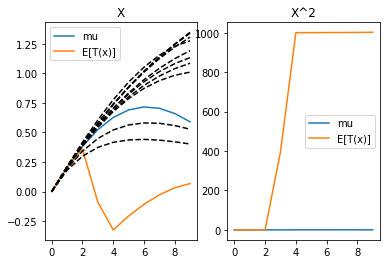

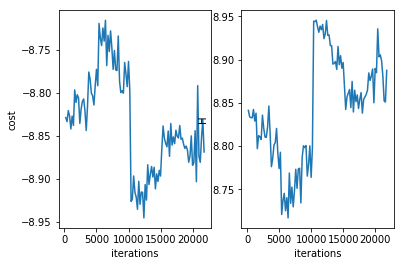

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 22000 
H 8.849185468706441
cost -8.83481941883379
system.D 3


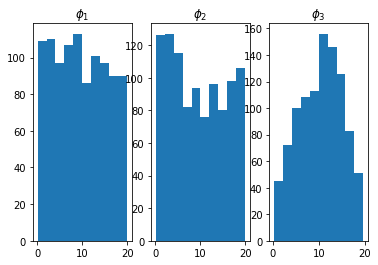

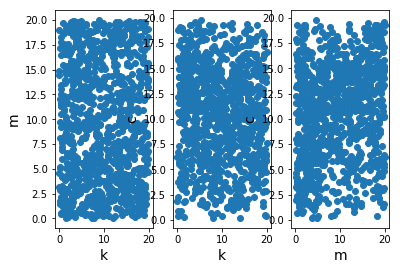

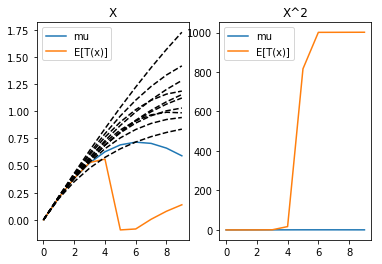

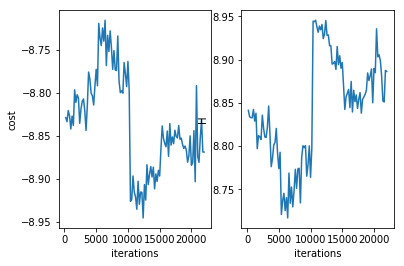

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 22200 
H 8.861273271873706
cost -8.841222594635685
system.D 3


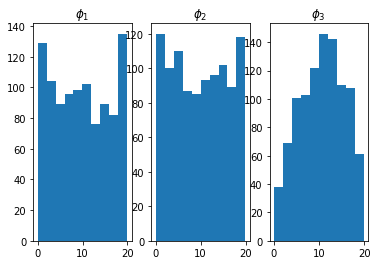

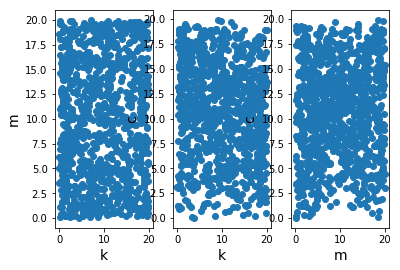

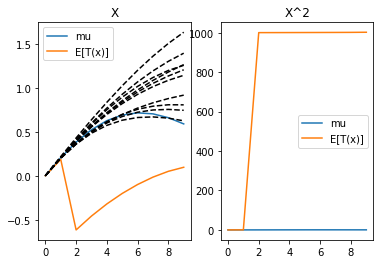

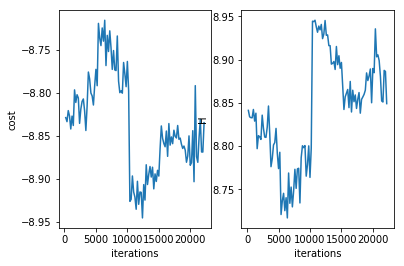

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 22400 
H 8.880526935445943
cost -8.860479926238373
system.D 3


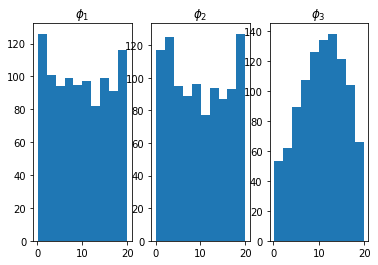

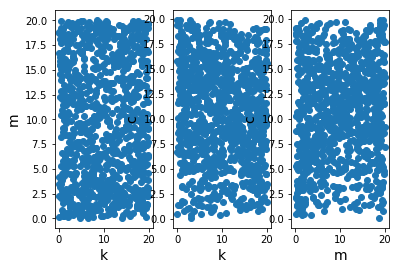

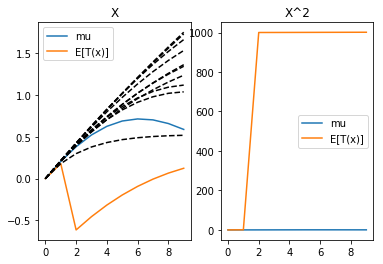

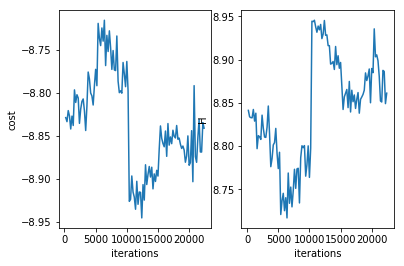

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 22600 
H 8.859009833945866
cost -8.85898511096064
system.D 3


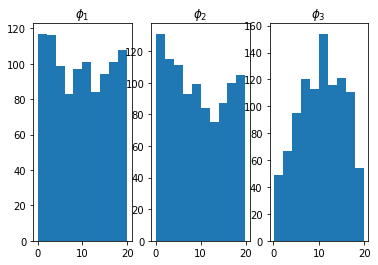

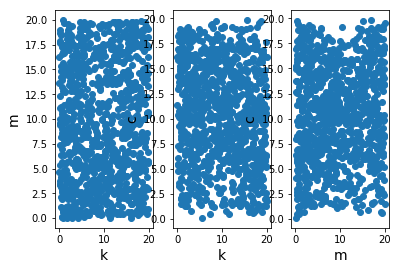

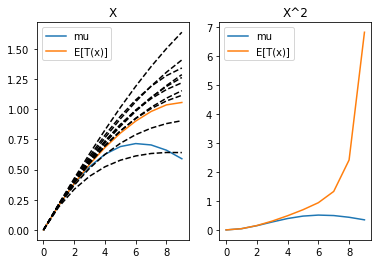

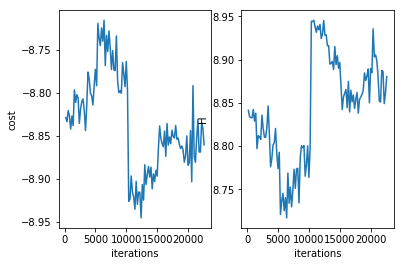

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 22800 
H 8.85089314858511
cost -8.832150626855304
system.D 3


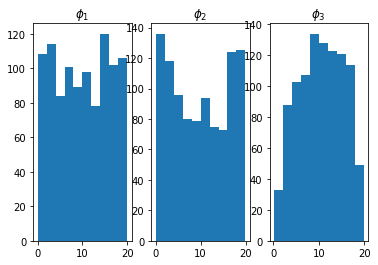

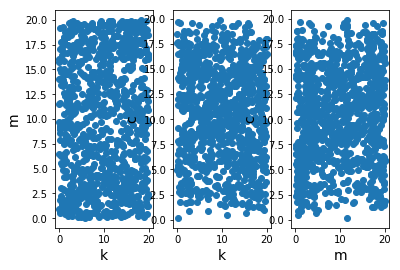

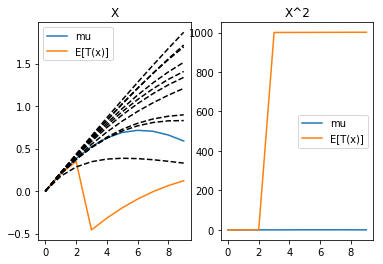

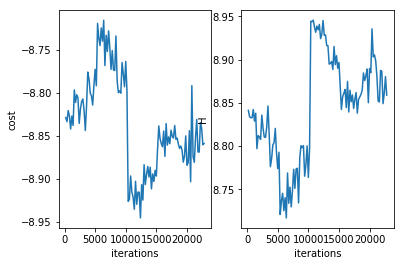

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 23000 
H 8.86287797939898
cost -8.799323241169244
system.D 3


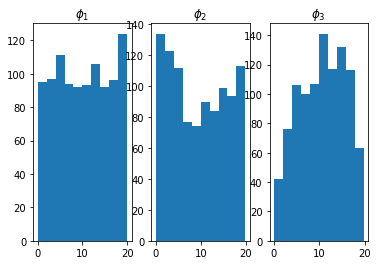

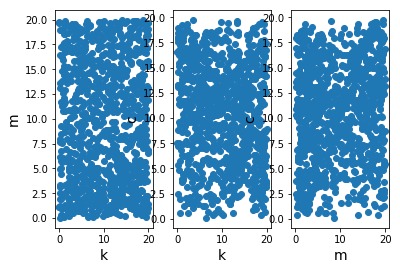

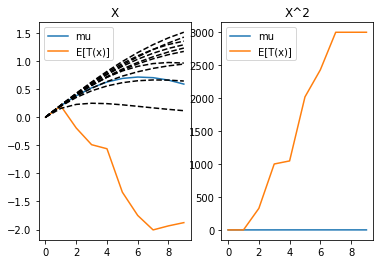

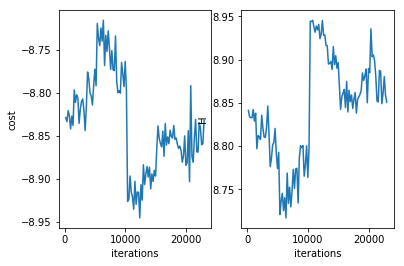

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 23200 
H 8.882043784853046
cost -8.866731129963936
system.D 3


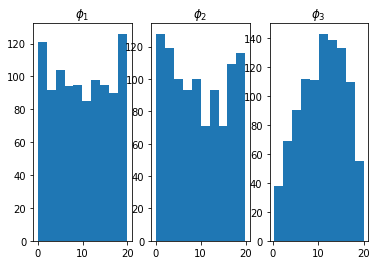

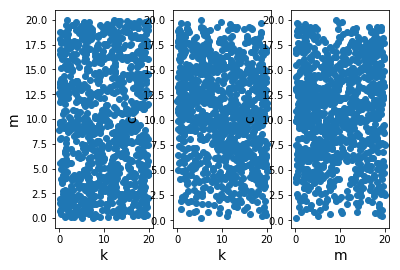

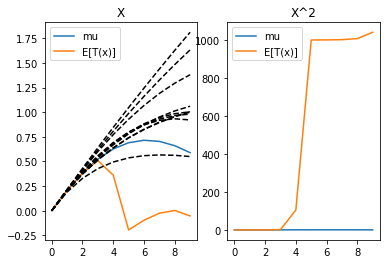

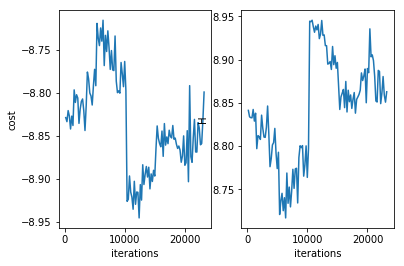

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 23400 
H 8.843066023099452
cost -8.82432259476263
system.D 3


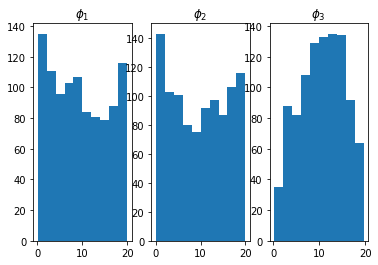

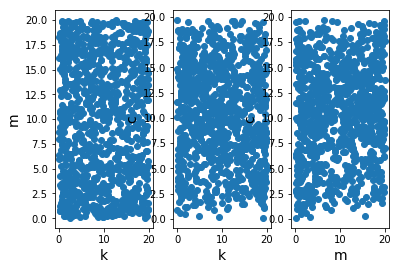

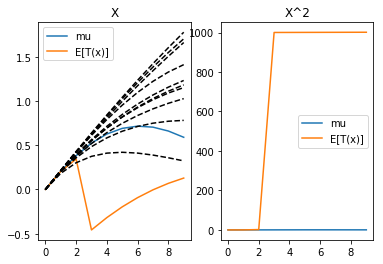

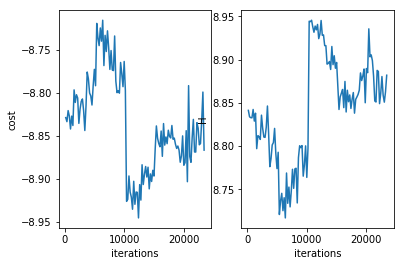

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 23600 
H 8.859823645638128
cost -8.859815483085297
system.D 3


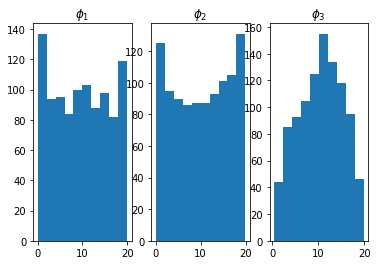

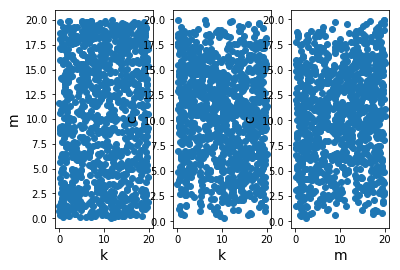

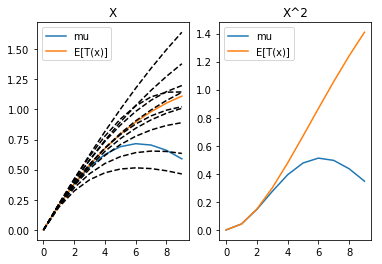

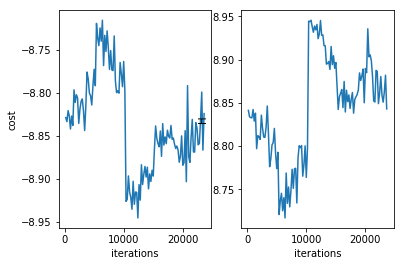

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 23800 
H 8.864454305443987
cost -8.847448149242497
system.D 3


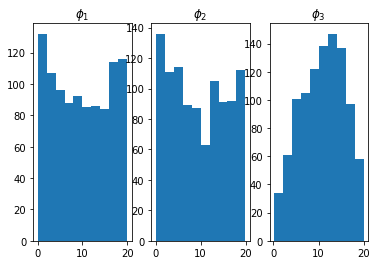

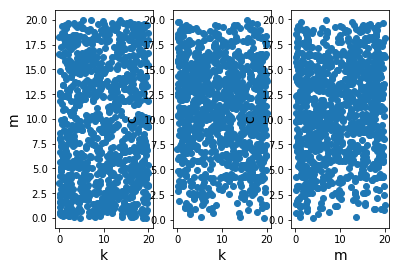

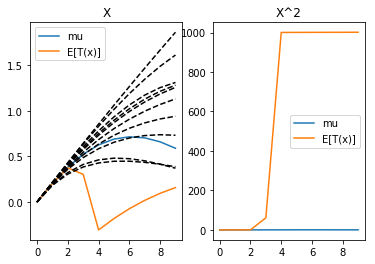

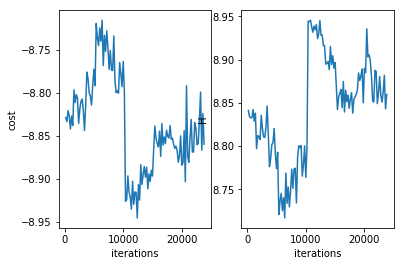

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 24000 
H 8.858603437711627
cost -8.838555651042482
system.D 3


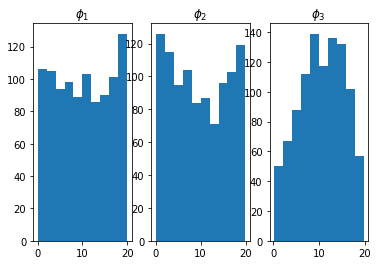

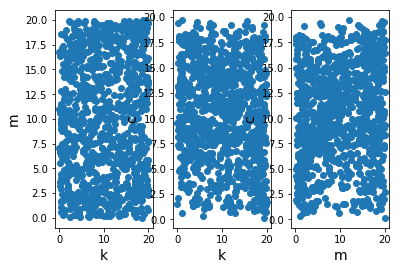

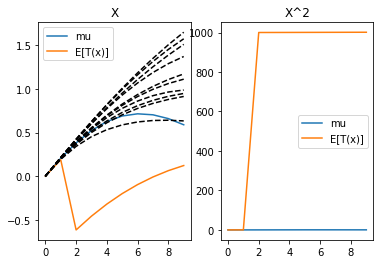

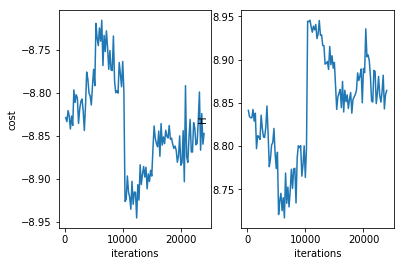

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 24200 
H 8.880954931458916
cost -8.880515476370826
system.D 3


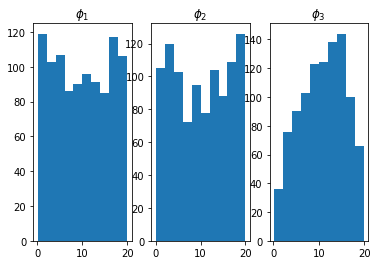

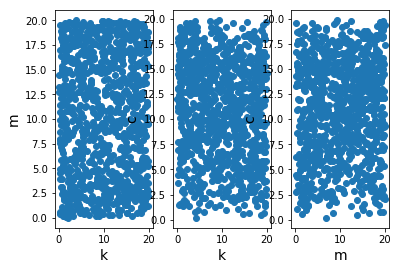

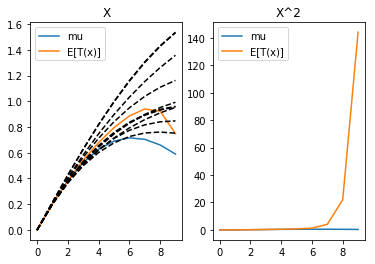

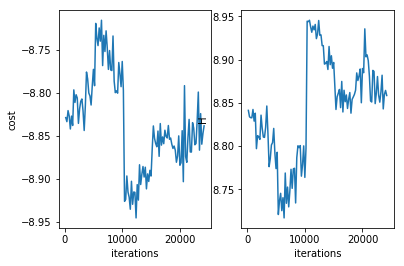

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 24400 
H 8.854738369599206
cost -8.837754889991244
system.D 3


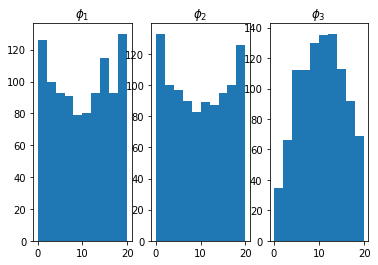

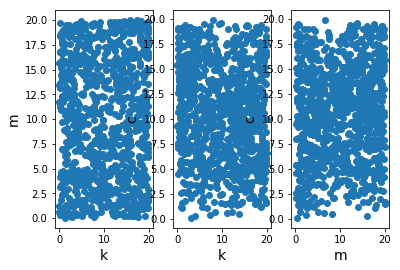

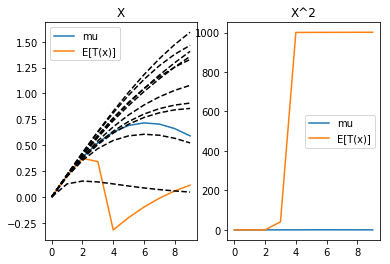

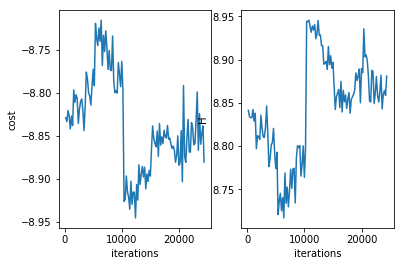

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 24600 
H 8.867711014422472
cost -8.867691080185216
system.D 3


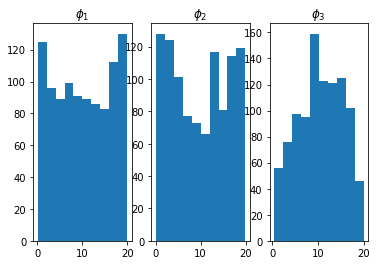

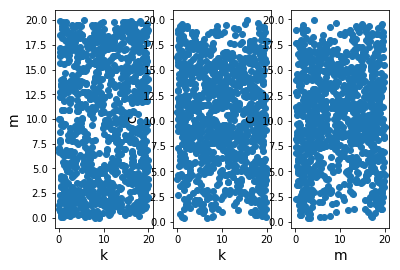

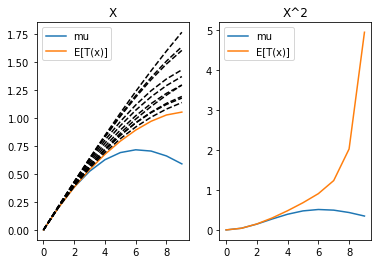

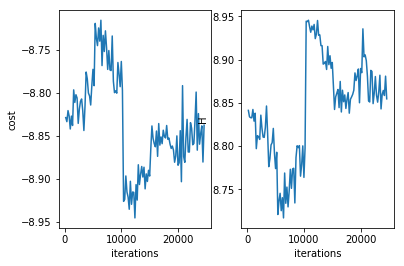

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 24800 
H 8.85712515356491
cost -8.781787401853938
system.D 3


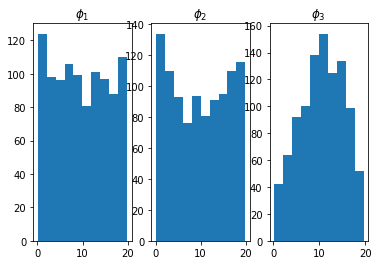

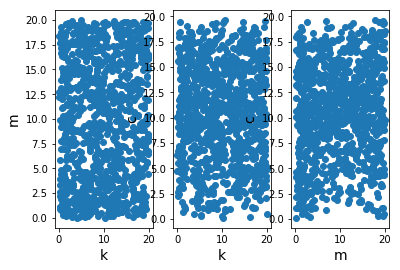

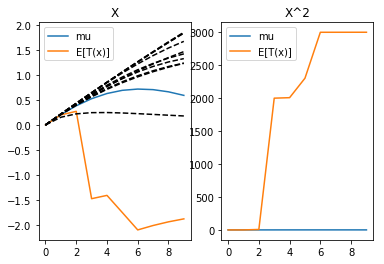

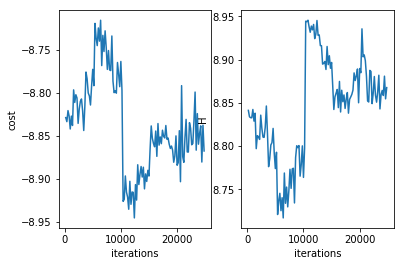

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 25000 
H 8.853756687076308
cost -8.840615579726071
system.D 3


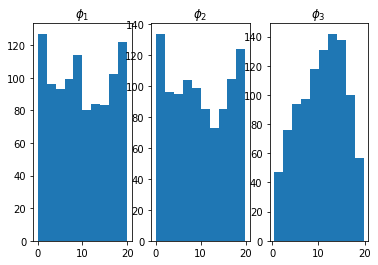

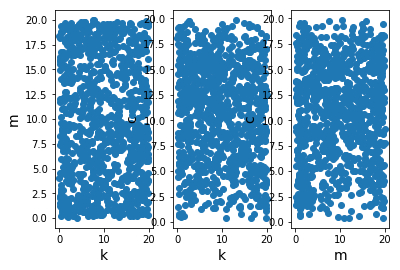

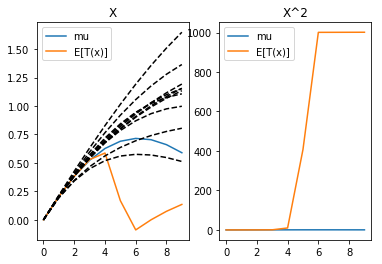

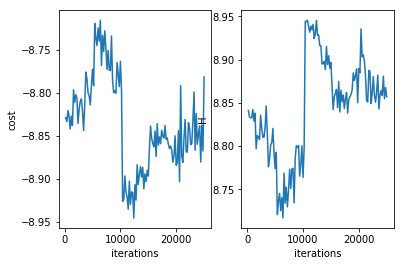

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 25200 
H 8.841693758782476
cost -8.832064730804227
system.D 3


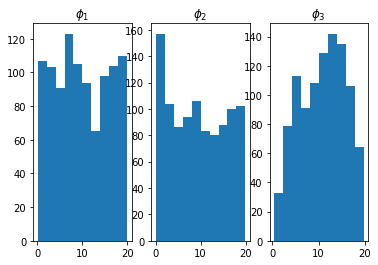

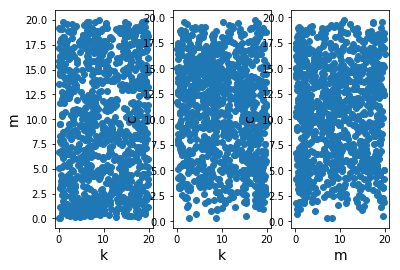

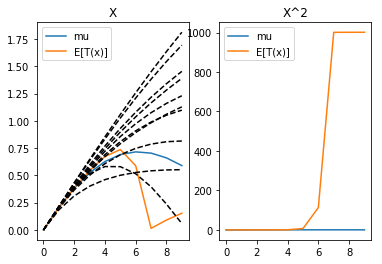

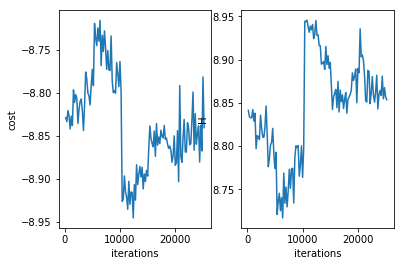

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 25400 
H 8.87389253480528
cost -8.856907711432173
system.D 3


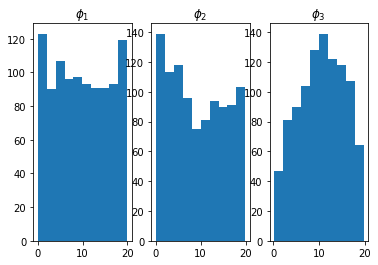

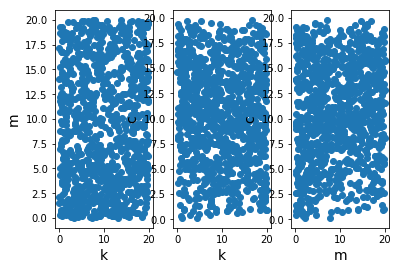

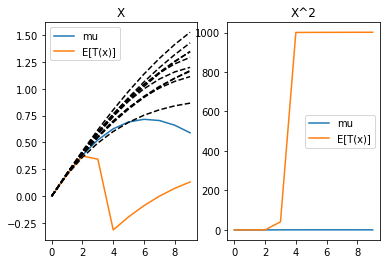

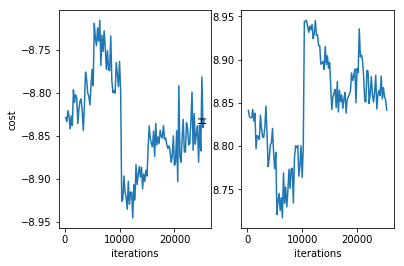

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 25600 
H 8.850173826107472
cost -8.850161321912562
system.D 3


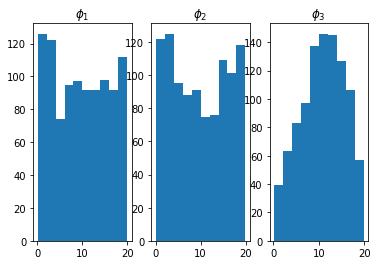

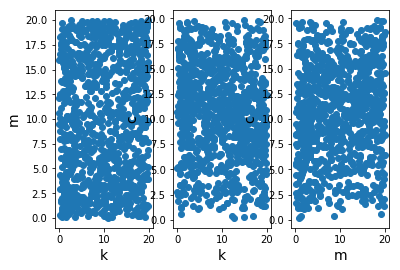

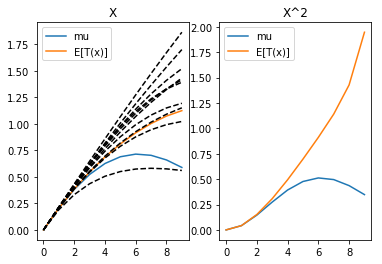

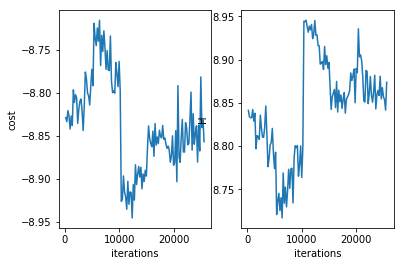

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 25800 
H 8.854507366398442
cost -8.85055348461614
system.D 3


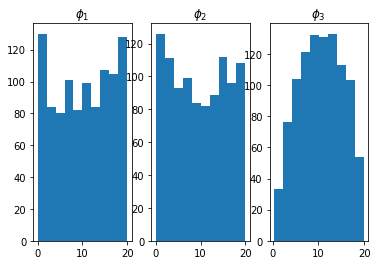

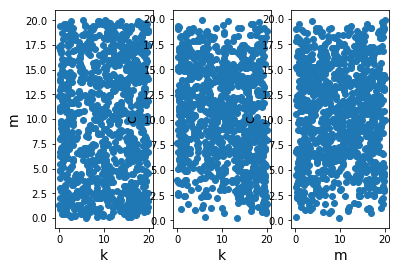

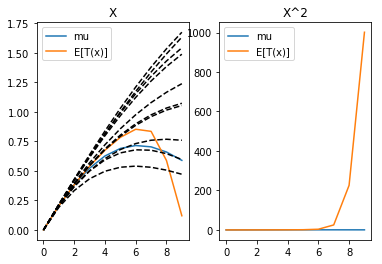

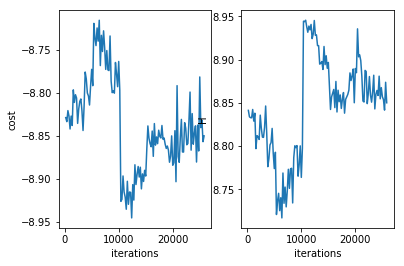

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 26000 
H 8.852682332100736
cost -8.832632633185096
system.D 3


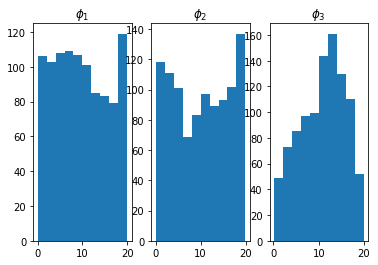

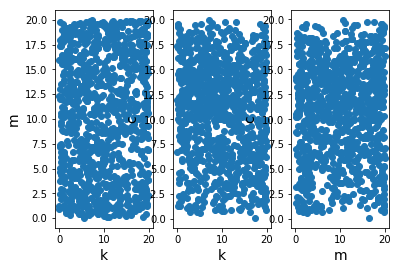

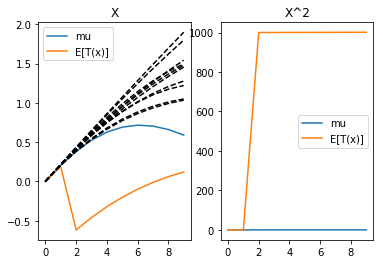

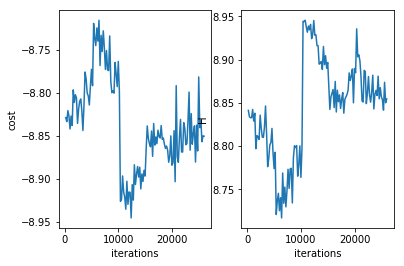

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 26200 
H 8.851931723015598
cost -8.851920689513205
system.D 3


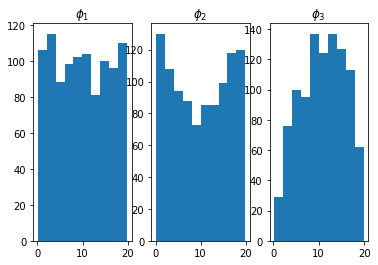

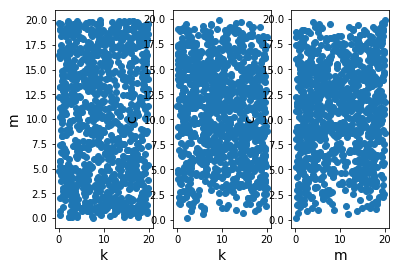

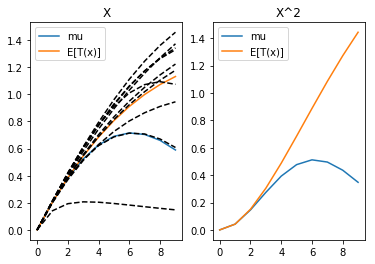

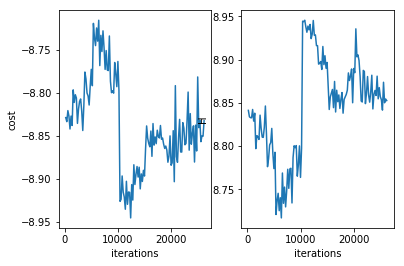

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 26400 
H 8.864184383561268
cost -8.864172912272947
system.D 3


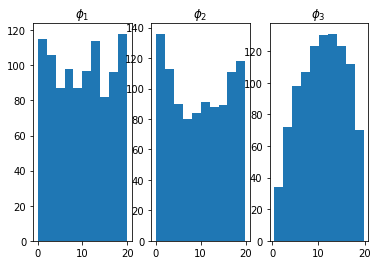

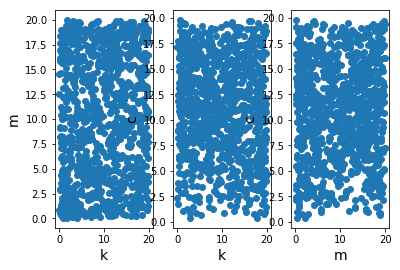

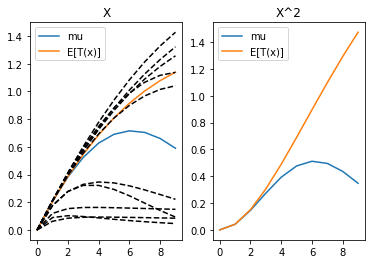

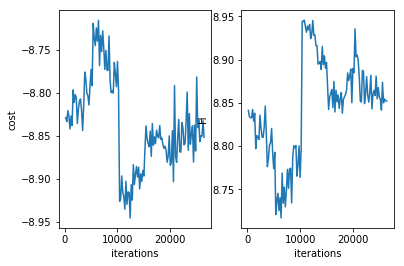

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 26600 
H 8.86748987904843
cost -8.86747925324488
system.D 3


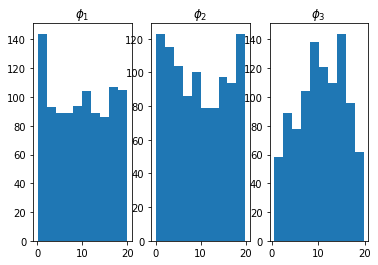

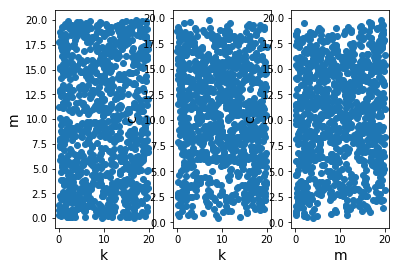

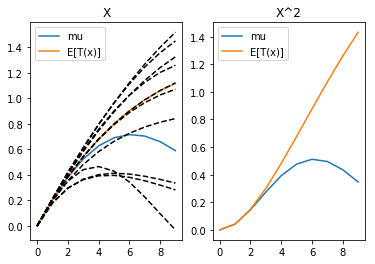

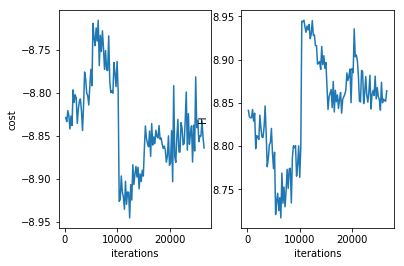

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 26800 
H 8.861100715605286
cost -8.814879360611439
system.D 3


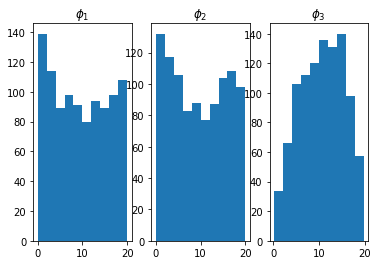

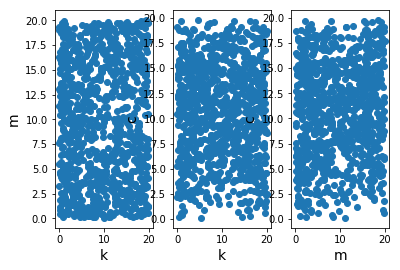

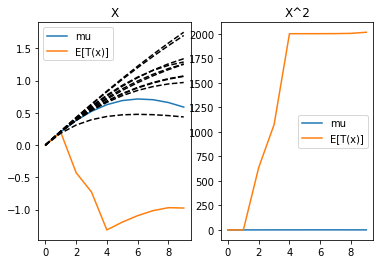

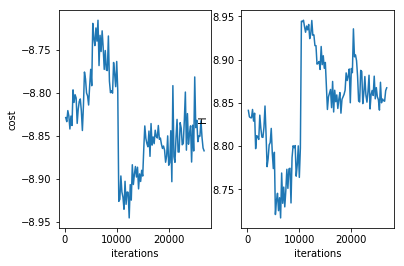

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 27000 
H 8.876115783064007
cost -8.876104930607287
system.D 3


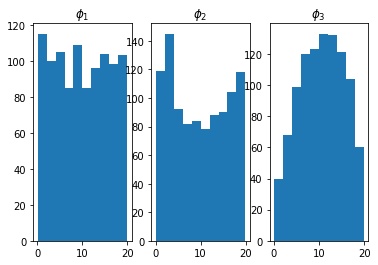

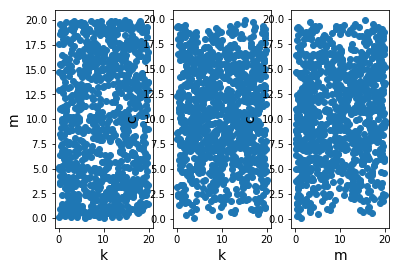

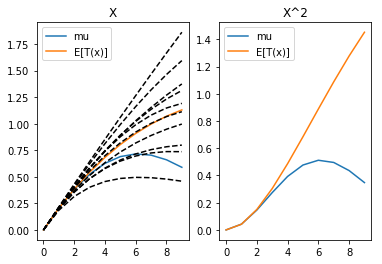

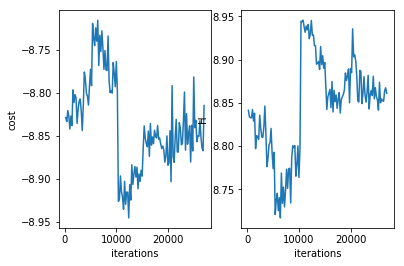

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 27200 
H 8.858821138401563
cost -8.858516556787876
system.D 3


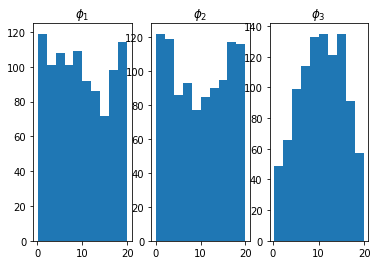

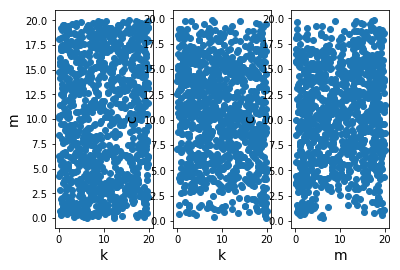

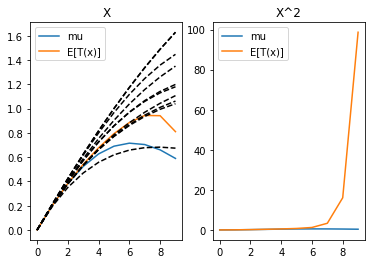

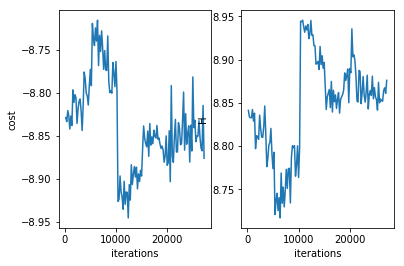

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 27400 
H 8.848246643101291
cost -8.833794772269163
system.D 3


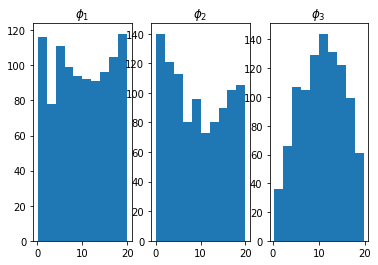

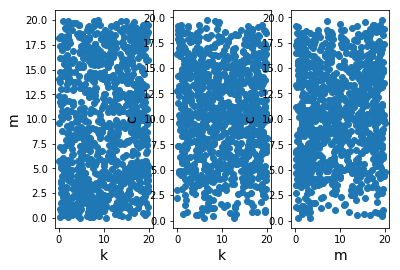

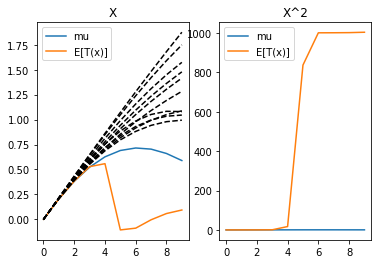

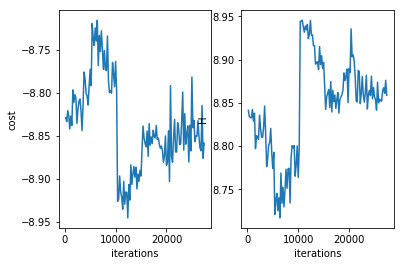

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 27600 
H 8.866094768969077
cost -8.816942768255252
system.D 3


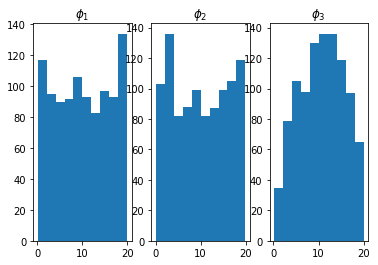

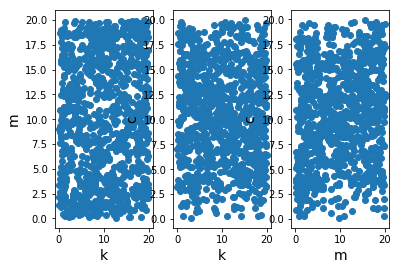

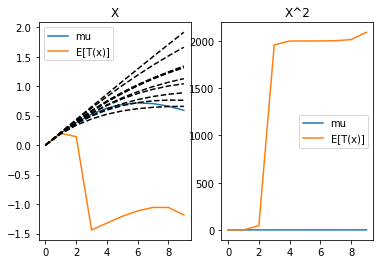

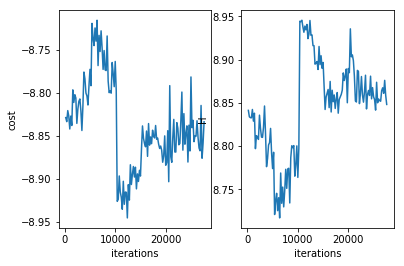

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 27800 
H 8.885510341597236
cost -8.871946732191951
system.D 3


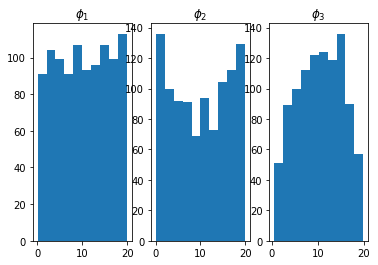

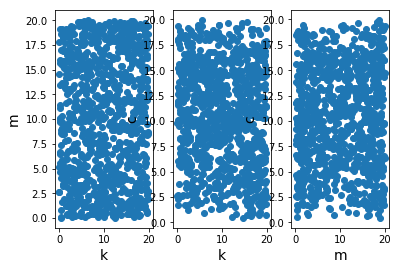

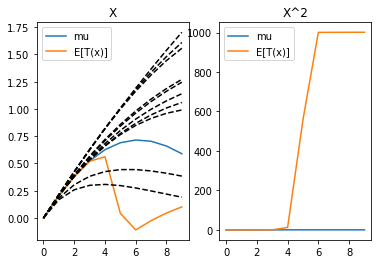

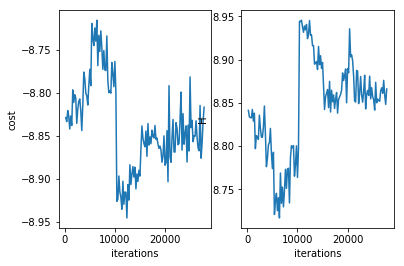

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 28000 
H 8.850982689628024
cost -8.850966290606868
system.D 3


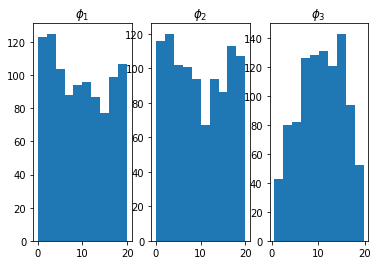

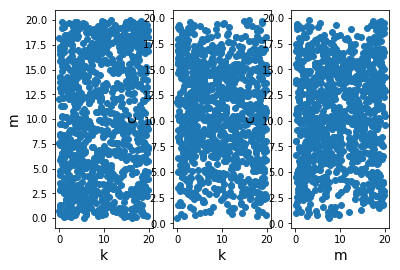

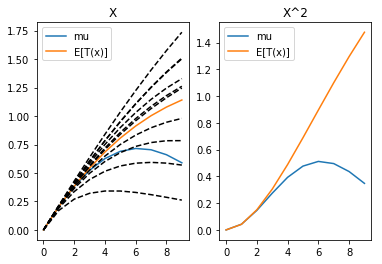

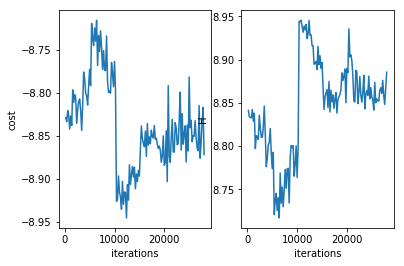

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 28200 
H 8.860949214472427
cost -8.769820838644028
system.D 3


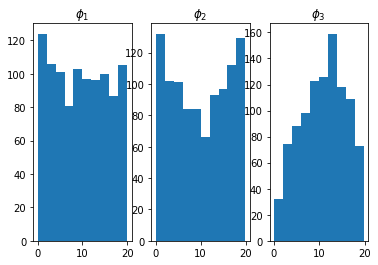

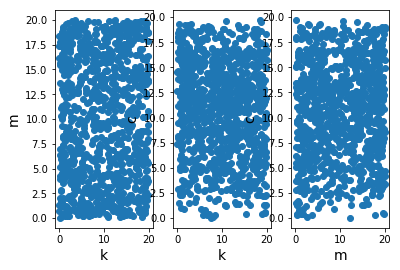

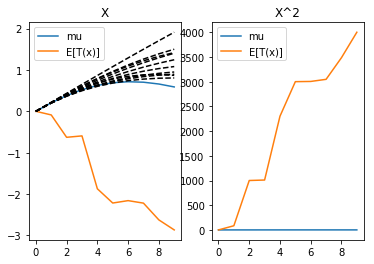

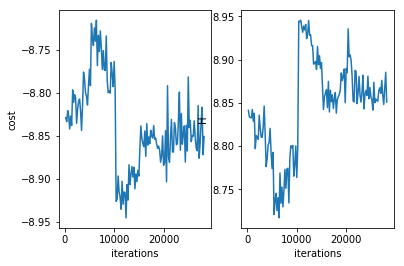

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 28400 
H 8.859187025650444
cost -8.859170207862922
system.D 3


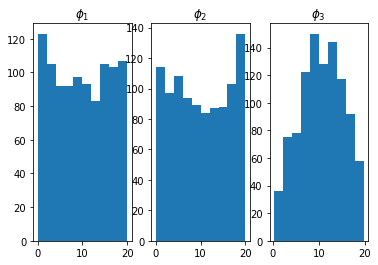

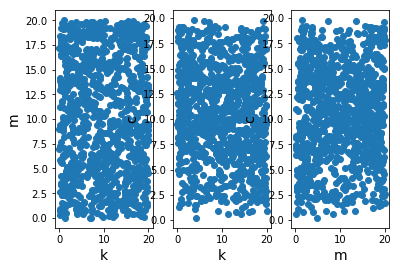

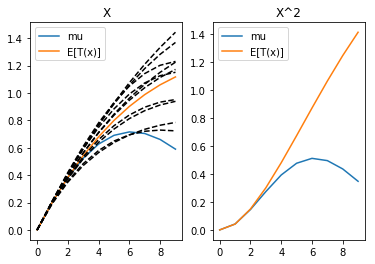

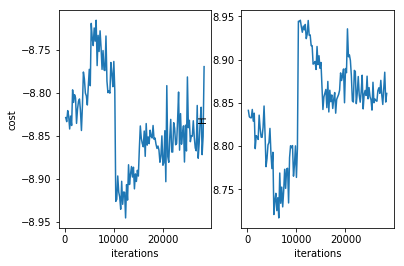

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 28600 
H 8.874443934532007
cost -8.825236650983468
system.D 3


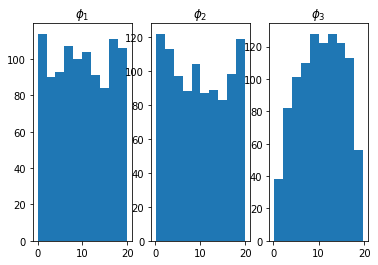

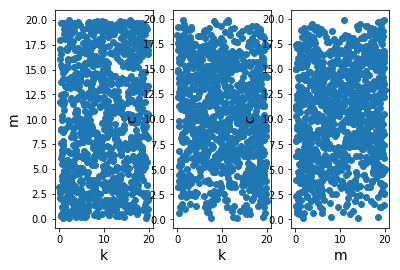

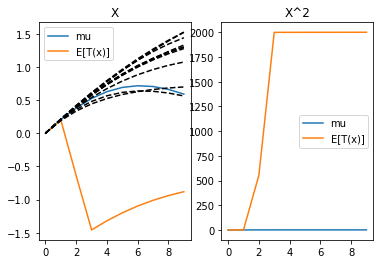

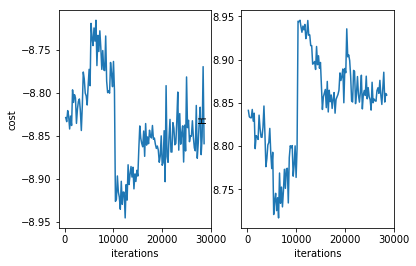

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 28800 
H 8.883925311215139
cost -8.875133175013904
system.D 3


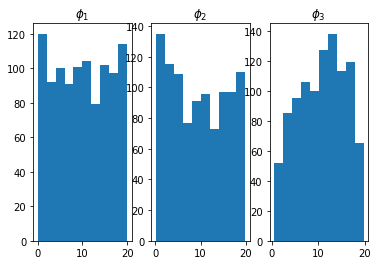

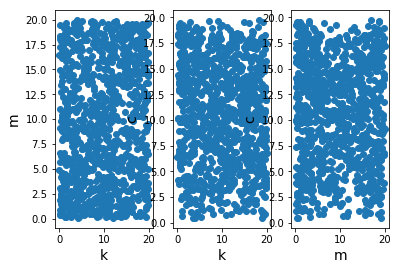

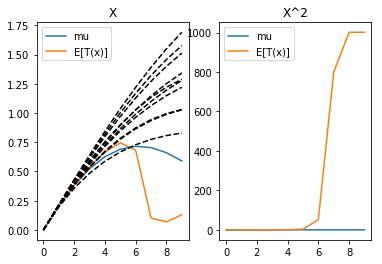

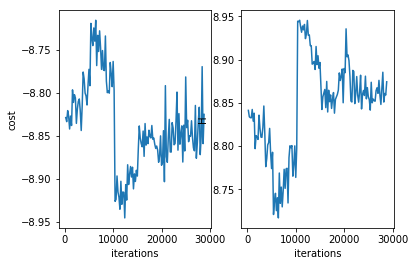

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 29000 
H 8.858060077897925
cost -8.839302392367287
system.D 3


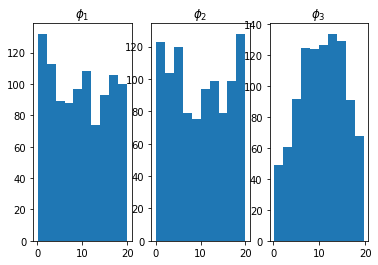

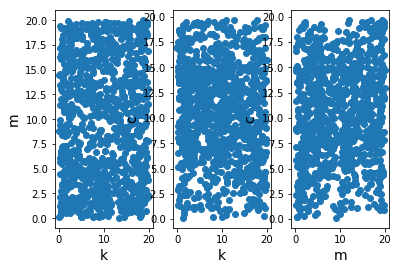

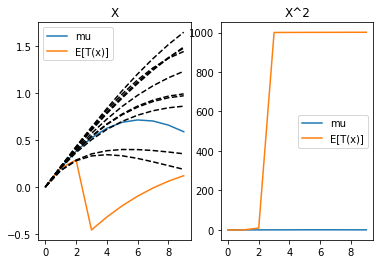

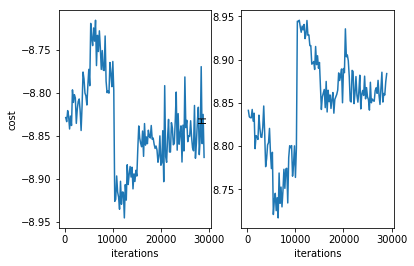

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 29200 
H 8.871220086841776
cost -8.871149295709197
system.D 3


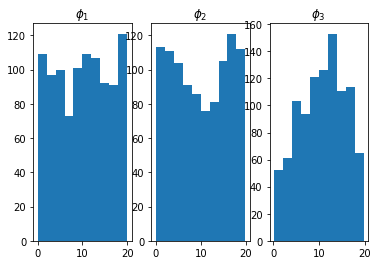

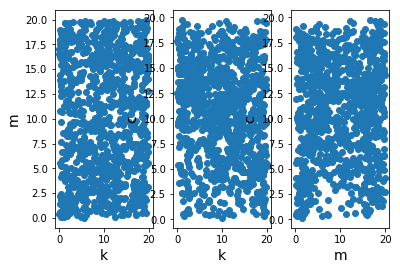

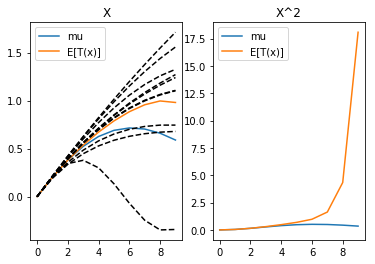

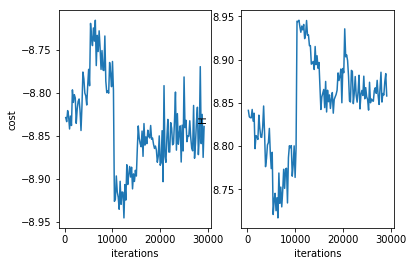

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 29400 
H 8.88934094253513
cost -8.869283910437346
system.D 3


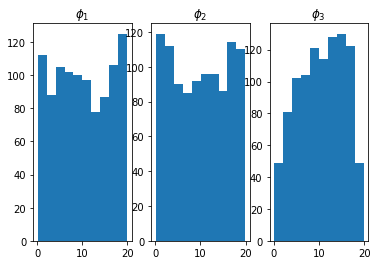

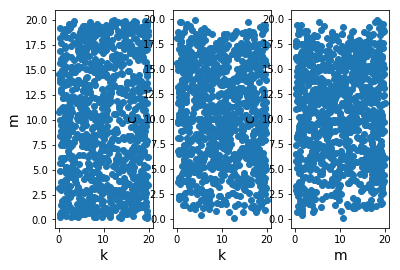

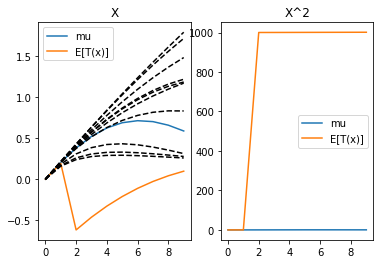

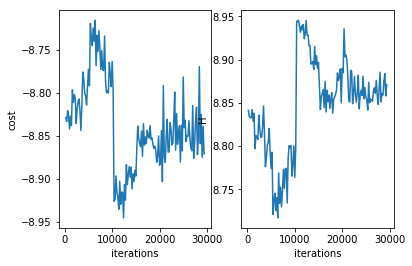

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 29600 
H 8.885880500172762
cost -8.876145553036515
system.D 3


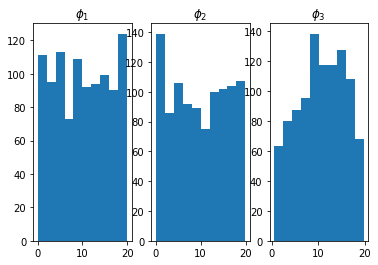

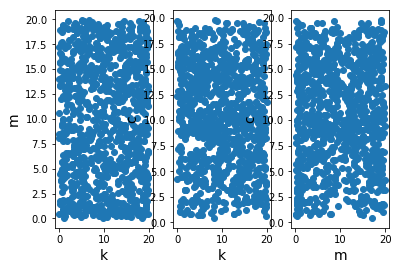

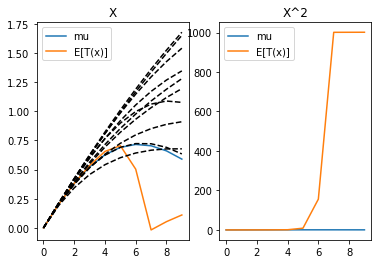

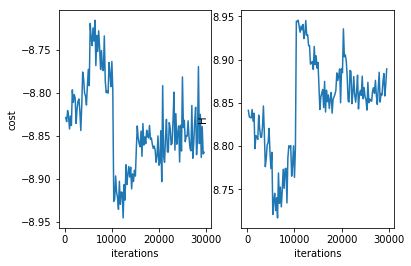

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 29800 
H 8.8283961332979
cost -8.809650600916548
system.D 3


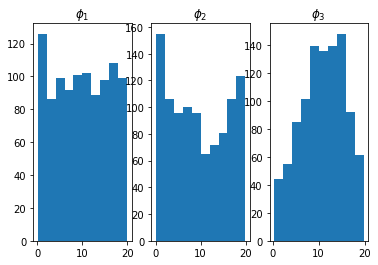

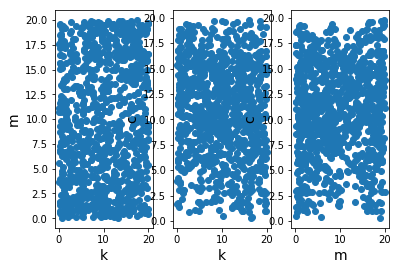

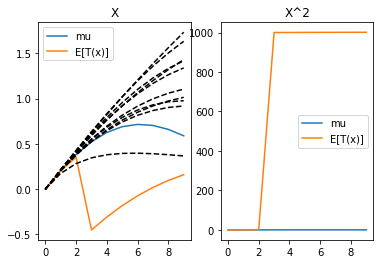

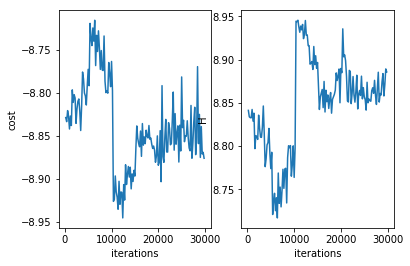

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 30000 
H 8.82200964299042
cost -8.80504894869368
system.D 3


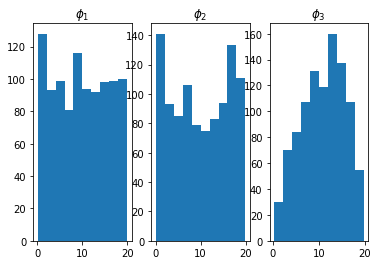

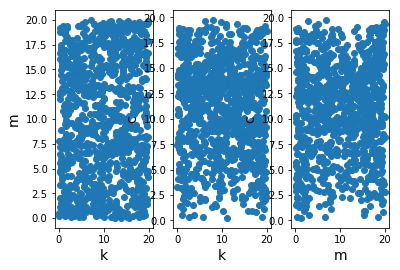

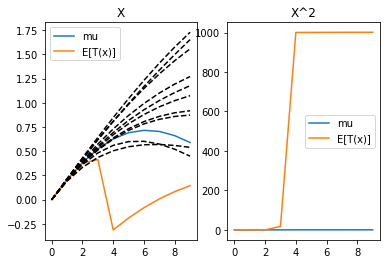

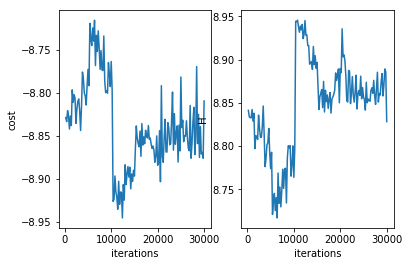

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/
AL iteration 4
resetting optimizer
aug lag it 3
lambda [ 0.00000000e+00 -5.50753538e-11 -2.36246614e-09 -4.39399940e-09
 -5.78291910e-09 -8.33441559e-09 -8.31787224e-09 -8.54399230e-09
 -9.68835432e-09 -9.60791904e-09 -2.10000000e-13  5.26516539e-10
  2.12153004e-06  4.20702678e-06  4.85755056e-06  8.40158718e-06
  8.41500503e-06  8.56182107e-06  1.01964028e-05  1.05025249e-05]
c 6.4e-09
saving model at iter 0
******************************************
it = 30200 
H 8.894457660394306
cost -8.816614761499832
system.D 3


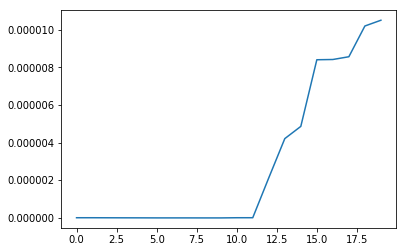

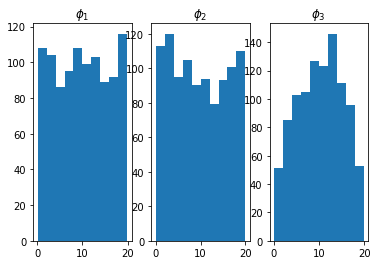

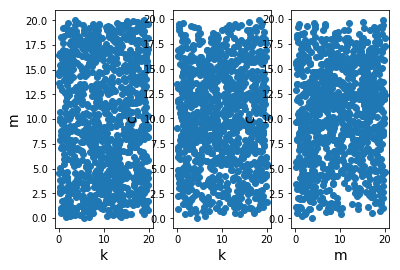

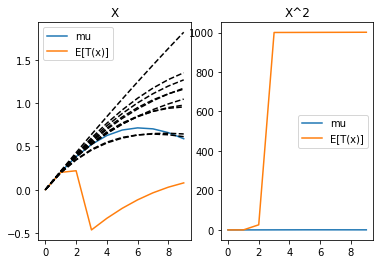

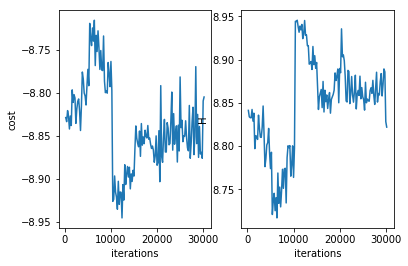

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 30400 
H 8.873342359301867
cost -8.872863159031866
system.D 3


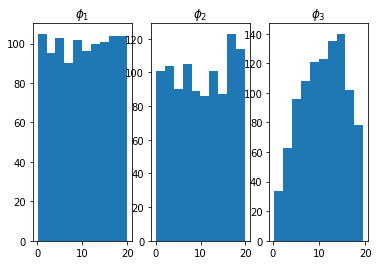

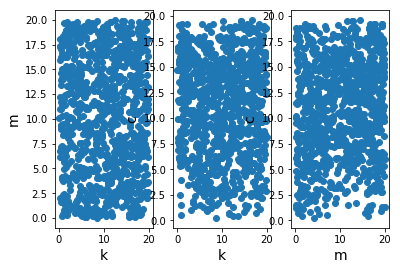

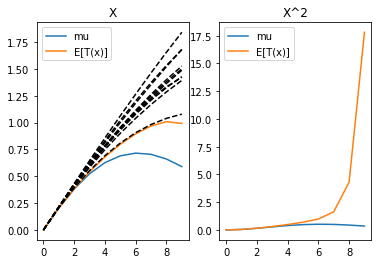

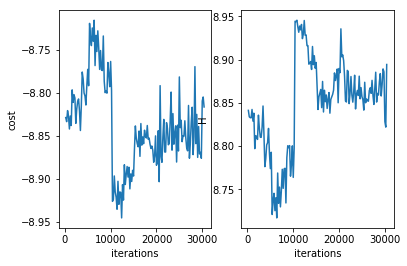

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 30600 
H 8.899095967715557
cost -8.817521834009337
system.D 3


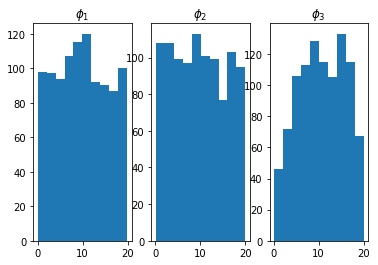

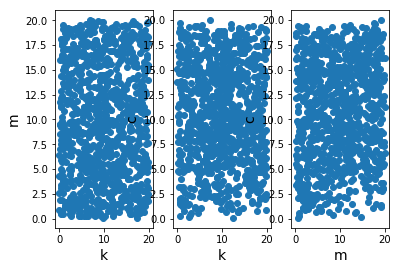

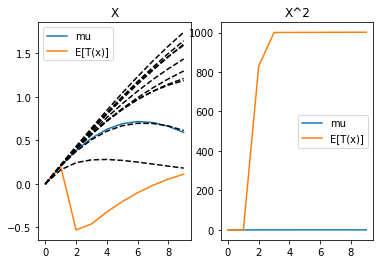

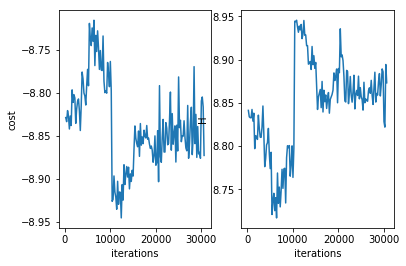

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 30800 
H 8.897854253346315
cost -8.527822872430596
system.D 3


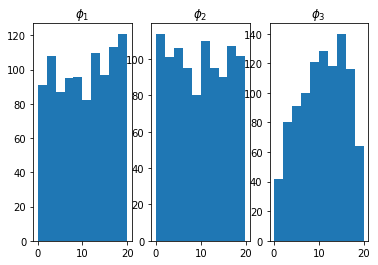

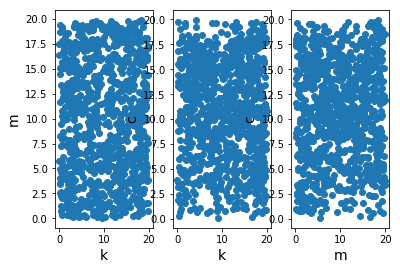

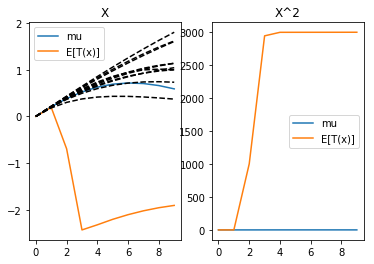

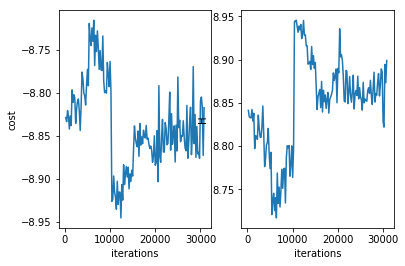

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 31000 
H 8.843414947746966
cost -8.843703171890052
system.D 3


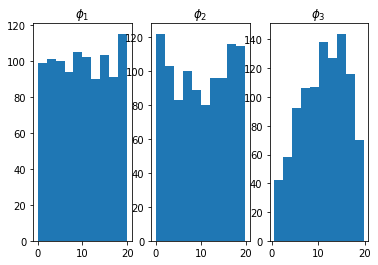

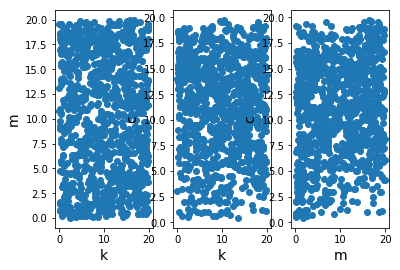

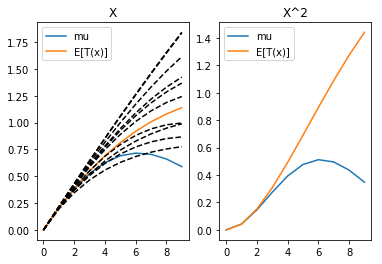

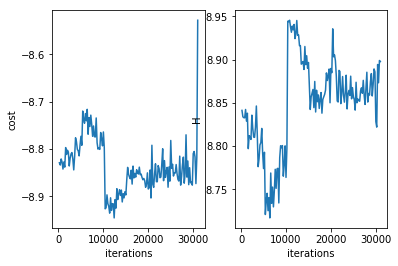

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 31200 
H 8.85969611218078
cost -8.859544761275776
system.D 3


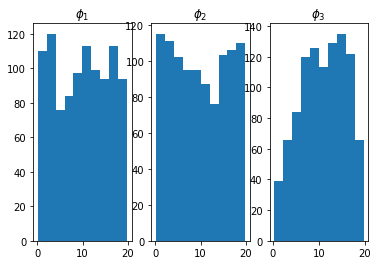

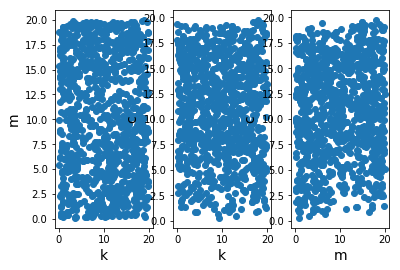

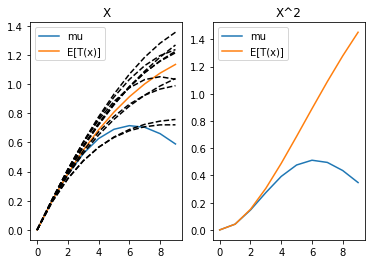

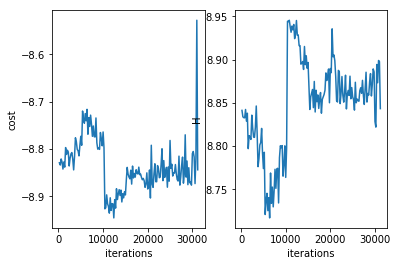

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 31400 
H 8.898877609290778
cost -8.827611461456844
system.D 3


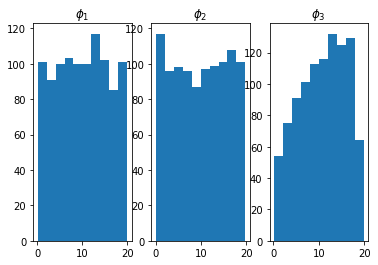

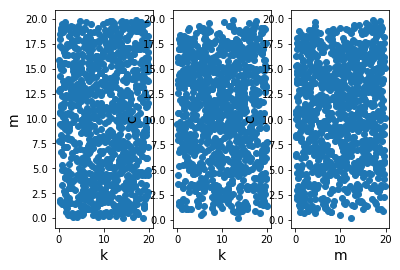

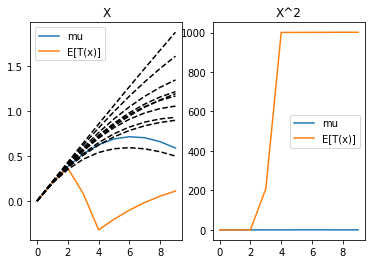

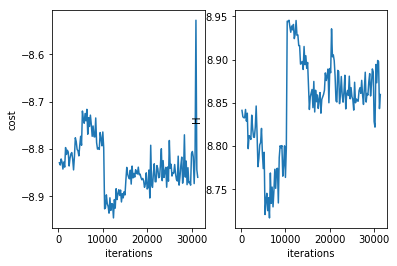

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 31600 
H 8.889040838868024
cost -8.826726345038981
system.D 3


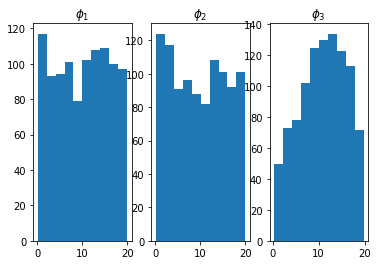

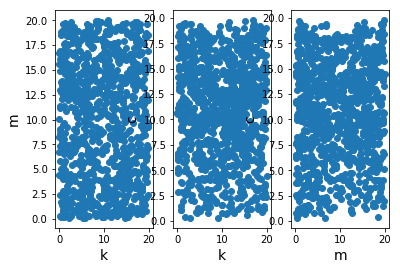

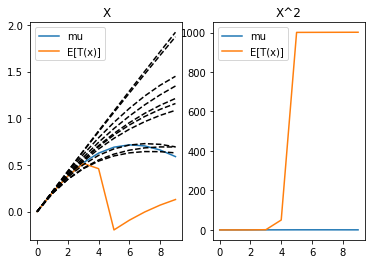

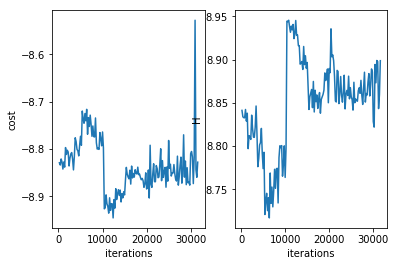

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 31800 
H 8.917268702526995
cost -8.841934256524603
system.D 3


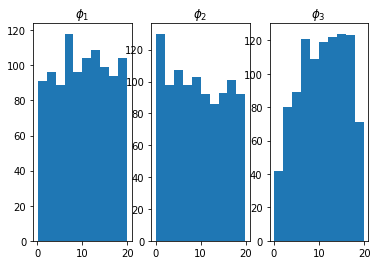

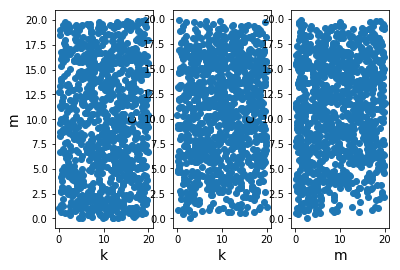

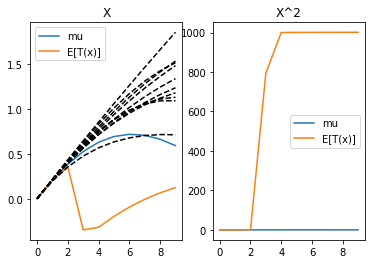

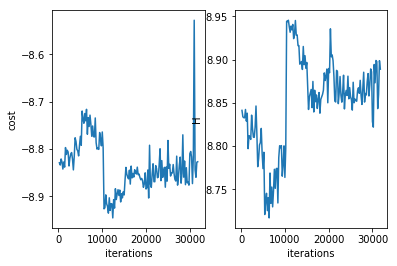

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 32000 
H 8.901697659731377
cost -8.901498868799383
system.D 3


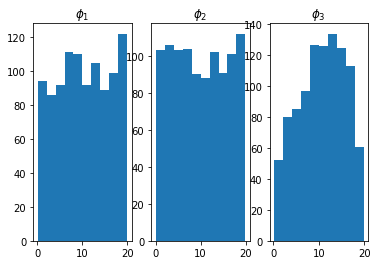

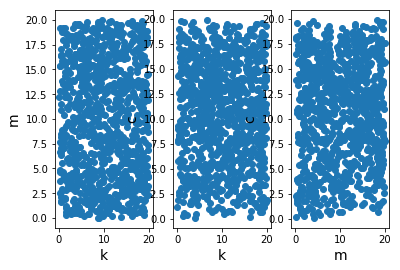

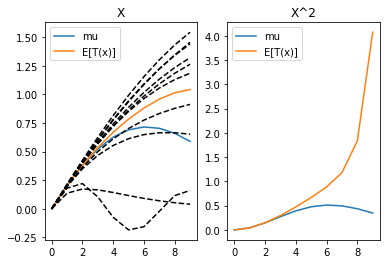

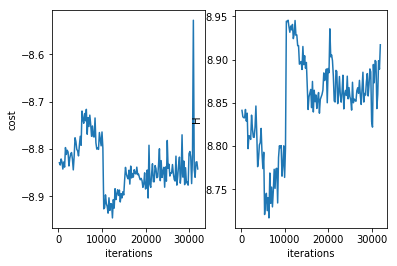

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 32200 
H 8.910375457647348
cost -8.780582960848946
system.D 3


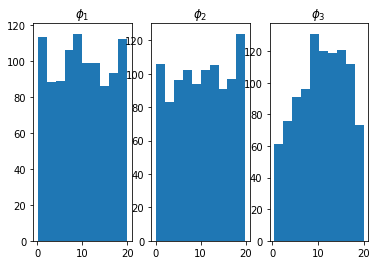

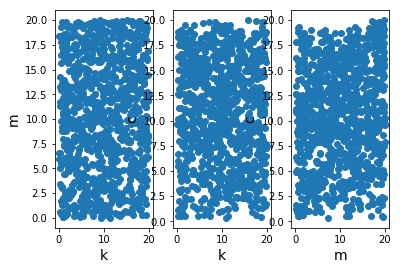

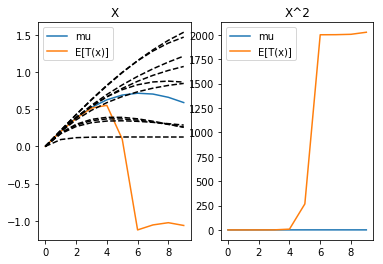

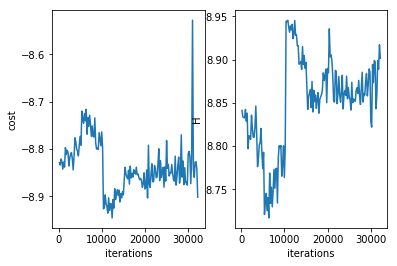

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 32400 
H 8.906697863321297
cost -8.81384323974749
system.D 3


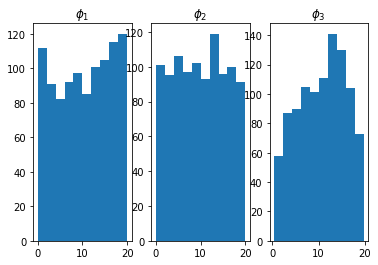

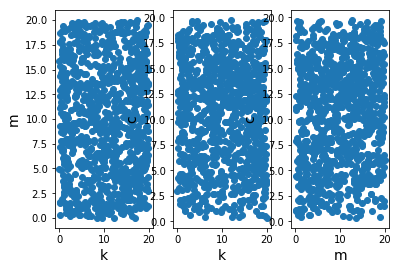

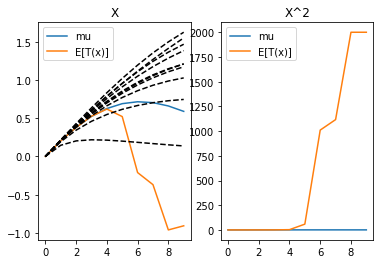

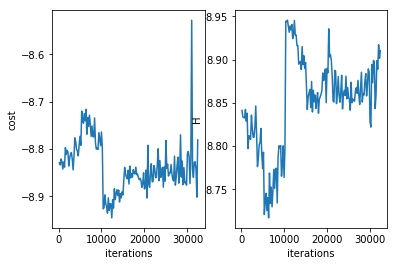

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 32600 
H 8.900382249228874
cost -8.814441994531576
system.D 3


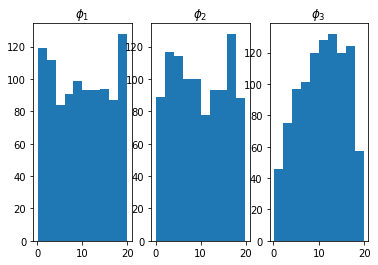

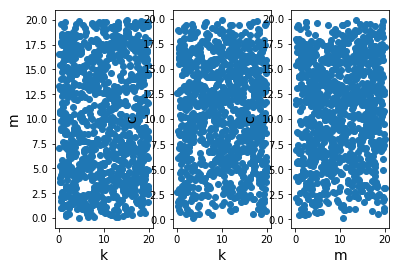

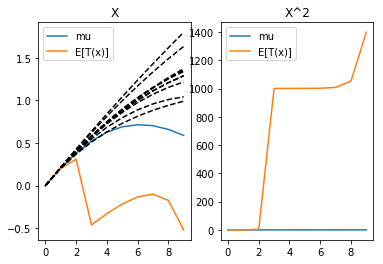

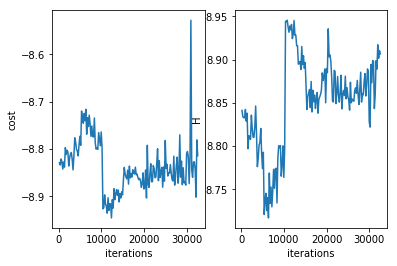

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 32800 
H 8.87980588759607
cost -8.75036531034191
system.D 3


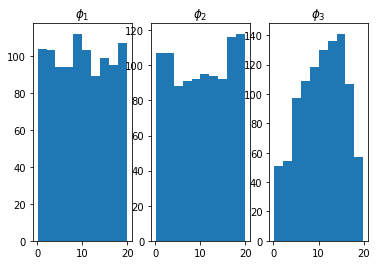

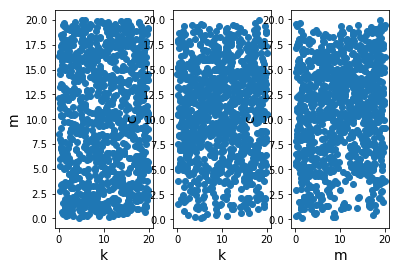

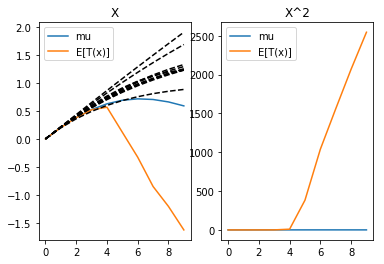

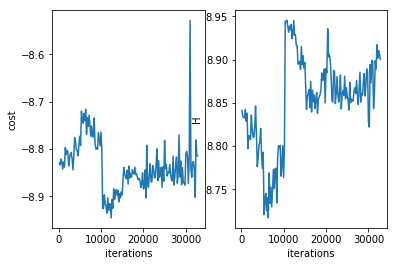

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 33000 
H 8.887891170238065
cost -8.887916704620247
system.D 3


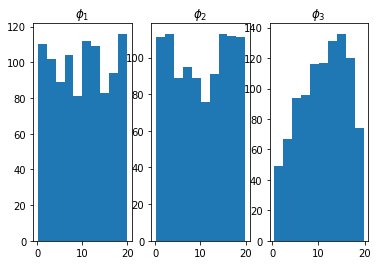

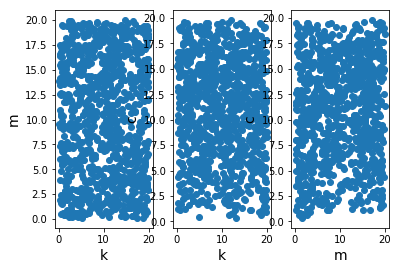

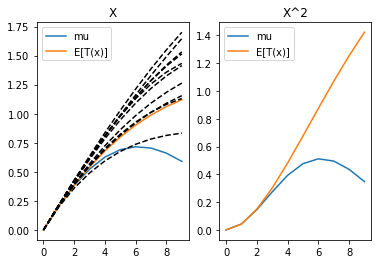

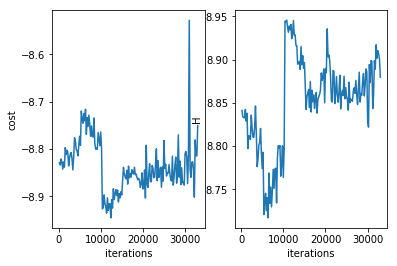

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 33200 
H 8.904387116448381
cost -8.904227585663014
system.D 3


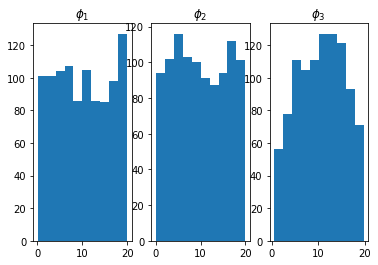

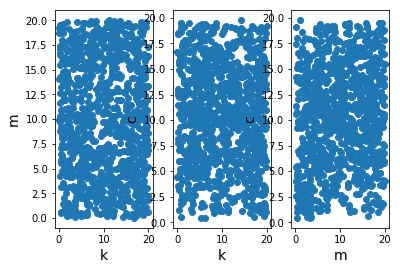

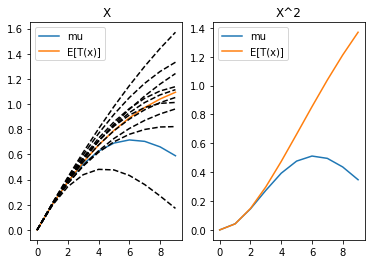

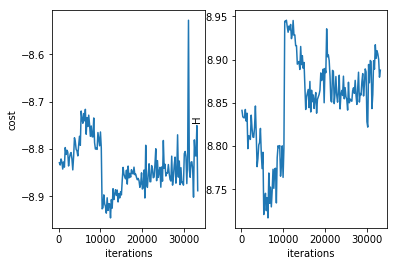

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 33400 
H 8.925763167703124
cost -8.89767442899812
system.D 3


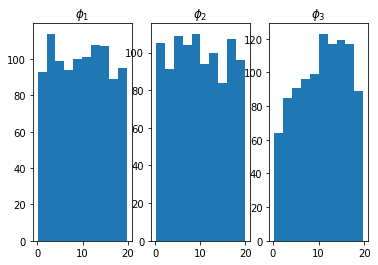

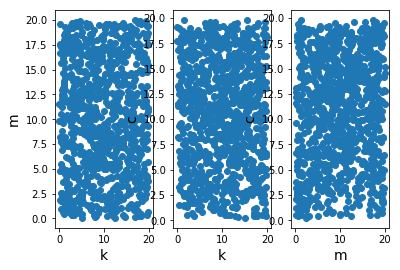

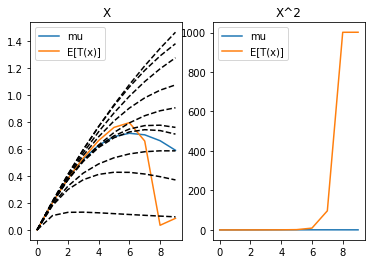

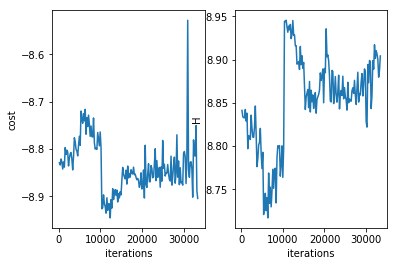

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 33600 
H 8.919427849472912
cost -8.758449236754132
system.D 3


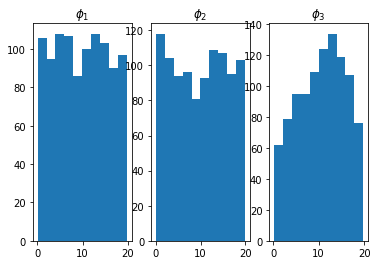

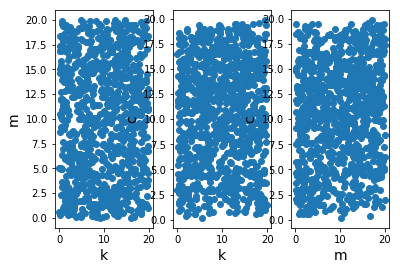

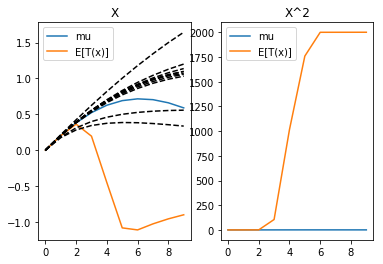

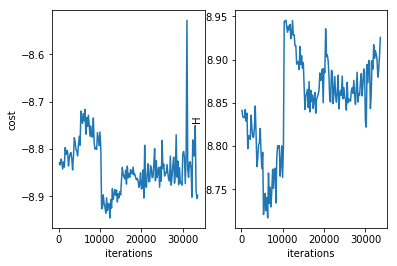

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 33800 
H 8.904149057224199
cost -8.808601639161974
system.D 3


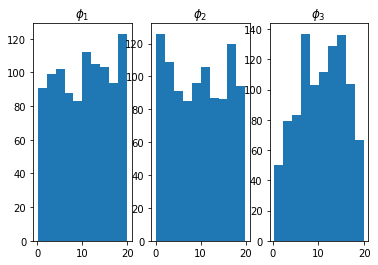

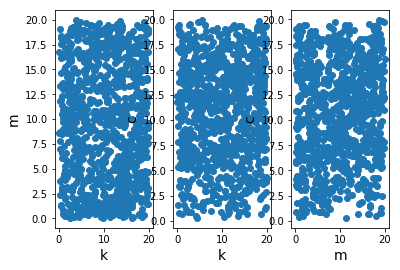

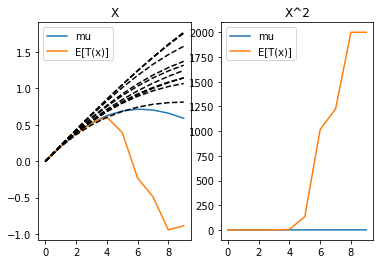

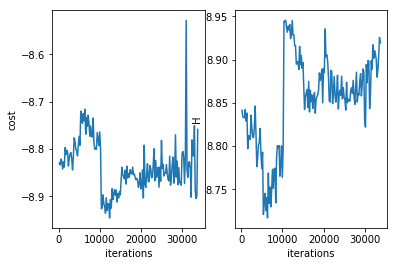

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 34000 
H 8.908021162517528
cost -8.824825870302297
system.D 3


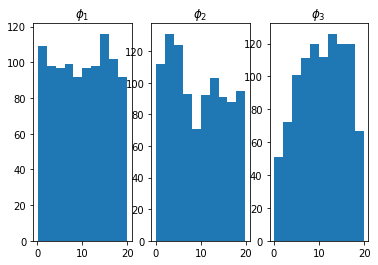

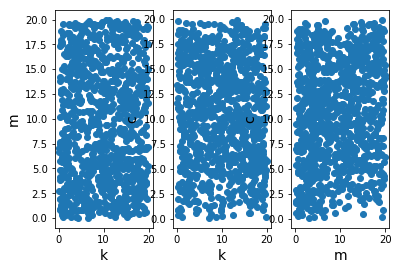

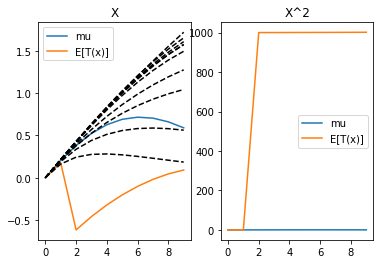

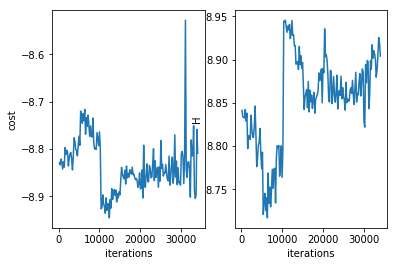

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 34200 
H 8.818219596948516
cost -8.81818536188992
system.D 3


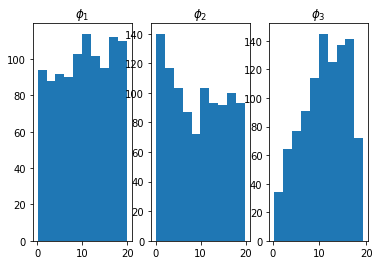

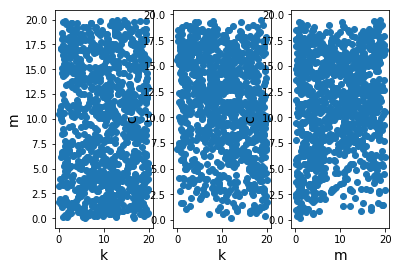

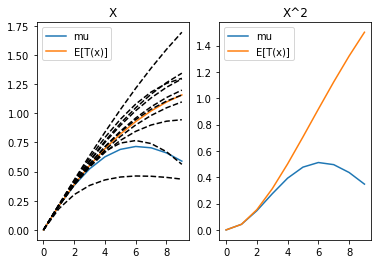

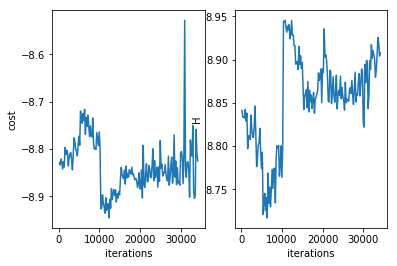

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 34400 
H 8.850916701116116
cost -8.850882184792223
system.D 3


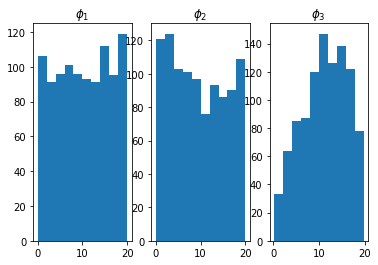

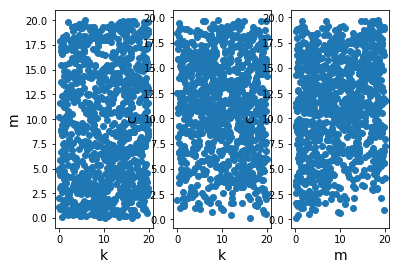

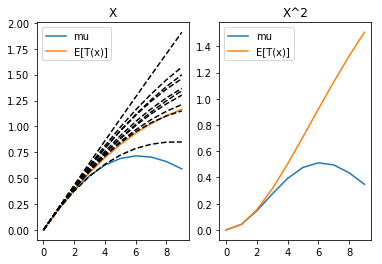

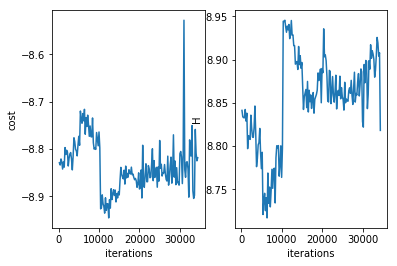

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 34600 
H 8.830469284755956
cost -8.771729545485462
system.D 3


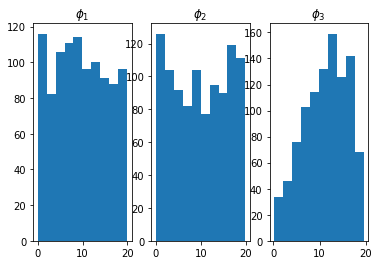

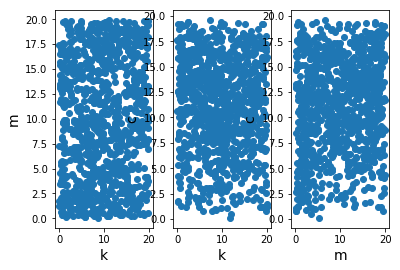

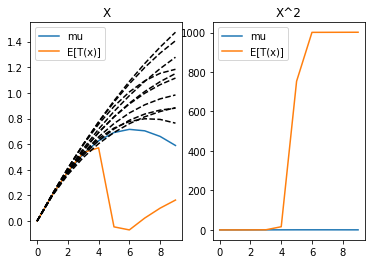

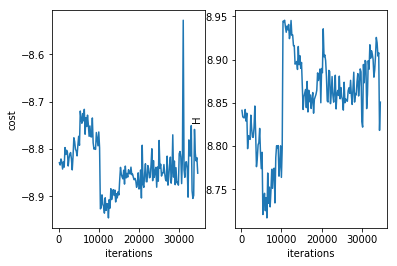

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 34800 
H 8.871659571328943
cost -8.87162515850724
system.D 3


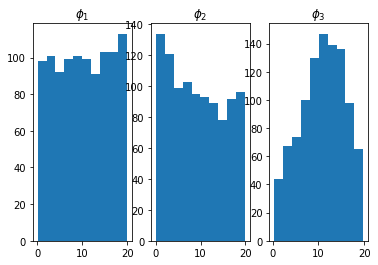

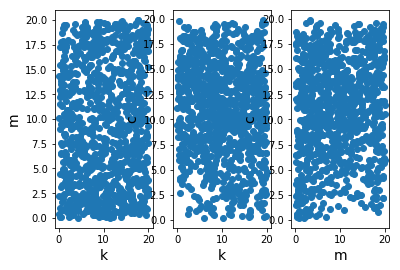

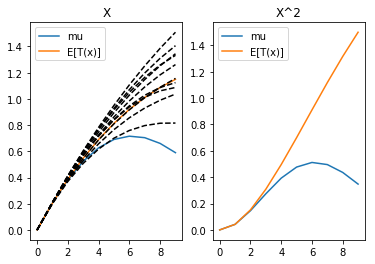

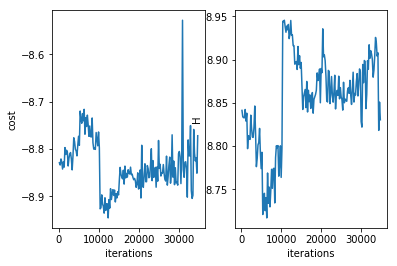

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 35000 
H 8.85427866906186
cost -8.775535344165968
system.D 3


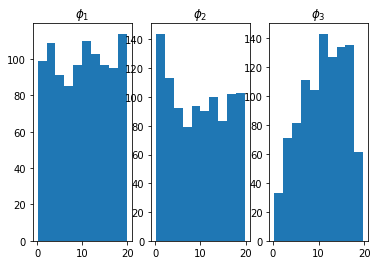

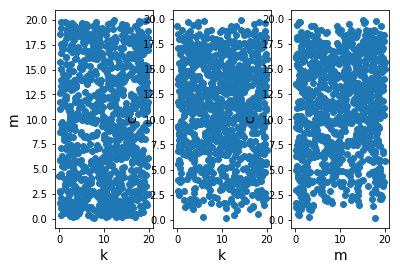

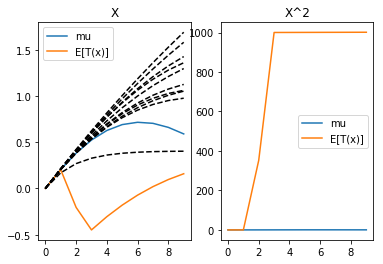

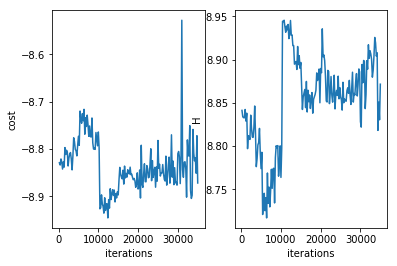

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 35200 
H 8.853752132571207
cost -8.79909732606754
system.D 3


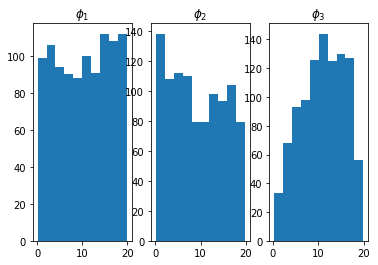

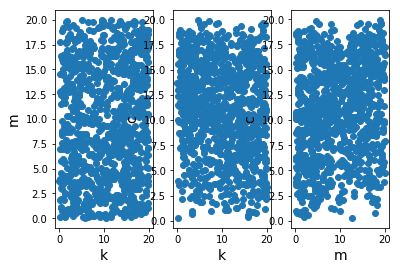

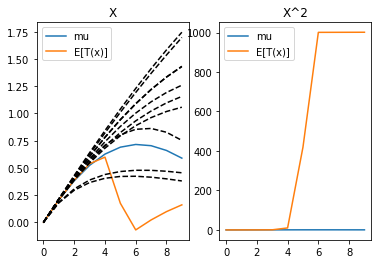

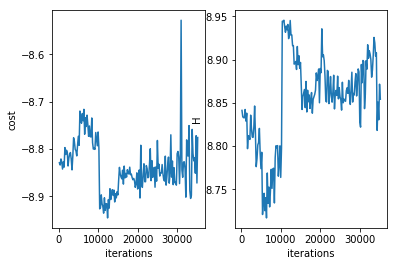

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 35400 
H 8.840493295257827
cost -8.762891627740013
system.D 3


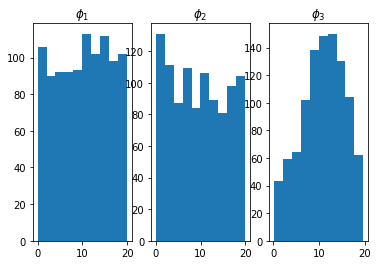

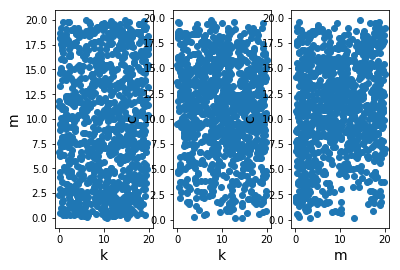

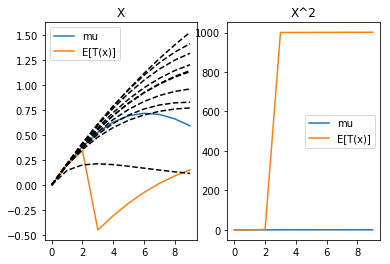

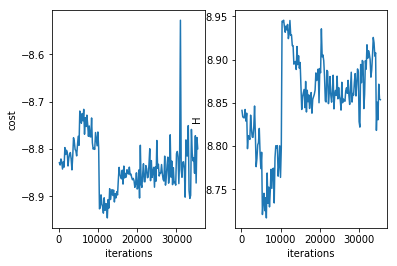

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 35600 
H 8.86497304898852
cost -8.7451301443095
system.D 3


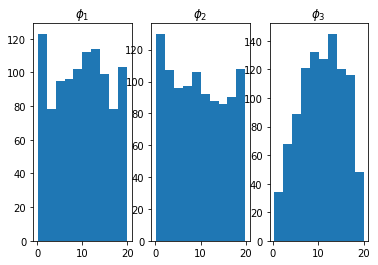

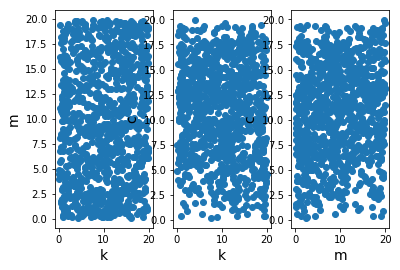

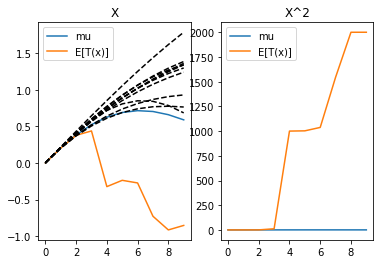

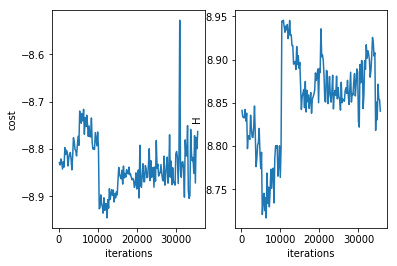

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 35800 
H 8.819222699950679
cost -8.819186672749849
system.D 3


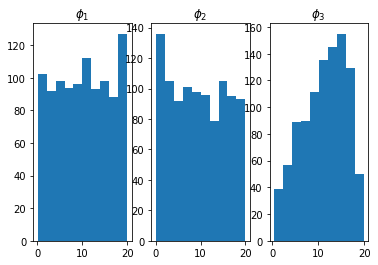

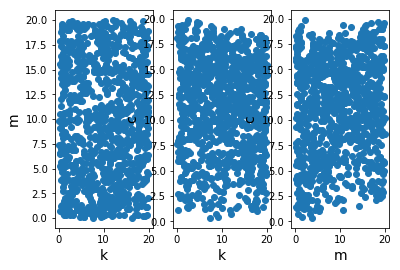

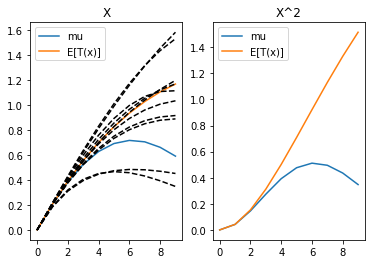

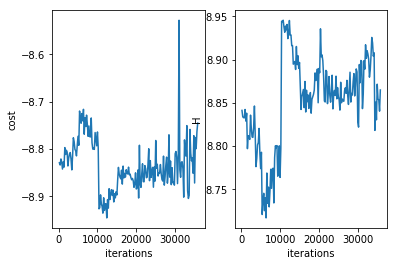

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 36000 
H 8.852230787160384
cost -8.852195930033878
system.D 3


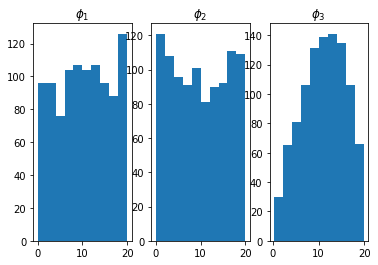

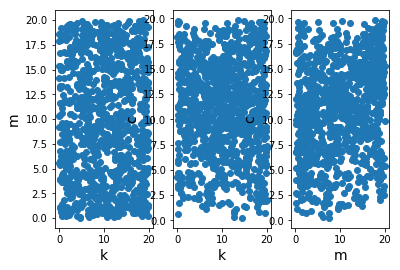

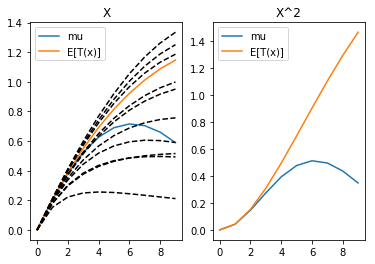

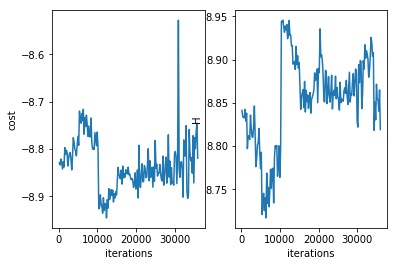

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 36200 
H 8.867910720644964
cost -8.804984257074741
system.D 3


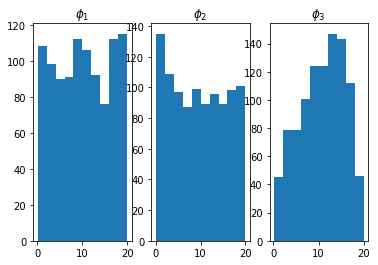

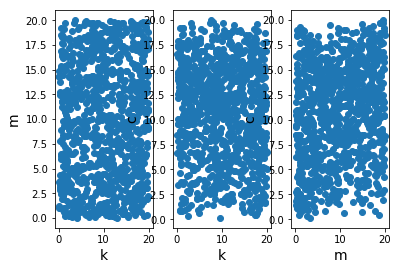

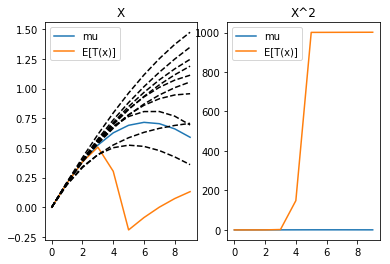

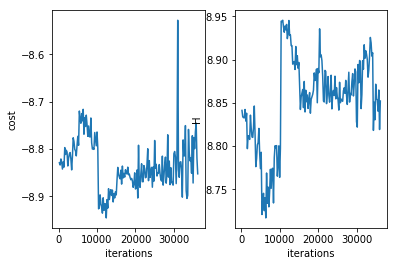

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 36400 
H 8.848471060023163
cost -8.84843624865601
system.D 3


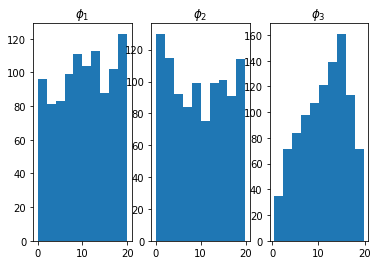

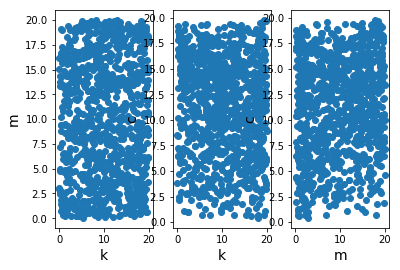

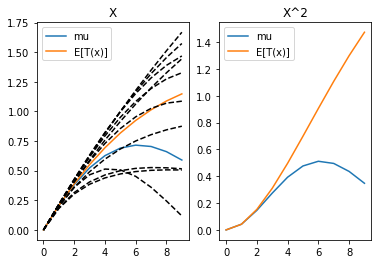

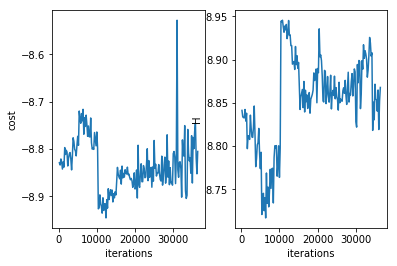

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 36600 
H 8.847770454430243
cost -8.792227835973632
system.D 3


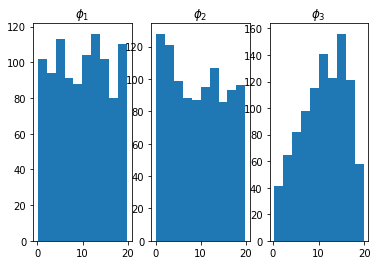

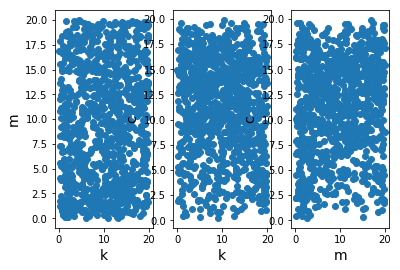

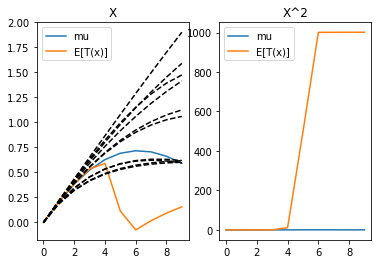

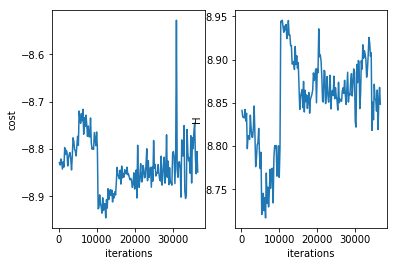

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 36800 
H 8.82398150122546
cost -8.823941517517943
system.D 3


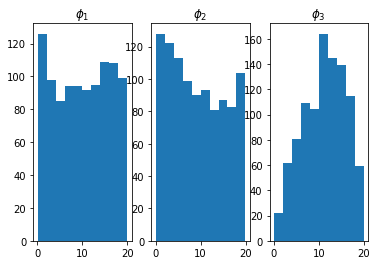

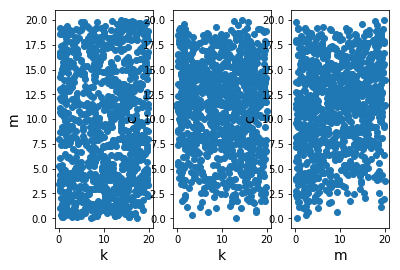

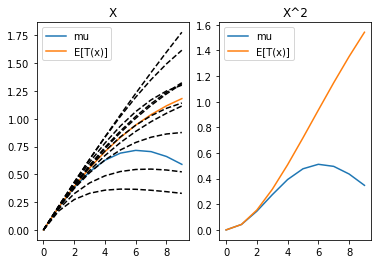

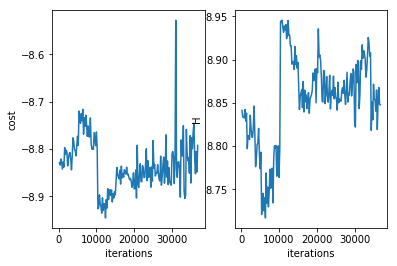

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 37000 
H 8.839465564382827
cost -8.775658678294402
system.D 3


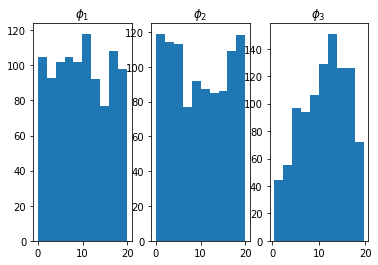

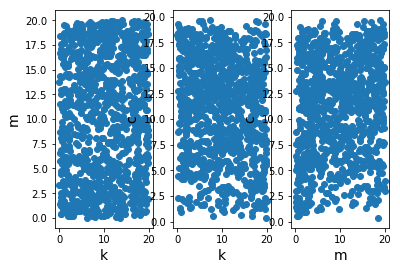

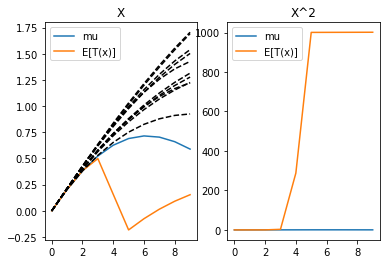

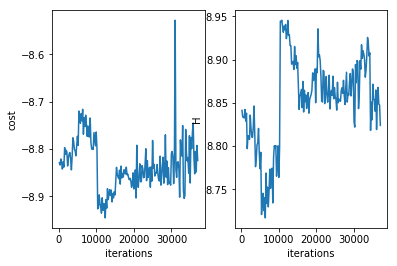

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 37200 
H 8.846284595111122
cost -8.844699143079314
system.D 3


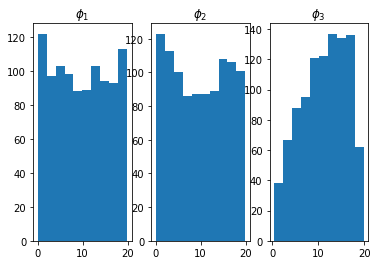

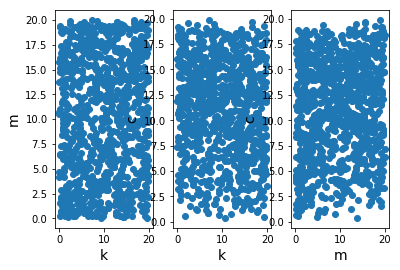

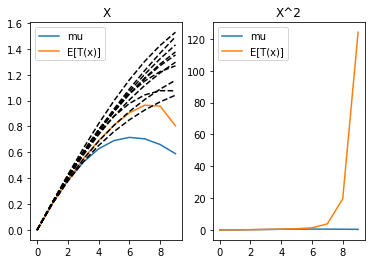

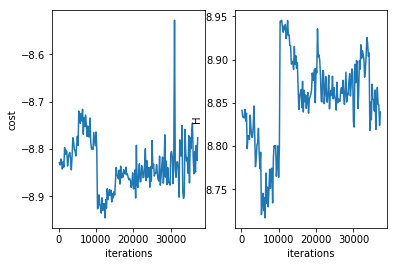

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 37400 
H 8.85731888203252
cost -8.857279720546945
system.D 3


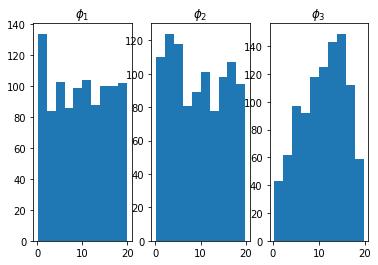

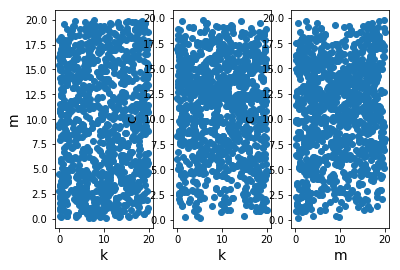

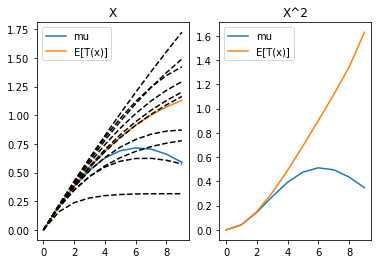

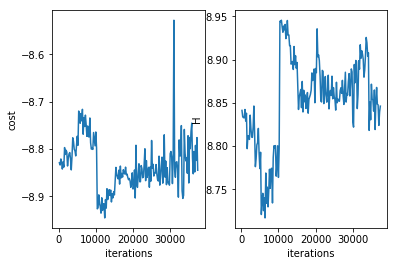

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 37600 
H 8.85930654050516
cost -8.78906701773778
system.D 3


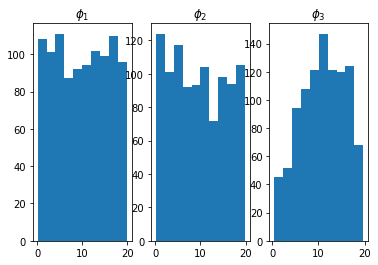

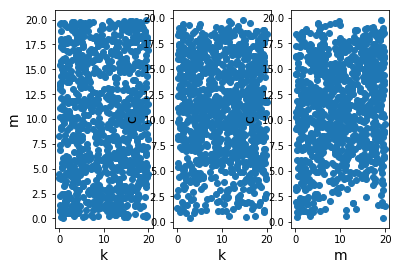

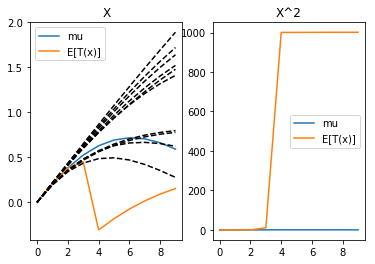

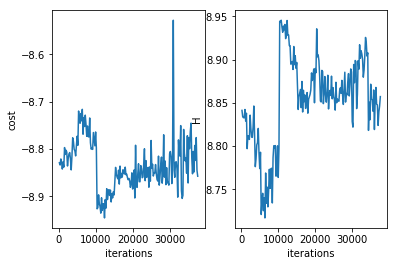

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 37800 
H 8.858472685412428
cost -8.777933260284744
system.D 3


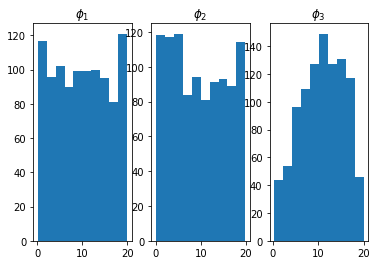

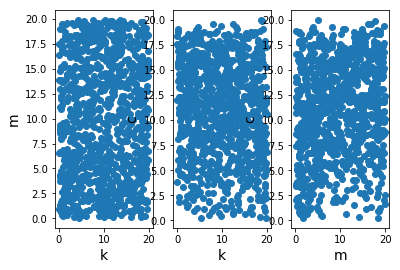

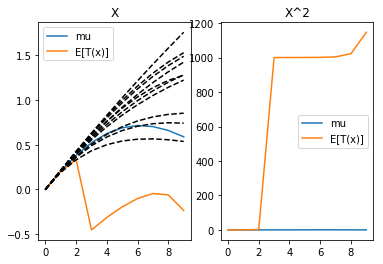

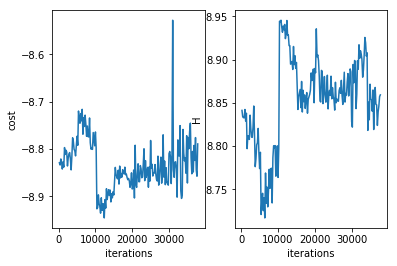

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 38000 
H 8.863739037778167
cost -8.784005650510572
system.D 3


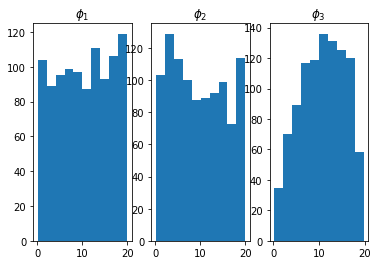

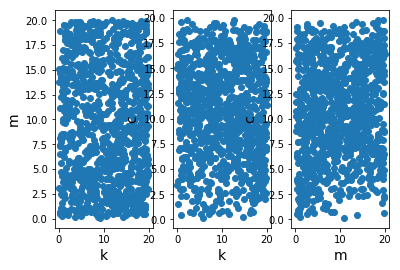

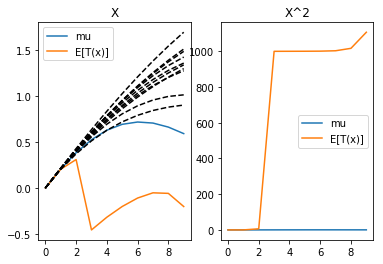

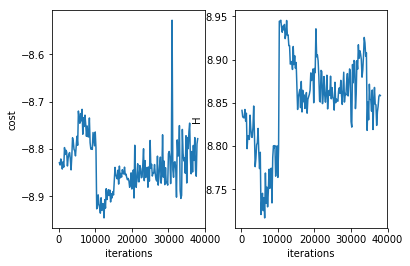

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 38200 
H 8.885468835776726
cost -8.726339780308404
system.D 3


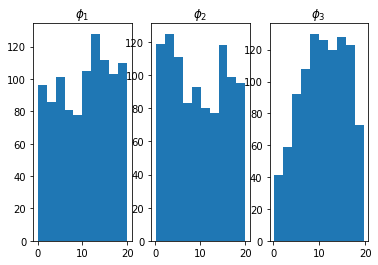

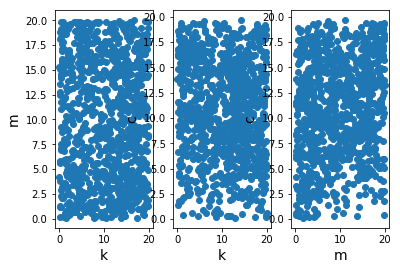

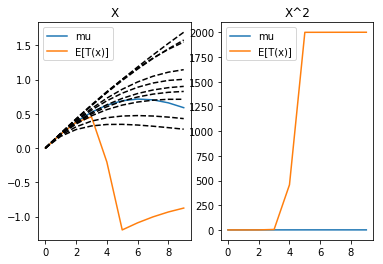

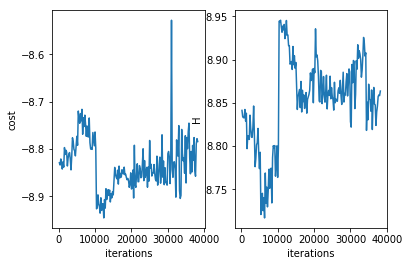

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 38400 
H 8.86502364985437
cost -8.864984352391339
system.D 3


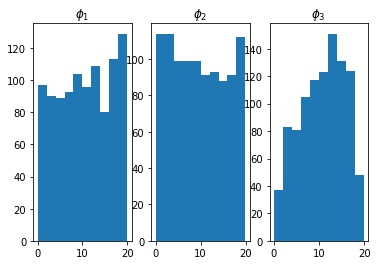

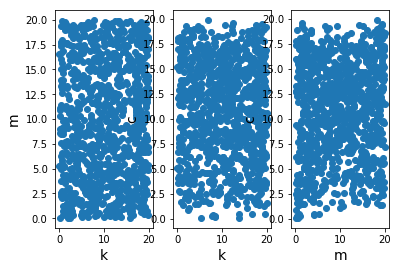

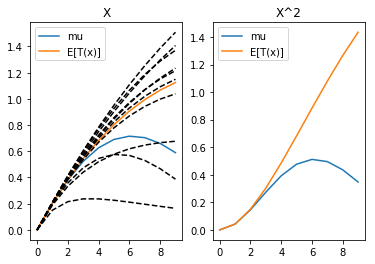

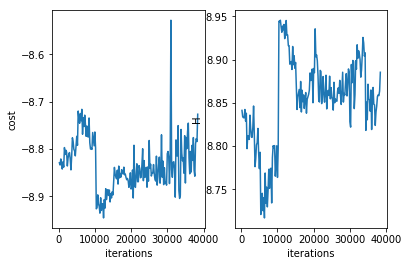

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 38600 
H 8.849037615760128
cost -8.71861451956996
system.D 3


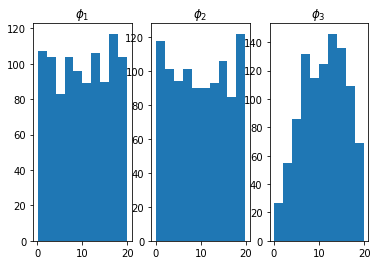

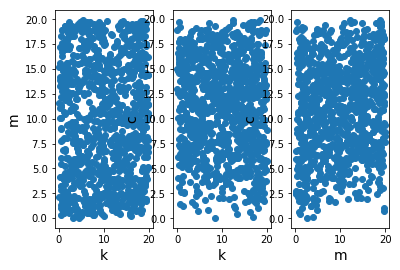

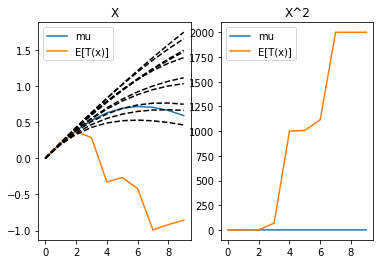

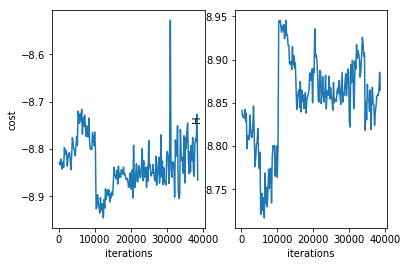

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 38800 
H 8.816882177960007
cost -8.816838355516902
system.D 3


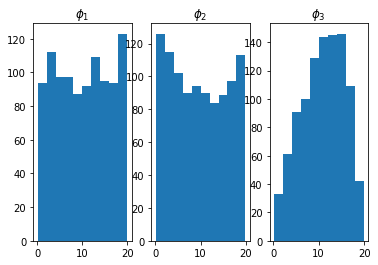

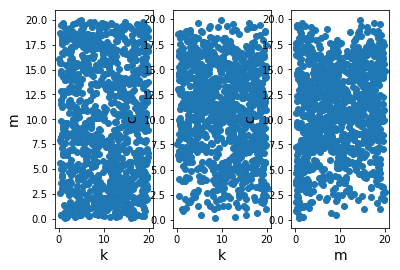

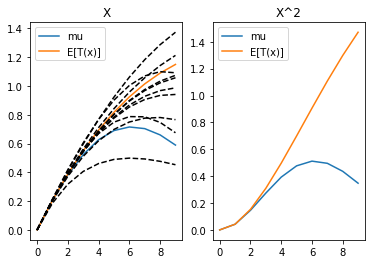

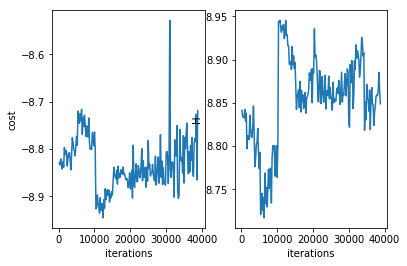

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 39000 
H 8.833727682922985
cost -8.83368627766734
system.D 3


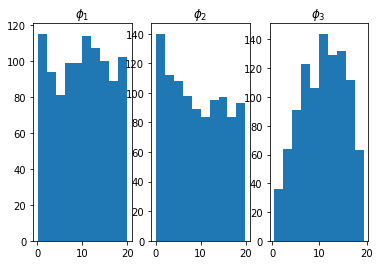

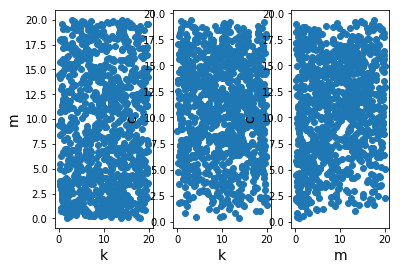

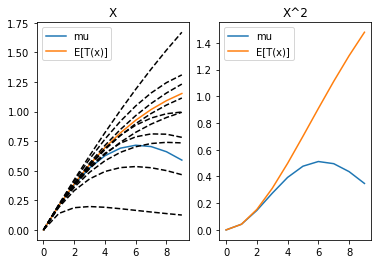

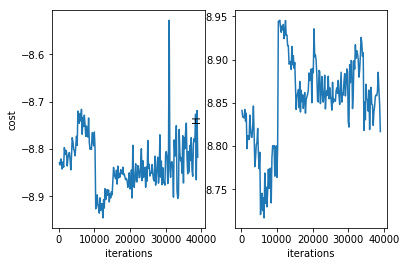

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 39200 
H 8.863968038091821
cost -8.700462228252318
system.D 3


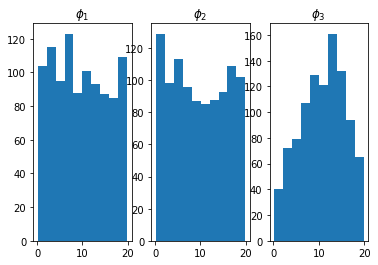

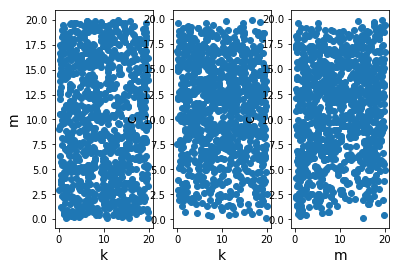

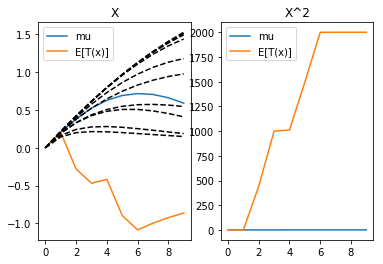

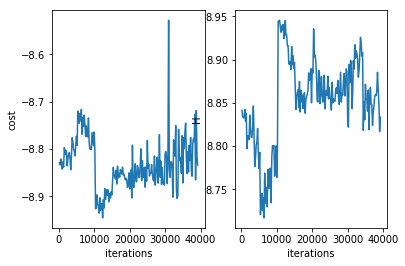

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 39400 
H 8.863678632023625
cost -8.86323816927551
system.D 3


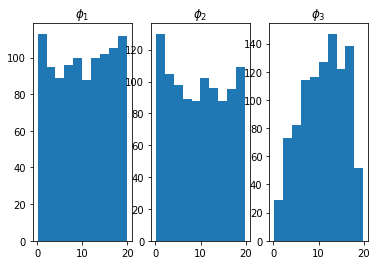

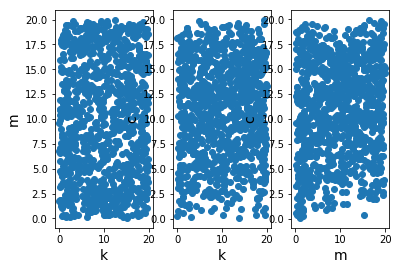

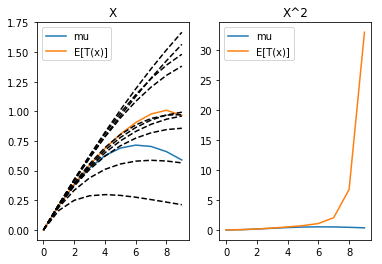

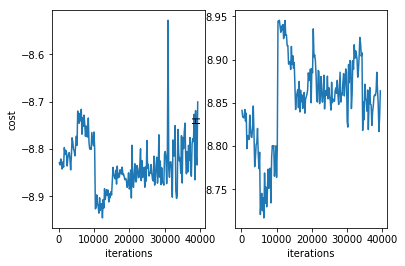

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 39600 
H 8.853662787834553
cost -8.85361985451168
system.D 3


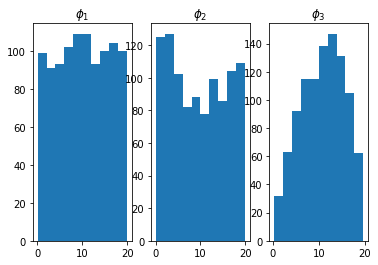

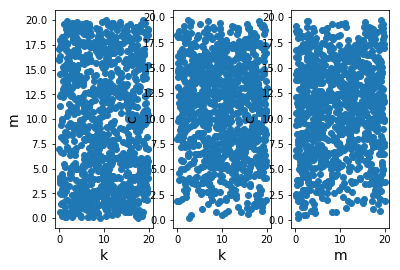

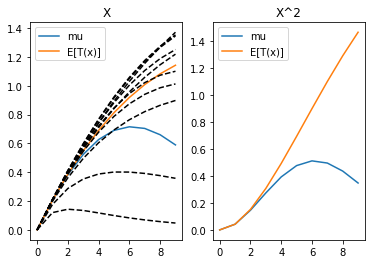

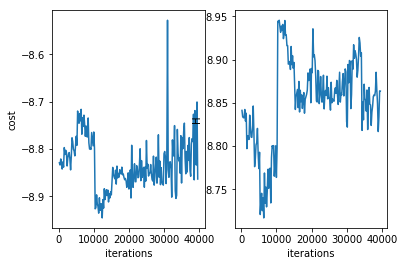

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 39800 
H 8.889680071474038
cost -8.889638111191342
system.D 3


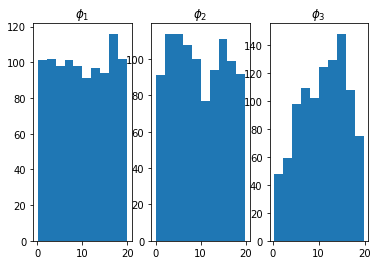

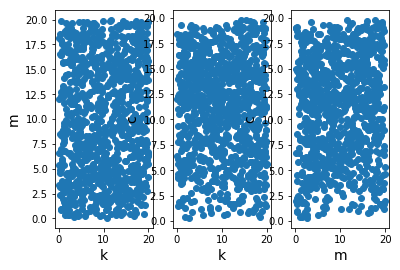

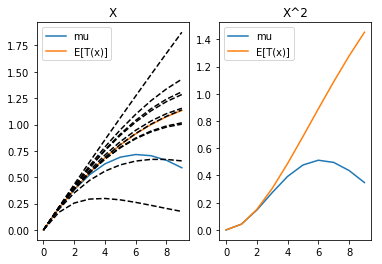

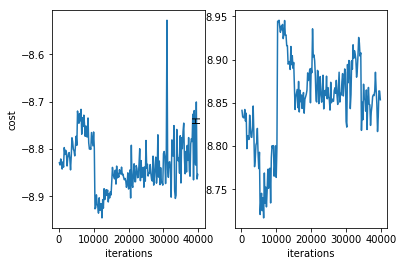

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 40000 
H 8.852722136559628
cost -8.850909716972247
system.D 3


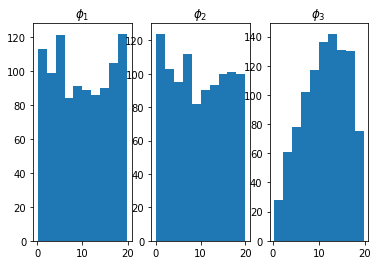

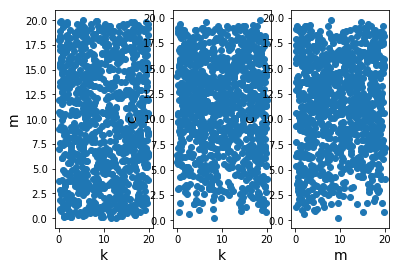

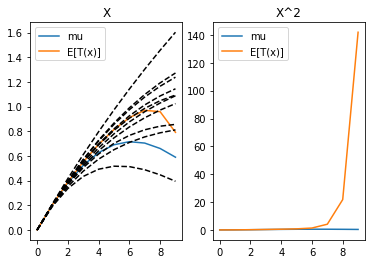

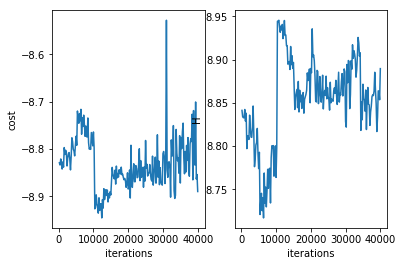

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
Doubling memory allocation for parameter logging.
saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/
AL iteration 5
resetting optimizer
aug lag it 4
lambda [ 0.00000000e+00 -2.22924051e-10 -9.56236293e-09 -1.77852357e-08
 -2.34070535e-08 -3.37345393e-08 -3.36675781e-08 -3.45828260e-08
 -3.92147675e-08 -3.88891961e-08 -8.50000000e-13  2.13113837e-09
  8.58714539e-06  1.70284417e-05  1.96615142e-05  3.40064243e-05
  3.40607347e-05  3.46549900e-05  4.12711541e-05  4.25102199e-05]
c 2.56e-08
saving model at iter 0
******************************************
it = 40200 
H 8.8426848342926
cost -8.842537200749781
system.D 3


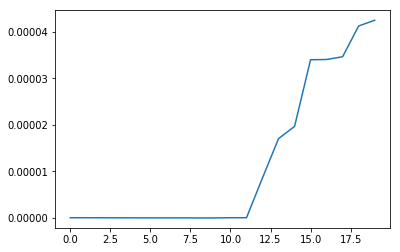

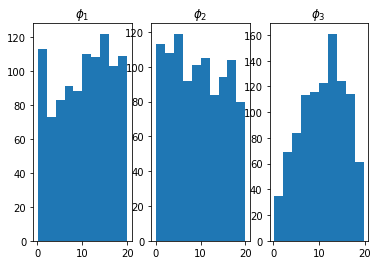

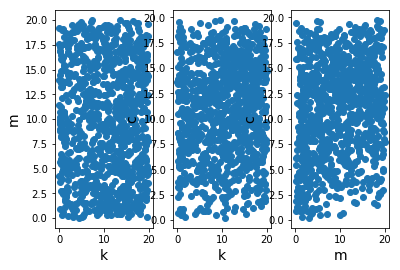

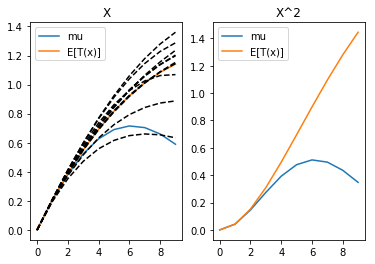

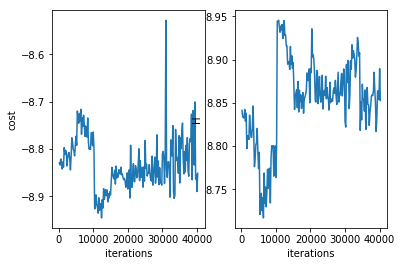

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 40400 
H 8.827306501945003
cost -8.826997420861257
system.D 3


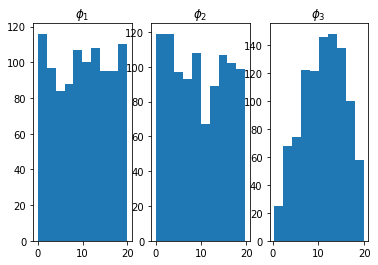

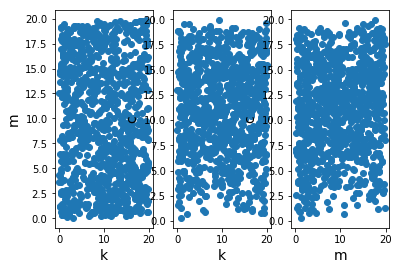

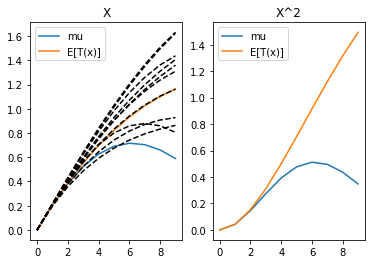

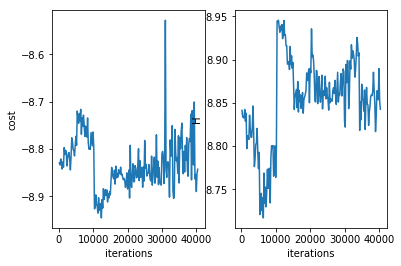

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 40600 
H 8.856013937570472
cost -8.856541013822817
system.D 3


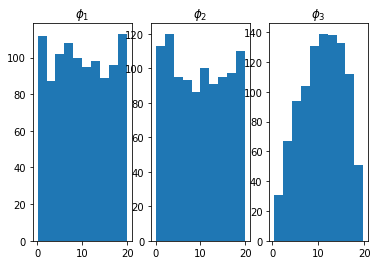

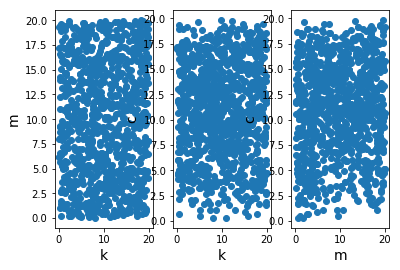

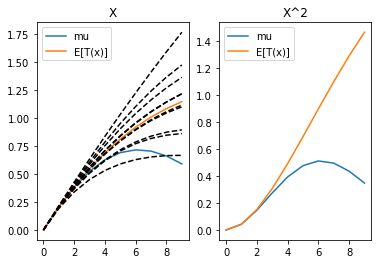

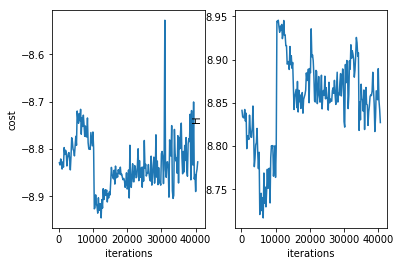

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 40800 
H 8.84141680828933
cost -8.841078608449338
system.D 3


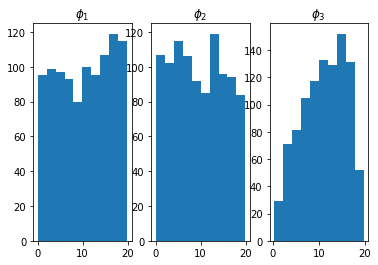

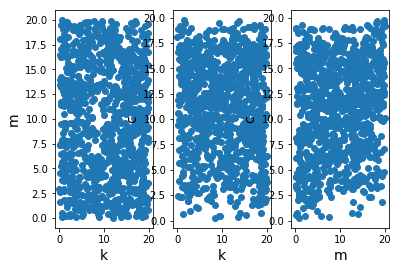

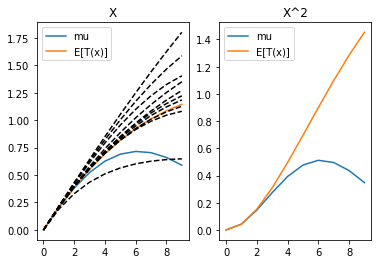

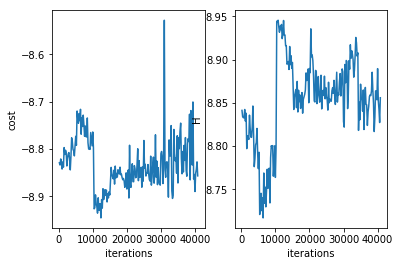

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 41000 
H 8.834793603983606
cost -8.834606170496912
system.D 3


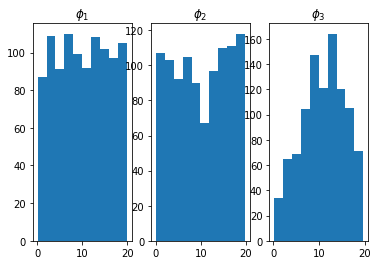

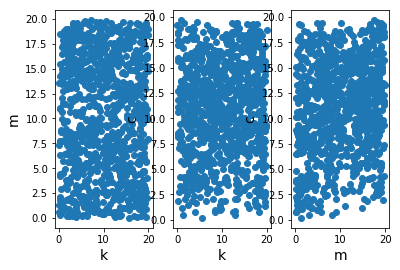

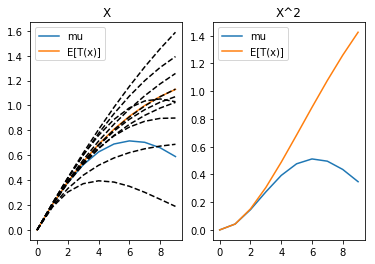

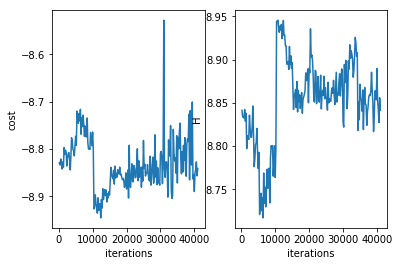

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 41200 
H 8.873826364678878
cost -8.6318711577941
system.D 3


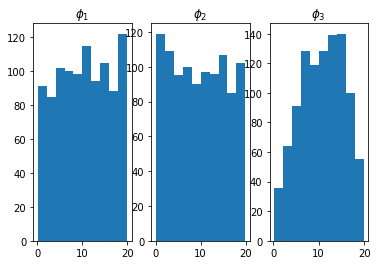

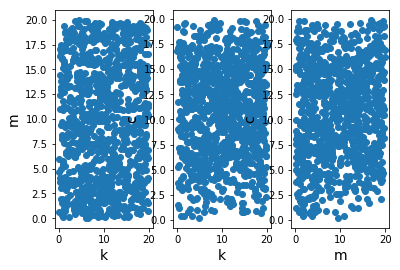

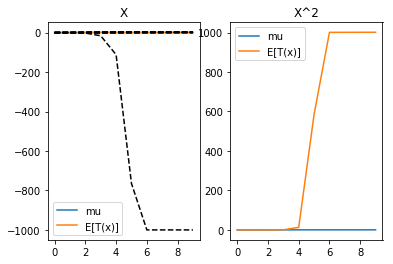

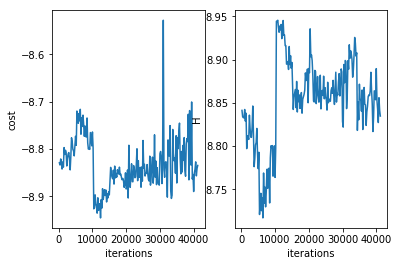

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 41400 
H 8.85118820022036
cost -8.850758176057282
system.D 3


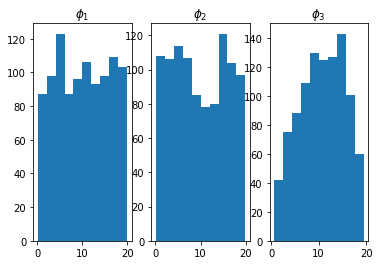

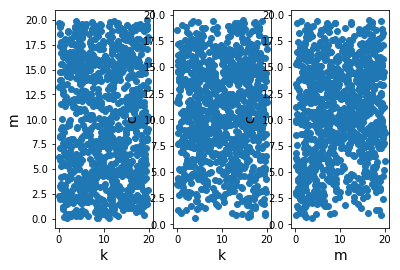

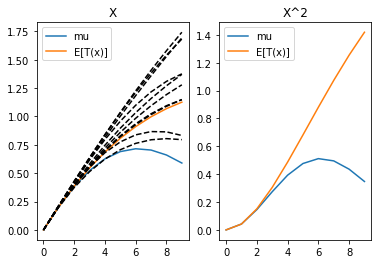

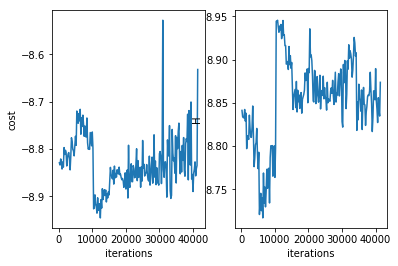

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 41600 
H 8.840920815108397
cost -8.840416804849
system.D 3


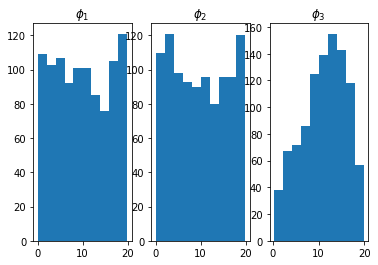

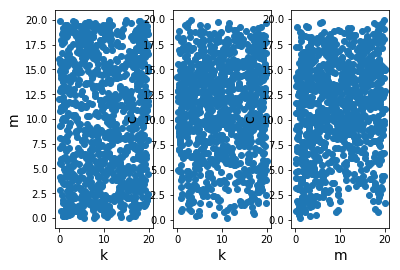

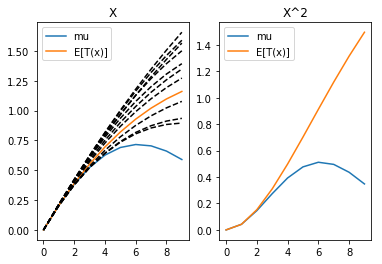

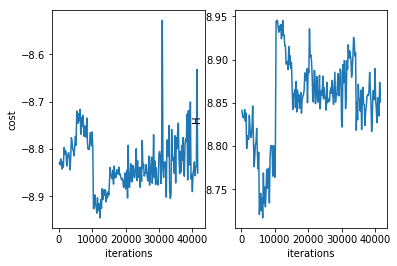

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 41800 
H 8.879014524662914
cost -8.878426686684595
system.D 3


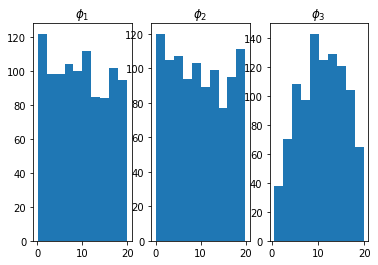

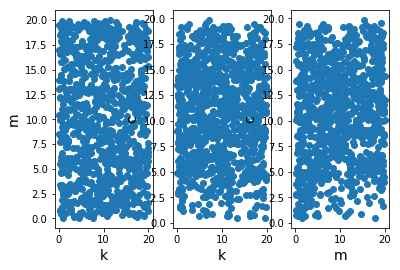

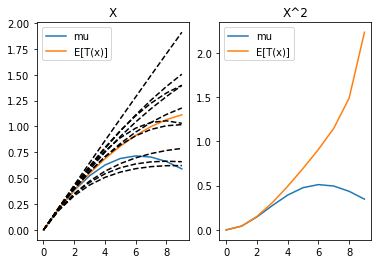

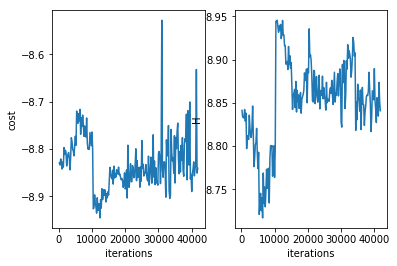

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 42000 
H 8.852503953373894
cost -8.852795519763179
system.D 3


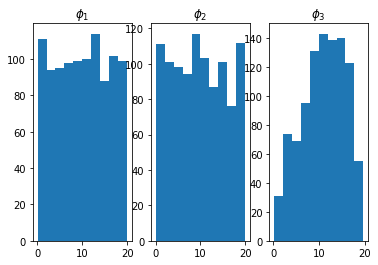

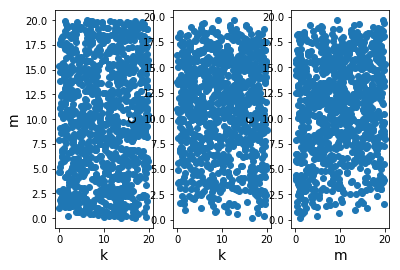

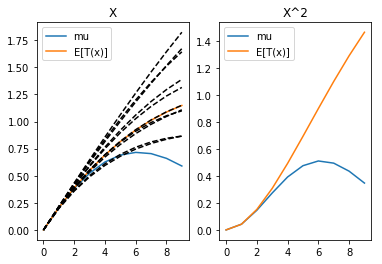

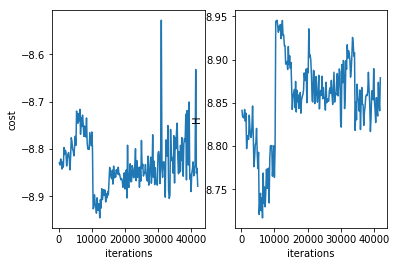

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 42200 
H 8.835485931222085
cost -8.83476941289845
system.D 3


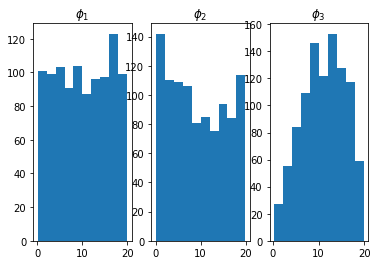

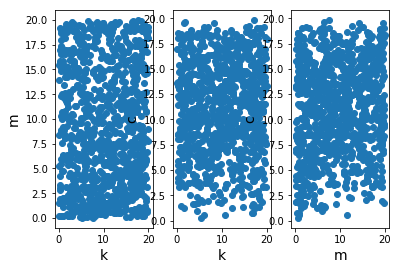

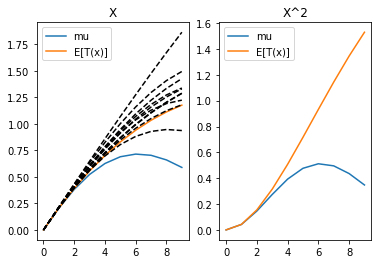

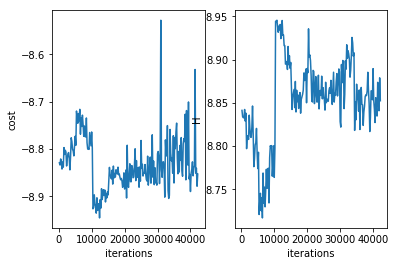

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 42400 
H 8.865898084813987
cost -8.771376947514023
system.D 3


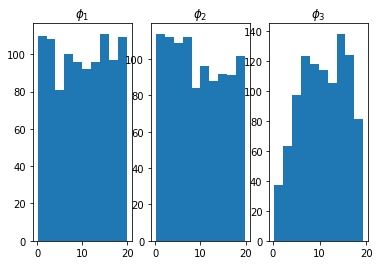

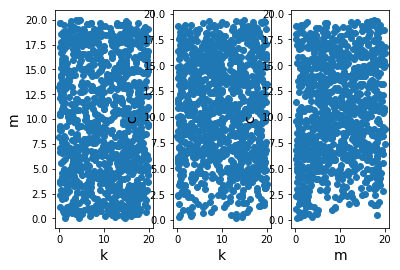

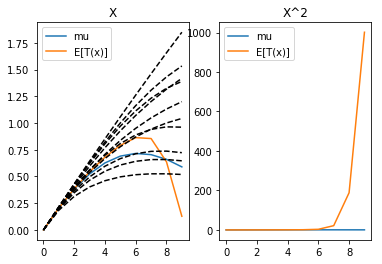

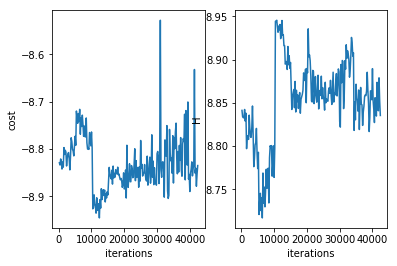

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 42600 
H 8.872696917585836
cost -8.752194207514943
system.D 3


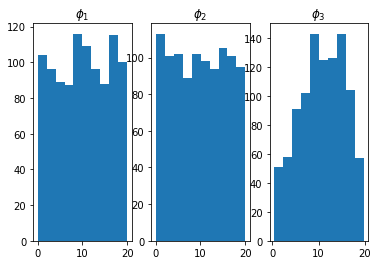

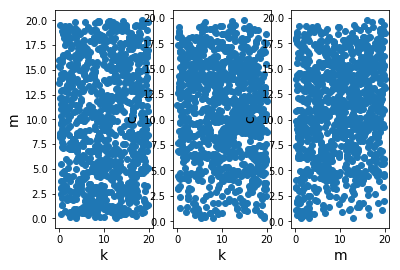

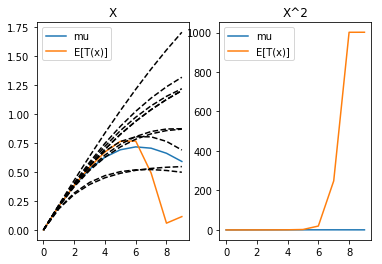

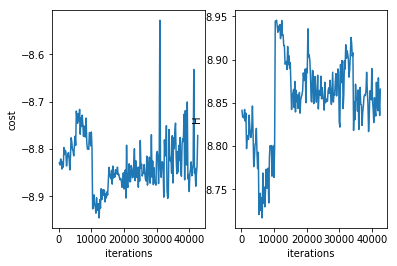

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 42800 
H 8.87301596784957
cost -8.560031241913155
system.D 3


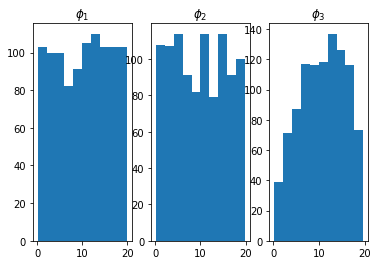

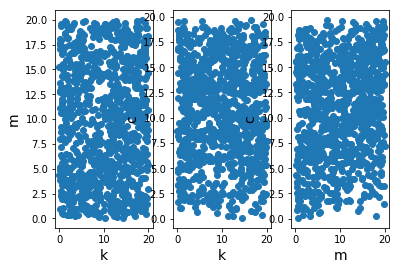

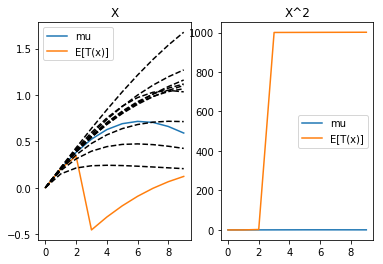

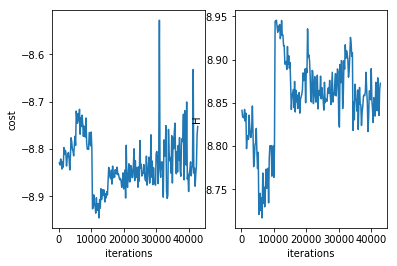

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 43000 
H 8.875744438427096
cost -8.56085591612355
system.D 3


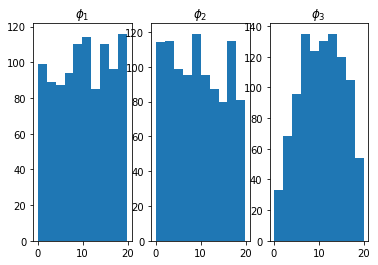

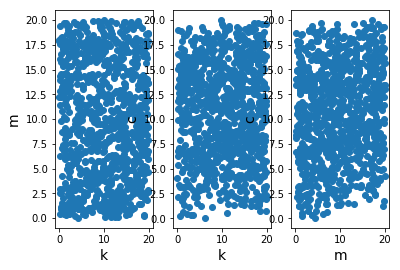

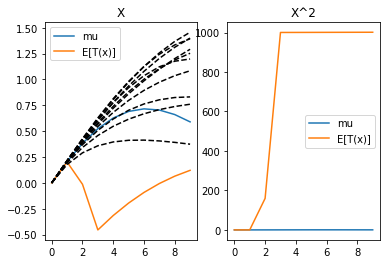

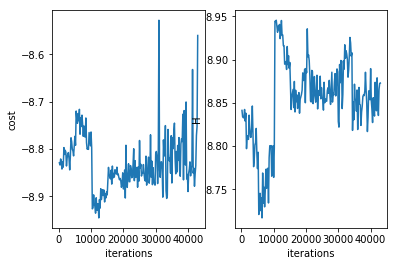

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 43200 
H 8.858111211681537
cost -8.85758116578306
system.D 3


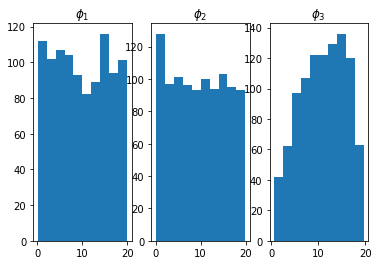

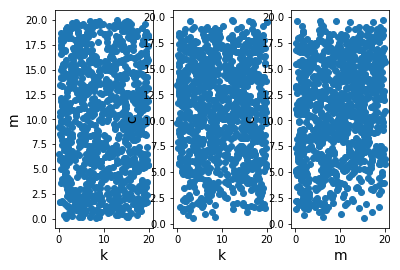

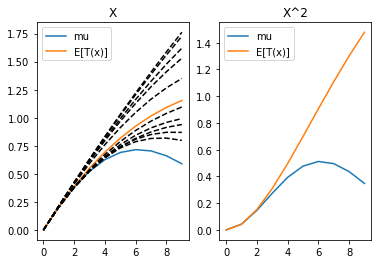

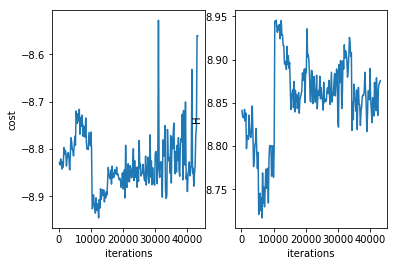

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 43400 
H 8.842900600966484
cost -8.842458871070704
system.D 3


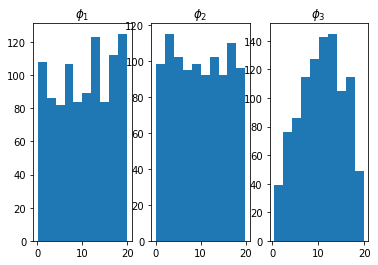

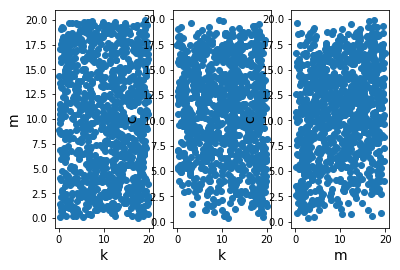

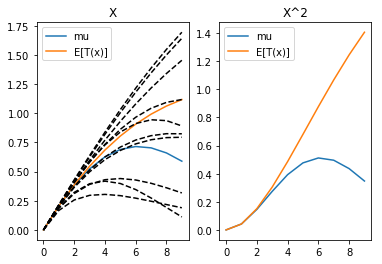

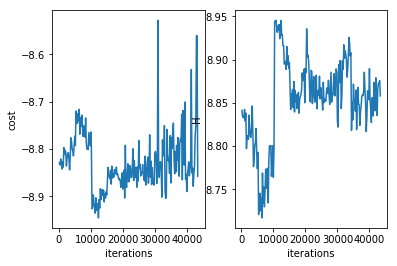

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 43600 
H 8.84264821492176
cost -8.842215198451573
system.D 3


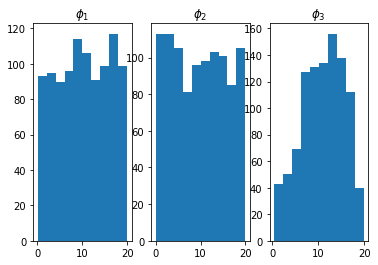

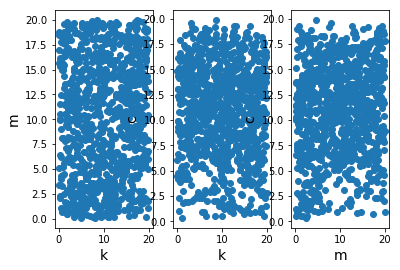

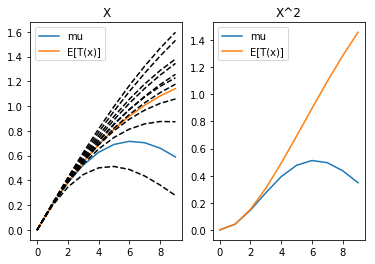

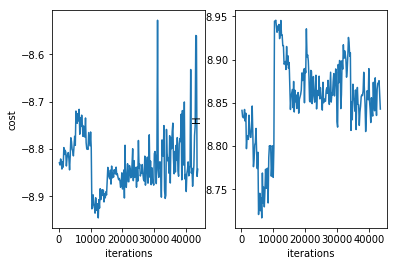

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 43800 
H 8.87651213385139
cost -8.572958397039653
system.D 3


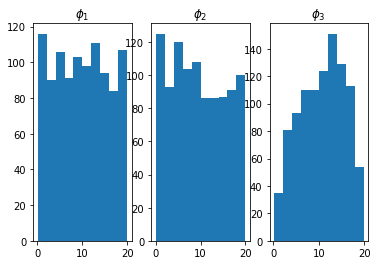

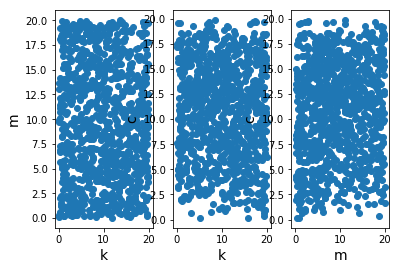

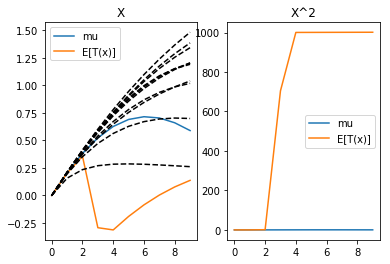

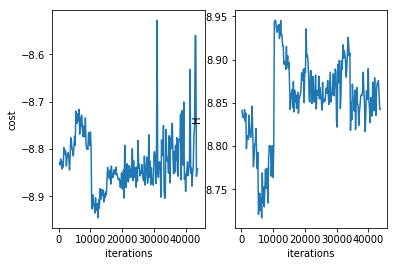

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 44000 
H 8.866894308622738
cost -8.554330175428536
system.D 3


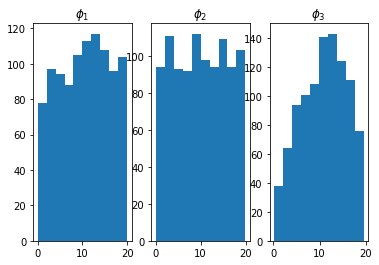

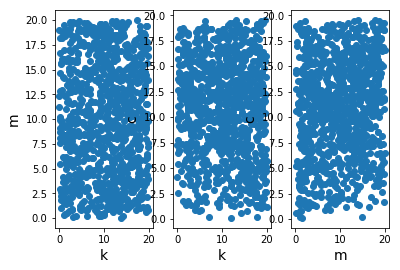

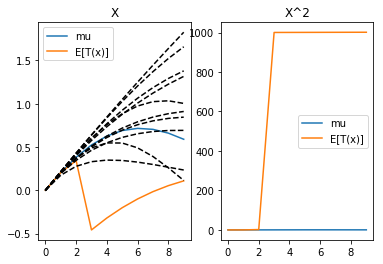

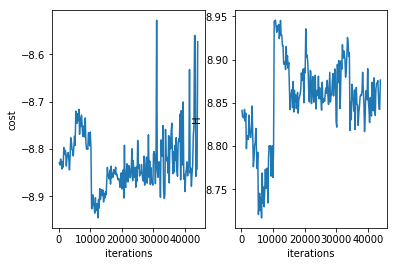

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 44200 
H 8.820969444583632
cost -8.820528748835203
system.D 3


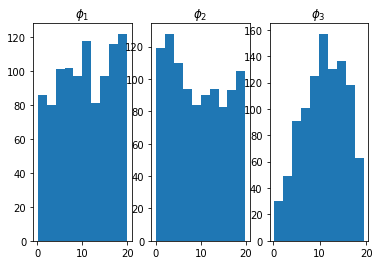

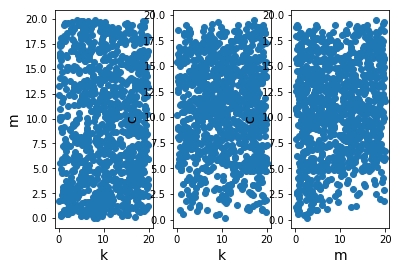

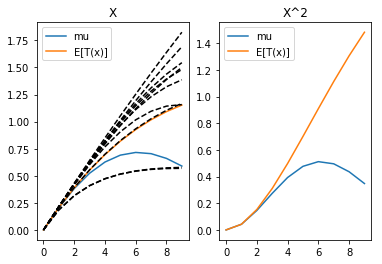

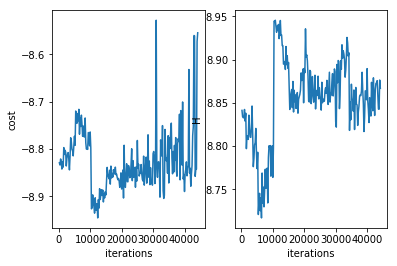

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 44400 
H 8.86991741704008
cost -8.870205565019473
system.D 3


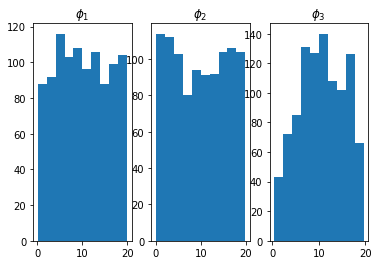

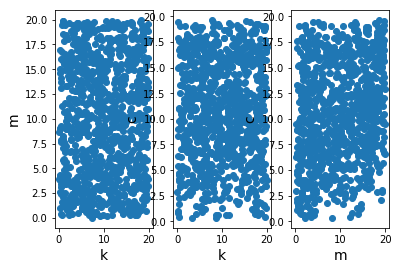

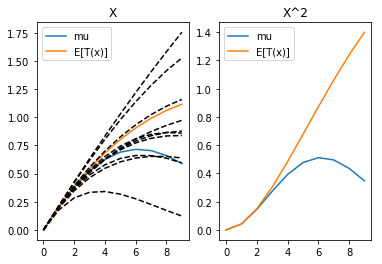

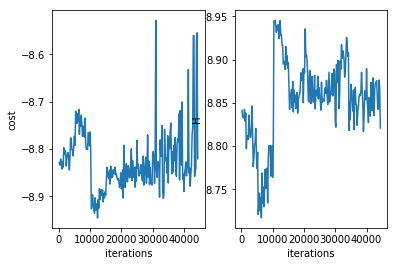

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 44600 
H 8.830831373853878
cost -8.830939498742318
system.D 3


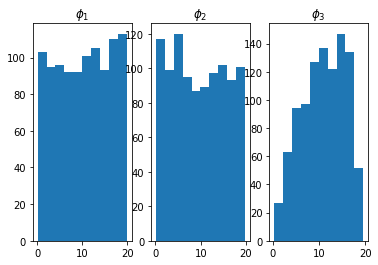

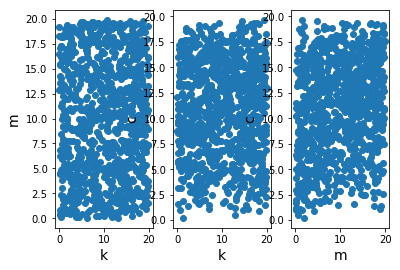

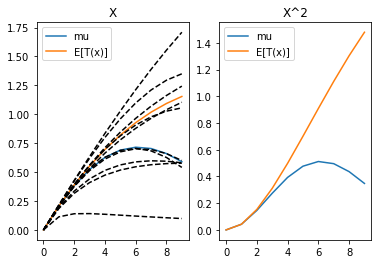

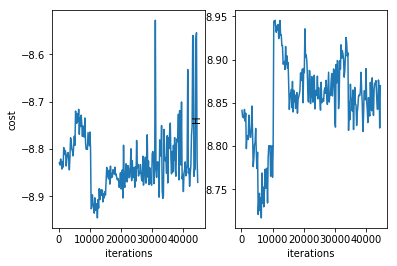

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 44800 
H 8.802957831973965
cost -8.77711464574582
system.D 3


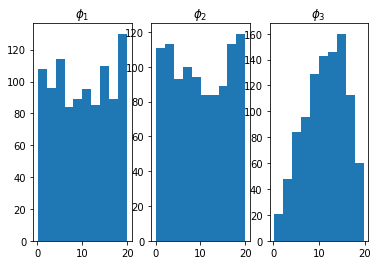

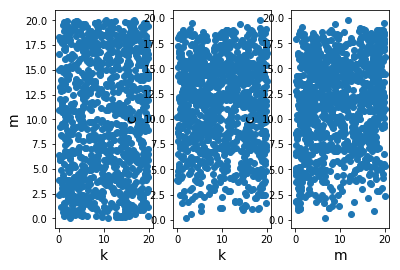

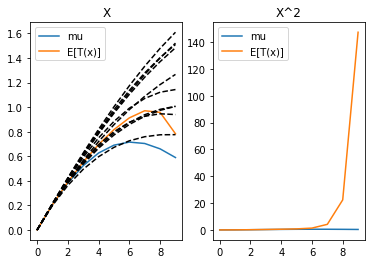

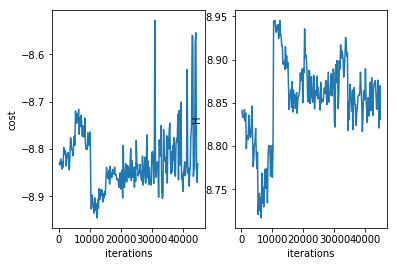

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 45000 
H 8.866902559454017
cost -8.866305434181129
system.D 3


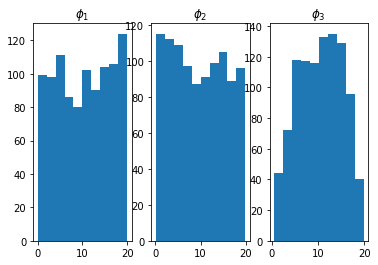

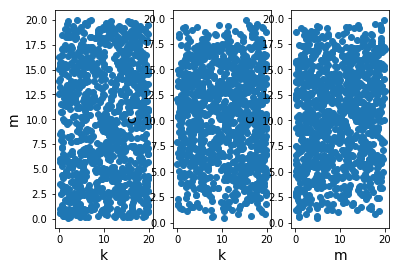

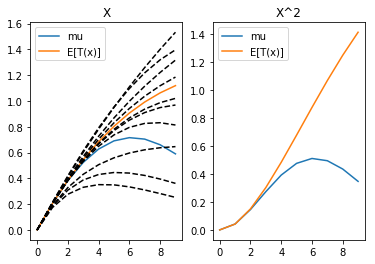

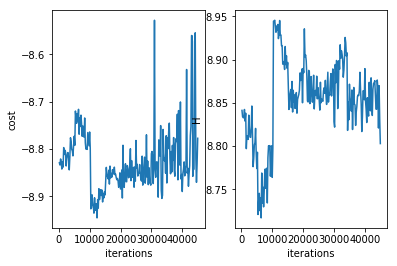

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 45200 
H 8.86517731740835
cost -8.865344602513202
system.D 3


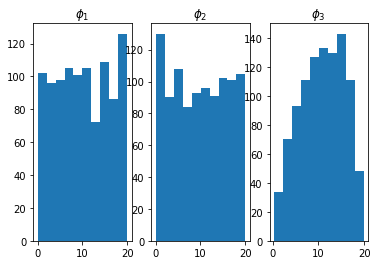

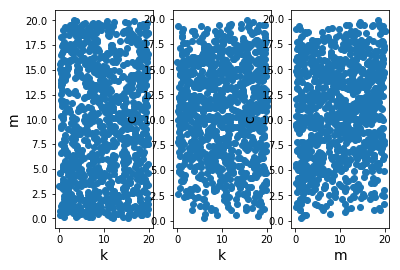

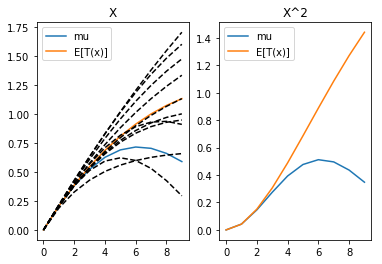

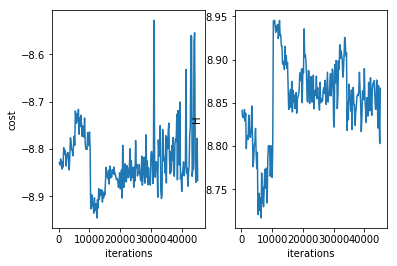

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 45400 
H 8.869349285694943
cost -8.617813610808202
system.D 3


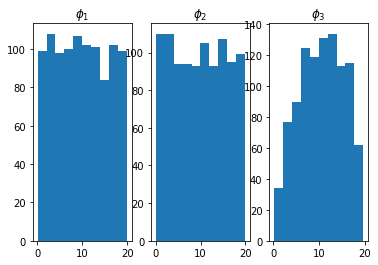

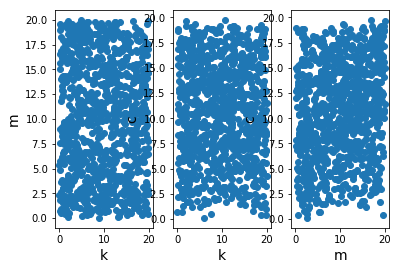

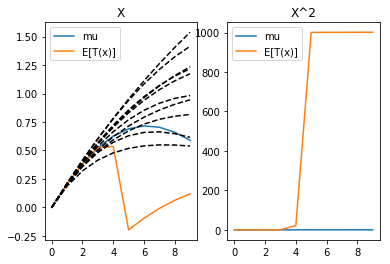

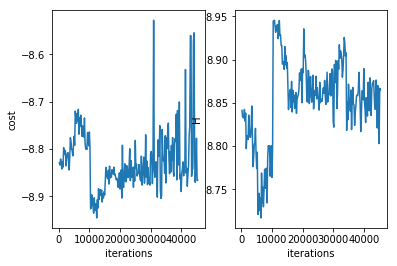

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 45600 
H 8.861133804097001
cost -8.86152659611877
system.D 3


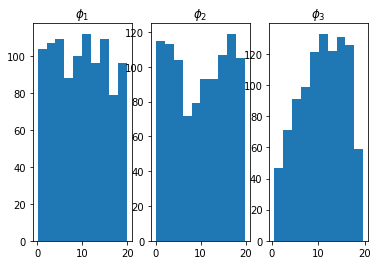

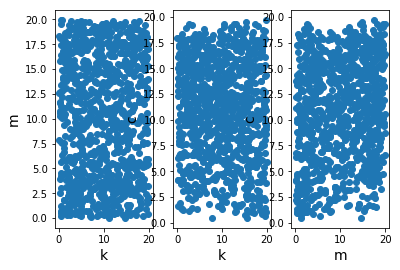

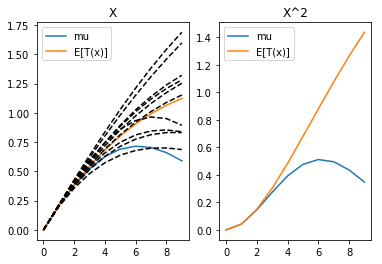

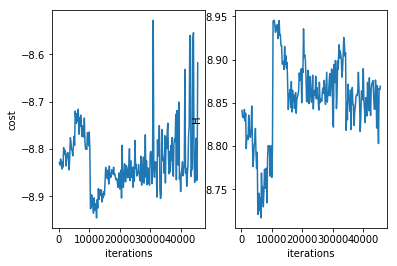

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 45800 
H 8.857568765970916
cost -8.857073272005765
system.D 3


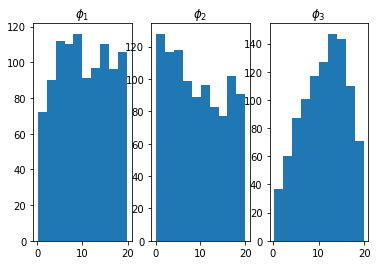

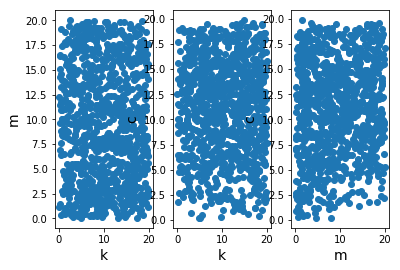

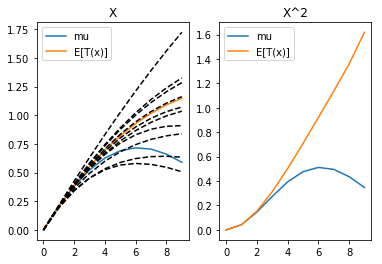

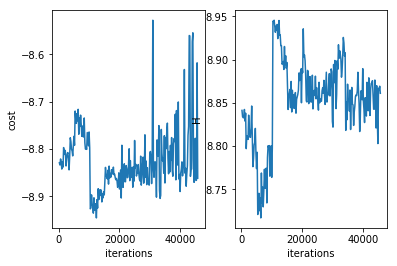

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 46000 
H 8.904552596793863
cost -8.9043240691004
system.D 3


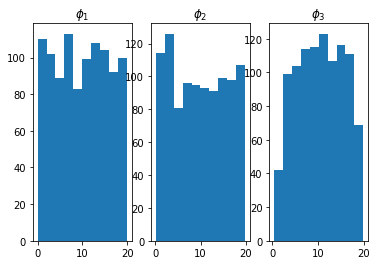

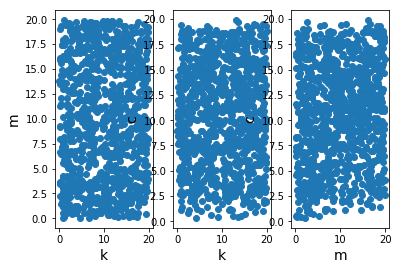

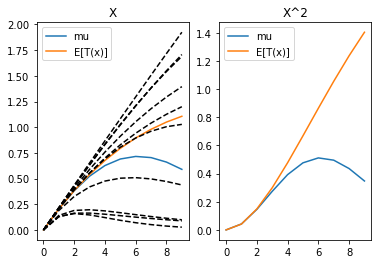

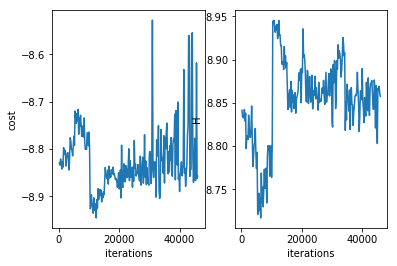

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 46200 
H 8.844093244467302
cost -8.843531562107326
system.D 3


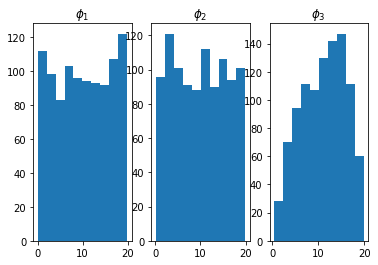

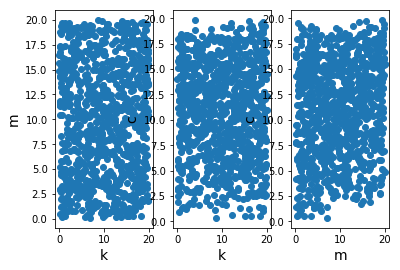

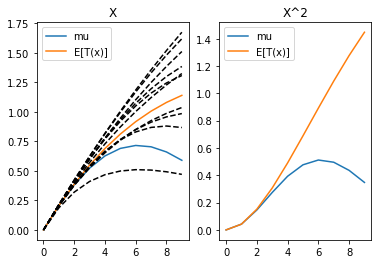

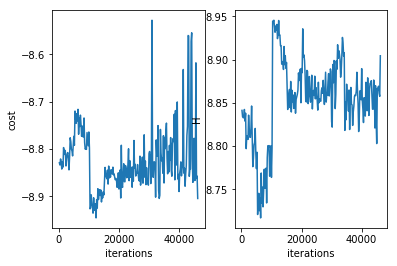

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 46400 
H 8.885295751473164
cost -8.885076839174284
system.D 3


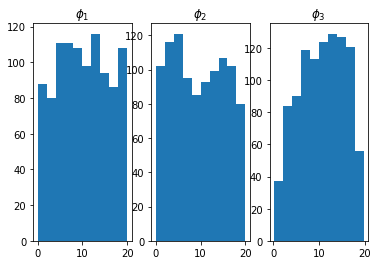

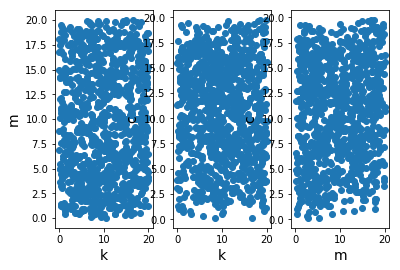

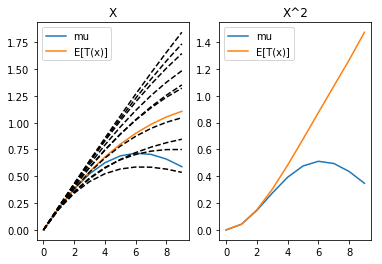

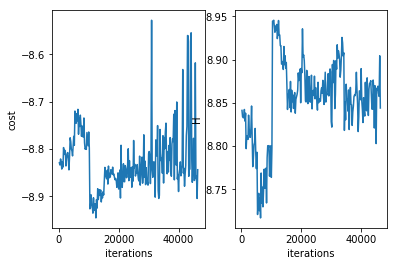

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 46600 
H 8.879848421279293
cost -8.879880081781463
system.D 3


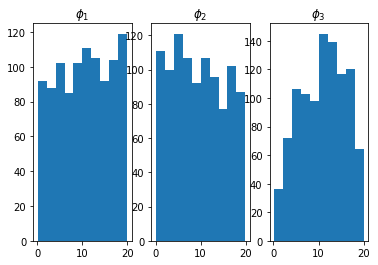

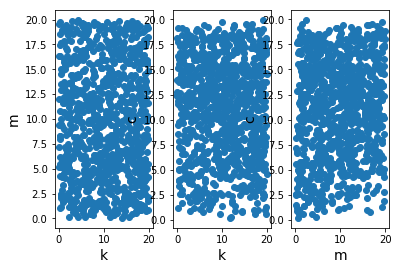

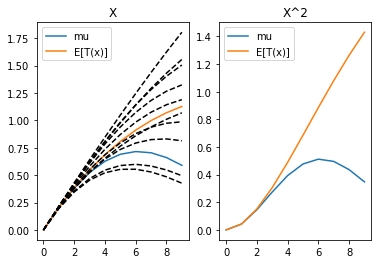

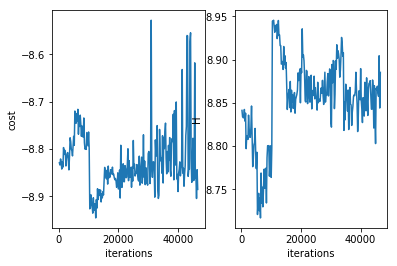

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 46800 
H 8.88585323188424
cost -8.293457332651103
system.D 3


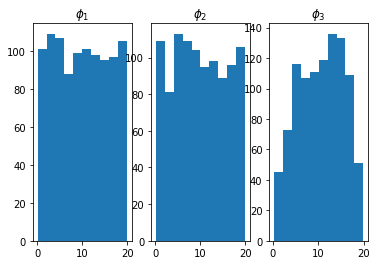

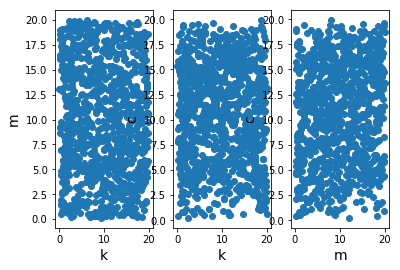

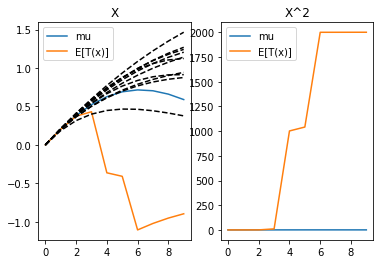

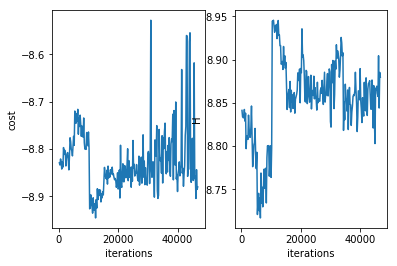

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 47000 
H 8.871316914807158
cost -8.871255143192212
system.D 3


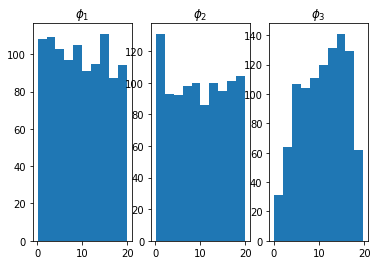

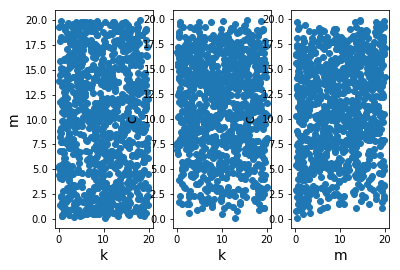

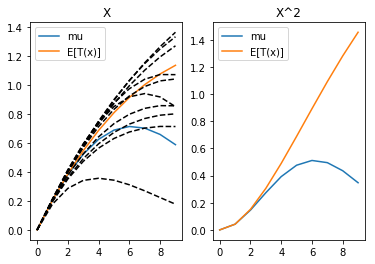

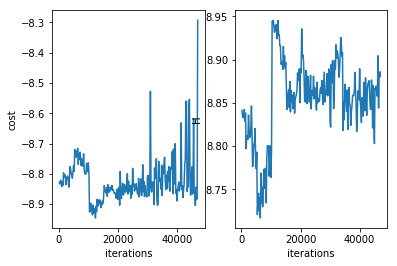

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 47200 
H 8.885351819001233
cost -8.601541517854095
system.D 3


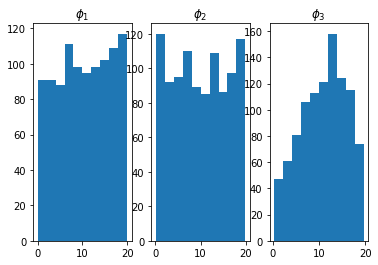

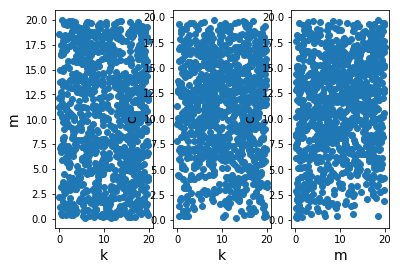

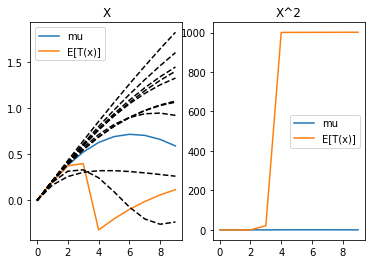

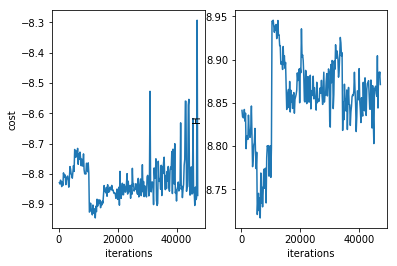

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 47400 
H 8.898224549774946
cost -8.8979015214722
system.D 3


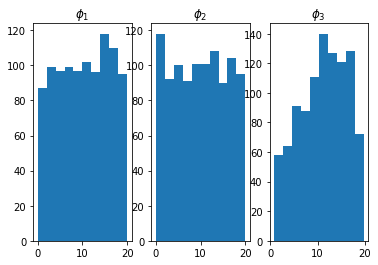

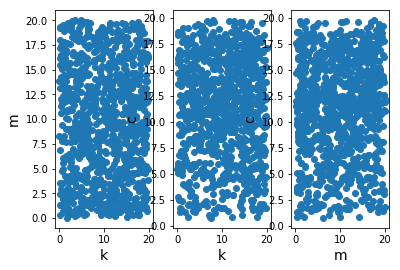

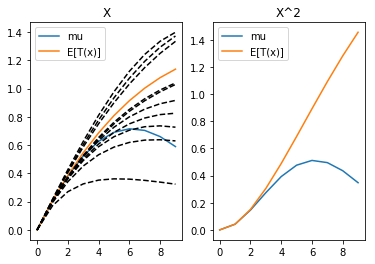

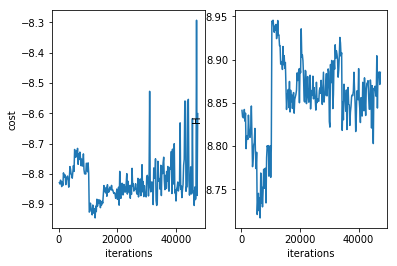

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 47600 
H 8.872801241605675
cost -8.872434140875836
system.D 3


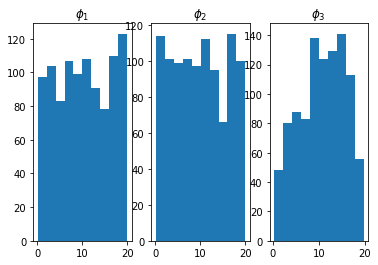

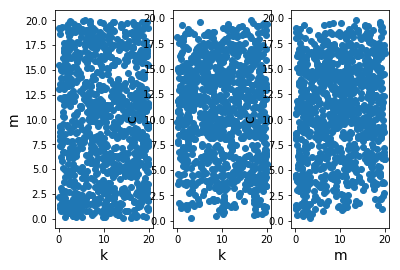

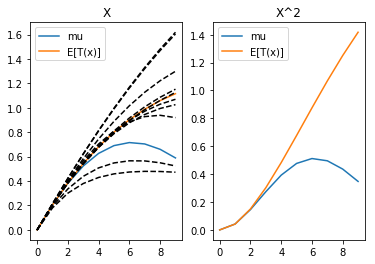

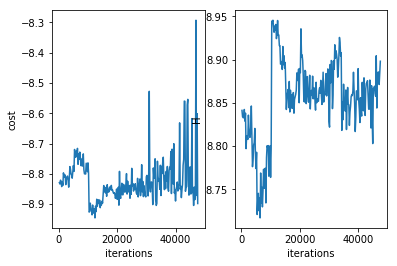

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 47800 
H 8.87524025545321
cost -8.876558489028868
system.D 3


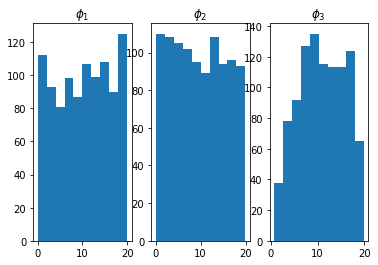

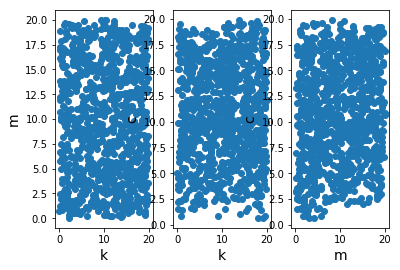

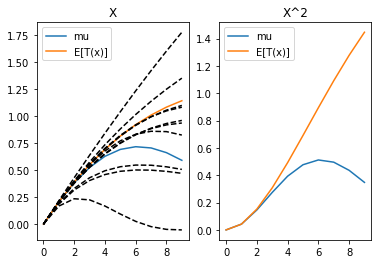

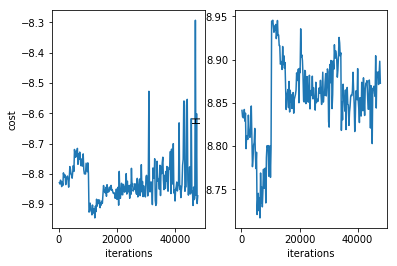

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 48000 
H 8.871659690426421
cost -8.558596875040008
system.D 3


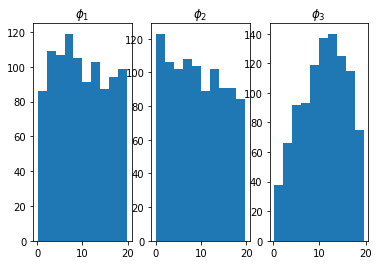

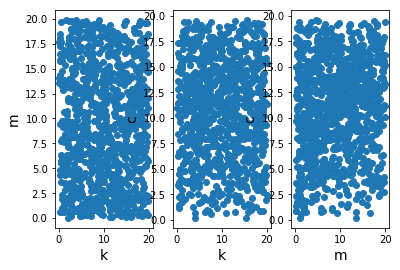

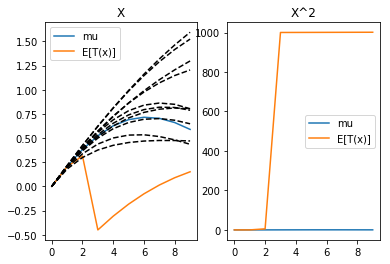

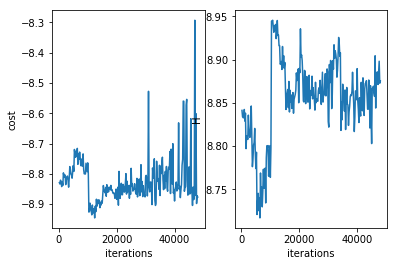

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 48200 
H 8.844304433719978
cost -8.844322738845452
system.D 3


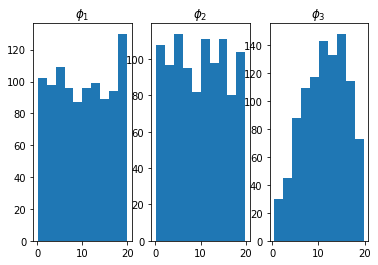

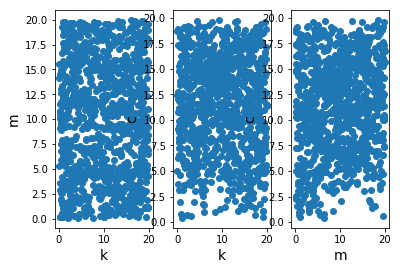

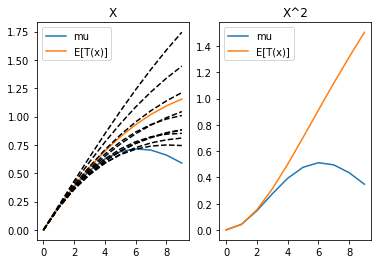

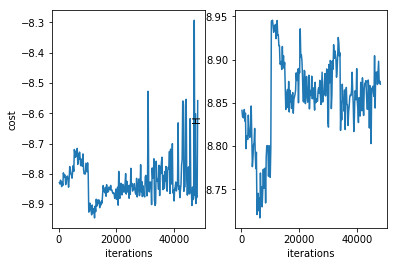

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 48400 
H 8.862510978018038
cost -8.86208202645656
system.D 3


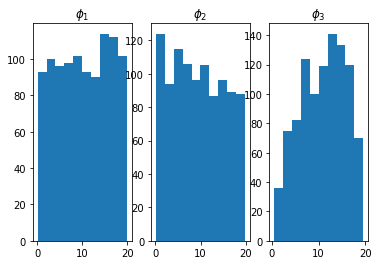

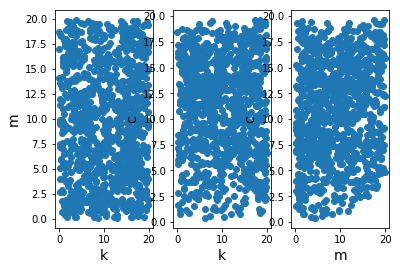

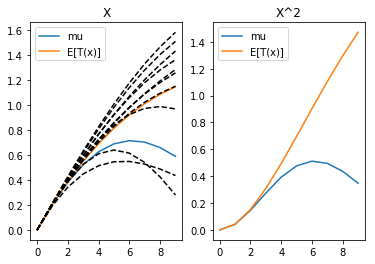

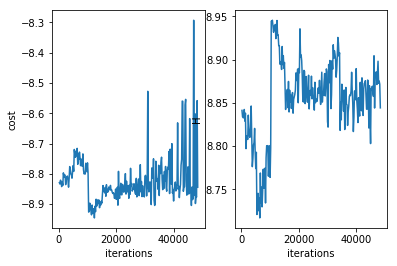

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 48600 
H 8.85612767601025
cost -8.6922286729057
system.D 3


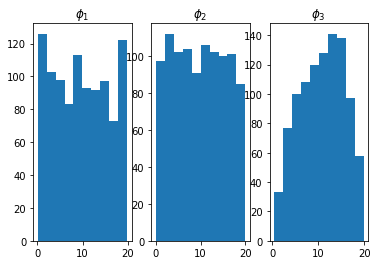

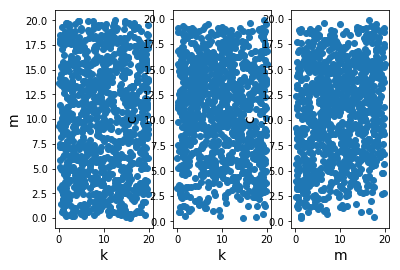

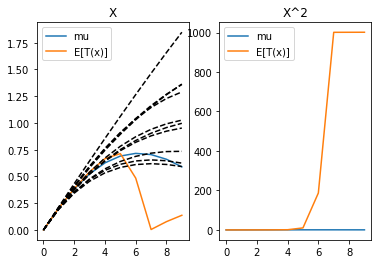

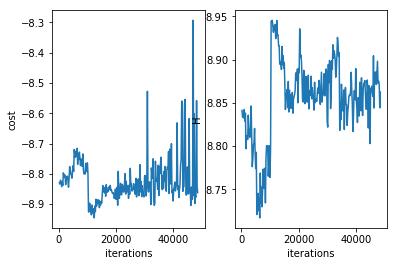

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 48800 
H 8.861403605469782
cost -8.860952788654016
system.D 3


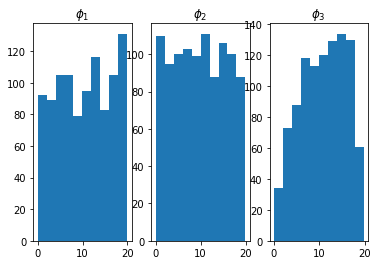

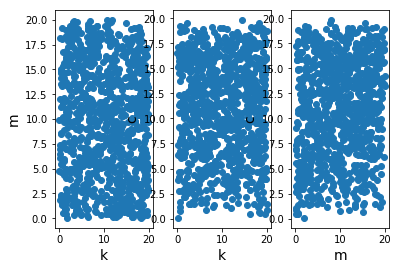

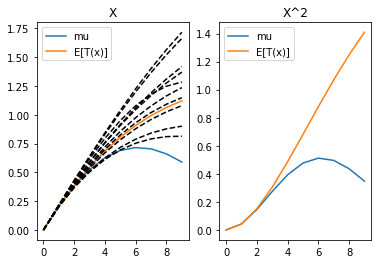

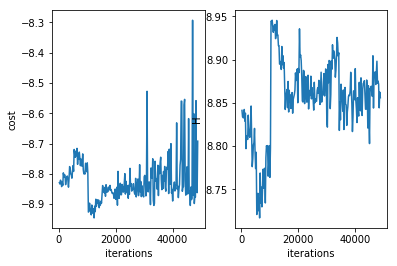

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 49000 
H 8.876894859636167
cost -8.8760222930406
system.D 3


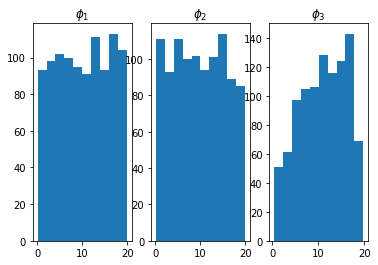

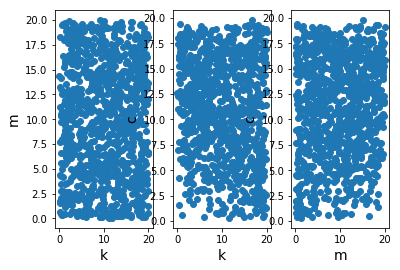

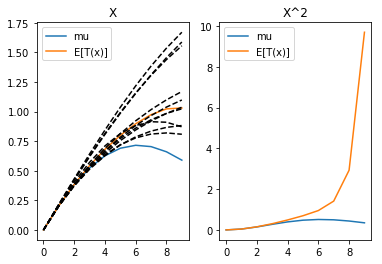

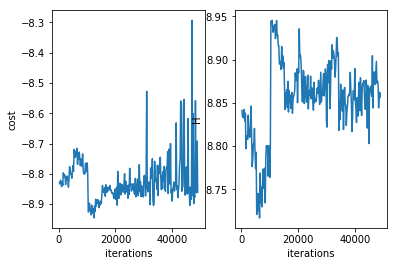

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 49200 
H 8.888121163858141
cost -8.887732626626342
system.D 3


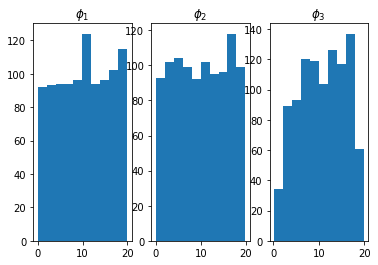

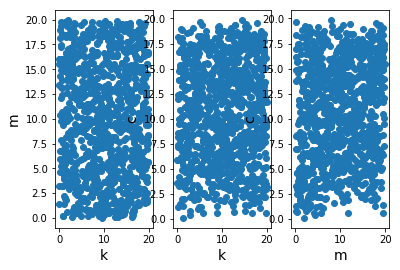

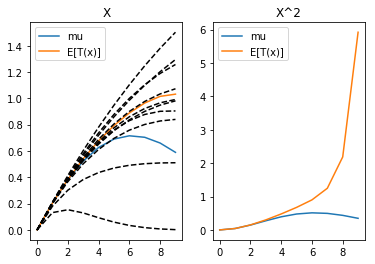

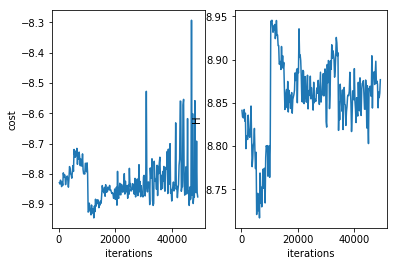

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 49400 
H 8.851744019136133
cost -8.851897748346719
system.D 3


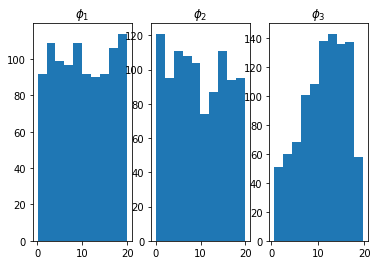

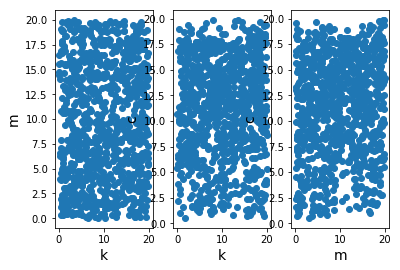

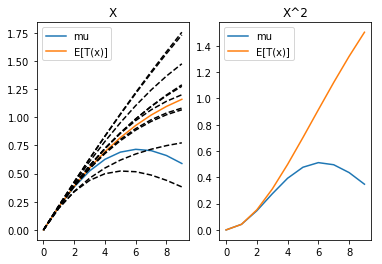

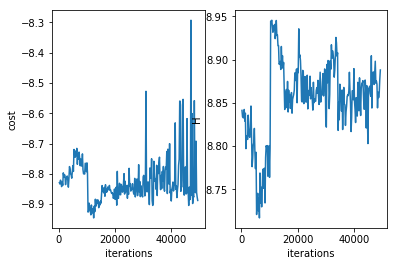

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 49600 
H 8.875023589378873
cost -8.874413109796855
system.D 3


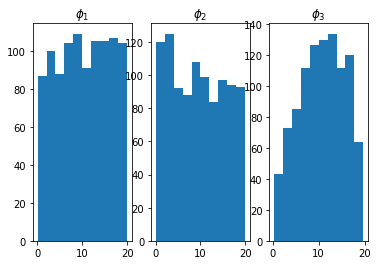

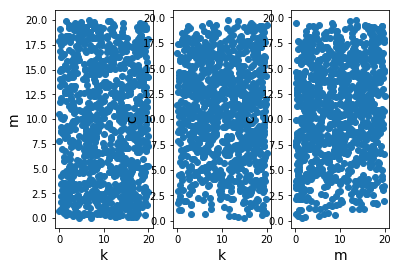

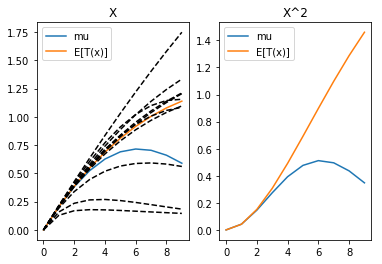

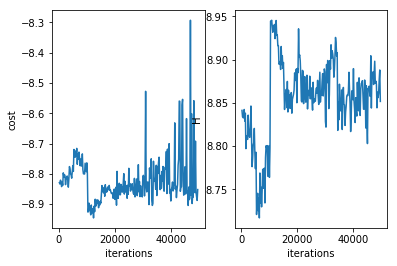

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 49800 
H 8.8712956300152
cost -8.870927869617367
system.D 3


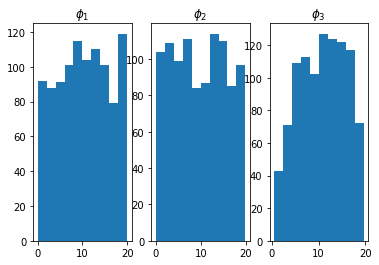

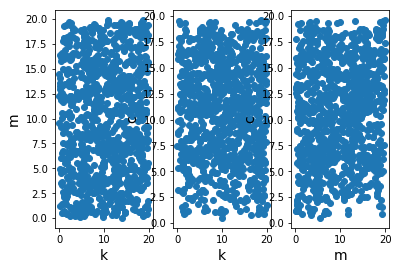

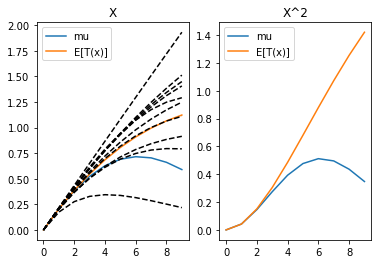

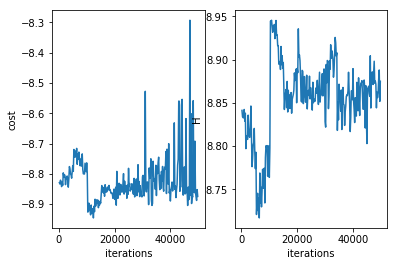

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 50000 
H 8.887804504846823
cost -8.887632570301772
system.D 3


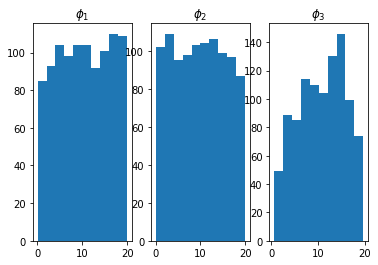

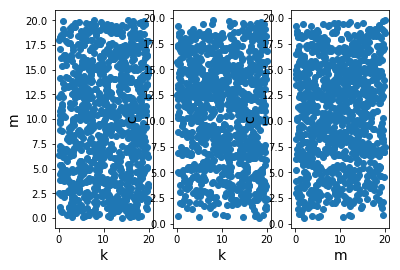

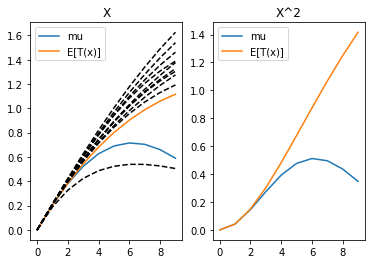

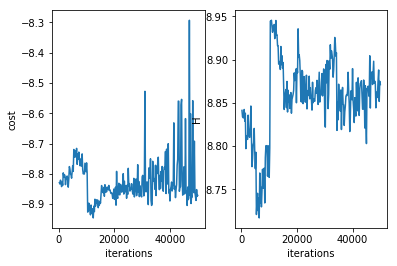

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/
AL iteration 6
resetting optimizer
aug lag it 5
lambda [ 0.00000000e+00 -8.94318841e-10 -3.83619501e-08 -7.13501807e-08
 -9.39035911e-08 -1.35335034e-07 -1.35066402e-07 -1.38738161e-07
 -1.57320420e-07 -1.56014304e-07 -3.41000000e-12  8.54962570e-09
  3.44496068e-05  6.83141016e-05  7.88773686e-05  1.36425773e-04
  1.36643653e-04  1.39027666e-04  1.65570159e-04  1.70541000e-04]
c 1.024e-07
saving model at iter 0
******************************************
it = 50200 
H 8.83083322357112
cost -8.830025149426676
system.D 3


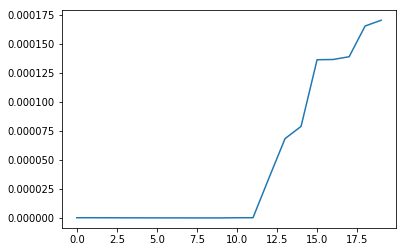

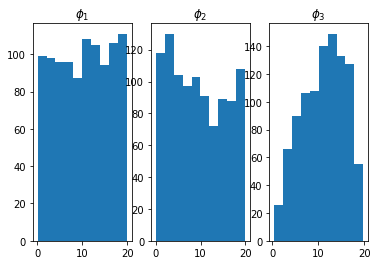

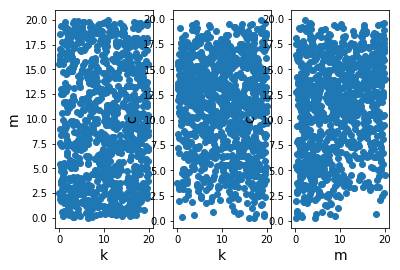

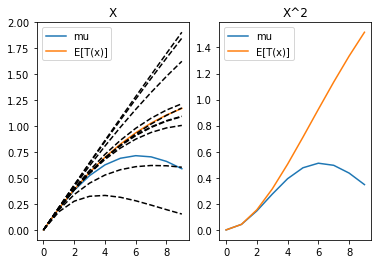

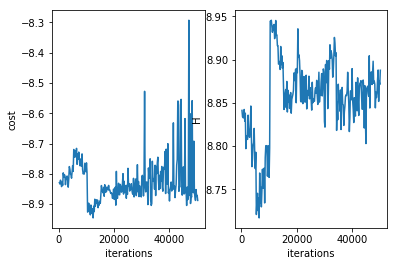

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 50400 
H 8.843594011341489
cost -8.843171699447728
system.D 3


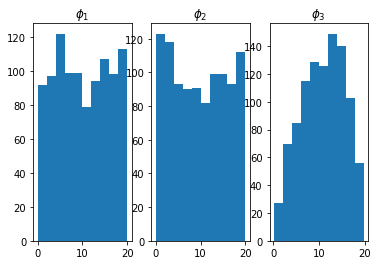

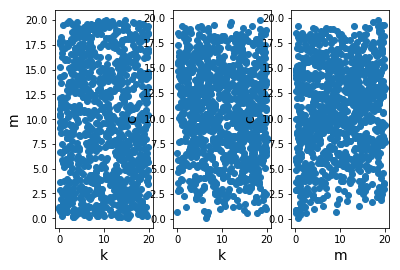

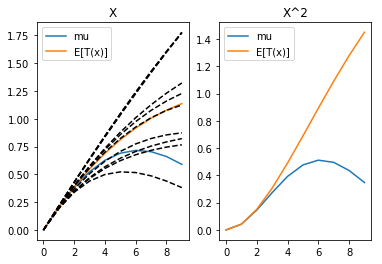

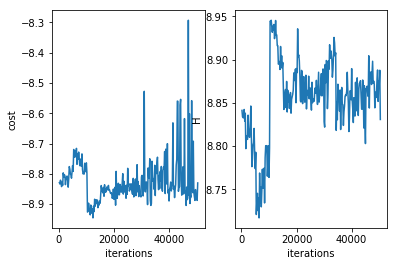

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 50600 
H 8.829086407419883
cost -8.830900108347143
system.D 3


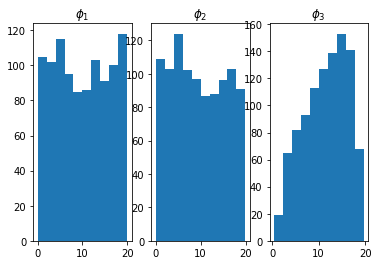

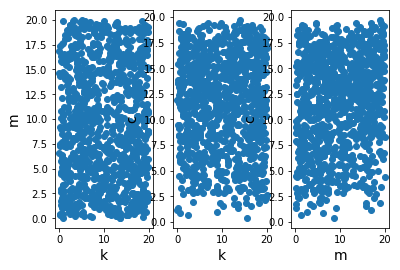

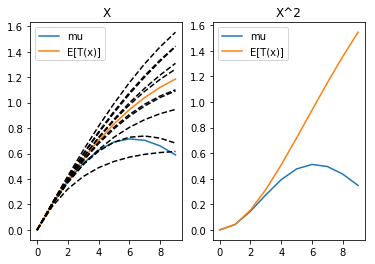

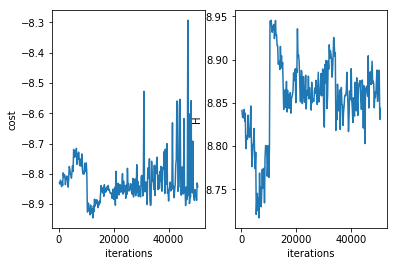

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 50800 
H 8.788703122415145
cost -8.787779152809295
system.D 3


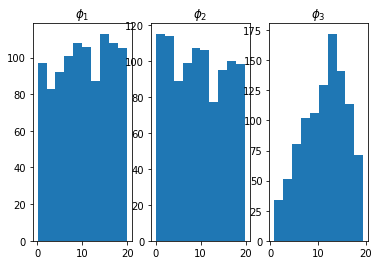

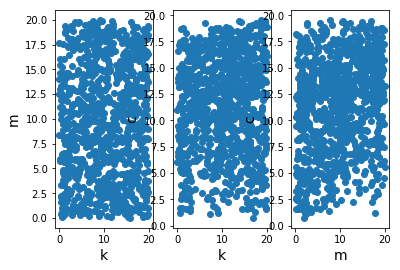

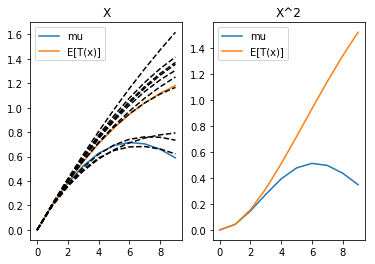

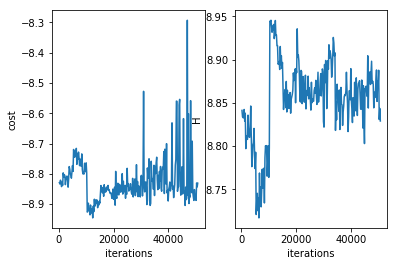

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 51000 
H 8.808476012423087
cost -8.80751638748301
system.D 3


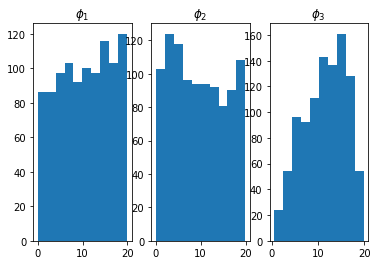

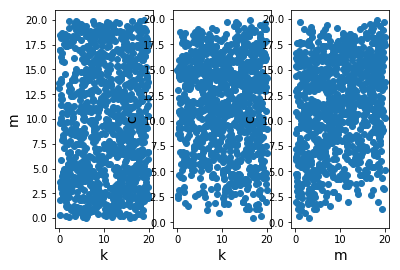

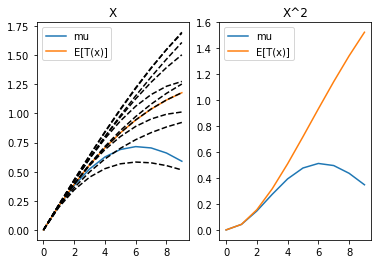

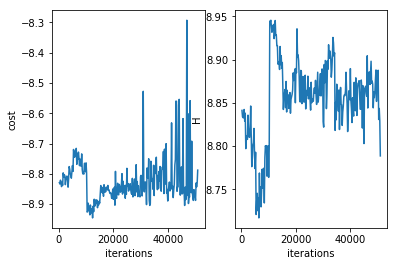

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 51200 
H 8.822543858015298
cost -8.821666228710953
system.D 3


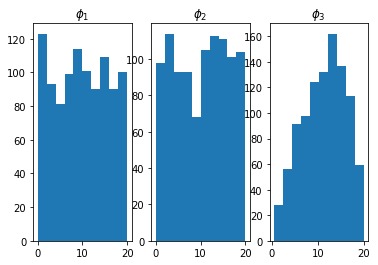

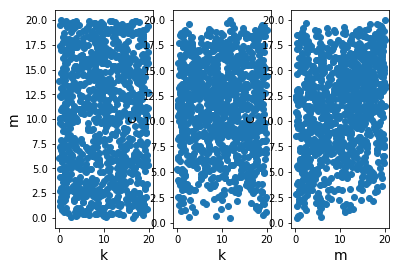

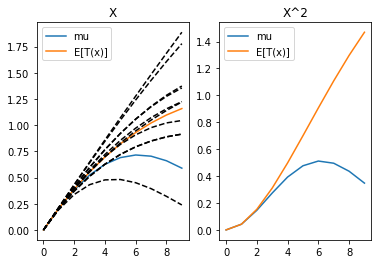

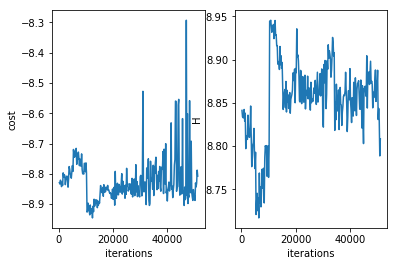

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 51400 
H 8.806958772599929
cost -8.806276723340039
system.D 3


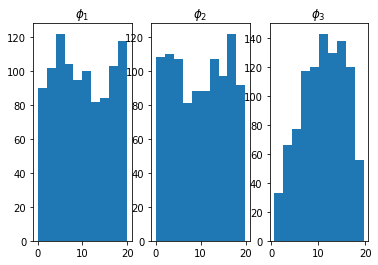

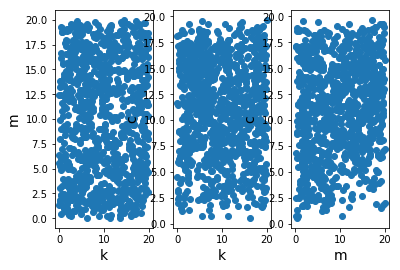

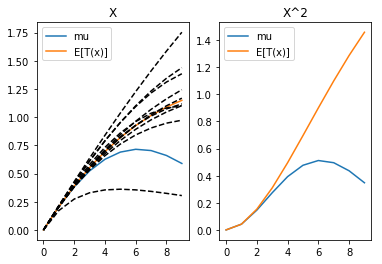

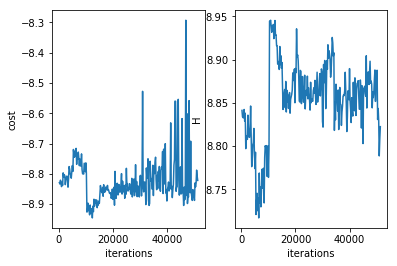

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 51600 
H 8.860969459929203
cost -8.861765642034703
system.D 3


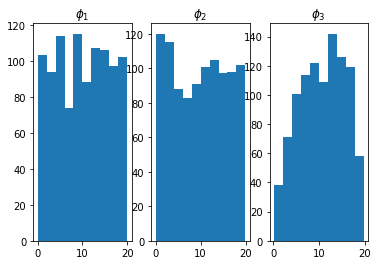

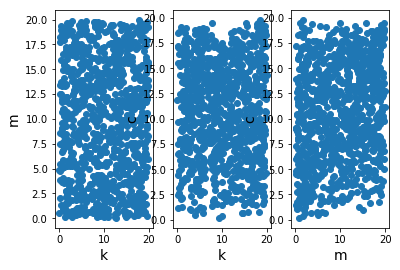

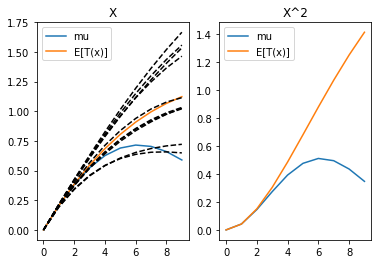

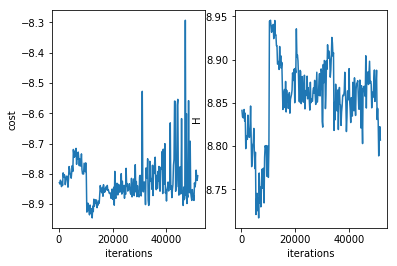

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 51800 
H 8.844977787462236
cost -8.844168634658335
system.D 3


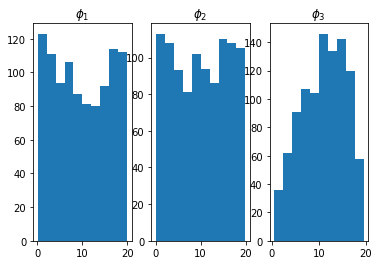

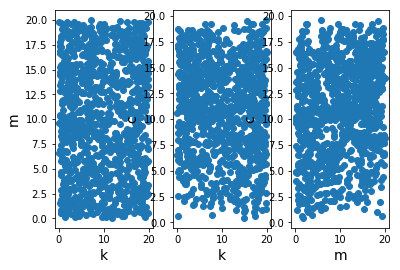

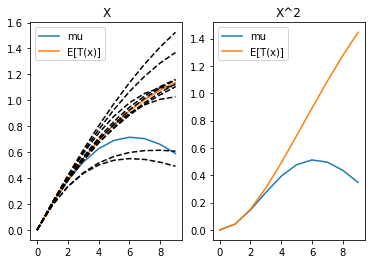

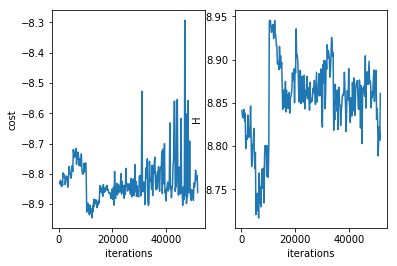

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 52000 
H 8.808232355248753
cost -8.807251201382162
system.D 3


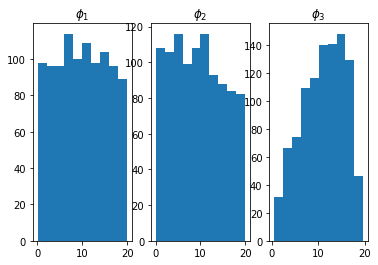

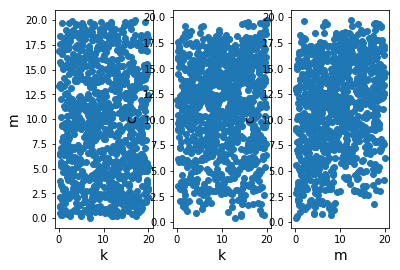

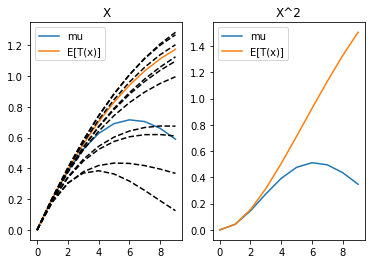

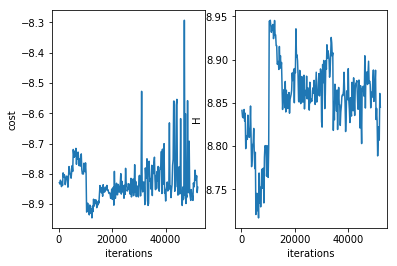

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 52200 
H 8.760727815829458
cost -8.762258596802559
system.D 3


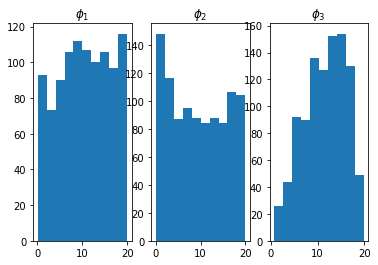

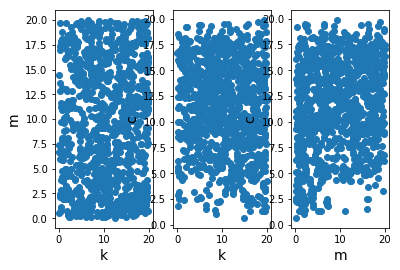

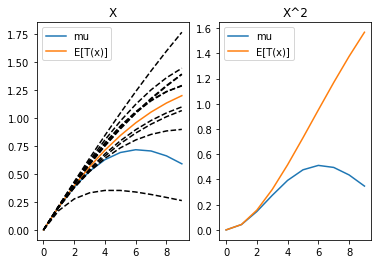

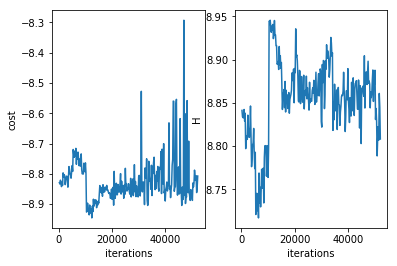

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 52400 
H 8.850632485600135
cost -8.849813040813723
system.D 3


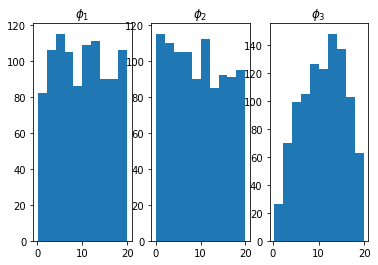

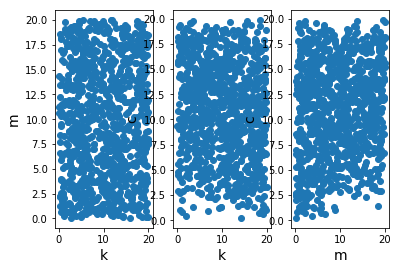

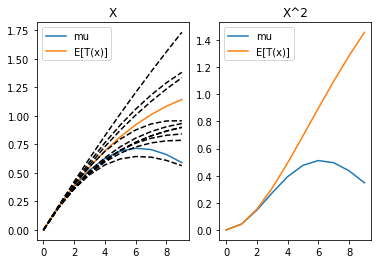

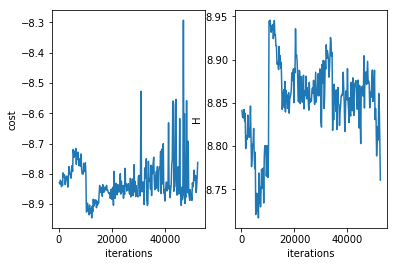

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 52600 
H 8.807829304000279
cost -8.806899723005895
system.D 3


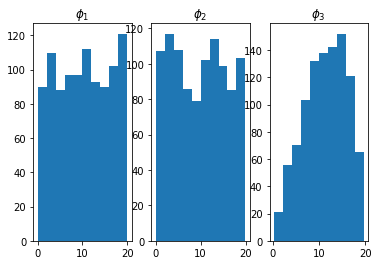

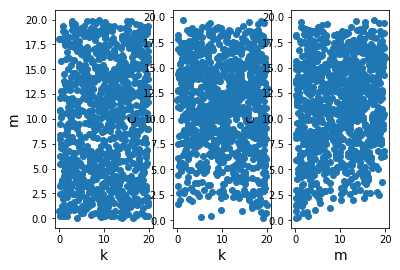

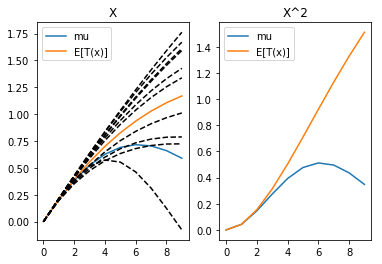

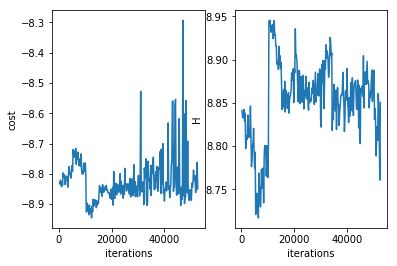

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 52800 
H 8.84139920038514
cost -8.84061581643228
system.D 3


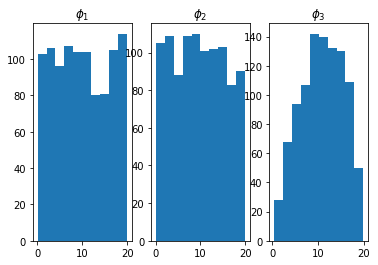

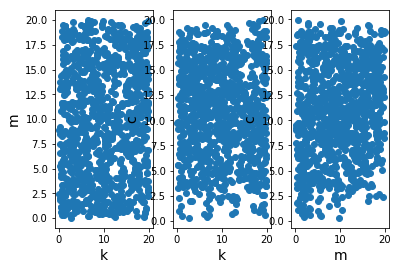

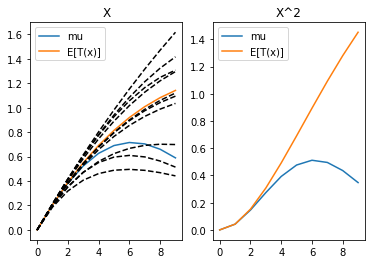

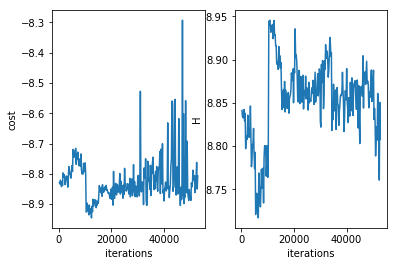

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 53000 
H 8.79876701607923
cost -8.79794167255966
system.D 3


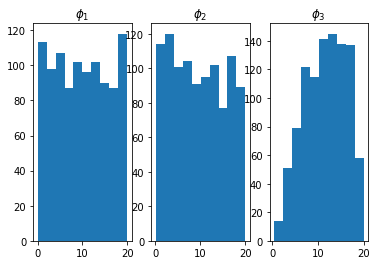

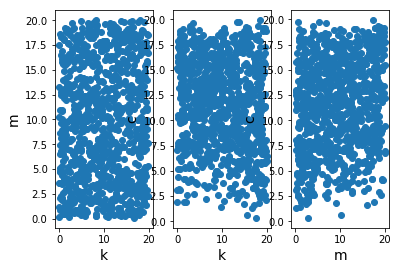

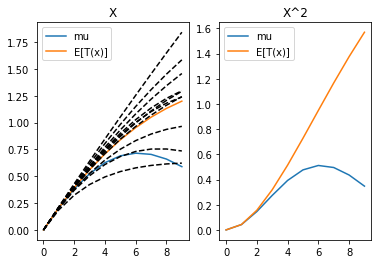

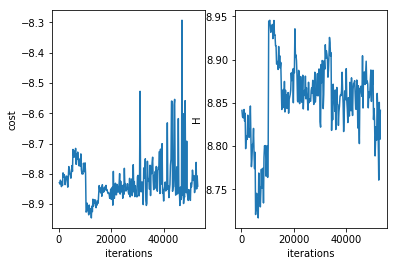

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 53200 
H 8.789564826491922
cost -8.7891521620421
system.D 3


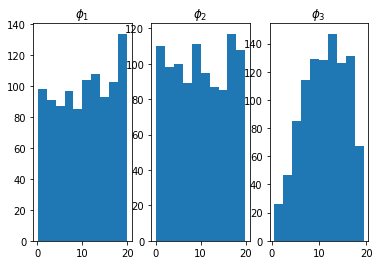

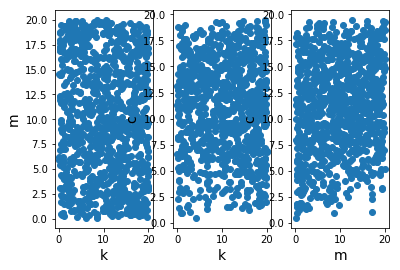

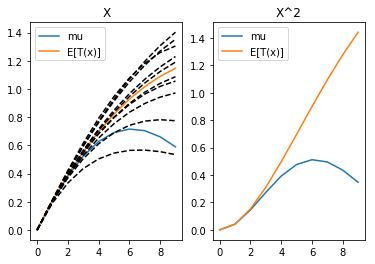

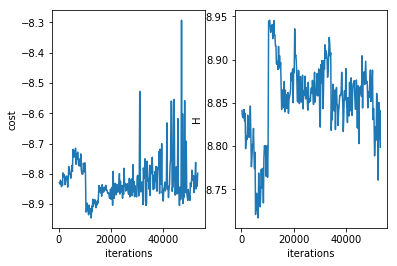

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 53400 
H 8.837761329279086
cost -8.836902037867896
system.D 3


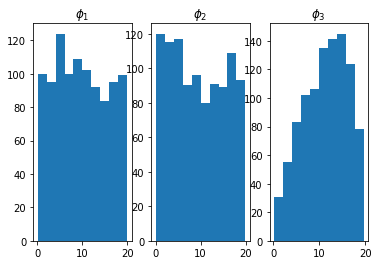

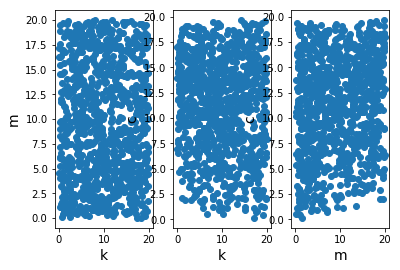

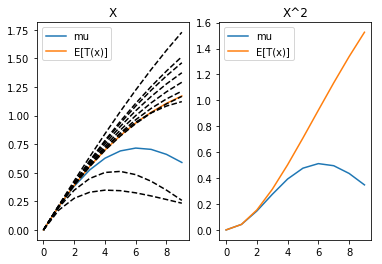

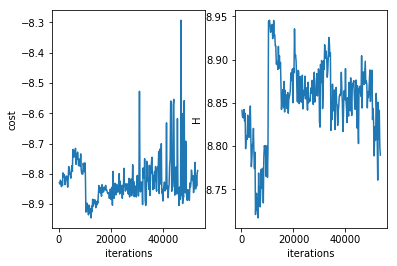

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 53600 
H 8.78429956597646
cost -8.784993554088686
system.D 3


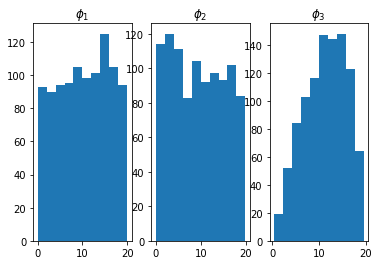

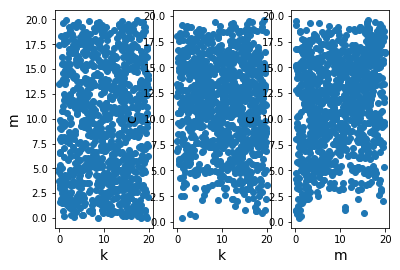

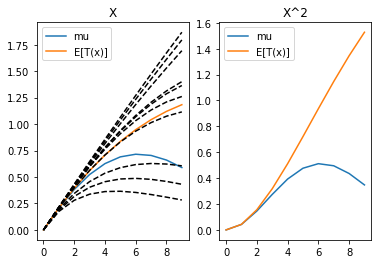

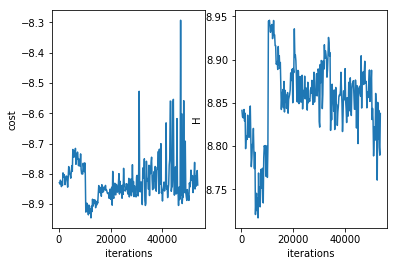

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 53800 
H 8.780256793857024
cost -8.779240162899155
system.D 3


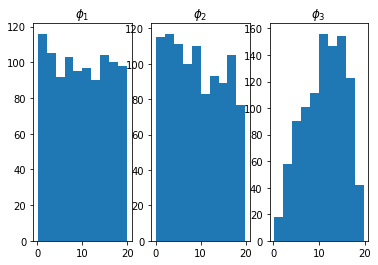

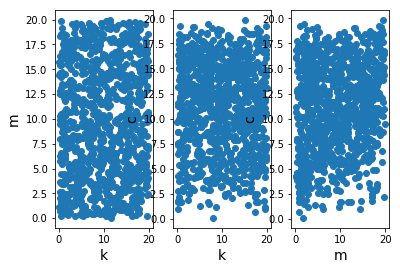

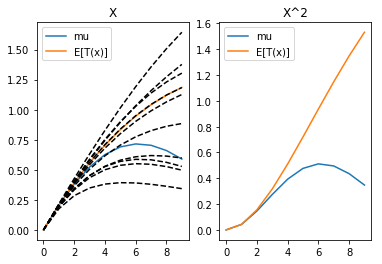

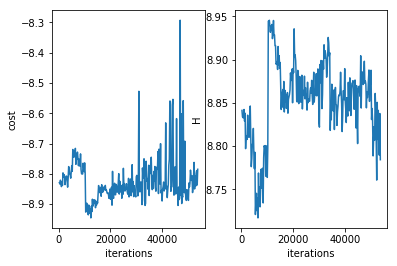

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 54000 
H 8.821652267604314
cost -8.820971644527413
system.D 3


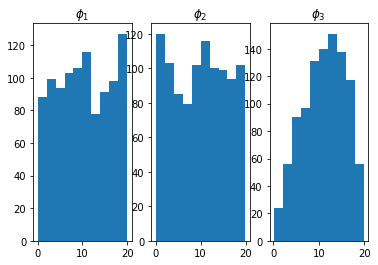

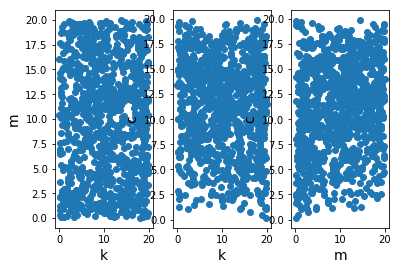

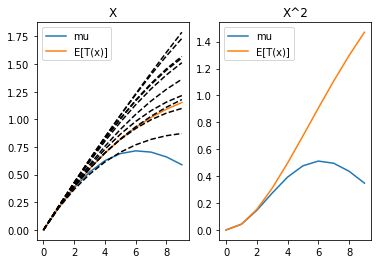

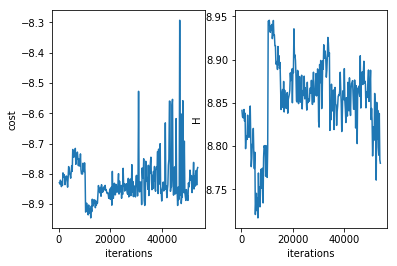

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 54200 
H 8.805859866063773
cost -8.805184209983311
system.D 3


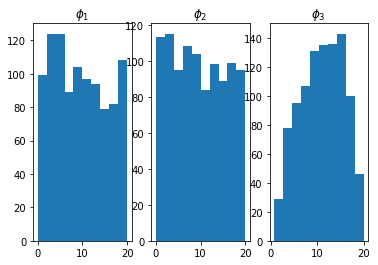

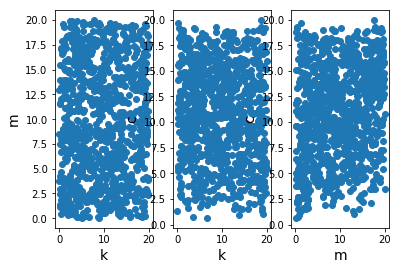

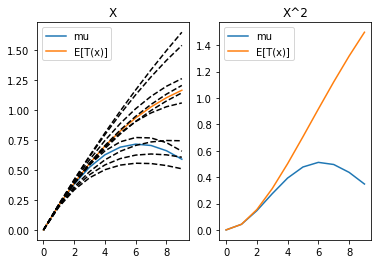

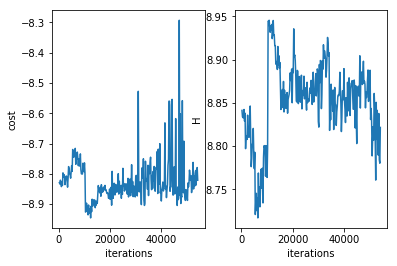

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 54400 
H 8.836647392894855
cost -8.8358132794326
system.D 3


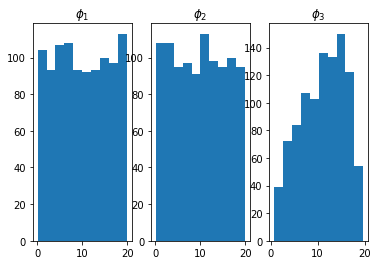

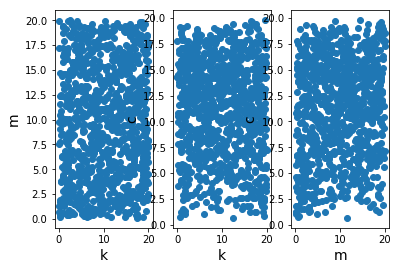

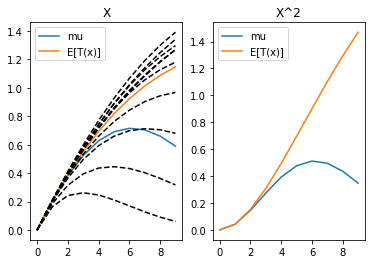

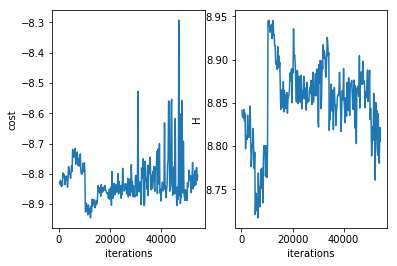

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 54600 
H 8.847046260538399
cost -8.846245280450324
system.D 3


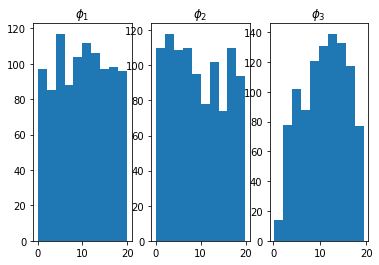

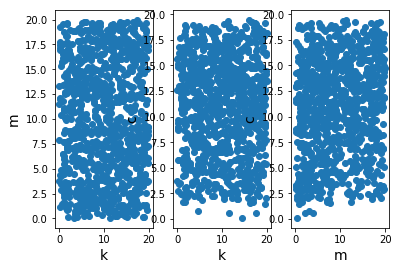

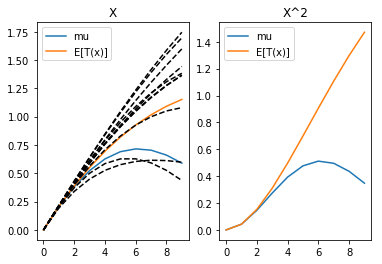

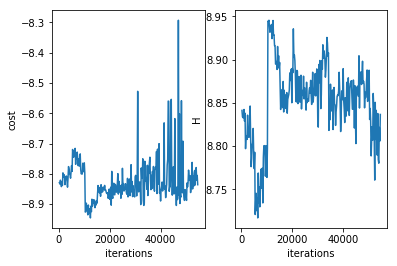

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 54800 
H 8.843180151991902
cost -8.842454668238371
system.D 3


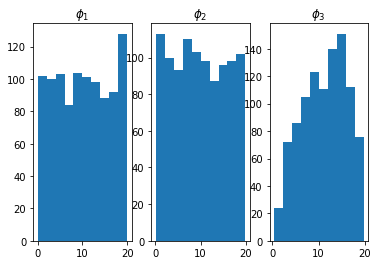

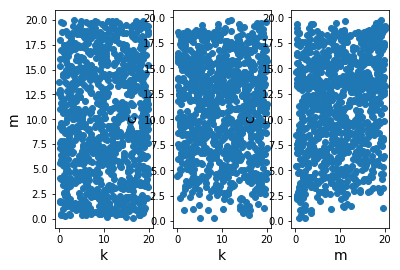

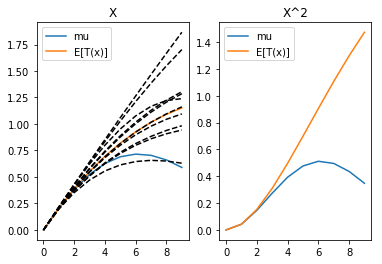

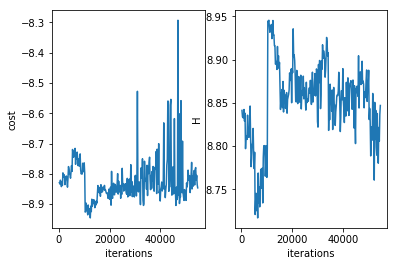

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 55000 
H 8.838540465551596
cost -8.838429445017336
system.D 3


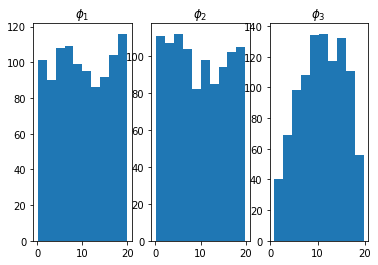

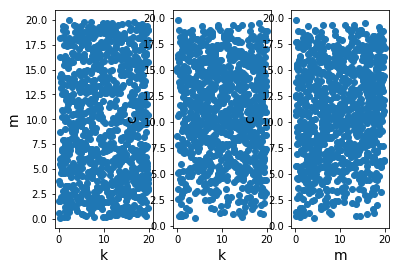

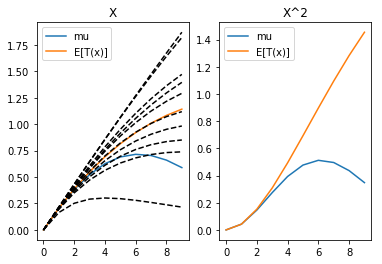

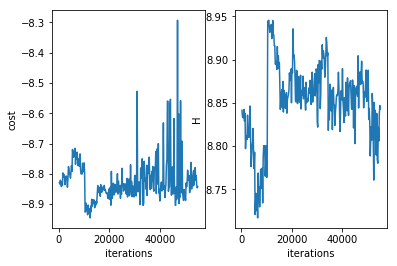

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 55200 
H 8.853735497468199
cost -8.853002056412317
system.D 3


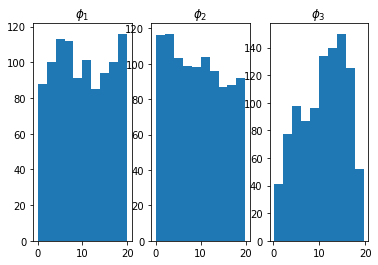

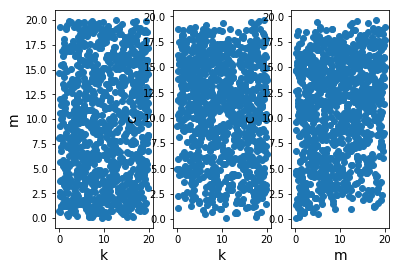

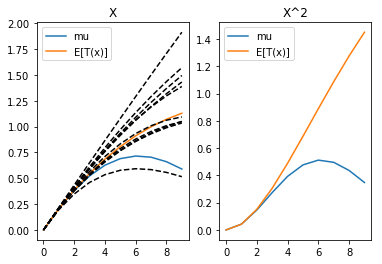

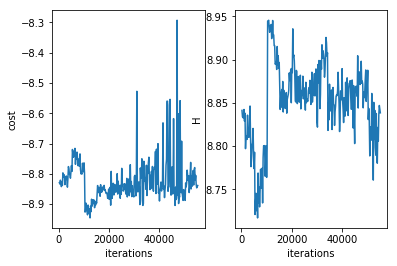

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 55400 
H 8.838231383115327
cost -8.838031697809733
system.D 3


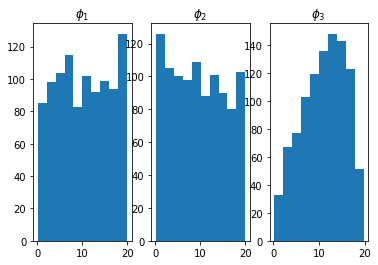

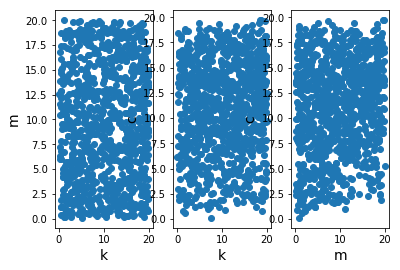

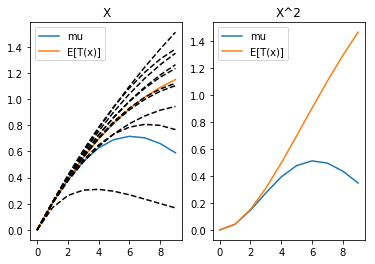

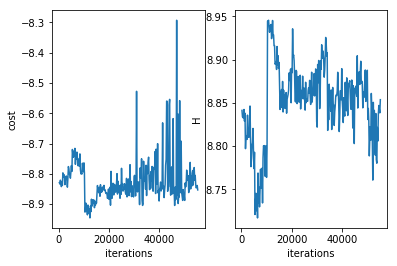

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 55600 
H 8.784013428133864
cost -8.78275157136982
system.D 3


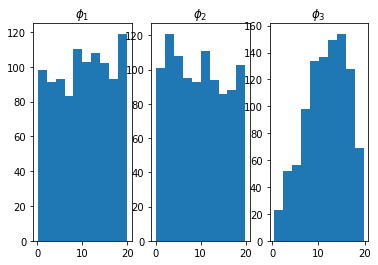

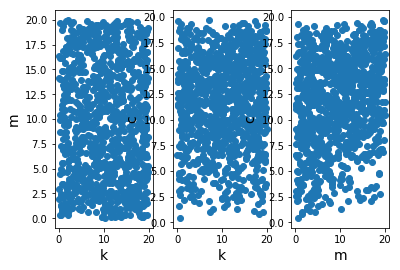

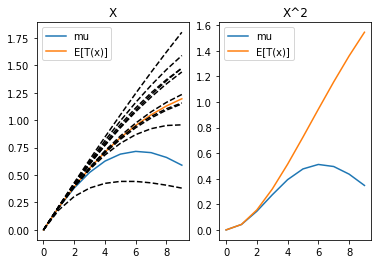

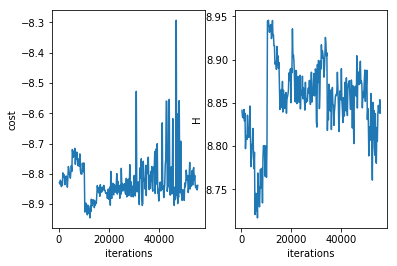

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 55800 
H 8.84299850141063
cost -8.842527957434212
system.D 3


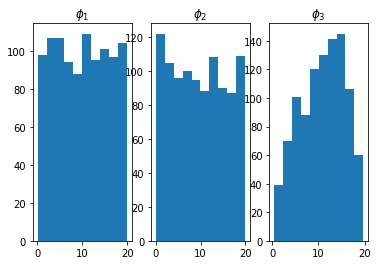

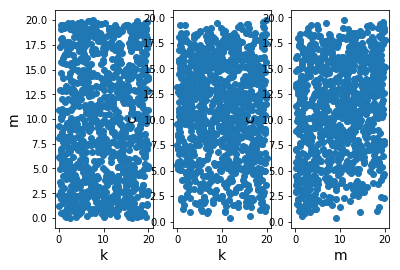

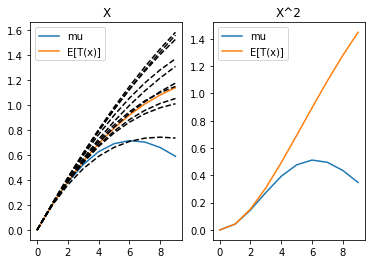

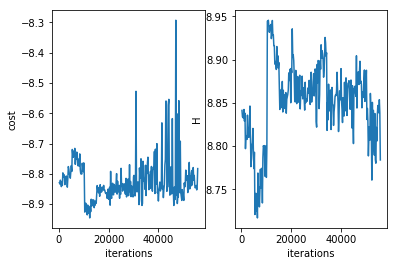

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 56000 
H 8.83962288623932
cost -8.841689548995857
system.D 3


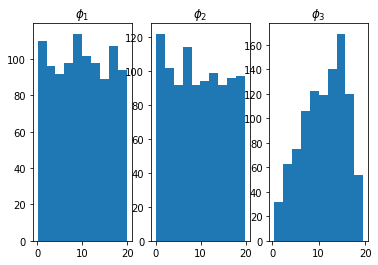

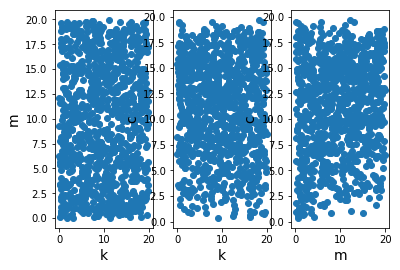

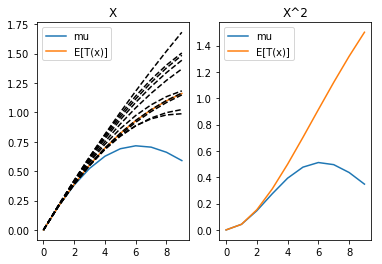

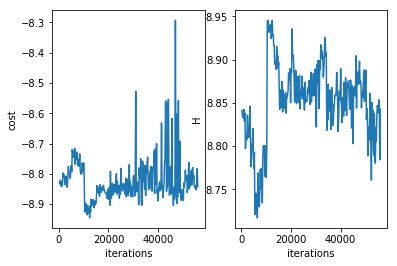

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 56200 
H 8.825733342586839
cost -8.82622051778177
system.D 3


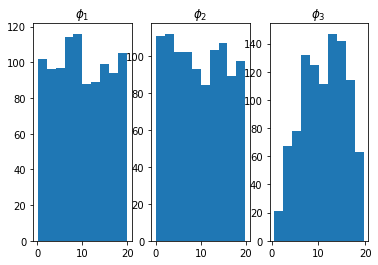

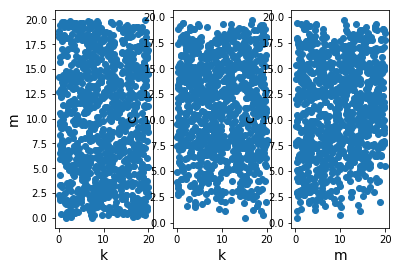

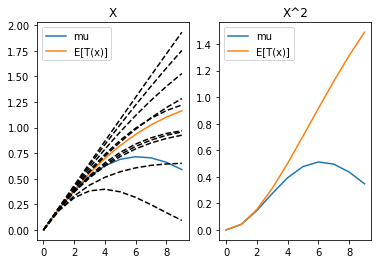

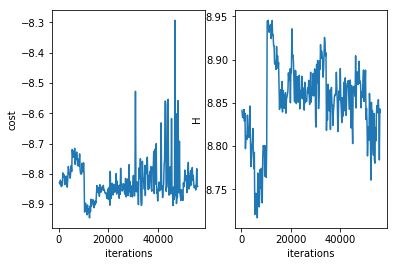

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 56400 
H 8.822927817572877
cost -8.822216114514998
system.D 3


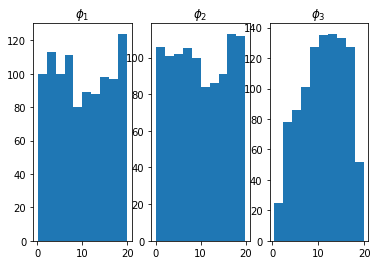

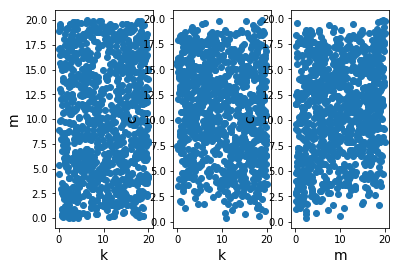

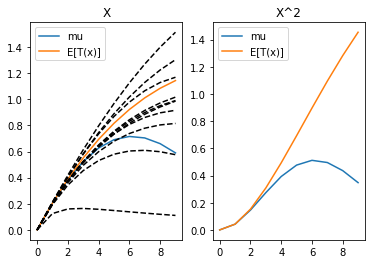

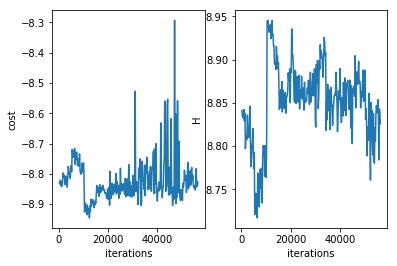

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 56600 
H 8.840070934127173
cost -8.84051600400716
system.D 3


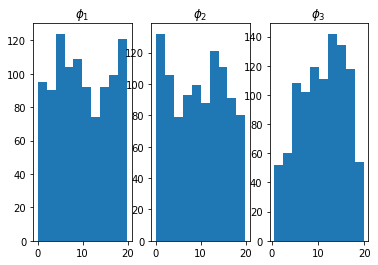

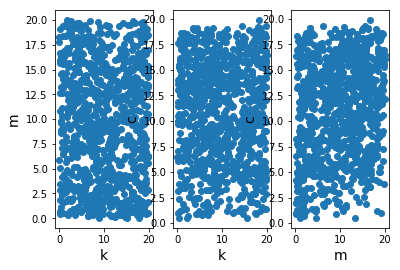

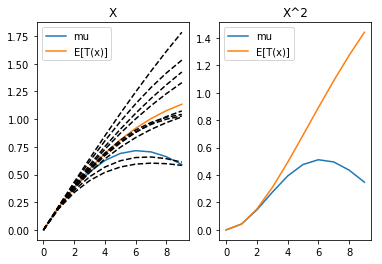

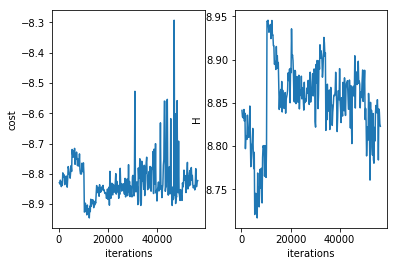

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 56800 
H 8.843293601750426
cost -7.706562967457256
system.D 3


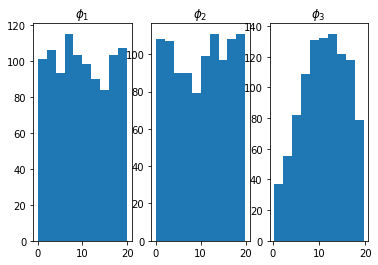

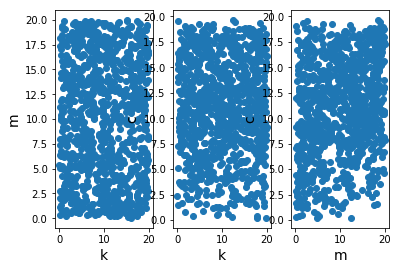

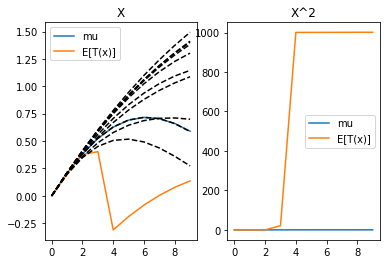

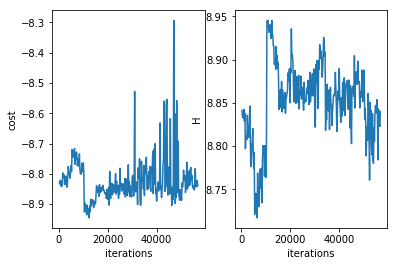

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 57000 
H 8.840423974749234
cost -8.84027450243599
system.D 3


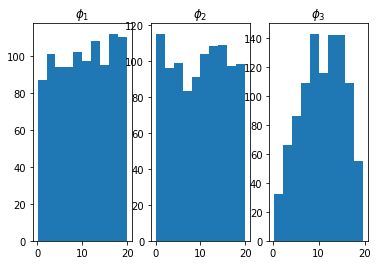

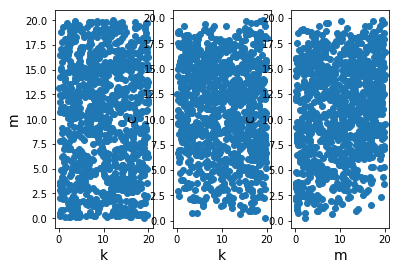

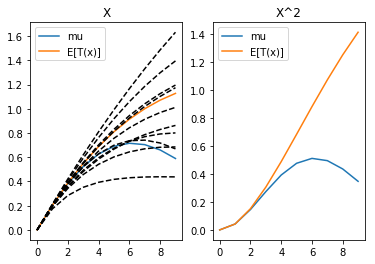

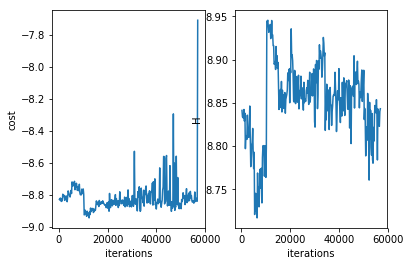

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 57200 
H 8.843828538936217
cost -8.843067786476588
system.D 3


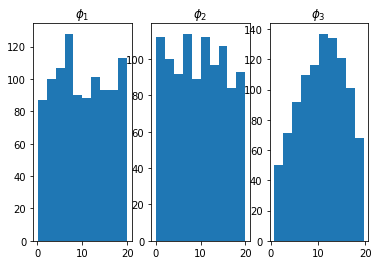

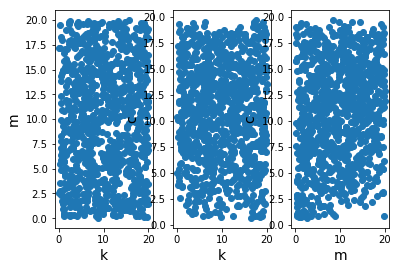

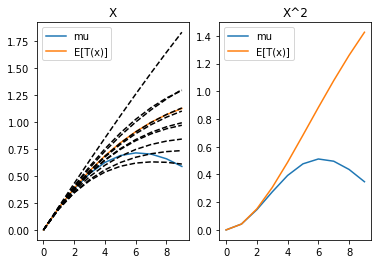

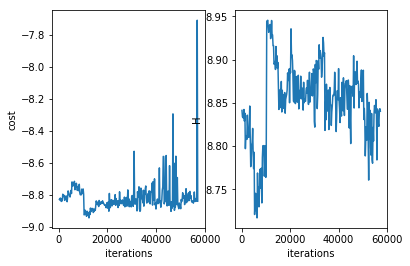

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 57400 
H 8.838953311216034
cost -8.83863453919276
system.D 3


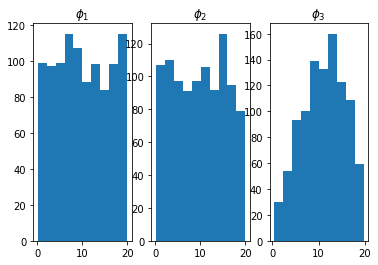

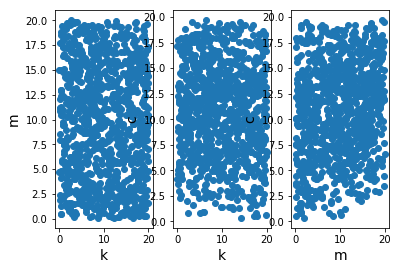

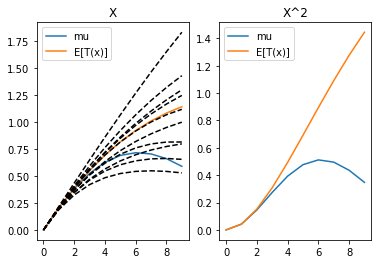

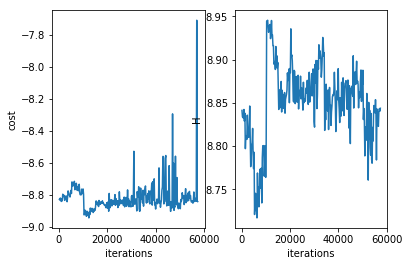

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 57600 
H 8.824400025634151
cost -8.823365895374094
system.D 3


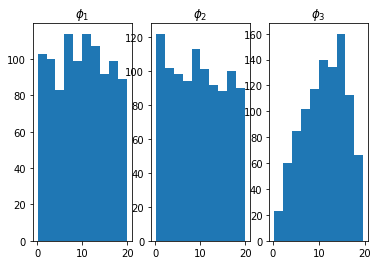

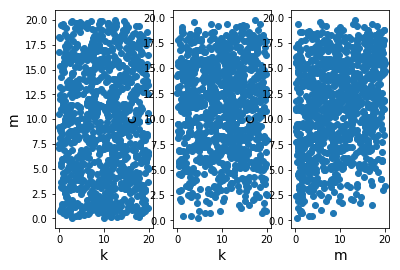

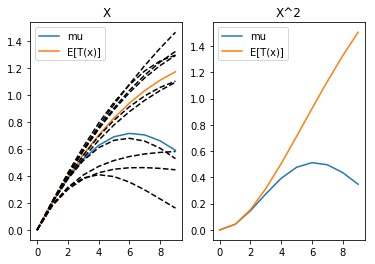

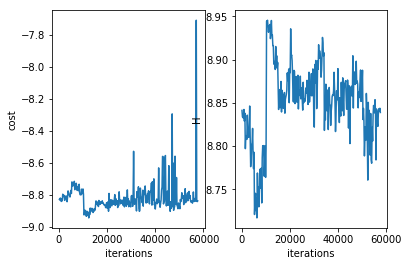

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 57800 
H 8.857556895991227
cost -8.856834302704856
system.D 3


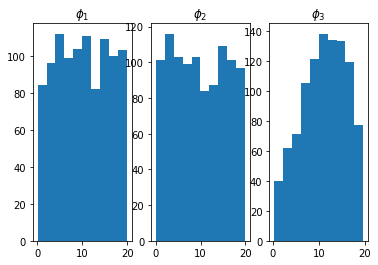

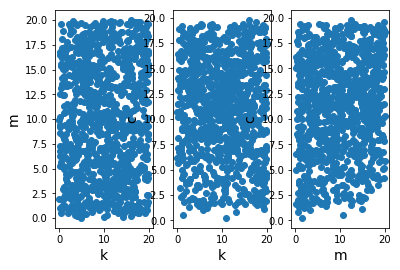

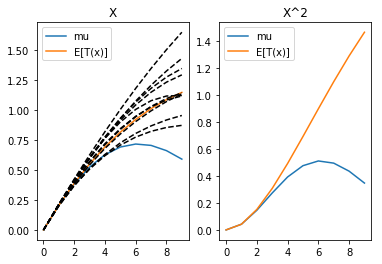

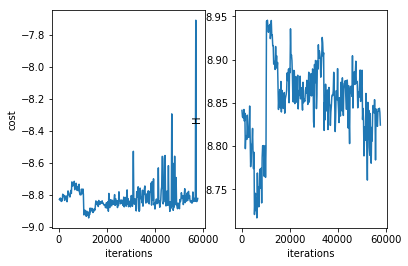

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 58000 
H 8.863531673085006
cost -8.86292159664214
system.D 3


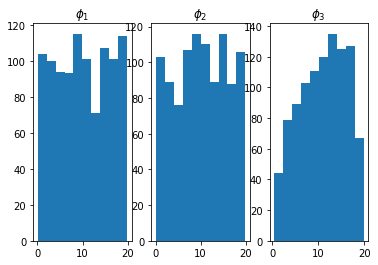

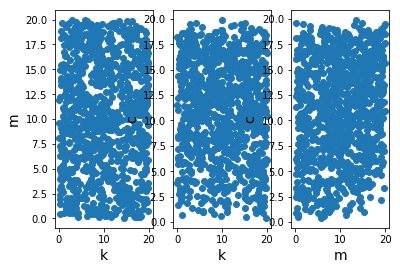

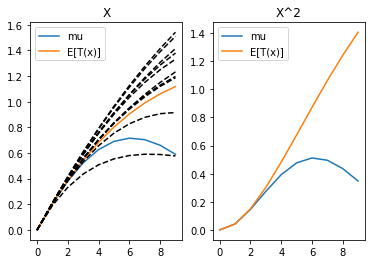

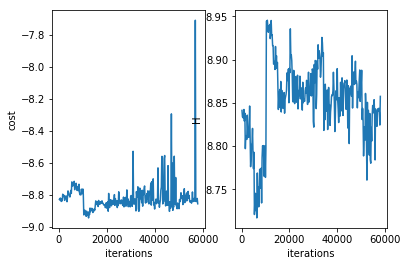

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 58200 
H 8.852808993742208
cost -8.85222407854865
system.D 3


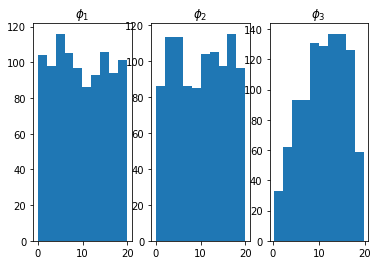

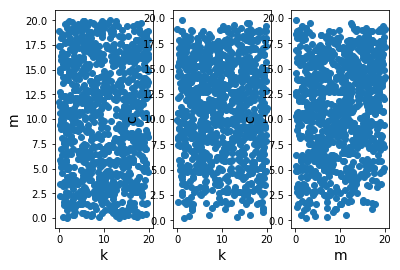

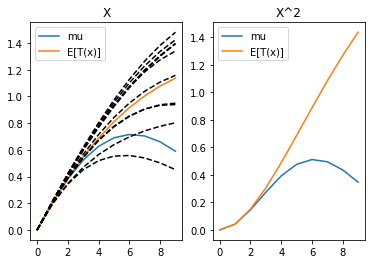

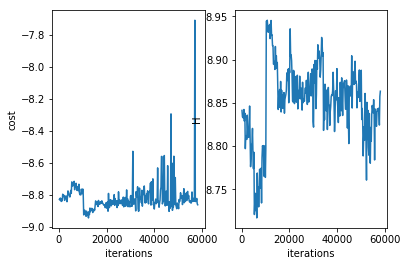

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 58400 
H 8.8469709702264
cost -8.846197884900205
system.D 3


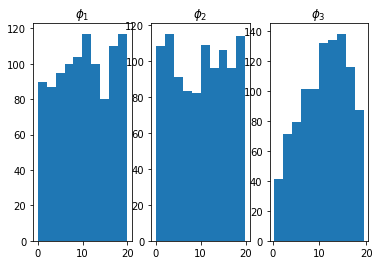

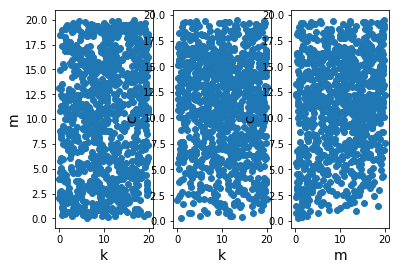

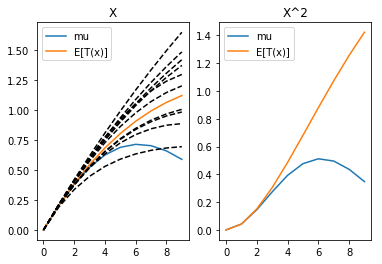

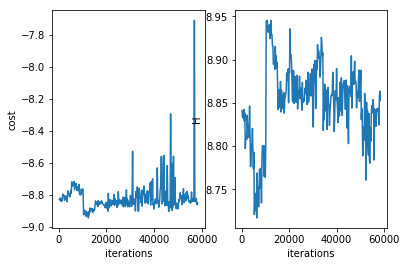

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 58600 
H 8.865317324237148
cost -8.864702514968311
system.D 3


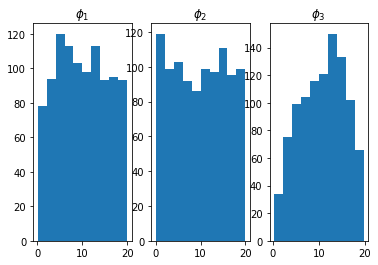

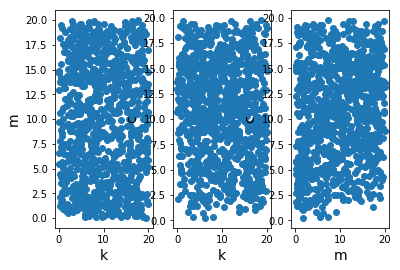

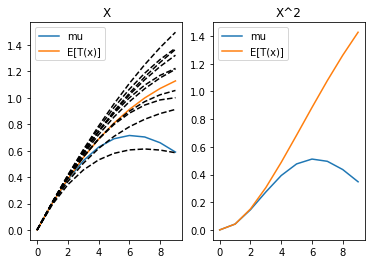

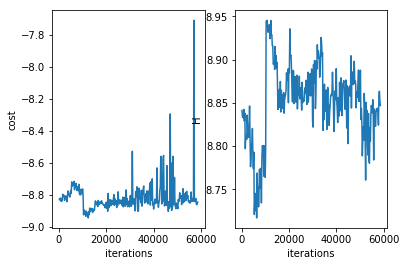

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 58800 
H 8.829739241911973
cost -8.828631159885697
system.D 3


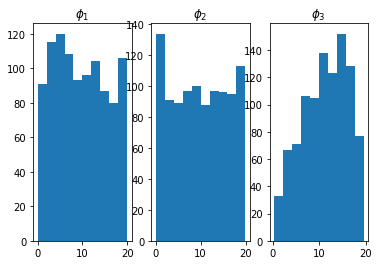

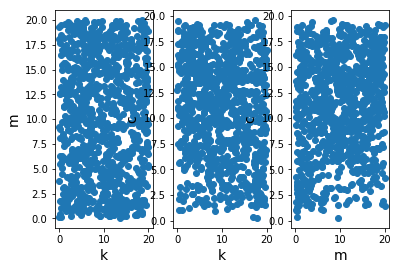

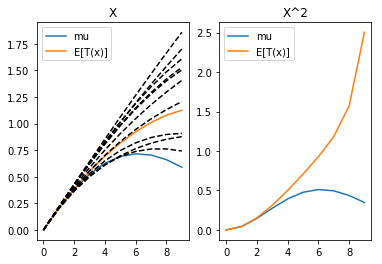

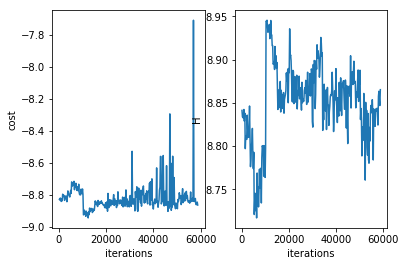

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 59000 
H 8.842144084892055
cost -8.841136025376889
system.D 3


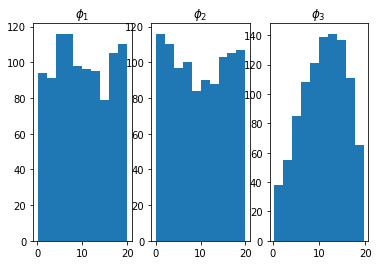

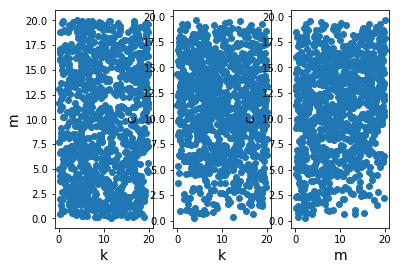

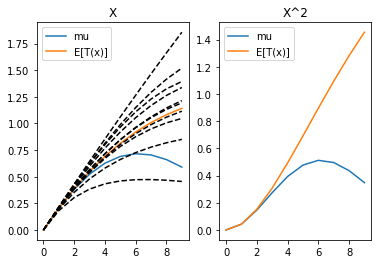

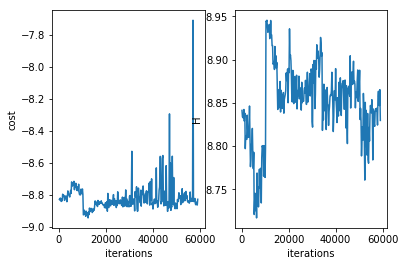

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 59200 
H 8.790979076796008
cost -8.790620352049844
system.D 3


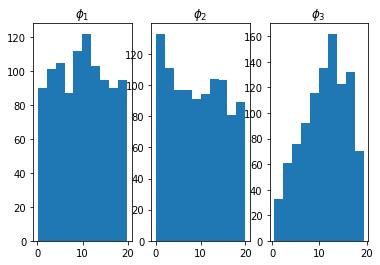

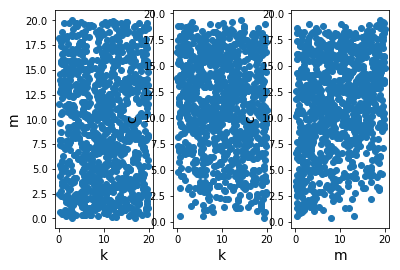

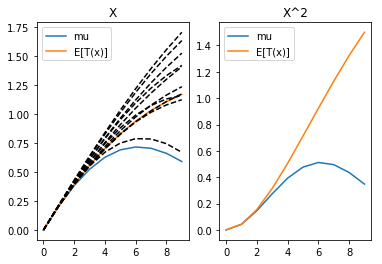

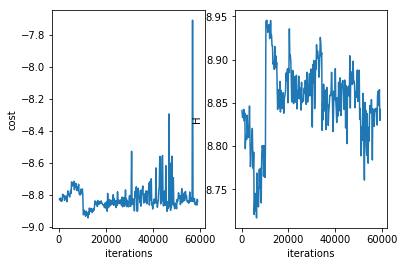

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 59400 
H 8.848617698729617
cost -8.847739305192711
system.D 3


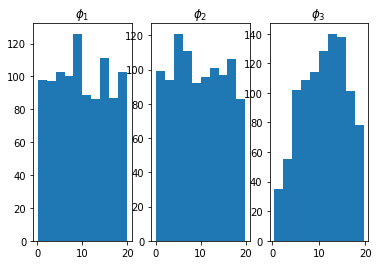

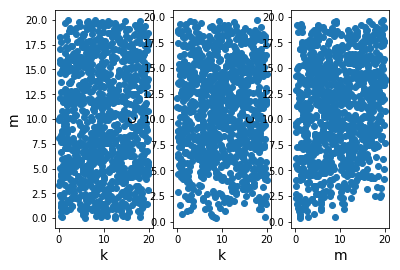

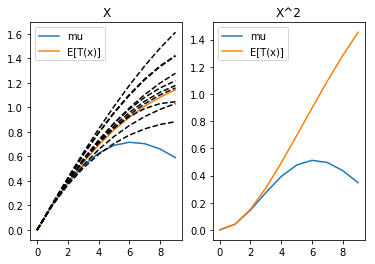

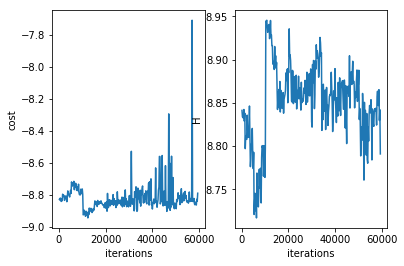

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 59600 
H 8.85643638453685
cost -8.855681776337496
system.D 3


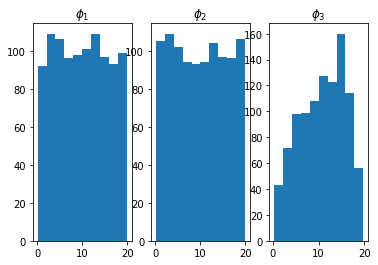

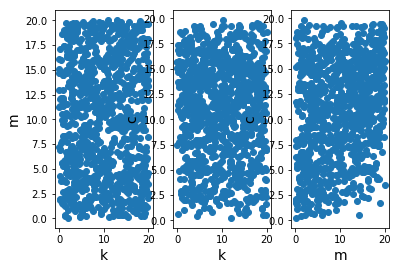

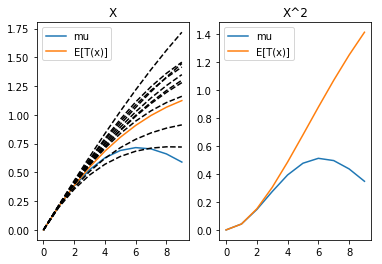

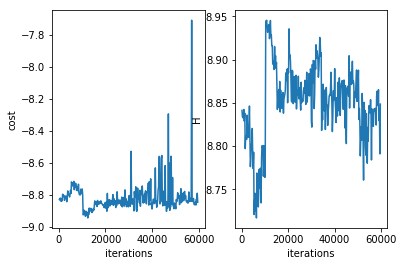

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 59800 
H 8.858934702628874
cost -8.858029459566797
system.D 3


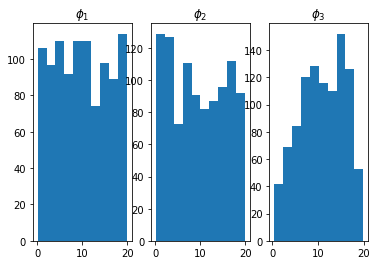

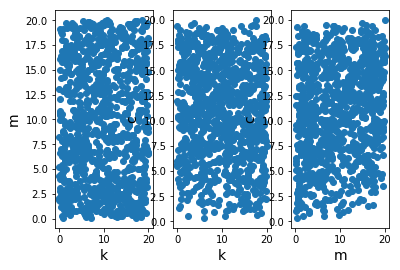

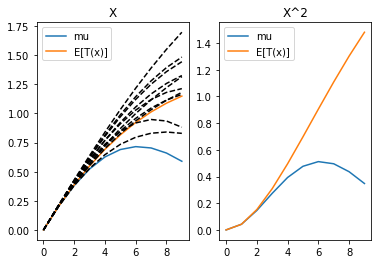

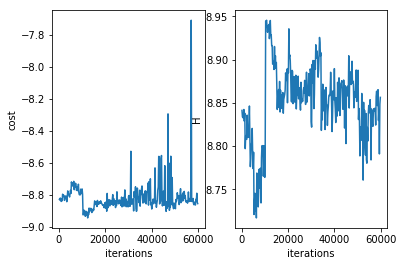

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 60000 
H 8.852373461130494
cost -8.851626591448358
system.D 3


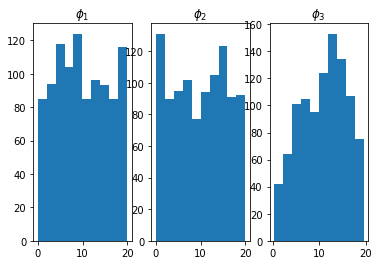

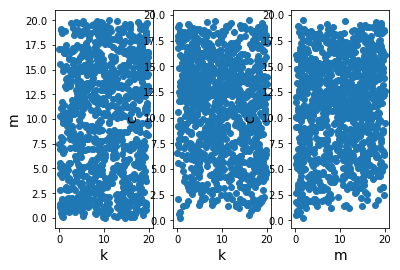

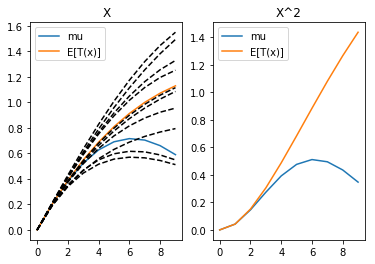

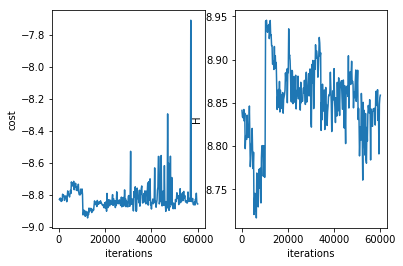

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/
AL iteration 7
resetting optimizer
aug lag it 6
lambda [ 0.00000000e+00 -3.57989800e-09 -1.53560299e-07 -2.85609961e-07
 -3.75889742e-07 -5.41737014e-07 -5.40661696e-07 -5.55359499e-07
 -6.29743031e-07 -6.24514738e-07 -1.36500000e-11  3.42235750e-08
  1.37899452e-04  2.73456741e-04  3.15740786e-04  5.46103167e-04
  5.46975327e-04  5.56518369e-04  6.62766180e-04  6.82664120e-04]
c 4.096e-07
saving model at iter 0
******************************************
it = 60200 
H 8.82485534193562
cost -6.4716228237960935
system.D 3


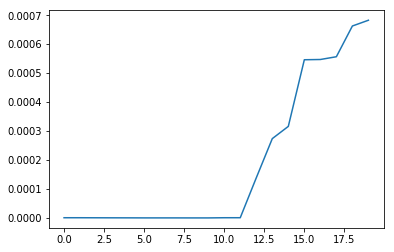

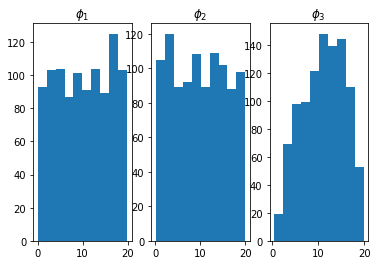

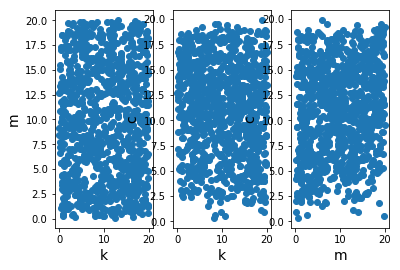

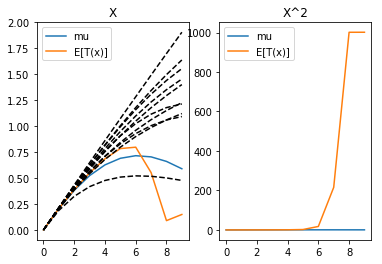

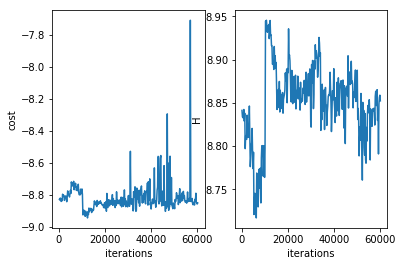

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 60400 
H 8.822766636330396
cost -8.820433771687307
system.D 3


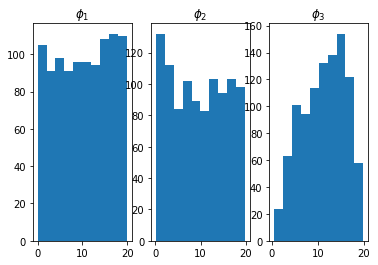

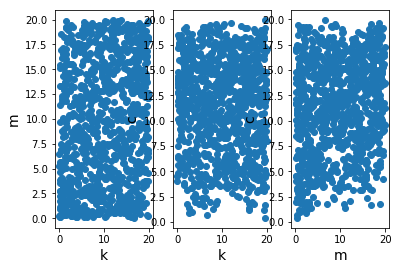

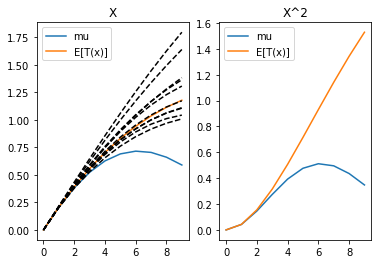

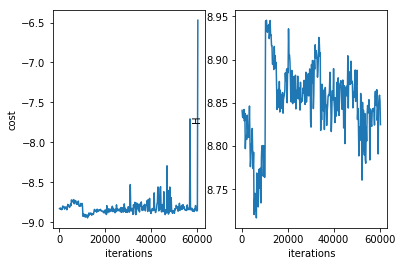

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 60600 
H 8.802398837977492
cost -8.800181579033866
system.D 3


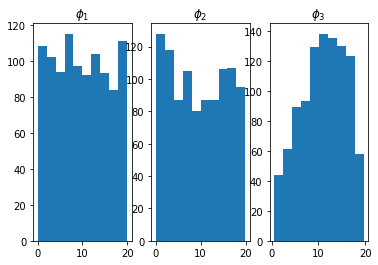

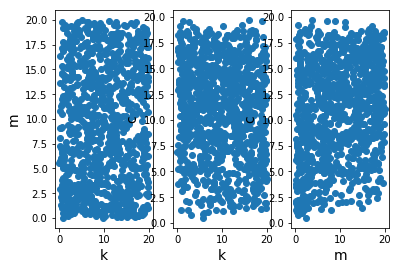

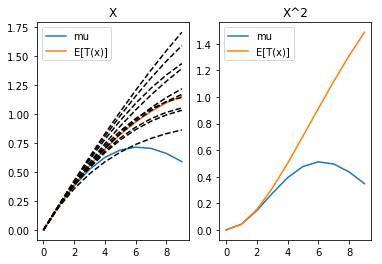

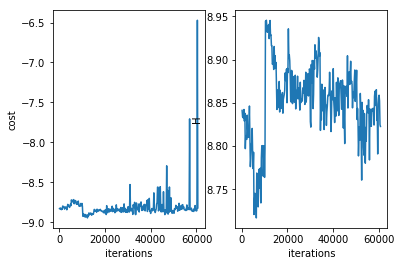

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 60800 
H 8.81771732546993
cost -8.81536728655939
system.D 3


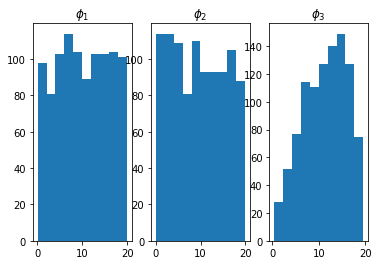

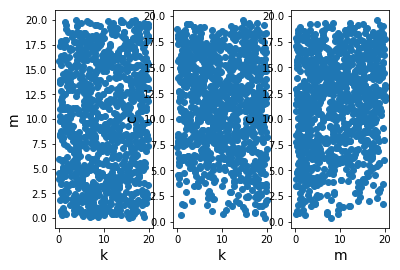

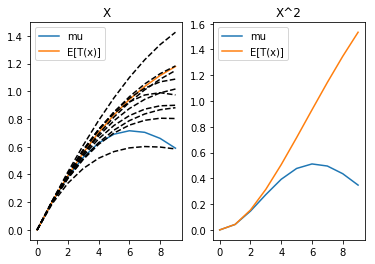

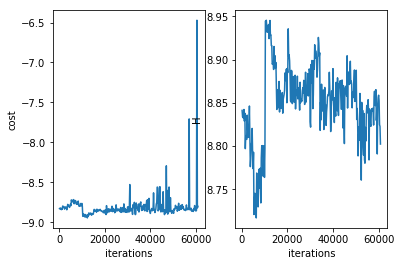

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 61000 
H 8.786959753299131
cost -8.78497765079547
system.D 3


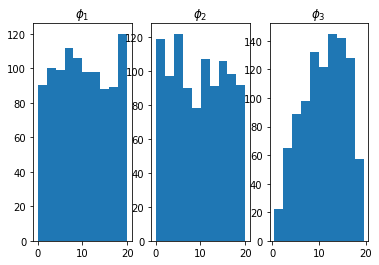

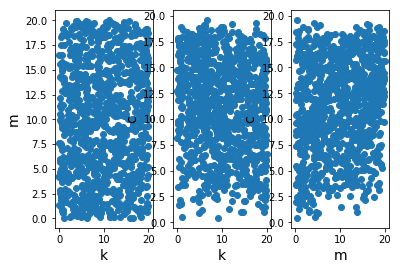

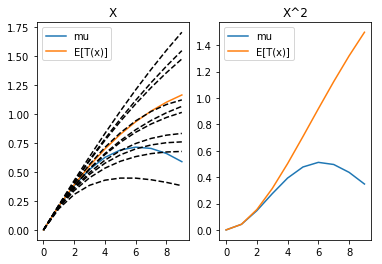

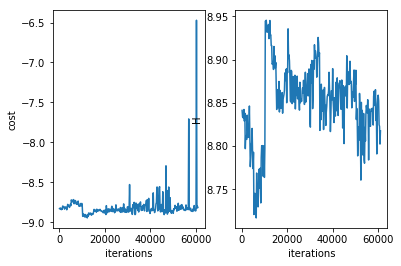

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 61200 
H 8.761628893873992
cost -8.75898047331553
system.D 3


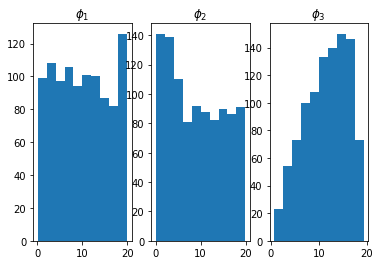

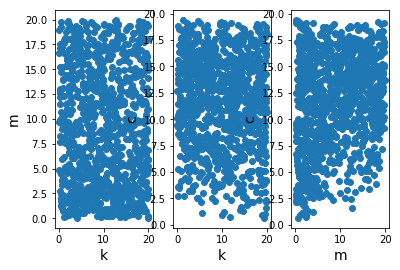

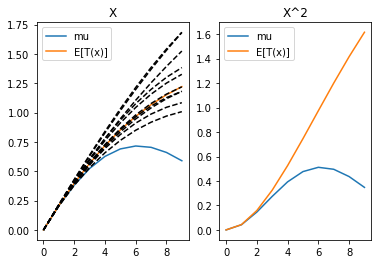

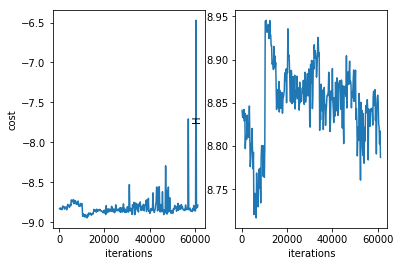

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 61400 
H 8.793335755305062
cost -8.79106719929222
system.D 3


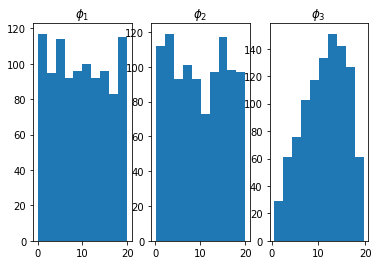

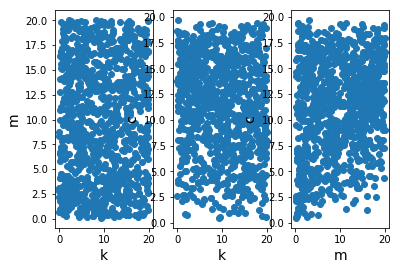

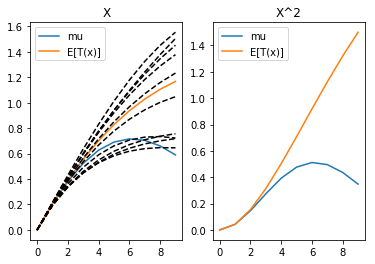

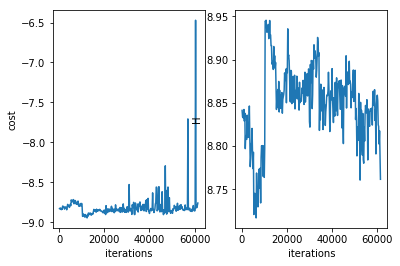

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 61600 
H 8.73895176059619
cost -8.736328199912577
system.D 3


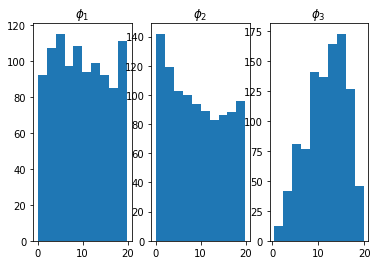

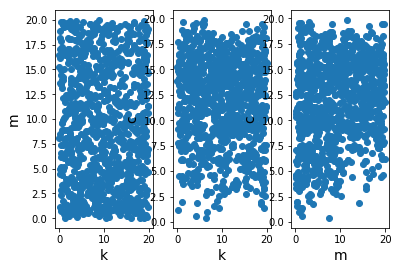

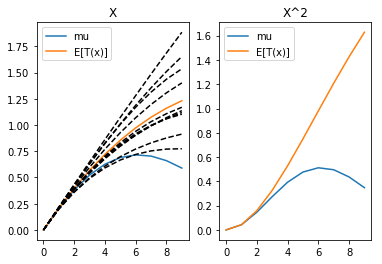

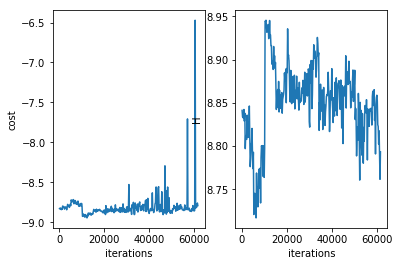

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 61800 
H 8.801563639987645
cost -8.799240256975608
system.D 3


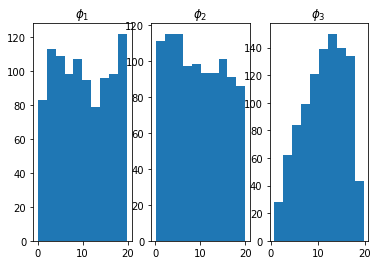

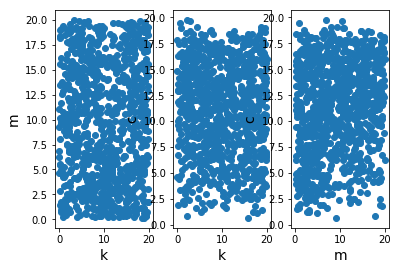

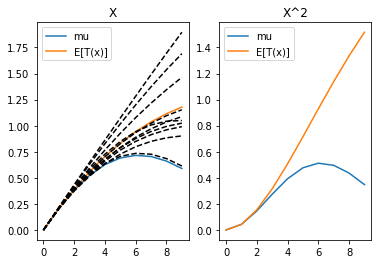

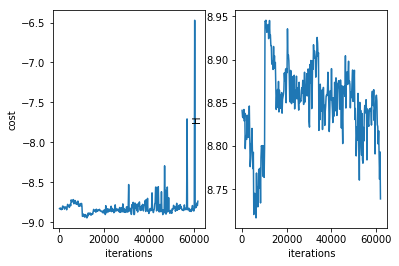

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 62000 
H 8.781955181396915
cost -8.78007035793326
system.D 3


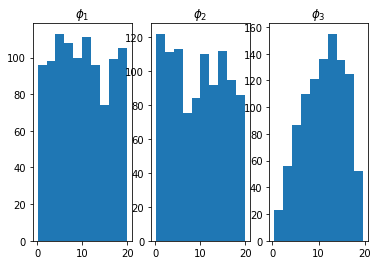

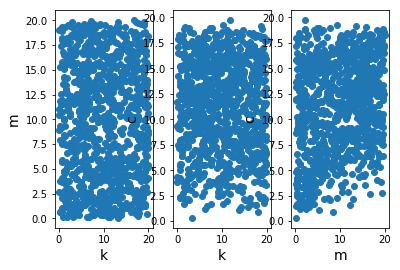

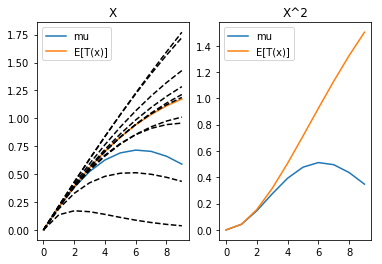

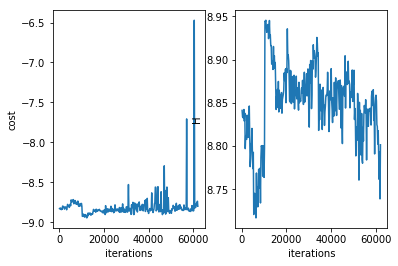

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 62200 
H 8.773095848666799
cost -8.77071458577634
system.D 3


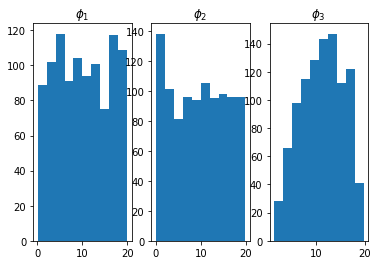

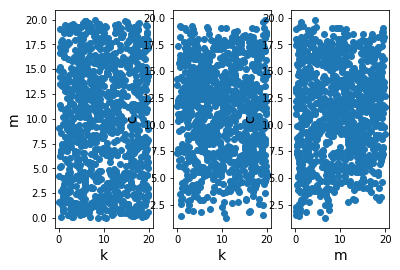

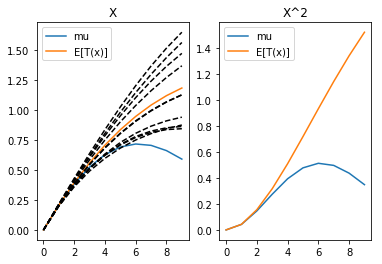

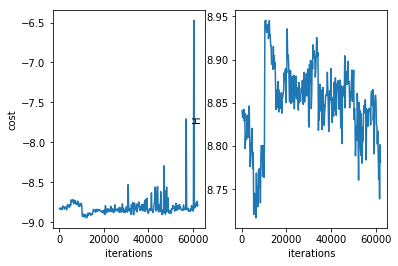

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 62400 
H 8.81491933027273
cost -8.812611327776276
system.D 3


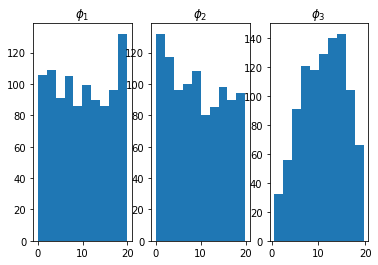

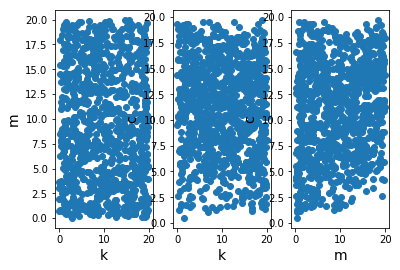

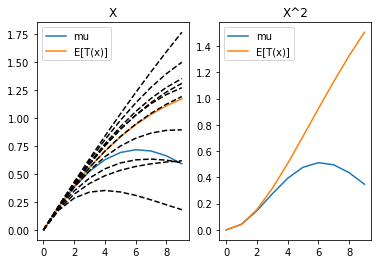

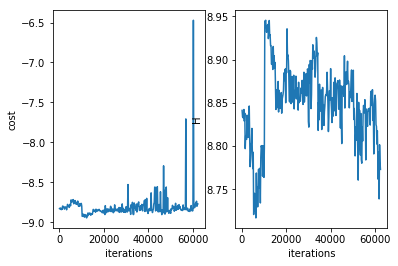

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 62600 
H 8.839065275339708
cost -8.836864862805943
system.D 3


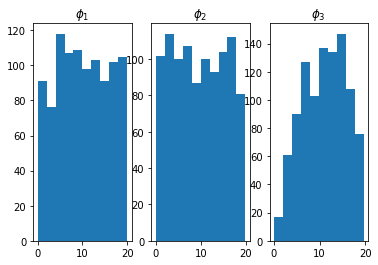

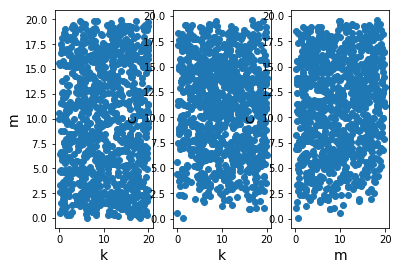

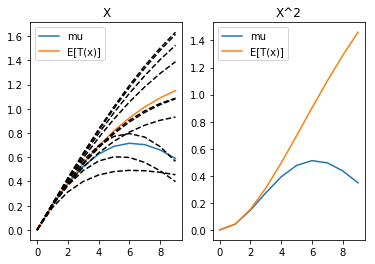

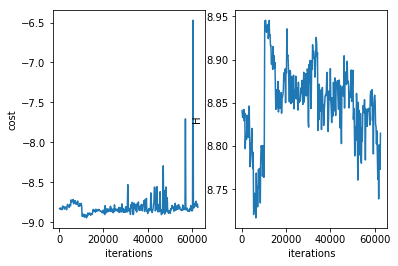

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 62800 
H 8.788199571931978
cost -8.786216014273457
system.D 3


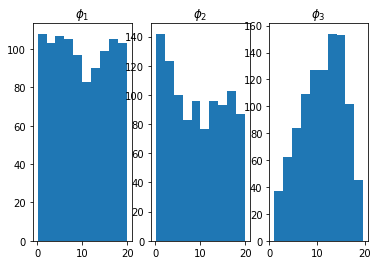

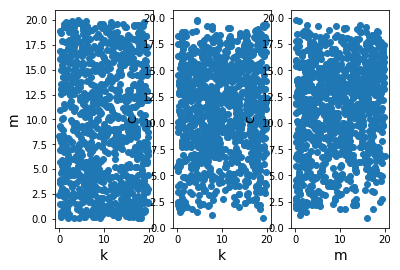

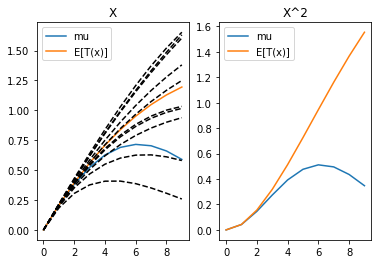

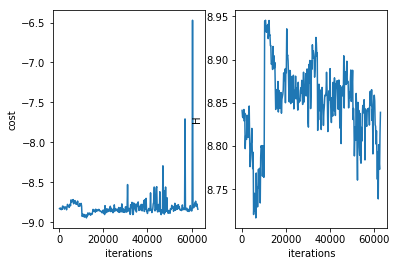

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 63000 
H 8.823649270153656
cost -8.821369081595332
system.D 3


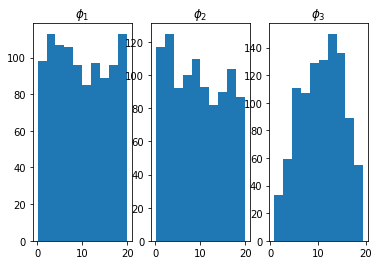

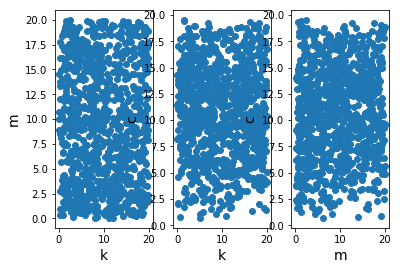

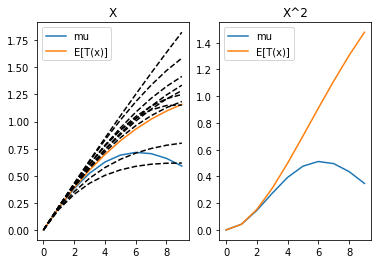

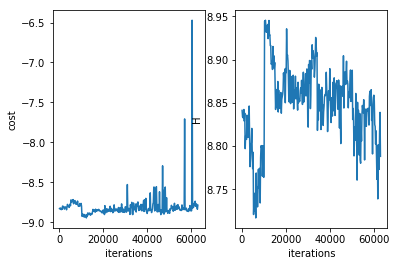

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 63200 
H 8.820227579983039
cost -8.818067330670933
system.D 3


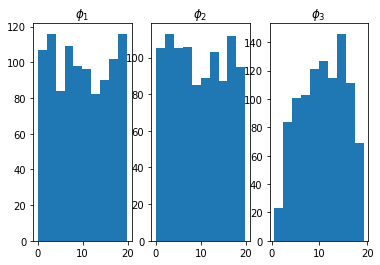

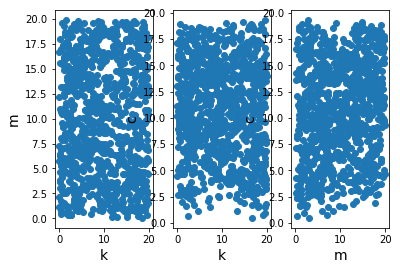

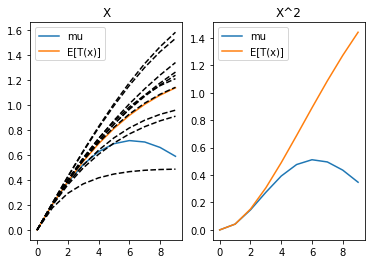

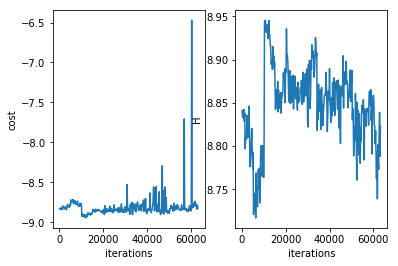

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 63400 
H 8.81628963246771
cost -8.813959681482487
system.D 3


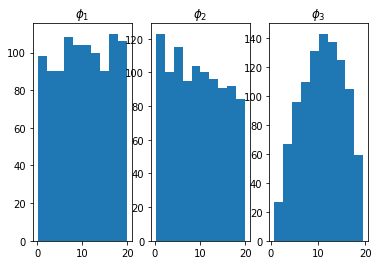

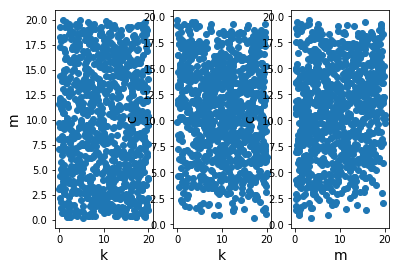

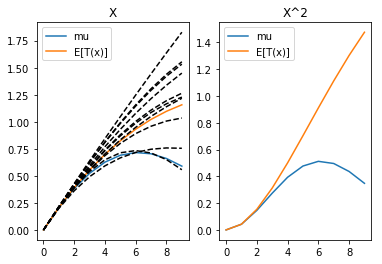

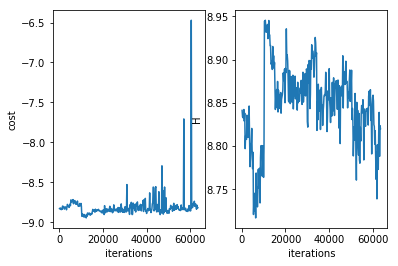

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 63600 
H 8.771802213644074
cost -8.769184417058607
system.D 3


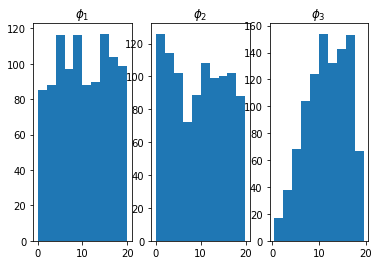

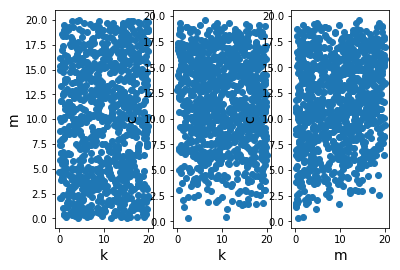

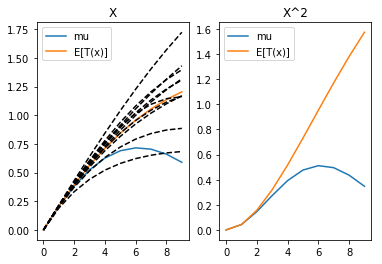

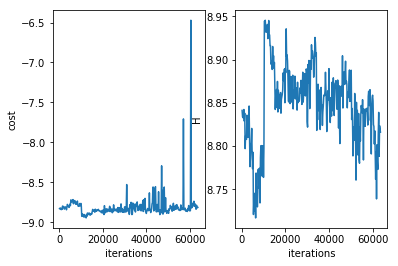

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 63800 
H 8.820048798522945
cost -8.81770673897837
system.D 3


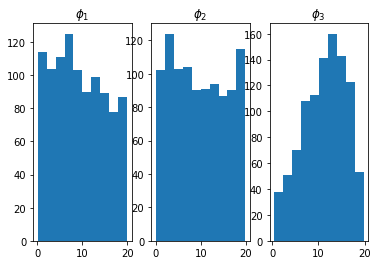

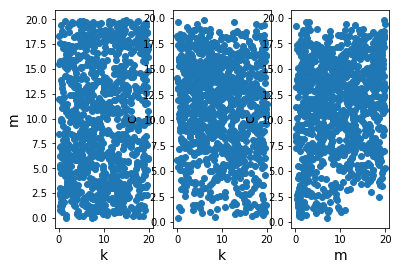

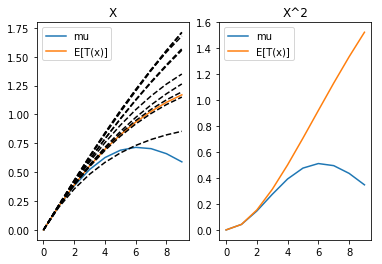

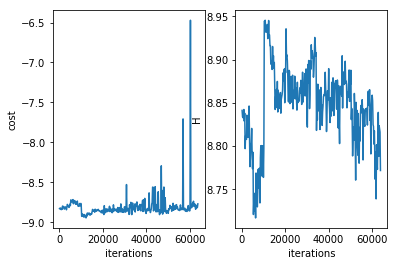

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 64000 
H 8.843921828158722
cost -8.84188170620719
system.D 3


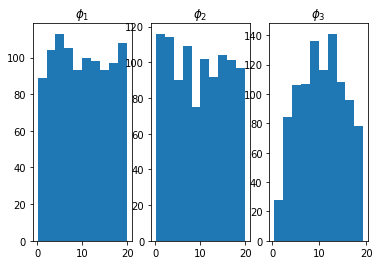

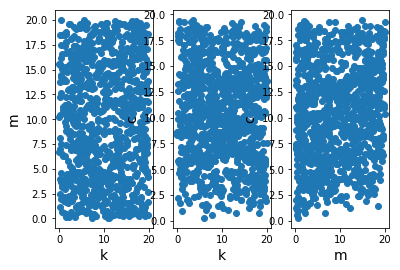

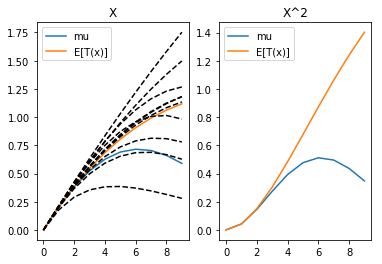

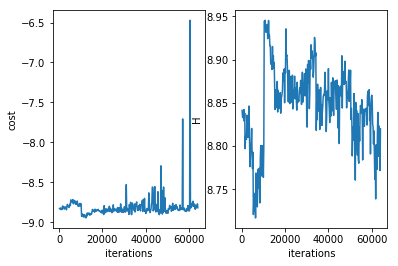

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 64200 
H 8.83491612274687
cost -8.832653551418767
system.D 3


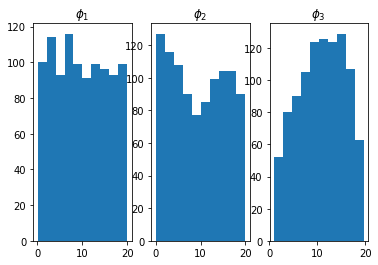

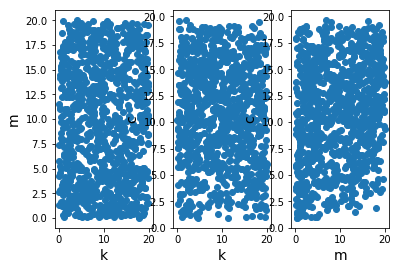

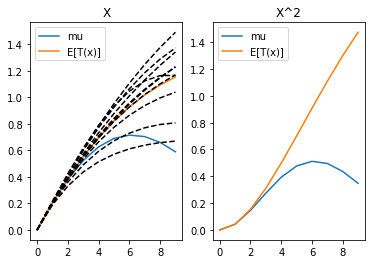

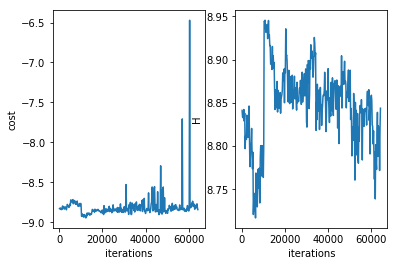

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 64400 
H 8.826696301744326
cost -8.824535661760212
system.D 3


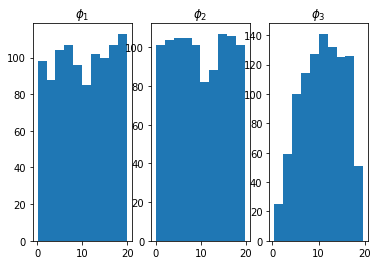

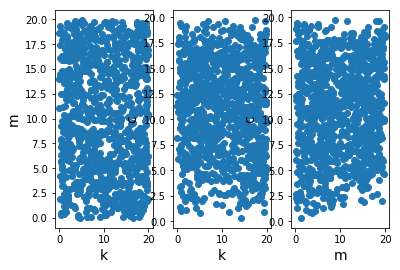

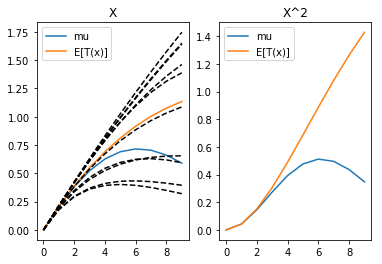

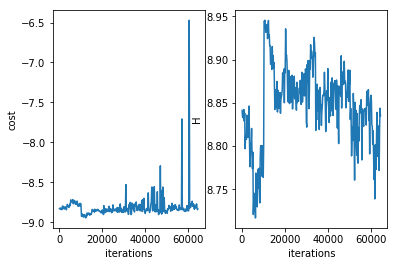

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 64600 
H 8.809224687473687
cost -8.807978494393357
system.D 3


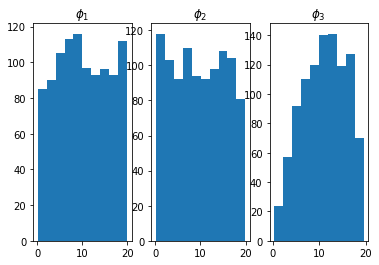

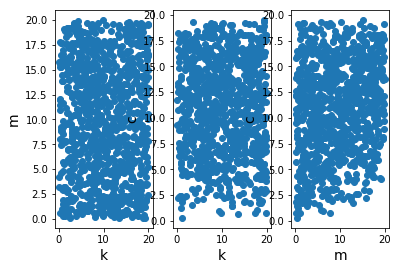

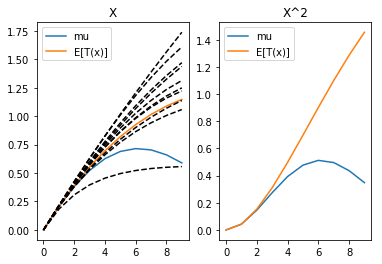

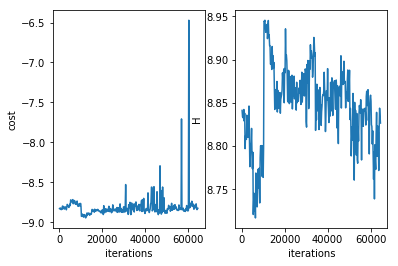

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 64800 
H 8.80564744549153
cost -8.803281583229078
system.D 3


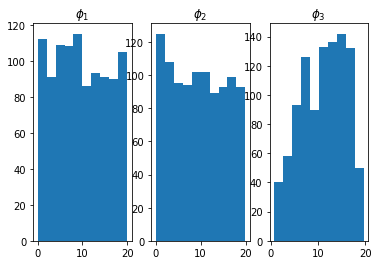

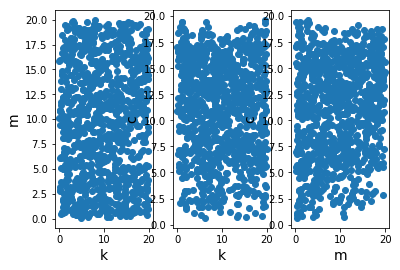

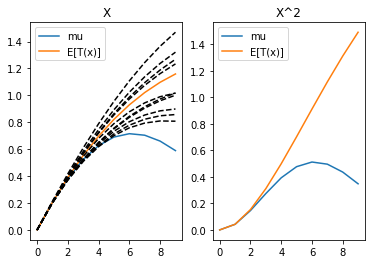

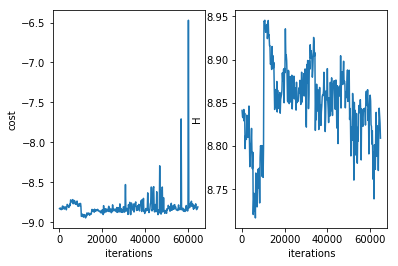

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 65000 
H 8.859205543245722
cost -8.8571232811183
system.D 3


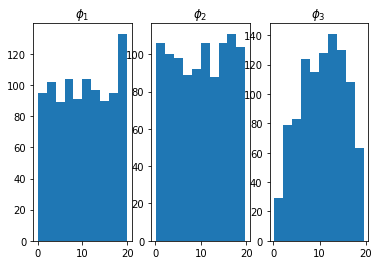

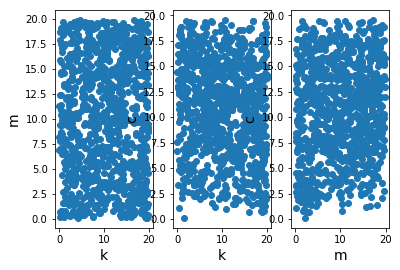

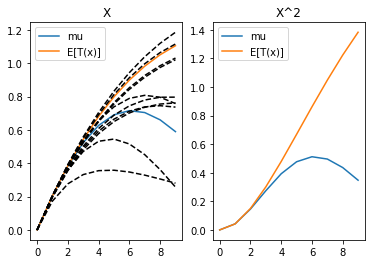

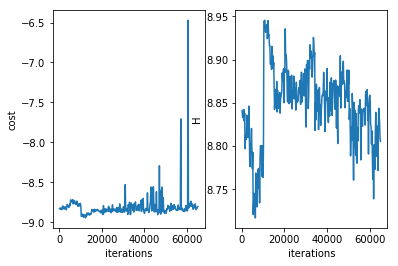

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 65200 
H 8.79504897104125
cost -8.792474878155256
system.D 3


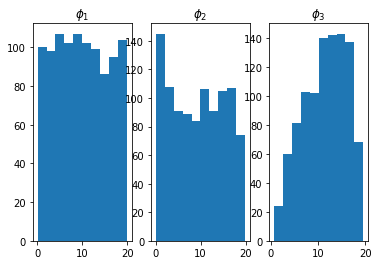

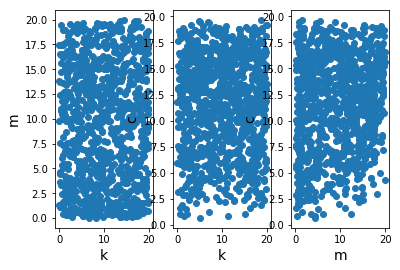

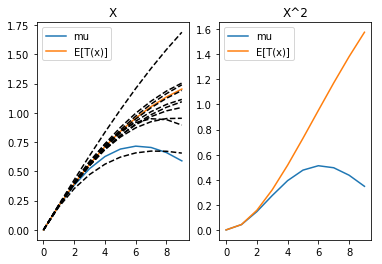

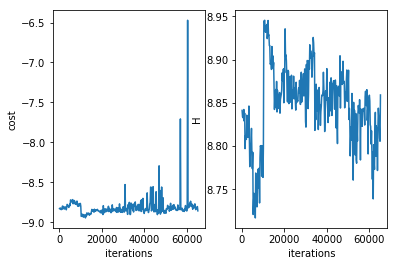

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 65400 
H 8.817567781895542
cost -8.815346298519307
system.D 3


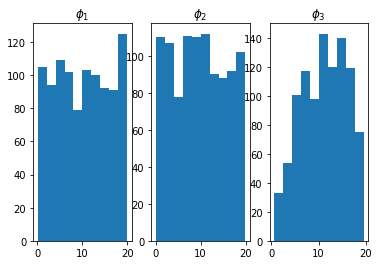

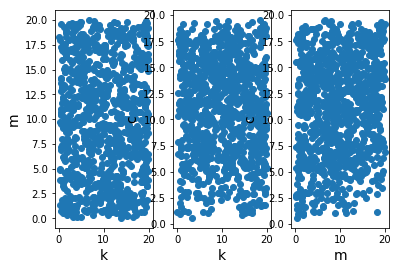

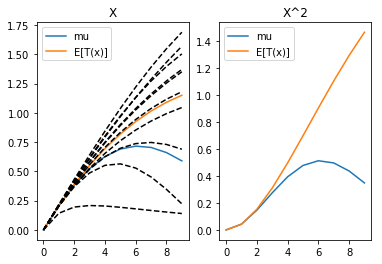

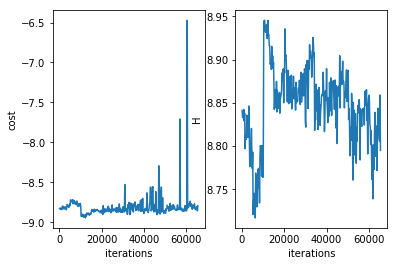

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 65600 
H 8.838739000307958
cost -8.836693320024159
system.D 3


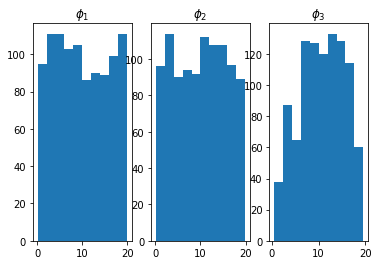

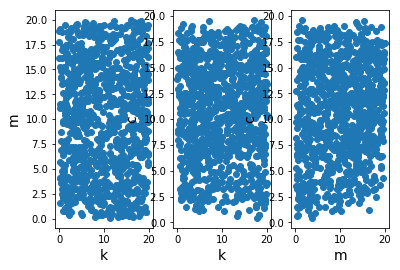

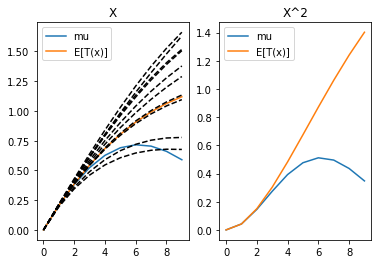

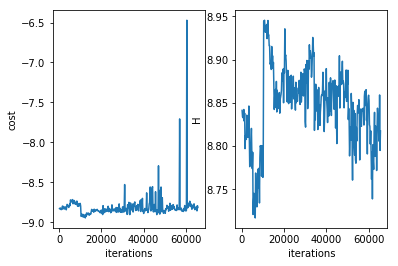

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 65800 
H 8.839064334621206
cost -8.837026227282788
system.D 3


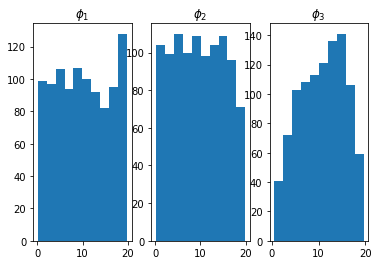

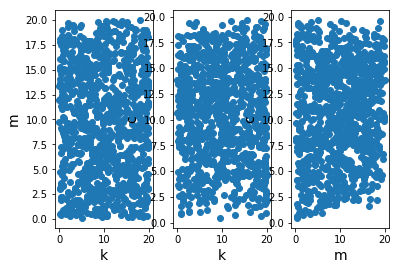

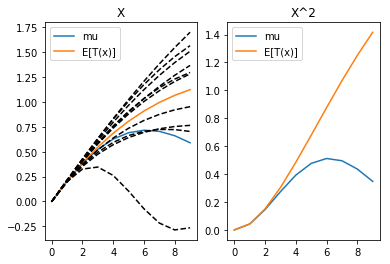

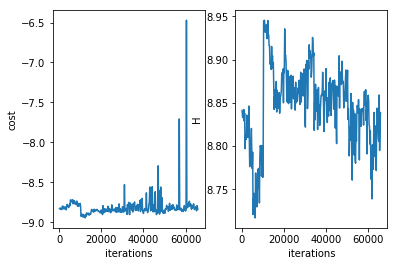

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 66000 
H 8.811074219529797
cost -8.808642227140743
system.D 3


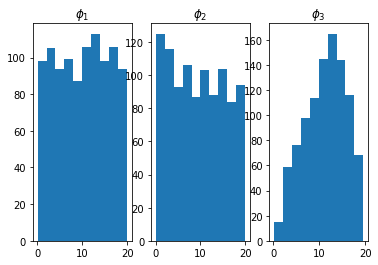

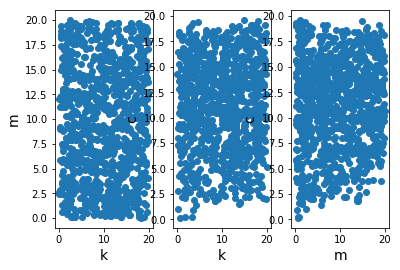

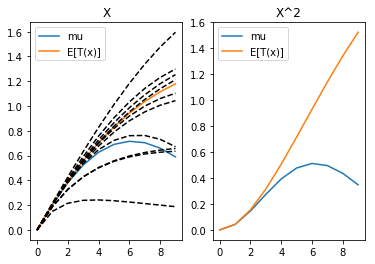

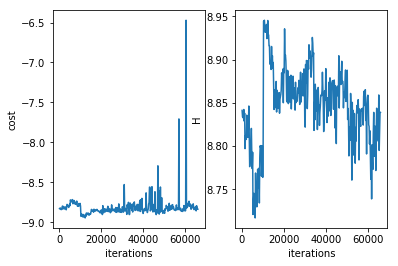

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************
******************************************
it = 66200 
H 8.742476895701227
cost -8.739856972934431
system.D 3


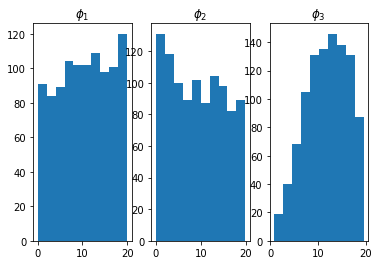

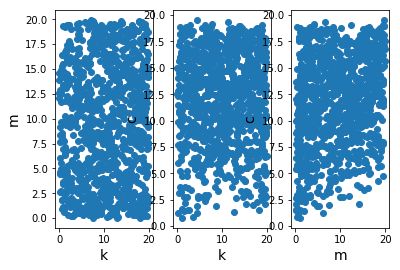

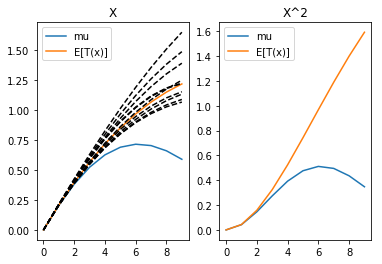

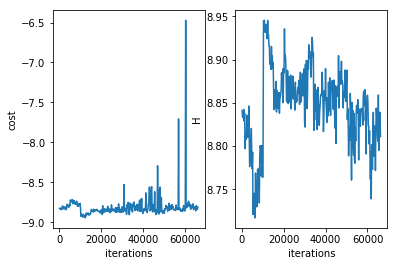

saving to results//tb/damped_harmonic_oscillator_D=3_T=10_flow=5P_lr_order=-3_c=-10_rs=0/  ...
******************************************


In [ ]:
behavior_str = 'trajectory';
random_seed = 0;

TIF_flow_type = 'PlanarFlowLayer';
nlayers = 5;
flow_dict = {'latent_dynamics':None, \
             'TIF_flow_type':TIF_flow_type, \
             'repeats':nlayers};

n = 1000;
k_max = 20;
c_init = 1e-10;
check_rate = 200;
max_iters = 10000;
lr_order = -3;


system_class = system_from_str(system_str);
system = system_class(behavior_str, T, dt, init_conds, bounds);

np.random.seed(0);

behavior = {'mu':mu, 'Sigma':Sigma};
print(behavior)
print(init_conds)

cost, phi, T_x = train_dsn(system, behavior, n, flow_dict, \
                       k_max=k_max, c_init=c_init, lr_order=lr_order, check_rate=check_rate, \
                       max_iters=max_iters, random_seed=random_seed);



In [25]:
print(t.shape)

(50,)
